In [ ]:
# Scanpy is the standard library for AnnData objects
!pip install scanpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 22.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 169.9/169.9 kB 8.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.2/58.2 kB 4.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 261.0/261.0 kB 17.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.8/8.8 MB 26.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.5/53.5 kB 4.5 MB/s eta 0:00:00


In [ ]:
import scanpy as sc
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from google.colab import drive
import os
import random

In [ ]:
# ==============================================================================
# Part 1: Setup
# ==============================================================================

print("--- Step 1: Mounting Google Drive ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"
obs_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/obs_metadata.parquet"

--- Step 1: Mounting Google Drive ---
Mounted at /content/drive


# gene_metadata structure exploration

In [ ]:
print(f"--- Loading and Inspecting: {gene_metadata_path} ---")

try:
    # Load the Parquet file into a pandas DataFrame
    gene_df = pd.read_parquet(gene_metadata_path)

    # --- Print the structure of the DataFrame ---

    print("\n1. First 5 rows of the file (.head()):")
    print(gene_df.head())

    print("\n2. Information about columns and data types (.info()):")
    gene_df.info()

    print(f"\n3. Shape of the file (rows, columns): {gene_df.shape}")

except FileNotFoundError:
    print(f"\n❌ ERROR: The file was not found at the specified path.")
    print("Please make sure the path is correct.")
except Exception as e:
    print(f"\n❌ An error occurred: {e}")

--- Loading and Inspecting: /content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet ---

1. First 5 rows of the file (.head()):
  gene_symbol       ensembl_id  token_id
0      TSPAN6  ENSG00000000003         3
1        TNMD  ENSG00000000005         4
2        DPM1  ENSG00000000419         5
3       SCYL3  ENSG00000000457         6
4    C1orf112  ENSG00000000460         7

2. Information about columns and data types (.info()):
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62710 entries, 0 to 62709
Data columns (total 3 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   gene_symbol  62710 non-null  object
 1   ensembl_id   62710 non-null  object
 2   token_id     62710 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 1.4+ MB

3. Shape of the file (rows, columns): (62710, 3)


# obs_metadata structure exploration

In [ ]:
import pyarrow.parquet as pq

try:
    # Read only the schema of the file, which is very fast and uses minimal memory
    schema = pq.read_schema(obs_metadata_path)

    # Get the list of column names from the schema
    column_names = schema.names

    print("\n✅ Schema read successfully!")
    print("--- Columns found in obs_metadata.parquet: ---")
    print(column_names)
    print("-------------------------------------------------")

except Exception as e:
    print(f"❌ ERROR: Could not read the file schema. Please check the path. Error: {e}")




✅ Schema read successfully!
--- Columns found in obs_metadata.parquet: ---
['plate', 'BARCODE_SUB_LIB_ID', 'sample', 'gene_count', 'tscp_count', 'mread_count', 'drugname_drugconc', 'drug', 'cell_line', 'sublibrary', 'BARCODE', 'pcnt_mito', 'S_score', 'G2M_score', 'phase', 'pass_filter', 'cell_name', '__index_level_0__']
-------------------------------------------------


#1- 3 UMAPs with 2 drugs

--- Step 1: Mounting Google Drive ---
Mounted at /content/drive

--- Step 2: Loading and Combining Drug Data Directly from Drive ---
Found 2 files to load (pruned to a maximum of 50).

✅ Data successfully combined! Loaded 2 files.
Final AnnData object info: AnnData object with n_obs × n_vars = 33239 × 62710
    obs: 'sample', 'gene_count', 'tscp_count', 'mread_count', 'pcnt_mito', 'S_score', 'G2M_score', 'phase', 'drug'
    obsm: 'X_scVI'

--- AnnData Object Structure ---
Available .obs columns (Cell Metadata):
['sample', 'gene_count', 'tscp_count', 'mread_count', 'pcnt_mito', 'S_score', 'G2M_score', 'phase', 'drug']

Available .obsm keys (Embeddings):
['X_scVI']
---------------------------------

--- Step 3: Preprocessing and Analysis ---
Normalizing and log-transforming data...
Finding highly variable genes...
Running PCA...


/usr/local/lib/python3.11/dist-packages/scanpy/preprocessing/_pca/__init__.py:383: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm[key_obsm] = X_pca


Computing neighborhood graph...
Calculating UMAP (this should be much faster)...
✅ Analysis complete!

--- Step 4: Generating UMAP Plots ---


<Figure size 1200x1000 with 0 Axes>

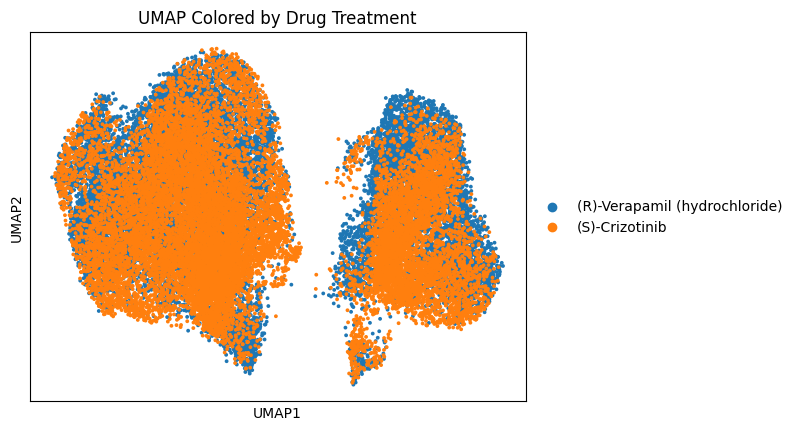

<Figure size 1200x1000 with 0 Axes>

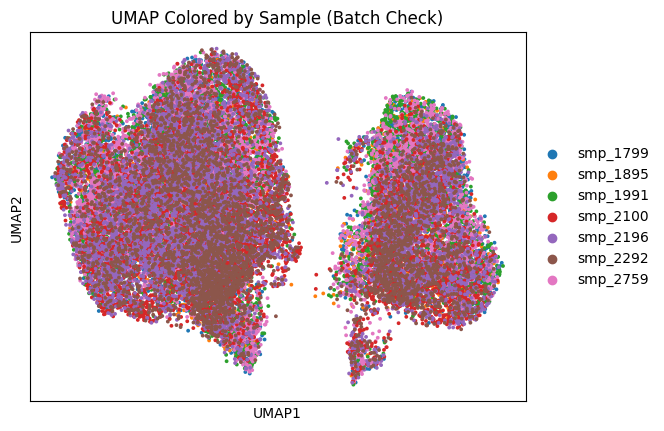


Generating UMAP plot colored by 'phase'...


<Figure size 1200x1000 with 0 Axes>

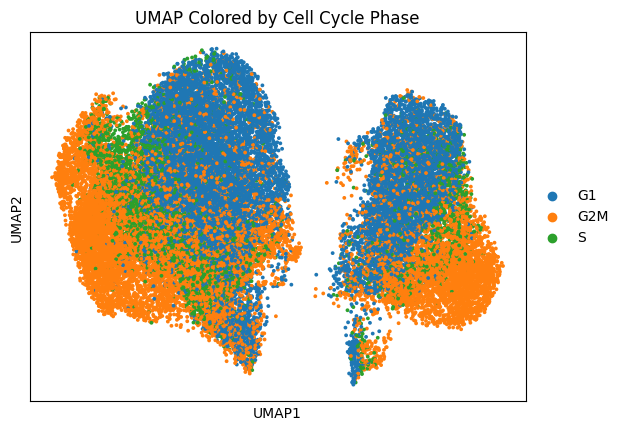

In [ ]:
# ==============================================================================
# Part 2: Robust Loading and Combining
# ==============================================================================
print("\n--- Step 2: Loading and Combining Drug Data Directly from Drive ---")

h5ad_files = [f for f in os.listdir(data_folder) if f.endswith('.h5ad')]
h5ad_files = h5ad_files[:2]

print(f"Found {len(h5ad_files)} files to load (pruned to a maximum of 50).")

adata_list = []
loaded_count = 0
for file_name in h5ad_files:
    try:
        file_path = os.path.join(data_folder, file_name)
        adata_single = sc.read_h5ad(file_path)
        drug_label = file_name.replace('.h5ad', '')
        adata_single.obs['drug'] = drug_label
        adata_list.append(adata_single)
        loaded_count += 1
    except Exception as e:
        print(f"--> WARNING: Could not load file: {file_name}. Skipping.")

if not adata_list:
    raise RuntimeError("Could not load any valid AnnData files.")

adata = ad.concat(adata_list)
print(f"\n✅ Data successfully combined! Loaded {loaded_count} files.")
print("Final AnnData object info:", adata)

# --- MODIFICATION: Show the structure of the created AnnData object ---
print("\n--- AnnData Object Structure ---")
print("Available .obs columns (Cell Metadata):")
# Print all available metadata columns for your cells
print(adata.obs.columns.to_list())
print("\nAvailable .obsm keys (Embeddings):")
print(list(adata.obsm.keys()))
print("---------------------------------")

# ==============================================================================
# Part 3: Preprocessing and Dimensionality Reduction (No Metadata Merging Needed)
# ==============================================================================
print("\n--- Step 3: Preprocessing and Analysis ---")

print("Normalizing and log-transforming data...")
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

print("Finding highly variable genes...")
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)
adata = adata[:, adata.var.highly_variable]

print("Running PCA...")
sc.tl.pca(adata, svd_solver='arpack')
print("Computing neighborhood graph...")
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=40)

print("Calculating UMAP (this should be much faster)...")
sc.tl.umap(adata)

print("✅ Analysis complete!")

# ==============================================================================
# Part 4: Visualization - Replicating the Paper's Plots using UMAP
# ==============================================================================
print("\n--- Step 4: Generating UMAP Plots ---")

# Plot 1: UMAP by Drug Treatment
plt.figure(figsize=(12, 10))
sc.pl.umap(adata, color='drug', title='UMAP Colored by Drug Treatment', show=False, size=30)
plt.show()

# Plot 2: UMAP by Sample (Batch Check)
plt.figure(figsize=(12, 10))
sc.pl.umap(adata, color='sample', title='UMAP Colored by Sample (Batch Check)', show=False, size=30)
plt.show()

# Plot 3: UMAP by Cell Cycle Phase
# This now directly checks if the 'phase' column exists after loading.
cell_cycle_column = 'phase'
if cell_cycle_column in adata.obs.columns:
    print(f"\nGenerating UMAP plot colored by '{cell_cycle_column}'...")
    plt.figure(figsize=(12, 10))
    sc.pl.umap(adata, color=cell_cycle_column, title='UMAP Colored by Cell Cycle Phase', show=False, size=30)
    plt.show()
else:
    print(f"\n--> WARNING: Column '{cell_cycle_column}' not found in the combined data. Skipping cell cycle plot.")



#2- Gene coexpression heatmap based on drug

--- Step 1: Mounting Google Drive and Selecting Files ---
Mounted at /content/drive
Randomly selected files for analysis: ['Alpelisib.h5ad', 'Budesonide.h5ad', 'Cabozantinib (S-malate).h5ad', 'AZD1390.h5ad', 'Retinoic acid.h5ad']

--- Step 2: Loading Gene Metadata ---
--> WARNING: 'gene_symbol' column not found in metadata.
--> Heatmap labels will use Gene IDs instead of symbols.

--- Step 3: Generating Correlation Heatmap for Each Drug ---

--- Processing: Alpelisib.h5ad ---
Generating heatmap for Alpelisib...


/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


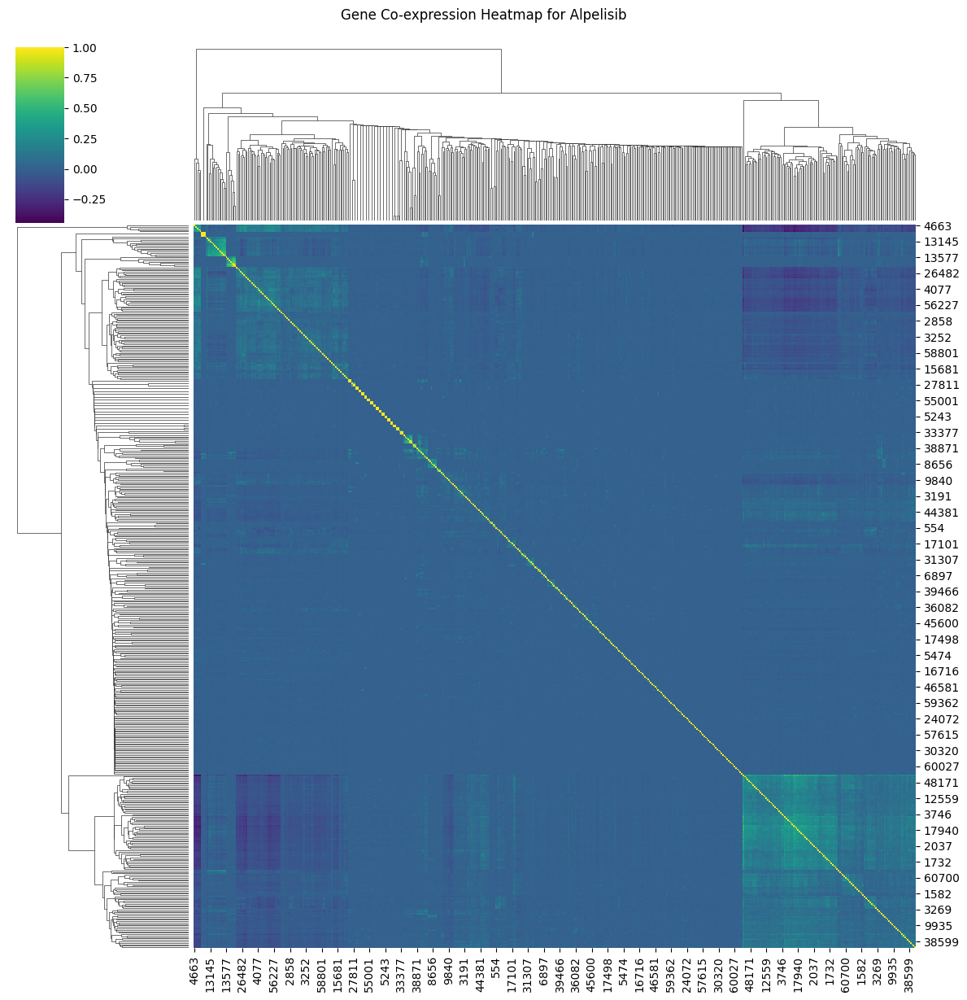


--- Processing: Budesonide.h5ad ---
Generating heatmap for Budesonide...


/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


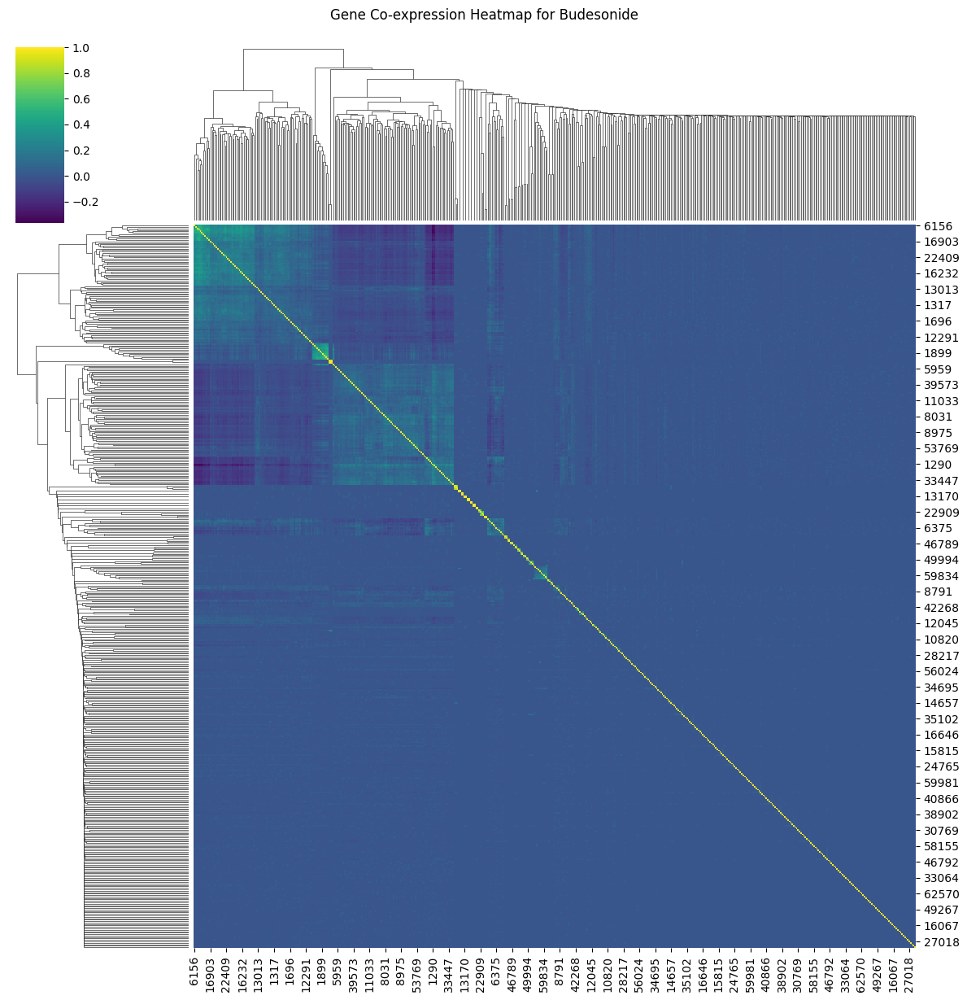


--- Processing: Cabozantinib (S-malate).h5ad ---
Generating heatmap for Cabozantinib (S-malate)...


/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


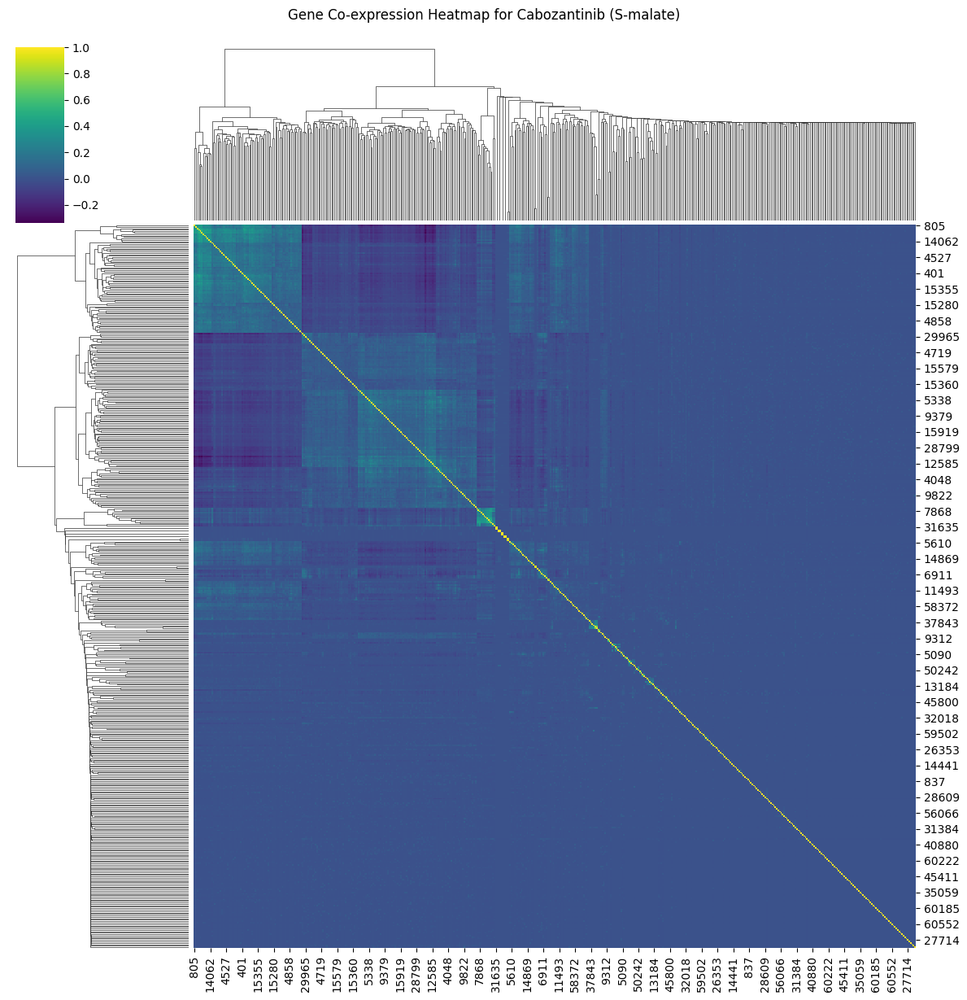


--- Processing: AZD1390.h5ad ---
Generating heatmap for AZD1390...


/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


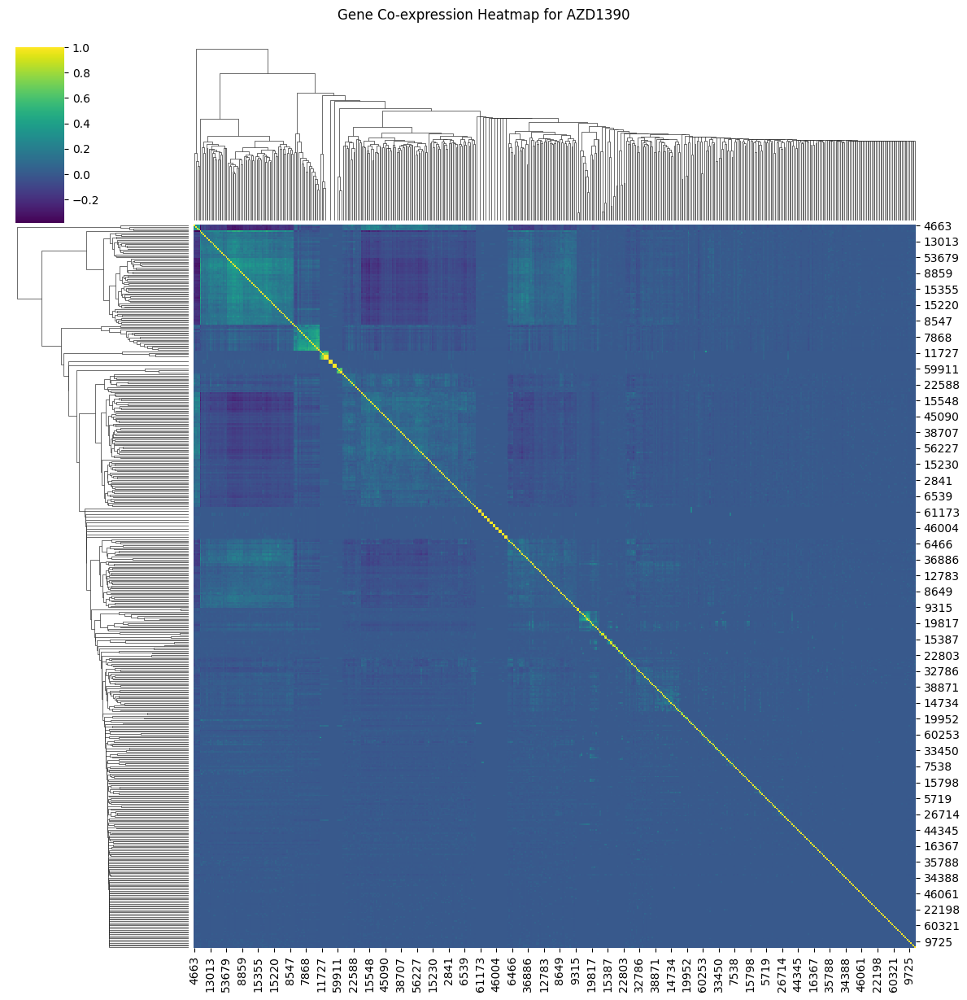


--- Processing: Retinoic acid.h5ad ---
Generating heatmap for Retinoic acid...


/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


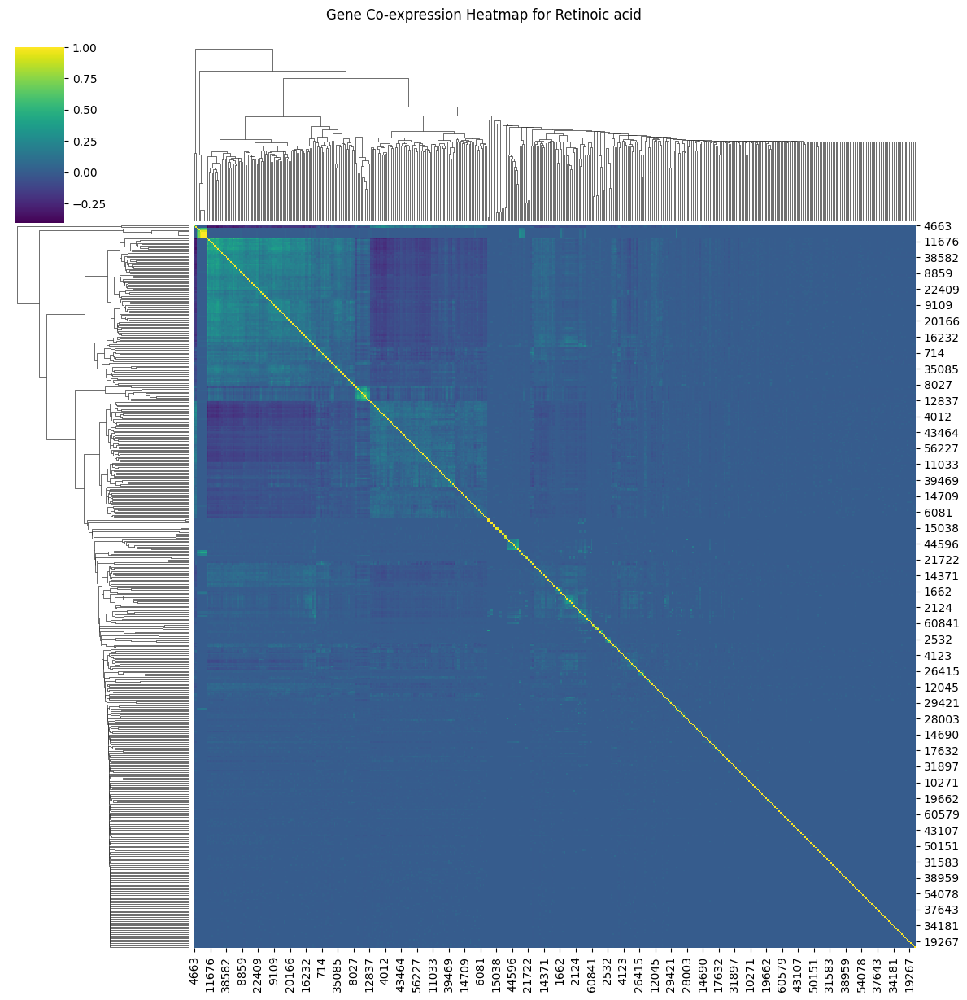

In [ ]:
# Get a list of all available drug files
all_h5ad_files = [f for f in os.listdir(data_folder) if f.endswith('.h5ad')]

# Randomly select 5 files from the list
if len(all_h5ad_files) >= 5:
    files_to_load = random.sample(all_h5ad_files, 5)
else:
    print("--> Warning: Fewer than 5 files found. Using all available files.")
    files_to_load = all_h5ad_files

print(f"Randomly selected files for analysis: {files_to_load}")


# ==============================================================================
# Part 2: Load Gene Metadata for Name Mapping
# ==============================================================================
print("\n--- Step 2: Loading Gene Metadata ---")
id_to_symbol_map = {} # Default to an empty map
try:
    gene_metadata_df = pd.read_parquet(os.path.join(gene_metadata_path, 'gene_metadata.parquet'))

    # --- FIX: Check if the 'gene_symbol' column actually exists ---
    if 'gene_symbol' in gene_metadata_df.columns and 'gene_id' in gene_metadata_df.columns:
        # Create a dictionary to map Ensembl IDs to Gene Symbols
        # We drop duplicates to ensure a clean mapping
        id_to_symbol_map = gene_metadata_df.drop_duplicates('gene_id').set_index('gene_id')['gene_symbol'].to_dict()
        print("✅ Successfully created gene ID to symbol map.")
    else:
        print("--> WARNING: 'gene_symbol' column not found in metadata.")
        print("--> Heatmap labels will use Gene IDs instead of symbols.")
    # --- END FIX ---

except Exception as e:
    print(f"--> ERROR: Could not load or process gene metadata. Error: {e}")


# ==============================================================================
# Part 3: Loop, Process, and Plot Correlation Heatmaps
# ==============================================================================
print("\n--- Step 3: Generating Correlation Heatmap for Each Drug ---")

for file_name in files_to_load:
    try:
        print(f"\n--- Processing: {file_name} ---")
        drug_label = file_name.replace('.h5ad', '')

        # Load a single drug file
        adata_single = sc.read_h5ad(os.path.join(data_folder, file_name))

        # --- Analysis for a single AnnData object ---
        # 1. Normalize and log-transform
        sc.pp.normalize_total(adata_single, target_sum=1e4)
        sc.pp.log1p(adata_single)

        # 2. Find the top 500 most variable genes for this specific treatment
        # This makes the correlation calculation faster and the heatmap more focused.
        sc.pp.highly_variable_genes(adata_single, n_top_genes=500)
        adata_hvg = adata_single[:, adata_single.var.highly_variable].copy()

        # 3. Create a pandas DataFrame from the expression data
        expression_df = pd.DataFrame(adata_hvg.X.toarray(), columns=adata_hvg.var_names)

        # 4. Rename the columns from Gene IDs to Gene Symbols using our map
        # If the map is empty, this line will do nothing.
        expression_df.rename(columns=id_to_symbol_map, inplace=True)

        # 5. Calculate the gene-gene Pearson correlation matrix
        correlation_matrix = expression_df.corr()

        # 6. Generate a clustered heatmap to visualize the correlations
        print(f"Generating heatmap for {drug_label}...")

        # A clustermap is a heatmap where rows/columns are reordered to group similar items
        sns.clustermap(
            correlation_matrix,
            cmap='viridis',  # A nice color map for correlations
            figsize=(12, 12)
        )

        # Add a title to the plot
        plt.suptitle(f'Gene Co-expression Heatmap for {drug_label}', y=1.02)
        plt.show()

    except Exception as e:
        print(f"--> ERROR: Failed to process file {file_name}. Error: {e}")



# t-SNE on X.scVI by cell cycle phase for 5 first drugs

Mounted at /content/drive

--- Loading 5 updated .h5ad files ---
--> Successfully loaded and closed: (R)-Verapamil (hydrochloride).h5ad
--> Successfully loaded and closed: (S)-Crizotinib.h5ad
--> Successfully loaded and closed: 18β-Glycyrrhetinic acid.h5ad
--> Successfully loaded and closed: 4EGI-1.h5ad
--> Successfully loaded and closed: 5-Azacytidine.h5ad

✅ Data successfully combined!
Final AnnData object info: AnnData object with n_obs × n_vars = 71579 × 62710
    obs: 'sample', 'gene_count', 'tscp_count', 'mread_count', 'pcnt_mito', 'S_score', 'G2M_score', 'phase', 'drug'
    obsm: 'X_scVI'
Available .obs columns: Index(['sample', 'gene_count', 'tscp_count', 'mread_count', 'pcnt_mito',
       'S_score', 'G2M_score', 'phase', 'drug'],
      dtype='object')
Available .obsm keys: ['X_scVI']

--- Generating t-SNE Plot from X_scVI ---
✅ Found 'X_scVI' embedding and 'phase' column.
Calculating t-SNE based on X_scVI (this should be fast)...


/usr/local/lib/python3.11/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  return fn(*args_all, **kw)


✅ t-SNE calculation complete!
Generating plot...


<Figure size 1200x1000 with 0 Axes>

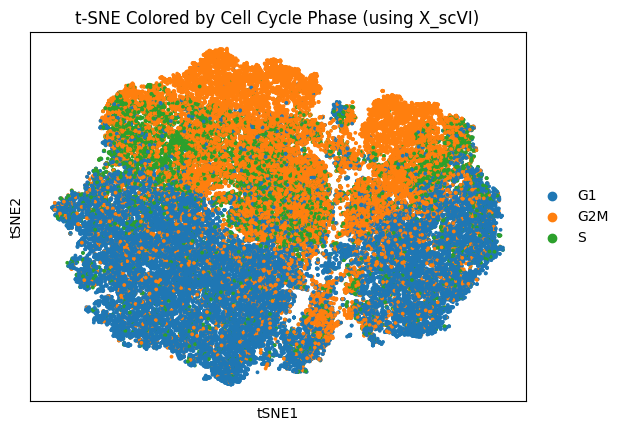

In [ ]:
import anndata as ad
adata_list = []
for file_name in files_to_load:
    try:
        file_path = os.path.join(data_folder, file_name)

        # --- This is the updated, safer method ---
        # 1. Read the file from disk
        adata_from_disk = sc.read_h5ad(file_path)
        # 2. Immediately make an in-memory copy
        adata_single = adata_from_disk.copy()
        # 3. The original object and its file handle are now released

        # Add the drug label to the in-memory copy
        drug_label = file_name.replace('.h5ad', '')
        adata_single.obs['drug'] = drug_label

        # Add the clean, in-memory object to our list
        adata_list.append(adata_single)
        print(f"--> Successfully loaded and closed: {file_name}")

    except Exception as e:
        print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")

if not adata_list:
    raise RuntimeError("Could not load any valid AnnData files. Please check the filenames.")

# Combine all loaded AnnData objects into one
# This line will now work because 'ad' is defined from 'import anndata as ad'
adata = ad.concat(adata_list)
print("\n✅ Data successfully combined!")
print("Final AnnData object info:", adata)
print("Available .obs columns:", adata.obs.columns)
print("Available .obsm keys:", list(adata.obsm.keys()))


# ==============================================================================
# Part 3: Dimensionality Reduction and Plotting (The New, Simpler Way)
# ==============================================================================
print("\n--- Generating t-SNE Plot from X_scVI ---")

# Define the metadata columns we need for our plot
cell_cycle_column = 'phase'

# Check if the required data ('X_scVI' and the 'phase' column) exists
if 'X_scVI' in adata.obsm and cell_cycle_column in adata.obs.columns:
    print("✅ Found 'X_scVI' embedding and 'phase' column.")

    # --- The Key Step ---
    # We tell t-SNE to use the pre-calculated 'X_scVI' representation.
    # This is much faster and more accurate than running PCA from scratch.
    print("Calculating t-SNE based on X_scVI (this should be fast)...")
    sc.tl.tsne(adata, use_rep='X_scVI', n_jobs=-1)

    print("✅ t-SNE calculation complete!")

    # --- Generate the Final Plot ---
    print("Generating plot...")
    plt.figure(figsize=(12, 10))
    sc.pl.tsne(
        adata,
        color=cell_cycle_column,
        title='t-SNE Colored by Cell Cycle Phase (using X_scVI)',
        size=30  # Adjust point size if needed
    )
    plt.show()

else:
    print(f"\n❌ ERROR: Could not find the required data.")
    if 'X_scVI' not in adata.obsm:
        print("--> The 'X_scVI' embedding was not found in the combined data.")
    if cell_cycle_column not in adata.obs.columns:
        print(f"--> The '{cell_cycle_column}' column was not found in the cell metadata.")
    print("Please verify that your .h5ad files have been updated correctly.")



# Top 10 expressed genes for 5 drugs

--- Step 1: Mounting Google Drive and Selecting Source Files ---
Mounted at /content/drive
Randomly selected files for analysis: ['Methyl aminolevulinate (hydrochloride).h5ad', 'Crizotinib (hydrochloride).h5ad', 'Encorafenib.h5ad', 'Adagrasib.h5ad', 'SBI-0640756.h5ad']

--- Step 2: Loading Gene Metadata ---
✅ Successfully created gene ID to symbol map.

--- Step 3: Finding Top Expressed Genes for Each Drug ---

--- Processing: Methyl aminolevulinate (hydrochloride).h5ad ---

--- Processing: Crizotinib (hydrochloride).h5ad ---

--- Processing: Encorafenib.h5ad ---

--- Processing: Adagrasib.h5ad ---

--- Processing: SBI-0640756.h5ad ---


--- Step 4: Comparison Results ---
--- Top 10 Most Expressed Genes by Drug ---
        Methyl aminolevulinate (hydrochloride)_Gene  Methyl aminolevulinate (hydrochloride)_ID Methyl aminolevulinate (hydrochloride)_Expression Crizotinib (hydrochloride)_Gene  Crizotinib (hydrochloride)_ID Crizotinib (hydrochloride)_Expression Encorafenib_Gene  Encorafenib

/tmp/ipython-input-9-1779414096.py:119: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
/tmp/ipython-input-9-1779414096.py:119: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
/tmp/ipython-input-9-1779414096.py:119: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
/tmp/ipython-input-9-1779414096.py:119: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(
/tmp/ipython-input-9-1779414096.py:119: FutureWa

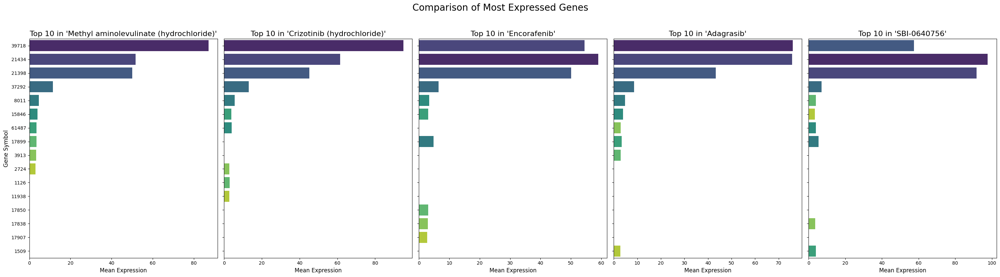

In [ ]:
# ==============================================================================
# Part 1: Setup and Random File Selection
# ==============================================================================
import os
import random
import pandas as pd
import scanpy as sc
import numpy as np  # <-- Added numpy for array manipulation
import seaborn as sns
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Selecting Source Files ---")
drive.mount('/content/drive', force_remount=True)

# --- This is the correct path to the files containing gene counts ---
data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# Get a list of all available drug files
all_h5ad_files = [f for f in os.listdir(data_folder) if f.endswith('.h5ad')]

# Randomly select 5 files from the list to analyze
if len(all_h5ad_files) >= 5:
    files_to_load = random.sample(all_h5ad_files, 5)
else:
    print("--> Warning: Fewer than 5 files found. Using all available files.")
    files_to_load = all_h5ad_files

print(f"Randomly selected files for analysis: {files_to_load}")


# ==============================================================================
# Part 2: Load Gene Metadata for Name Mapping
# ==============================================================================
print("\n--- Step 2: Loading Gene Metadata ---")
try:
    gene_metadata_df = pd.read_parquet(gene_metadata_path)
    id_to_symbol_map = gene_metadata_df.set_index('ensembl_id')['gene_symbol'].to_dict()
    print("✅ Successfully created gene ID to symbol map.")
except Exception as e:
    print(f"--> ERROR: Could not load or process gene metadata. Error: {e}")
    id_to_symbol_map = {} # Default to an empty map if loading fails


# ==============================================================================
# Part 3: Loop, Process, and Find Top Genes from Each File
# ==============================================================================
print("\n--- Step 3: Finding Top Expressed Genes for Each Drug ---")

top_genes_results = {}
for file_name in files_to_load:
    try:
        print(f"\n--- Processing: {file_name} ---")
        drug_label = file_name.replace('.h5ad', '')

        # Load a single drug file
        adata_drug = sc.read_h5ad(os.path.join(data_folder, file_name))

        # Calculate the mean expression for every gene across all cells in this file
        if adata_drug.X is None:
            print("--> Warning: .X attribute is empty. Skipping this file.")
            continue

        mean_expression_matrix = adata_drug.X.mean(axis=0)

        # --- FIX: Convert the 2D numpy matrix result to a 1D array ---
        mean_expression_array = np.asarray(mean_expression_matrix).flatten()

        # Create a pandas DataFrame to hold the results
        gene_expression_df = pd.DataFrame({
            'gene_id': adata_drug.var_names,
            'mean_expression': mean_expression_array
        })
        # --- END FIX ---

        # Sort by mean expression to find the top genes
        top_10_genes = gene_expression_df.sort_values('mean_expression', ascending=False).head(10)

        # Use our map to add the human-readable gene symbols
        top_10_genes['gene_symbol'] = top_10_genes['gene_id'].map(id_to_symbol_map).fillna(top_10_genes['gene_id'])

        # Store the results
        top_genes_results[drug_label] = top_10_genes

    except Exception as e:
        print(f"--> ERROR: Failed to process file {file_name}. Error: {e}")

# ==============================================================================
# Part 4: Display Results and Visualize
# ==============================================================================
if top_genes_results:
    print("\n\n--- Step 4: Comparison Results ---")

    # --- Create a list of the DataFrames for easier plotting ---
    drug_names = list(top_genes_results.keys())

    # --- Print a Comparative Table ---
    # We'll create a single DataFrame for the table
    dfs_for_table = []
    for drug in drug_names:
        df = top_genes_results[drug].copy()
        df.columns = [f"{drug}_Gene", f"{drug}_ID", f"{drug}_Expression"]
        df.index = [f"Rank {i+1}" for i in range(10)]
        dfs_for_table.append(df)

    comparison_df = pd.concat(dfs_for_table, axis=1)
    print("--- Top 10 Most Expressed Genes by Drug ---")
    print(comparison_df.to_string())


    # --- Create a Comparative Bar Plot ---
    print("\n\n--- Generating Visualization ---")
    num_drugs = len(drug_names)
    fig, axes = plt.subplots(1, num_drugs, figsize=(6 * num_drugs, 8), sharey=True)
    if num_drugs == 1: axes = [axes] # Make it iterable if only one plot

    for i, drug_name in enumerate(drug_names):
        sns.barplot(
            ax=axes[i],
            x='mean_expression',
            y='gene_symbol',
            data=top_genes_results[drug_name],
            palette='viridis'
        )
        axes[i].set_title(f"Top 10 in '{drug_name}'", fontsize=16)
        axes[i].set_xlabel("Mean Expression", fontsize=12)
        axes[i].set_ylabel("Gene Symbol" if i == 0 else "", fontsize=12)

    plt.suptitle("Comparison of Most Expressed Genes", fontsize=20, y=1.03)
    plt.tight_layout()
    plt.show()

else:
    print("\nNo data was processed to generate results.")



# Drug correlation map by dominant cell cycle phase (30 drugs)

--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading and Preparing Data ---
Loading main AnnData object...
Loading only required columns ['BARCODE_SUB_LIB_ID', 'drug', 'phase'] from cell metadata...

✅ All files loaded successfully!
Merging cell metadata...
✅ Cell metadata merged successfully. 6040371 cells remain.

--- Step 3: Extracting Features for 30 Random Drugs ---
Analyzing 30 randomly selected drugs...
✅ Feature extraction complete.
Example profiles: {'LB-100': 'G2M', 'Erythromycin': 'G1', 'Macitentan': 'G1', 'Rosiglitazone': 'G2M', 'Acetohexamide': 'G1'}

--- Step 4: Calculating Drug Similarity and Plotting Heatmap ---
Generating drug similarity heatmap...


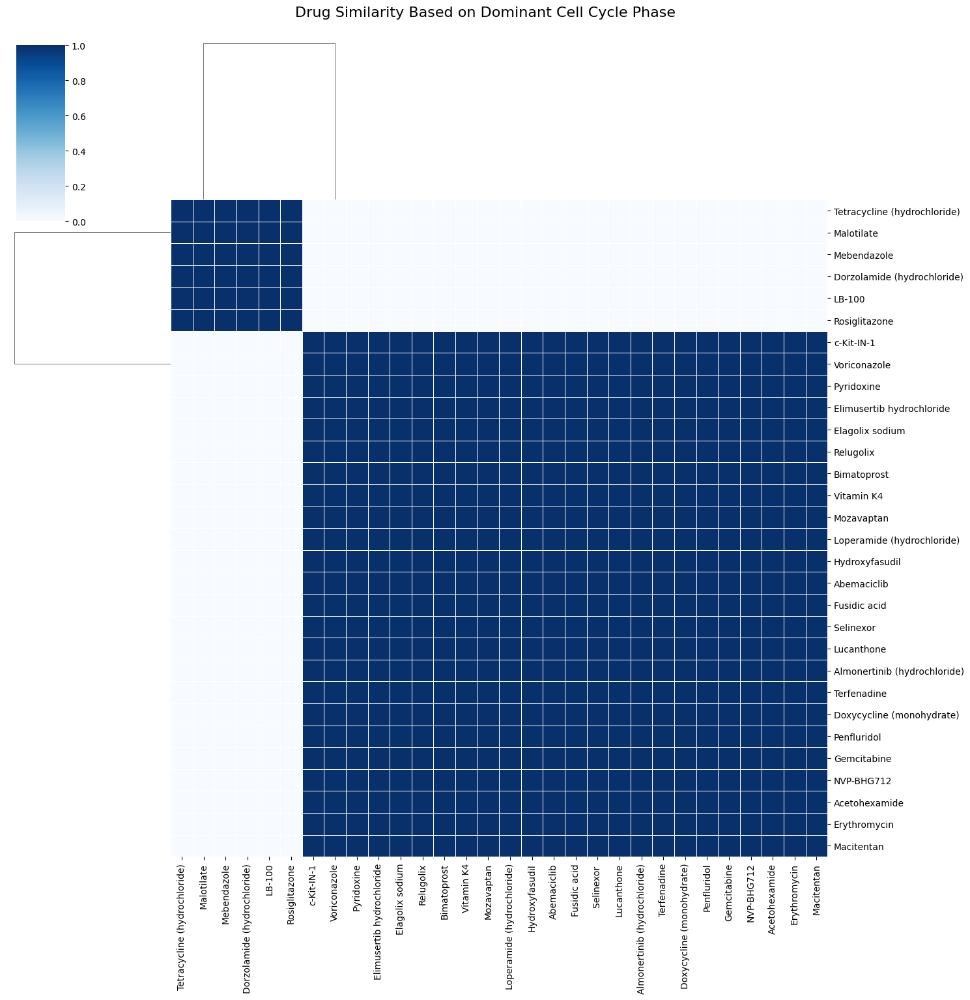

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading All Data Sources
# ==============================================================================
import os
import random
import pandas as pd
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths to all required files
scvi_adata_path = "/content/drive/MyDrive/TAHOE/scVI/scVI_CVCL_0546.h5ad"
obs_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/obs_metadata.parquet"

# ==============================================================================
# Part 2: Load and Prepare Data (with Memory-Efficient Loading)
# ==============================================================================
print("\n--- Step 2: Loading and Preparing Data ---")

try:
    # Load the main AnnData object
    print(f"Loading main AnnData object...")
    adata = sc.read_h5ad(scvi_adata_path)

    # EFFICIENTLY LOAD ONLY THE COLUMNS WE NEED
    barcode_column_name = 'BARCODE_SUB_LIB_ID'
    columns_to_load = [barcode_column_name, 'drug', 'phase']

    print(f"Loading only required columns {columns_to_load} from cell metadata...")
    obs_metadata_df = pd.read_parquet(obs_metadata_path, columns=columns_to_load)

    print("\n✅ All files loaded successfully!")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load one of the required files. Please check paths. Error: {e}")

# --- Merge Cell Metadata ---
print("Merging cell metadata...")

# Set the correct index on the metadata DataFrame before joining
if barcode_column_name in obs_metadata_df.columns:
    obs_metadata_df.set_index(barcode_column_name, inplace=True)
else:
    raise KeyError(f"❌ ERROR: The barcode column '{barcode_column_name}' was not found in the loaded metadata.")

# Join the required columns
adata.obs = adata.obs.join(obs_metadata_df[['drug', 'phase']])
adata = adata[~adata.obs['drug'].isnull()].copy()

if adata.n_obs == 0:
    raise ValueError("❌ ERROR: Merge failed. No cells remain after joining with metadata.")

print(f"✅ Cell metadata merged successfully. {adata.n_obs} cells remain.")


# ==============================================================================
# Part 3: Feature Extraction from a Random Sample of 30 Drugs
# --- This section is now simplified to only use cell phase ---
# ==============================================================================
print("\n--- Step 3: Extracting Features for 30 Random Drugs ---")

# --- Randomly Select 30 Drugs ---
all_drugs = adata.obs['drug'].unique().tolist()
if len(all_drugs) < 30:
    print(f"--> Warning: Fewer than 30 drugs found. Using all {len(all_drugs)} available drugs.")
    selected_drugs = all_drugs
else:
    selected_drugs = random.sample(all_drugs, 30)

print(f"Analyzing {len(selected_drugs)} randomly selected drugs...")

# --- Loop Through Drugs to Build a Feature Profile for Each ---
drug_profiles = {}
for drug_name in selected_drugs:
    # Create a subset of data for the current drug
    adata_drug = adata[adata.obs['drug'] == drug_name, :]

    # --- SIMPLIFIED FEATURE: Find the most dominant cell cycle phase ---
    dominant_phase = adata_drug.obs['phase'].mode()[0]

    # Store the profile. The profile for each drug is now just its dominant phase.
    drug_profiles[drug_name] = dominant_phase

print("✅ Feature extraction complete.")
print("Example profiles:", dict(list(drug_profiles.items())[:5]))


# ==============================================================================
# Part 4: Calculate and Visualize Drug Similarity
# ==============================================================================
print("\n--- Step 4: Calculating Drug Similarity and Plotting Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=drug_profiles.keys(), columns=drug_profiles.keys(), dtype=float)

# Calculate similarity: 1 if phases are the same, 0 if they are different
for drug1 in drug_profiles:
    for drug2 in drug_profiles:
        if drug_profiles[drug1] == drug_profiles[drug2]:
            similarity_df.loc[drug1, drug2] = 1.0
        else:
            similarity_df.loc[drug1, drug2] = 0.0

# --- Generate a Clustered Heatmap ---
print("Generating drug similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='Blues', # A simple blue colormap is good for 0/1 data
    annot=False,
    linewidths=.5,
    figsize=(15, 15)
)

plt.suptitle("Drug Similarity Based on Dominant Cell Cycle Phase", y=1.02, fontsize=16)
plt.show()



# Drug correlation map by top expressed genes (10 drugs)

Randomly selected files for analysis: ['Trametinib.h5ad', 'Abemaciclib.h5ad', 'PF-06260933.h5ad', 'PH-797804.h5ad', 'DTP3.h5ad', 'Vilanterol.h5ad', 'Tranilast.h5ad', 'Dabrafenib.h5ad', 'Vismodegib.h5ad', 'Bergenin.h5ad']

--- Step 2: Loading Gene Metadata ---
✅ Successfully created gene ID to symbol map.

--- Step 3: Extracting Top Expressed Gene for Each Drug ---

--- Processing: Trametinib.h5ad ---
--> Top expressed gene for Trametinib: 21434

--- Processing: Abemaciclib.h5ad ---
--> Top expressed gene for Abemaciclib: 39718

--- Processing: PF-06260933.h5ad ---
--> Top expressed gene for PF-06260933: 39718

--- Processing: PH-797804.h5ad ---
--> Top expressed gene for PH-797804: 21434

--- Processing: DTP3.h5ad ---
--> Top expressed gene for DTP3: 39718

--- Processing: Vilanterol.h5ad ---
--> Top expressed gene for Vilanterol: 21434

--- Processing: Tranilast.h5ad ---
--> Top expressed gene for Tranilast: 39718

--- Processing: Dabrafenib.h5ad ---
--> Top expressed gene for Dabrafe

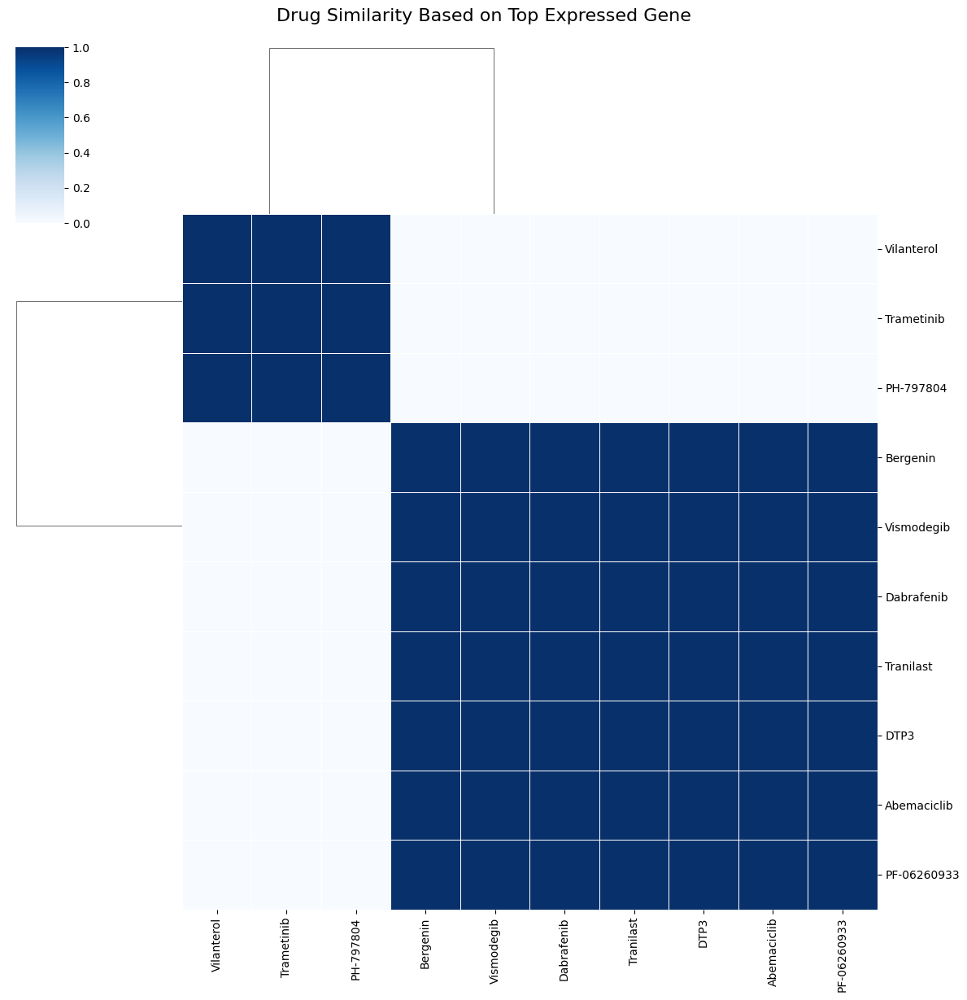

In [ ]:
# Define paths to the source data and gene metadata
data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# Get a list of all available drug files
all_h5ad_files = [f for f in os.listdir(data_folder) if f.endswith('.h5ad')]

# Randomly select 10 files from the list to analyze
if len(all_h5ad_files) >= 10:
    files_to_load = random.sample(all_h5ad_files, 10)
else:
    print(f"--> Warning: Fewer than 10 files found. Using all {len(all_h5ad_files)} available files.")
    files_to_load = all_h5ad_files

print(f"Randomly selected files for analysis: {files_to_load}")


# ==============================================================================
# Part 2: Load Gene Metadata for Name Mapping
# ==============================================================================
print("\n--- Step 2: Loading Gene Metadata ---")
try:
    gene_metadata_df = pd.read_parquet(gene_metadata_path)
    id_to_symbol_map = gene_metadata_df.set_index('ensembl_id')['gene_symbol'].to_dict()
    print("✅ Successfully created gene ID to symbol map.")
except Exception as e:
    print(f"--> ERROR: Could not load or process gene metadata. Error: {e}")
    id_to_symbol_map = {} # Default to an empty map if loading fails


# ==============================================================================
# Part 3: Feature Extraction - Finding the Top Expressed Gene for Each Drug
# ==============================================================================
print("\n--- Step 3: Extracting Top Expressed Gene for Each Drug ---")

drug_profiles = {}
for file_name in files_to_load:
    try:
        print(f"\n--- Processing: {file_name} ---")
        drug_label = file_name.replace('.h5ad', '')

        # Load a single drug file
        adata_drug = sc.read_h5ad(os.path.join(data_folder, file_name))

        if adata_drug.X is None:
            print("--> Warning: .X attribute is empty. Skipping this file.")
            continue

        # Calculate the mean expression for every gene
        mean_expression_matrix = adata_drug.X.mean(axis=0)
        mean_expression_array = np.asarray(mean_expression_matrix).flatten()

        # Create a pandas DataFrame to hold the results
        gene_expression_df = pd.DataFrame({
            'gene_id': adata_drug.var_names,
            'mean_expression': mean_expression_array
        })

        # Find the single gene with the highest mean expression
        top_gene_id = gene_expression_df.sort_values('mean_expression', ascending=False).iloc[0]['gene_id']
        top_gene_symbol = id_to_symbol_map.get(top_gene_id, top_gene_id)

        # Store the top gene as the profile for this drug
        drug_profiles[drug_label] = top_gene_symbol
        print(f"--> Top expressed gene for {drug_label}: {top_gene_symbol}")

    except Exception as e:
        print(f"--> ERROR: Failed to process file {file_name}. Error: {e}")


# ==============================================================================
# Part 4: Calculate and Visualize Drug Similarity
# ==============================================================================
print("\n--- Step 4: Calculating Drug Similarity and Plotting Heatmap ---")

if drug_profiles:
    # Create an empty DataFrame to store similarity scores
    similarity_df = pd.DataFrame(index=drug_profiles.keys(), columns=drug_profiles.keys(), dtype=float)

    # Calculate similarity: 1 if the top gene is the same, 0 if it's different
    for drug1 in drug_profiles:
        for drug2 in drug_profiles:
            if drug_profiles[drug1] == drug_profiles[drug2]:
                similarity_df.loc[drug1, drug2] = 1.0
            else:
                similarity_df.loc[drug1, drug2] = 0.0

    # --- Generate a Clustered Heatmap ---
    print("Generating drug similarity heatmap...")
    sns.clustermap(
        similarity_df,
        cmap='Blues', # A simple blue colormap is good for 0/1 data
        annot=False,
        linewidths=.5,
        figsize=(12, 12)
    )

    plt.suptitle("Drug Similarity Based on Top Expressed Gene", y=1.02, fontsize=16)
    plt.show()
else:
    print("\nNo drug profiles were successfully created. Cannot generate plot.")



# Explanation of plot:
Interpretation: What Does This Result Mean?
This plot has successfully categorized your 10 random drugs into two distinct groups based on their most dominant effect.

Cluster 1: The Group of Three

At the top left, you see a dark blue square connecting Vilanterol, Trametinib, and PH-797804.

Meaning: These three drugs are highly similar to each other because they all cause the same single gene to become the most highly expressed in the cells. They likely share a similar, very strong effect on one particular biological process.

Cluster 2: The Group of Seven

The larger dark blue square connects the remaining seven drugs (Bergenin, Vismodegib, Dabrafenib, etc.).

Meaning: All seven of these drugs are also highly similar to each other. They also share a single top expressed gene, but it's a different gene from the one in the first cluster.

The White Space: No Similarity Between Clusters

The large white area between these two groups shows that there is zero similarity between Cluster 1 and Cluster 2. The top gene for the first group is completely different from the top gene for the second group.

In Summary:
You've successfully performed a simple form of drug classification! Based on this analysis, your 10 drugs can be sorted into two functional categories:

Category A (Vilanterol, Trametinib, PH-797804): These drugs have one type of dominant effect.

Category B (The other seven): These drugs have a different type of dominant effect.

This is a powerful first step. A great next question would be to find out what those two top genes are, as that would give you a clue about the different biological pathways these two groups of drugs are affecting.

# fact from Search about 2 co-grouped drugs! (Vilanterol & Trametinib)
Vilanterol and trametinib are distinct medications with different mechanisms of action and therapeutic uses. Vilanterol is a long-acting beta2-adrenergic agonist primarily used to treat chronic obstructive pulmonary disease (COPD), while trametinib is a MEK inhibitor used to treat certain types of cancer, particularly those with BRAF mutations.

# t-SNE of DMSO cells by cell cycle phase


--- Step 2: Loading and Preparing Data ---
Loading main AnnData object...
Loading only required columns ['BARCODE_SUB_LIB_ID', 'drug', 'phase'] from cell metadata...

✅ All files loaded successfully!
Merging cell metadata...
✅ Cell metadata merged successfully. 6040371 cells remain.

--- Step 3: Filtering for DMSO and Generating t-SNE Plot ---
Filtering data to keep only 'DMSO_TF' treated cells...
✅ Filtering complete. 139224 cells remain for plotting.
Calculating t-SNE based on X_scVI...


/usr/local/lib/python3.11/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: In previous versions of scanpy, calling tsne with n_jobs > 1 would use MulticoreTSNE. Now this uses the scikit-learn version of TSNE by default. If you'd like the old behaviour (which is deprecated), pass 'use_fast_tsne=True'. Note, MulticoreTSNE is not actually faster anymore.
  return fn(*args_all, **kw)


✅ t-SNE calculation complete!
Generating plot...


<Figure size 1200x1000 with 0 Axes>

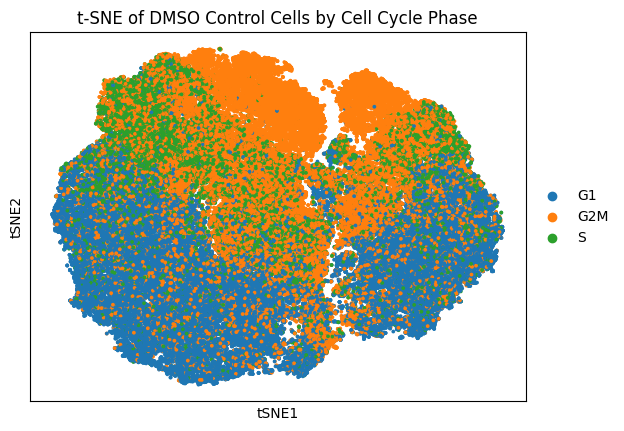

In [ ]:
# Define paths to all required files
scvi_adata_path = "/content/drive/MyDrive/TAHOE/scVI/scVI_CVCL_0546.h5ad"
obs_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/obs_metadata.parquet"

# ==============================================================================
# Part 2: Load and Prepare Data (with Memory-Efficient Loading)
# ==============================================================================
print("\n--- Step 2: Loading and Preparing Data ---")

try:
    # Load the main AnnData object
    print(f"Loading main AnnData object...")
    adata = sc.read_h5ad(scvi_adata_path)

    # EFFICIENTLY LOAD ONLY THE COLUMNS WE NEED
    barcode_column_name = 'BARCODE_SUB_LIB_ID'
    columns_to_load = [barcode_column_name, 'drug', 'phase']

    print(f"Loading only required columns {columns_to_load} from cell metadata...")
    obs_metadata_df = pd.read_parquet(obs_metadata_path, columns=columns_to_load)

    print("\n✅ All files loaded successfully!")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load one of the required files. Please check paths. Error: {e}")

# --- Merge Cell Metadata ---
print("Merging cell metadata...")

# Set the correct index on the metadata DataFrame before joining
if barcode_column_name in obs_metadata_df.columns:
    obs_metadata_df.set_index(barcode_column_name, inplace=True)
else:
    raise KeyError(f"❌ ERROR: The barcode column '{barcode_column_name}' was not found in the loaded metadata.")

# Join the required columns
adata.obs = adata.obs.join(obs_metadata_df[['drug', 'phase']])
adata = adata[~adata.obs['drug'].isnull()].copy()

if adata.n_obs == 0:
    raise ValueError("❌ ERROR: Merge failed. No cells remain after joining with metadata.")

print(f"✅ Cell metadata merged successfully. {adata.n_obs} cells remain.")


# ==============================================================================
# Part 3: Filter for DMSO and Generate Plot
# ==============================================================================
print("\n--- Step 3: Filtering for DMSO and Generating t-SNE Plot ---")

# --- IMPORTANT: Define the exact name for your DMSO/control treatment ---
# Based on the paper, 'DMSO_TF' is a likely name. You may need to change this.
control_drug_name = 'DMSO_TF'

# Check if the control drug name exists in the data
if control_drug_name not in adata.obs['drug'].unique():
    raise ValueError(f"❌ ERROR: The specified control name '{control_drug_name}' was not found in the 'drug' column.")

# --- Filter the data to keep ONLY the DMSO-treated cells ---
print(f"Filtering data to keep only '{control_drug_name}' treated cells...")
adata_dmso = adata[adata.obs['drug'] == control_drug_name].copy()
print(f"✅ Filtering complete. {adata_dmso.n_obs} cells remain for plotting.")


# --- Calculate and Plot t-SNE ---
# Check if the required data ('X_scVI' and the 'phase' column) exists
if 'X_scVI' in adata_dmso.obsm and 'phase' in adata_dmso.obs.columns:
    print("Calculating t-SNE based on X_scVI...")

    # We tell t-SNE to use the pre-calculated 'X_scVI' representation.
    sc.tl.tsne(adata_dmso, use_rep='X_scVI', n_jobs=-1)

    print("✅ t-SNE calculation complete!")

    # --- Generate the Final Plot ---
    print("Generating plot...")
    plt.figure(figsize=(12, 10))
    sc.pl.tsne(
        adata_dmso,
        color='phase',
        title=f't-SNE of DMSO Control Cells by Cell Cycle Phase',
        size=30  # Adjust point size if needed
    )
    plt.show()

else:
    print(f"\n❌ ERROR: Could not find the required data ('X_scVI' or 'phase') in the filtered DMSO data.")



What the Plot Shows
This t-SNE plot is a map of only your DMSO control cells—the cells that were not treated with any drug. Each dot is a single cell, and it is colored according to its phase in the cell division cycle:



* Blue (G1): Cells in the primary growth phase.

*   Green (S): Cells that are actively duplicating their DNA.


*   Orange (G2M): Cells that have finished duplicating their DNA and are preparing for, or are in the process of, dividing (mitosis).  




Interpretation: What Does This Result Mean?
The key observation here is that the colors are not randomly scattered. Instead, they form a clear, continuous structure that reflects the biological progression of the cell cycle.

A Continuous Path: You can almost trace a path through the plot. The cells start in the G1 phase (the large blue area at the bottom), transition through the S phase (the green cells forming a bridge), and end up in the G2M phase (the orange area at the top).

**Cell Cycle is a Major Driver of Variation**: This plot proves that even without any drug treatment, a major reason why two cells from the same cell line have different gene expression profiles is their position in the cell cycle. A cell in G1 is expressing different genes than a cell in G2M.


# UMAP DMSO vs. 5 drugs based on X.scVI

--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading and Preparing Data ---
Loading main AnnData object...
Loading only required columns ['BARCODE_SUB_LIB_ID', 'drug', 'phase'] from cell metadata...

✅ All files loaded successfully!
Merging cell metadata...
✅ Cell metadata merged successfully. 6040371 cells remain.

--- Step 3: Filtering for Comparison and Generating UMAP Plot ---
Selected for comparison against 'DMSO_TF':
- Sulfatinib
- Gallic acid
- Larotrectinib sulfate
- Benztropine (mesylate)
- Temuterkib

✅ Filtering complete. 217483 cells remain for plotting.
Calculating UMAP based on X_scVI...
Computing neighborhood graph...
Calculating UMAP layout...
✅ UMAP calculation complete!
Generating plot...


<Figure size 1400x1000 with 0 Axes>

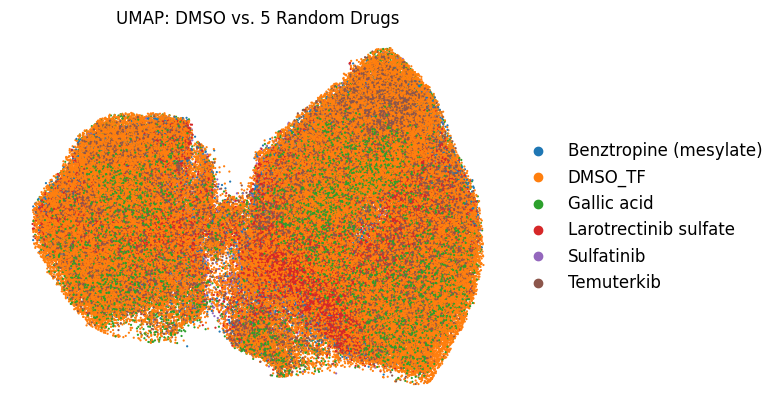

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading All Data Sources
# ==============================================================================
import os
import random
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths to all required files
scvi_adata_path = "/content/drive/MyDrive/TAHOE/scVI/scVI_CVCL_0546.h5ad"
obs_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/obs_metadata.parquet"

# ==============================================================================
# Part 2: Load and Prepare Data (with Memory-Efficient Loading)
# ==============================================================================
print("\n--- Step 2: Loading and Preparing Data ---")

try:
    # Load the main AnnData object
    print(f"Loading main AnnData object...")
    adata = sc.read_h5ad(scvi_adata_path)

    # EFFICIENTLY LOAD ONLY THE COLUMNS WE NEED
    barcode_column_name = 'BARCODE_SUB_LIB_ID'
    columns_to_load = [barcode_column_name, 'drug', 'phase']

    print(f"Loading only required columns {columns_to_load} from cell metadata...")
    obs_metadata_df = pd.read_parquet(obs_metadata_path, columns=columns_to_load)

    print("\n✅ All files loaded successfully!")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load one of the required files. Please check paths. Error: {e}")

# --- Merge Cell Metadata ---
print("Merging cell metadata...")

# Set the correct index on the metadata DataFrame before joining
if barcode_column_name in obs_metadata_df.columns:
    obs_metadata_df.set_index(barcode_column_name, inplace=True)
else:
    raise KeyError(f"❌ ERROR: The barcode column '{barcode_column_name}' was not found in the loaded metadata.")

# Join the required columns
adata.obs = adata.obs.join(obs_metadata_df[['drug', 'phase']])
adata = adata[~adata.obs['drug'].isnull()].copy()

if adata.n_obs == 0:
    raise ValueError("❌ ERROR: Merge failed. No cells remain after joining with metadata.")

print(f"✅ Cell metadata merged successfully. {adata.n_obs} cells remain.")


# ==============================================================================
# Part 3: Filter for DMSO and 5 Random Drugs, then Generate UMAP Plot
# ==============================================================================
print("\n--- Step 3: Filtering for Comparison and Generating UMAP Plot ---")

# --- Define the control and select 5 random drugs for comparison ---
control_drug_name = 'DMSO_TF'
all_drugs = adata.obs['drug'].unique().tolist()

# Ensure the control drug name exists
if control_drug_name not in all_drugs:
    raise ValueError(f"❌ ERROR: The specified control name '{control_drug_name}' was not found in the 'drug' column.")

# Get a list of all other drugs to choose from
other_drugs = [d for d in all_drugs if d != control_drug_name]
if len(other_drugs) < 5:
     raise ValueError("❌ ERROR: Fewer than 5 other drugs found in the data to compare against DMSO.")

# Randomly select 5 drugs to compare
random_drugs_to_compare = random.sample(other_drugs, 5)
print(f"Selected for comparison against '{control_drug_name}':")
for drug in random_drugs_to_compare:
    print(f"- {drug}")


# --- Filter the data to keep ONLY the selected groups ---
drugs_to_keep = [control_drug_name] + random_drugs_to_compare
adata_comparison = adata[adata.obs['drug'].isin(drugs_to_keep)].copy()
print(f"\n✅ Filtering complete. {adata_comparison.n_obs} cells remain for plotting.")


# --- Calculate and Plot UMAP ---
# Check if the required 'X_scVI' embedding exists
if 'X_scVI' in adata_comparison.obsm:
    print("Calculating UMAP based on X_scVI...")

    # --- FIX: We must compute the neighbor graph before running UMAP ---
    # We tell it to use the X_scVI embedding to find the neighbors.
    print("Computing neighborhood graph...")
    sc.pp.neighbors(adata_comparison, use_rep='X_scVI')
    # --- END FIX ---

    print("Calculating UMAP layout...")
    sc.tl.umap(adata_comparison)

    print("✅ UMAP calculation complete!")

    # --- Generate the Final Plot ---
    print("Generating plot...")
    plt.figure(figsize=(14, 10))
    sc.pl.umap(
        adata_comparison,
        color='drug',  # Color by drug to see the comparison
        title=f'UMAP: DMSO vs. 5 Random Drugs',
        size=10, # Use a smaller point size for clarity with many cells
        legend_fontsize='large',
        frameon=False
    )
    plt.show()

else:
    print(f"\n❌ ERROR: Could not find the required 'X_scVI' embedding in the filtered data.")



# The UMAP algorithm places cells with similar gene expression profiles close together!

### Interpretation: What Does This Result Mean?

There are two key observations in this plot:

1.  **Two Major Clusters:** The cells are separated into two large, distinct "continents." Based on your previous plots, this separation is almost certainly being driven by the **cell cycle**. The cluster on the left might be cells in the G1 phase, while the larger cluster on the right represents cells in the S and G2/M phases.

2.  **Complete Mixing of Colors:** This is the most important finding for your drug comparison. Within each of the two large clusters, all six colors are thoroughly mixed together. There are **no distinct regions** where one color (one drug) dominates.

# Other columns in obs_metadata!

--- Step 1: Mounting Google Drive and Loading Data ---
Mounted at /content/drive
Analyzing files: ['Saquinavir.h5ad', 'Pemetrexed.h5ad', 'Trifluridine.h5ad', 'GSK1059615.h5ad', 'Filgotinib.h5ad']

✅ Data successfully combined!

--- Step 2: Calculating UMAP ---
✅ UMAP calculation complete.

--- Step 3: Generating Plots ---
Generating QC violin plots...


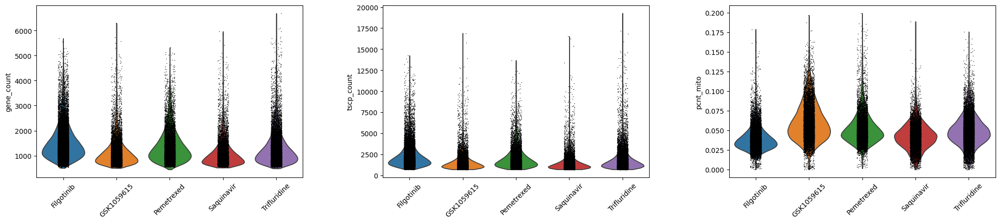

<Figure size 640x480 with 0 Axes>


Generating UMAPs colored by cell cycle scores...


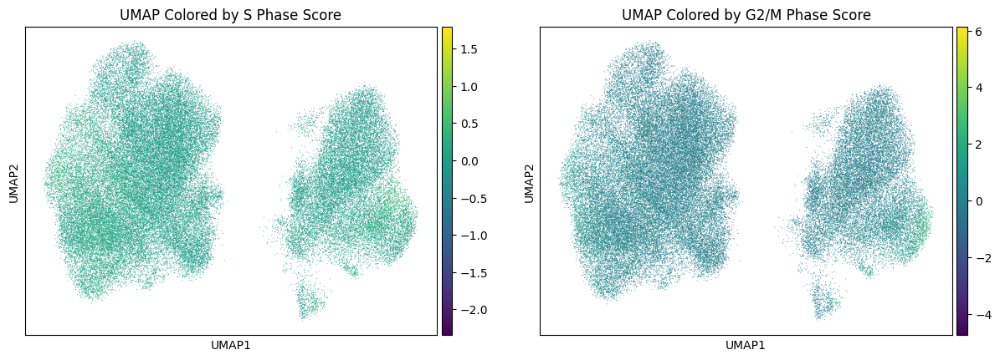


Generating cell cycle score scatter plot...


<Figure size 800x800 with 0 Axes>

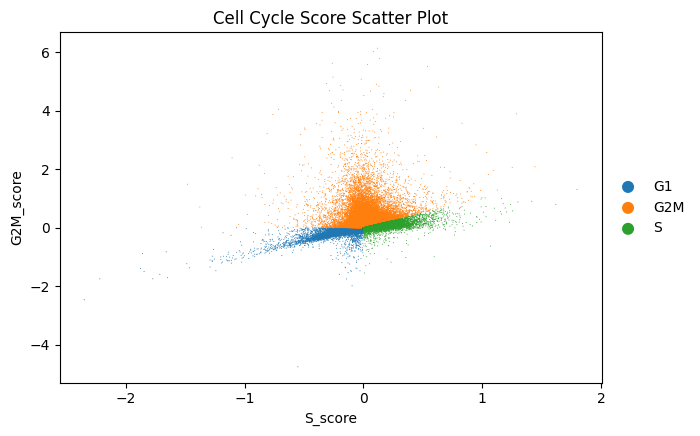

In [ ]:
# ==============================================================================
# Part 1: Setup and Data Loading
# This section loads a subset of 5 files for analysis.
# ==============================================================================
import os
import random
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Loading Data ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"

# --- Select 5 random files to analyze ---
all_h5ad_files = [f for f in os.listdir(data_folder) if f.endswith('.h5ad')]
if len(all_h5ad_files) >= 5:
    files_to_load = random.sample(all_h5ad_files, 5)
else:
    files_to_load = all_h5ad_files
print(f"Analyzing files: {files_to_load}")

# --- Load and combine the data ---
adata_list = []
for file_name in files_to_load:
    try:
        adata_single = sc.read_h5ad(os.path.join(data_folder, file_name))
        drug_label = file_name.replace('.h5ad', '')
        adata_single.obs['drug'] = drug_label
        adata_list.append(adata_single)
    except Exception as e:
        print(f"--> WARNING: Could not load file {file_name}. Error: {e}")

if not adata_list:
    raise RuntimeError("Could not load any valid files.")

adata = sc.concat(adata_list)
print("\n✅ Data successfully combined!")


# ==============================================================================
# Part 2: UMAP Calculation (needed for some plots)
# ==============================================================================
print("\n--- Step 2: Calculating UMAP ---")
# We need to run the standard workflow to get the UMAP embedding
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.highly_variable_genes(adata)
sc.tl.pca(adata)
sc.pp.neighbors(adata)
sc.tl.umap(adata)
print("✅ UMAP calculation complete.")


# ==============================================================================
# Part 3: Generating New EDA Plots
# ==============================================================================
print("\n--- Step 3: Generating Plots ---")

# --- Plot 1: Compare Cell Health and Quality Across Drugs ---
print("Generating QC violin plots...")
qc_metrics = ['gene_count', 'tscp_count', 'pcnt_mito']

# --- FIX: Removed the 'title' argument from the function call ---
sc.pl.violin(
    adata,
    keys=qc_metrics,
    groupby='drug',
    rotation=45,
    multi_panel=True, # Creates a separate panel for each metric
)
# --- FIX: Set the title manually using plt.suptitle for multi-panel plots ---
plt.suptitle("Cell Quality Metrics by Drug Treatment", y=1.02)
plt.show()


# --- Plot 2: Visualize the Continuous Cell Cycle Scores on UMAP ---
print("\nGenerating UMAPs colored by cell cycle scores...")
# We will plot S_score and G2M_score side-by-side
sc.pl.umap(
    adata,
    color=['S_score', 'G2M_score'],
    title=['UMAP Colored by S Phase Score', 'UMAP Colored by G2/M Phase Score'],
    cmap='viridis' # Use a vibrant colormap
)


# --- Plot 3: Scatter Plot of Cell Cycle Scores ---
print("\nGenerating cell cycle score scatter plot...")
# We create this plot manually using matplotlib for more control
plt.figure(figsize=(8, 8))
sc.pl.scatter(
    adata,
    x='S_score',
    y='G2M_score',
    color='phase', # Color the points by their discrete phase
    title="Cell Cycle Score Scatter Plot",
    show=False # We call plt.show() manually
)
plt.show()



### What the Plot Shows

This is a **scatter plot** where each tiny dot represents a single cell. Instead of being a UMAP or t-SNE map, the position of each cell is determined directly by two scores:

* **X-axis (`S_score`):** A numerical score indicating how strongly each cell is expressing genes associated with the **S phase** (when the cell duplicates its DNA). A higher score means more S-phase activity.
* **Y-axis (`G2M_score`):** A numerical score indicating how strongly each cell is expressing genes associated with the **G2 and M phases** (when the cell prepares for and undergoes division/mitosis). A higher score means more G2/M-phase activity.
* **Color:** The dots are colored by the discrete `'phase'` category that was assigned to them, which helps us confirm what we are seeing.

### Interpretation: What Does This Result Mean?

This plot beautifully visualizes the progression of the cell cycle as a distinct "Y" shape.

1.  **G1 Phase (Blue dots):** These cells form the large cluster at the bottom left, centered around (0,0). This is because cells in the G1 (growth) phase have low expression of both S-phase genes and G2/M-phase genes. This is their baseline or "resting" state.
2.  **S Phase (Green dots):** As cells decide to divide, they enter the S phase. You can see them moving from the G1 cluster to the right, forming the horizontal arm of the "Y". These cells have a high `S_score` (they are expressing DNA replication genes) but still have a low `G2M_score`.
3.  **G2/M Phase (Orange dots):** After finishing DNA replication, cells move into the G2/M phase. On the plot, this corresponds to the vertical arm of the "Y". These cells now have a high `G2M_score` (they are expressing division genes) and their `S_score` has decreased.

# 3rd week's task 1st:


--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading Adagrasib and DMSO Source Files ---
✅ Successfully loaded Adagrasib.h5ad
✅ Successfully loaded DMSO_TF.h5ad

✅ Combined data object created with a total of 232459 cells.

--- Step 3: Finding Most Variant Genes ---
Subsampling data from 232459 to 5000 cells...
✅ Subsampling complete. Using 5000 cells for analysis.
Normalizing data...
Logarithmizing data...
Running differential expression test (this should be much faster now)...
✅ Differential expression analysis complete.
✅ Gene IDs mapped to symbols.

--- Step 4: Generating Visualizations ---
Generating Dot Plot...


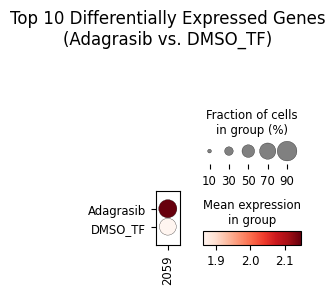


Generating Heatmap...


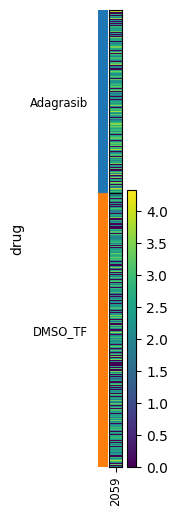

<Figure size 640x480 with 0 Axes>

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# This super-lightweight version loads only two small source files.
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths to the individual source files and gene metadata
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# ==============================================================================
# Part 2: Load Only the Two Files Needed for Comparison
# ==============================================================================
print("\n--- Step 2: Loading Adagrasib and DMSO Source Files ---")

drug_name = 'Adagrasib'
control_name = 'DMSO_TF'

adata_list = []
# Load the Adagrasib source file
try:
    adata_drug = sc.read_h5ad(os.path.join(source_data_folder, f"{drug_name}.h5ad"))
    adata_drug.obs['drug'] = drug_name
    adata_list.append(adata_drug)
    print(f"✅ Successfully loaded {drug_name}.h5ad")
except Exception as e:
    raise RuntimeError(f"❌ ERROR: Could not load source file for {drug_name}. Error: {e}")

# Load the DMSO source file
try:
    adata_control = sc.read_h5ad(os.path.join(source_data_folder, f"{control_name}.h5ad"))
    adata_control.obs['drug'] = control_name
    adata_list.append(adata_control)
    print(f"✅ Successfully loaded {control_name}.h5ad")
except Exception as e:
    raise RuntimeError(f"❌ ERROR: Could not load source file for {control_name}. Error: {e}")

# Combine the two small datasets
adata_comp = sc.concat(adata_list)
print(f"\n✅ Combined data object created with a total of {adata_comp.n_obs} cells.")


# ==============================================================================
# Part 3: Perform Differential Expression Analysis
# ==============================================================================
print("\n--- Step 3: Finding Most Variant Genes ---")

# --- Subsample the data to make the analysis much faster ---
max_cells = 5000  # Use a maximum of 5000 cells total
if adata_comp.n_obs > max_cells:
    print(f"Subsampling data from {adata_comp.n_obs} to {max_cells} cells...")
    sc.pp.subsample(adata_comp, n_obs=max_cells, random_state=42)
    print(f"✅ Subsampling complete. Using {adata_comp.n_obs} cells for analysis.")

# --- Add essential preprocessing steps before ranking genes ---
# 1. Normalize total counts per cell
print("Normalizing data...")
sc.pp.normalize_total(adata_comp, target_sum=1e4)
# 2. Logarithmize the data
print("Logarithmizing data...")
sc.pp.log1p(adata_comp)

# --- Perform Differential Expression Test ---
# This ranks genes by how much they differ between the two groups.
print("Running differential expression test (this should be much faster now)...")
sc.tl.rank_genes_groups(
    adata_comp,
    groupby='drug',
    groups=[drug_name],
    reference=control_name,
    method='wilcoxon'
)
print("✅ Differential expression analysis complete.")

# --- Map Gene IDs to Symbols in the results ---
try:
    gene_metadata_df = pd.read_parquet(gene_metadata_path)
    id_to_symbol_map = gene_metadata_df.set_index('ensembl_id')['gene_symbol'].to_dict()
    de_results = adata_comp.uns['rank_genes_groups']
    de_results['names'] = [[id_to_symbol_map.get(gene_id, gene_id) for gene_id in group] for group in de_results['names']]
    print("✅ Gene IDs mapped to symbols.")
except Exception as e:
    print(f"--> Warning: Could not map gene IDs to symbols. Plots will use IDs. Error: {e}")


# ==============================================================================
# Part 4: Visualization
# ==============================================================================
print("\n--- Step 4: Generating Visualizations ---")

# --- Plot 1: Dot Plot of Top Differentially Expressed Genes ---
print("Generating Dot Plot...")

# Manually extract top genes and use the standard sc.pl.dotplot
top_genes = adata_comp.uns['rank_genes_groups']['names'][0]

# Create the dot plot using the extracted gene names
sc.pl.dotplot(
    adata_comp,
    var_names=top_genes[:10], # Plot the top 10 genes
    groupby='drug',
    title=f'Top 10 Differentially Expressed Genes\n({drug_name} vs. {control_name})'
)


# --- Plot 2: Heatmap of Top Variant Genes ---
print("\nGenerating Heatmap...")
# --- FIX: Replaced the failing function with the more direct sc.pl.heatmap ---
# We use the 'top_genes' list we already extracted.
sc.pl.heatmap(
    adata_comp,
    var_names=top_genes[:25], # Use the top 25 genes for the heatmap
    groupby='drug'
    # The title argument is removed from here
)
# And set the title manually using matplotlib
plt.suptitle("Top 25 Most Variant Genes", y=1.02, fontsize=14)
plt.show()
# --- END FIX ---



--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading Adagrasib and DMSO Source Files ---
✅ Successfully loaded Adagrasib.h5ad
✅ Successfully loaded DMSO_TF.h5ad

✅ Combined data object created with a total of 232459 cells.

--- Step 3: Finding the Most Variant Gene ---
Normalizing and logarithmizing data...
Running differential expression test...
✅ Differential expression analysis complete.

--- Step 4: Identifying and Visualizing the Top Gene ---

      RESULTS: MOST SIGNIFICANTLY VARIANT GENE
Comparison:         'Adagrasib' vs. 'DMSO_TF'
------------------------------------------------------------
Top Gene Symbol:     21434
Ensembl ID:          21434
------------------------------------------------------------
Statistical Significance:
  Log2 Fold Change:    0.1212
  P-Value:             0.0000e+00
  Adjusted P-Value:    0.0000e+00

Generating violin plot for the top gene...


<Figure size 800x600 with 0 Axes>

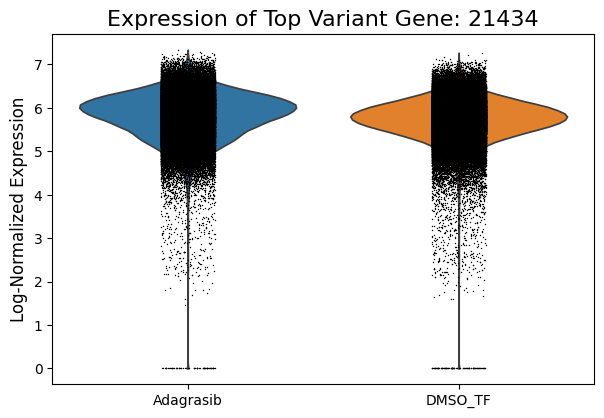

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# This lightweight version loads only the two required source files.
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths to the individual source files and gene metadata
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# ==============================================================================
# Part 2: Load Data for Comparison
# ==============================================================================
print("\n--- Step 2: Loading Adagrasib and DMSO Source Files ---")

drug_name = 'Adagrasib'
control_name = 'DMSO_TF'

adata_list = []
# Load the Adagrasib source file
try:
    adata_drug = sc.read_h5ad(os.path.join(source_data_folder, f"{drug_name}.h5ad"))
    adata_drug.obs['drug'] = drug_name
    adata_list.append(adata_drug)
    print(f"✅ Successfully loaded {drug_name}.h5ad")
except Exception as e:
    raise RuntimeError(f"❌ ERROR: Could not load source file for {drug_name}. Error: {e}")

# Load the DMSO source file
try:
    adata_control = sc.read_h5ad(os.path.join(source_data_folder, f"{control_name}.h5ad"))
    adata_control.obs['drug'] = control_name
    adata_list.append(adata_control)
    print(f"✅ Successfully loaded {control_name}.h5ad")
except Exception as e:
    raise RuntimeError(f"❌ ERROR: Could not load source file for {control_name}. Error: {e}")

# Combine the two datasets
adata_comp = sc.concat(adata_list)
print(f"\n✅ Combined data object created with a total of {adata_comp.n_obs} cells.")


# ==============================================================================
# Part 3: Find the Most Variant Gene
# ==============================================================================
print("\n--- Step 3: Finding the Most Variant Gene ---")

# --- Preprocessing is crucial for an accurate statistical test ---
print("Normalizing and logarithmizing data...")
sc.pp.normalize_total(adata_comp, target_sum=1e4)
sc.pp.log1p(adata_comp)

# --- Perform Differential Expression Test ---
# This ranks all genes by how significantly they differ between the two groups.
print("Running differential expression test...")
sc.tl.rank_genes_groups(
    adata_comp,
    groupby='drug',
    groups=[drug_name],
    reference=control_name,
    method='wilcoxon'
)
print("✅ Differential expression analysis complete.")

# --- Extract the Top Gene and its Statistics ---
# The results are stored in the .uns attribute of the AnnData object.
results = adata_comp.uns['rank_genes_groups']
# The top gene is the first one in the 'names' list for our drug group.
top_gene_id = results['names'][drug_name][0]
# --- NEW: Extract the significance scores for the top gene ---
log2_fold_change = results['logfoldchanges'][drug_name][0]
p_value = results['pvals'][drug_name][0]
adj_p_value = results['pvals_adj'][drug_name][0]
# --- END NEW ---


# ==============================================================================
# Part 4: Map Gene ID to Symbol and Display Results
# ==============================================================================
print("\n--- Step 4: Identifying and Visualizing the Top Gene ---")

# --- Use the gene_metadata file to get the human-readable name ---
try:
    gene_metadata_df = pd.read_parquet(gene_metadata_path)
    # Create a dictionary mapping ensembl_id to gene_symbol
    id_to_symbol_map = gene_metadata_df.set_index('ensembl_id')['gene_symbol'].to_dict()
    # Look up the symbol for our top gene
    top_gene_symbol = id_to_symbol_map.get(top_gene_id, top_gene_id) # Defaults to ID if not found
except Exception as e:
    print(f"--> Warning: Could not map gene ID to symbol. Using ID. Error: {e}")
    top_gene_symbol = top_gene_id

# --- Print a Clear Summary of the Result ---
print("\n" + "="*60)
print("      RESULTS: MOST SIGNIFICANTLY VARIANT GENE")
print("="*60)
print(f"Comparison:         '{drug_name}' vs. '{control_name}'")
print("-" * 60)
print(f"Top Gene Symbol:     {top_gene_symbol}")
print(f"Ensembl ID:          {top_gene_id}")
print("-" * 60)
print("Statistical Significance:")
print(f"  Log2 Fold Change:    {log2_fold_change:.4f}")
print(f"  P-Value:             {p_value:.4e}")
print(f"  Adjusted P-Value:    {adj_p_value:.4e}")
print("="*60)


# --- Create a Violin Plot to Visualize the Difference ---
print("\nGenerating violin plot for the top gene...")
plt.figure(figsize=(8, 6))
sc.pl.violin(
    adata_comp,
    keys=top_gene_id,
    groupby='drug',
    rotation=0,
    show=False
)
plt.title(f"Expression of Top Variant Gene: {top_gene_symbol}", fontsize=16)
plt.ylabel("Log-Normalized Expression", fontsize=12)
plt.show()



--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading and Preparing Cell Metadata ---
Loading only required columns ['drug', 'phase'] from cell metadata...

✅ Metadata loaded successfully!

--- Step 3: Calculating Cell Cycle Effects for Random Drugs ---
Analyzing 15 randomly selected drugs against DMSO_TF...
✅ Calculation of log2 odds ratios complete.

--- Step 4: Generating Visualization ---


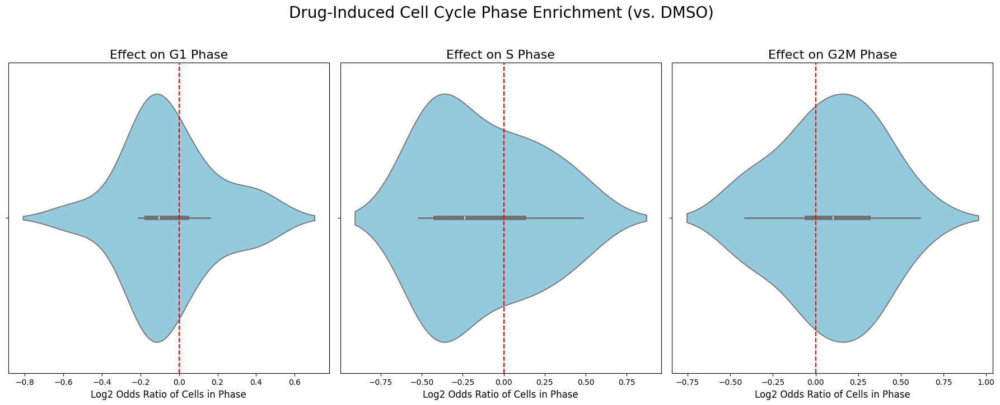

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading Metadata
# This memory-efficient approach only loads the small metadata file.
# ==============================================================================
import os
import random
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define path to the cell metadata file
obs_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/obs_metadata.parquet"

# ==============================================================================
# Part 2: Load and Prepare Data
# ==============================================================================
print("\n--- Step 2: Loading and Preparing Cell Metadata ---")

try:
    # EFFICIENTLY LOAD ONLY THE COLUMNS WE NEED
    columns_to_load = ['drug', 'phase']
    print(f"Loading only required columns {columns_to_load} from cell metadata...")
    obs_df = pd.read_parquet(obs_metadata_path, columns=columns_to_load)
    print("\n✅ Metadata loaded successfully!")
except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load the metadata file. Please check the path. Error: {e}")

# Remove any rows with missing data to ensure clean calculations
obs_df.dropna(inplace=True)


# ==============================================================================
# Part 3: Calculate Log2 Odds Ratios for Cell Cycle Phase
# ==============================================================================
print("\n--- Step 3: Calculating Cell Cycle Effects for Random Drugs ---")

# --- Define the control and select random drugs for comparison ---
control_name = 'DMSO_TF'
all_drugs = obs_df['drug'].unique().tolist()

if control_name not in all_drugs:
    raise ValueError(f"❌ ERROR: The specified control name '{control_name}' was not found.")

other_drugs = [d for d in all_drugs if d != control_name]
if len(other_drugs) < 15:
    selected_drugs = other_drugs
else:
    selected_drugs = random.sample(other_drugs, 15)

print(f"Analyzing {len(selected_drugs)} randomly selected drugs against {control_name}...")

# --- Calculate base proportions in the control group ---
control_df = obs_df[obs_df['drug'] == control_name]
control_counts = control_df['phase'].value_counts()
control_total = len(control_df)

# --- Loop through drugs to calculate log2 odds ratio for each phase ---
results = []
phases = ['G1', 'S', 'G2M']

for drug_name in selected_drugs:
    drug_df = obs_df[obs_df['drug'] == drug_name]
    drug_counts = drug_df['phase'].value_counts()
    drug_total = len(drug_df)

    for phase in phases:
        # Get counts for the current phase, default to 0 if not present
        count_drug = drug_counts.get(phase, 0)
        count_control = control_counts.get(phase, 0)

        # Calculate non-phase counts
        non_count_drug = drug_total - count_drug
        non_count_control = control_total - count_control

        # To avoid division by zero, we add a small pseudocount (1)
        if count_drug == 0 or non_count_drug == 0 or count_control == 0 or non_count_control == 0:
            odds_ratio = np.nan # Cannot calculate, mark as Not a Number
        else:
            odds_drug = count_drug / non_count_drug
            odds_control = count_control / non_count_control
            odds_ratio = odds_drug / odds_control

        log2_odds_ratio = np.log2(odds_ratio) if not np.isnan(odds_ratio) else np.nan

        results.append({'drug': drug_name, 'phase': phase, 'log2_odds_ratio': log2_odds_ratio})

# Convert results to a DataFrame for plotting
results_df = pd.DataFrame(results).dropna()
print("✅ Calculation of log2 odds ratios complete.")


# ==============================================================================
# Part 4: Visualization (Replicating Figure 6C)
# ==============================================================================
print("\n--- Step 4: Generating Visualization ---")

# Create a figure with 3 subplots, one for each phase
fig, axes = plt.subplots(1, 3, figsize=(18, 7), sharey=True)

for i, phase in enumerate(phases):
    # Filter data for the current phase
    phase_data = results_df[results_df['phase'] == phase]

    # Create a violin plot
    sns.violinplot(
        ax=axes[i],
        data=phase_data,
        x='log2_odds_ratio',
        orient='h',
        color='skyblue',
        inner='box' # Adds a boxplot inside the violin
    )
    axes[i].set_title(f'Effect on {phase} Phase', fontsize=16)
    axes[i].set_xlabel('Log2 Odds Ratio of Cells in Phase', fontsize=12)
    axes[i].axvline(0, color='red', linestyle='--') # Add a line at 0 for reference

plt.suptitle("Drug-Induced Cell Cycle Phase Enrichment (vs. DMSO)", fontsize=20, y=1.03)
plt.tight_layout()
plt.show()



--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading and Preparing Cell Metadata ---
Loading only required columns ['drug', 'phase'] from cell metadata...

✅ Metadata loaded successfully!

--- Step 3: Calculating Cell Cycle Effects for a Random Sample of Drugs ---
Analyzing a random sample of 30 drugs against DMSO_TF...
✅ Calculation of log2 odds ratios complete.

--- Step 4: Generating Visualization of Drug Effects per Phase ---


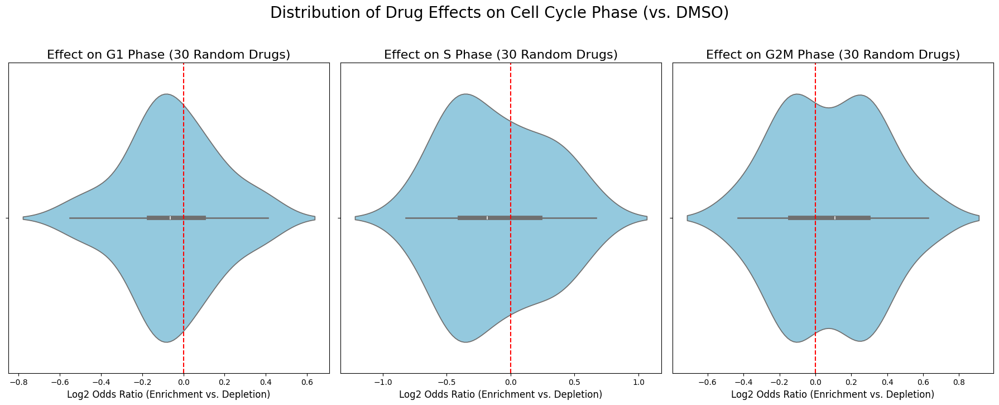

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading Metadata
# This memory-efficient approach only loads the small metadata file.
# ==============================================================================
import os
import random
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define path to the cell metadata file
obs_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/obs_metadata.parquet"

# ==============================================================================
# Part 2: Load and Prepare Data
# ==============================================================================
print("\n--- Step 2: Loading and Preparing Cell Metadata ---")

try:
    # EFFICIENTLY LOAD ONLY THE COLUMNS WE NEED
    columns_to_load = ['drug', 'phase']
    print(f"Loading only required columns {columns_to_load} from cell metadata...")
    obs_df = pd.read_parquet(obs_metadata_path, columns=columns_to_load)
    print("\n✅ Metadata loaded successfully!")
except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load the metadata file. Please check the path. Error: {e}")

# Remove any rows with missing data to ensure clean calculations
obs_df.dropna(inplace=True)


# ==============================================================================
# Part 3: Calculate Log2 Odds Ratios for Cell Cycle Phase
# ==============================================================================
print("\n--- Step 3: Calculating Cell Cycle Effects for a Random Sample of Drugs ---")

# --- Define the control and get a list of all other drugs ---
control_name = 'DMSO_TF'
all_drugs = obs_df['drug'].unique().tolist()

if control_name not in all_drugs:
    raise ValueError(f"❌ ERROR: The specified control name '{control_name}' was not found.")

other_drugs = [d for d in all_drugs if d != control_name]

# --- MODIFICATION: Select a random sample of 30 drugs to make the script lighter ---
if len(other_drugs) < 30:
    selected_drugs = other_drugs
else:
    selected_drugs = random.sample(other_drugs, 30)
print(f"Analyzing a random sample of {len(selected_drugs)} drugs against {control_name}...")
# --- END MODIFICATION ---


# --- Calculate base proportions in the control group ---
control_df = obs_df[obs_df['drug'] == control_name]
control_counts = control_df['phase'].value_counts()
control_total = len(control_df)

# --- Loop through the sampled drugs to calculate log2 odds ratio for each phase ---
results = []
phases = ['G1', 'S', 'G2M']

for drug_name in selected_drugs: # Loop through the smaller list of drugs
    drug_df = obs_df[obs_df['drug'] == drug_name]
    drug_counts = drug_df['phase'].value_counts()
    drug_total = len(drug_df)

    for phase in phases:
        count_drug = drug_counts.get(phase, 0)
        count_control = control_counts.get(phase, 0)
        non_count_drug = drug_total - count_drug
        non_count_control = control_total - count_control

        if count_drug == 0 or non_count_drug == 0 or count_control == 0 or non_count_control == 0:
            odds_ratio = np.nan
        else:
            odds_drug = count_drug / non_count_drug
            odds_control = count_control / non_count_control
            odds_ratio = odds_drug / odds_control

        log2_odds_ratio = np.log2(odds_ratio) if not np.isnan(odds_ratio) else np.nan

        results.append({'drug': drug_name, 'phase': phase, 'log2_odds_ratio': log2_odds_ratio})

# Convert results to a DataFrame for plotting
results_df = pd.DataFrame(results).dropna()
print("✅ Calculation of log2 odds ratios complete.")


# ==============================================================================
# Part 4: Visualization - Lighter Violin Plot Version
# ==============================================================================
print("\n--- Step 4: Generating Visualization of Drug Effects per Phase ---")

# --- MODIFICATION: Using violin plots, which are better for showing distributions of a sample ---
# Create a figure with 3 subplots, one for each phase
fig, axes = plt.subplots(1, 3, figsize=(18, 7), sharey=True)

for i, phase in enumerate(phases):
    # Filter data for the current phase
    phase_data = results_df[results_df['phase'] == phase]

    # Create a violin plot
    sns.violinplot(
        ax=axes[i],
        data=phase_data,
        x='log2_odds_ratio',
        orient='h',
        color='skyblue',
        inner='box' # Adds a boxplot inside the violin
    )
    axes[i].set_title(f'Effect on {phase} Phase (30 Random Drugs)', fontsize=16)
    axes[i].set_xlabel('Log2 Odds Ratio (Enrichment vs. Depletion)', fontsize=12)
    axes[i].axvline(0, color='red', linestyle='--') # Add a line at 0 for reference

plt.suptitle("Distribution of Drug Effects on Cell Cycle Phase (vs. DMSO)", fontsize=20, y=1.03)
plt.tight_layout()
plt.show()
# --- END MODIFICATION ---



--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading Adagrasib and DMSO Source Files ---
✅ Successfully loaded Adagrasib.h5ad
✅ Successfully loaded DMSO_TF.h5ad

✅ Combined data object created with a total of 232459 cells.

--- Step 3: Calculating Cell Cycle Effects ---

Cell counts per condition:
phase         G1    G2M      S
drug                          
Adagrasib  43109  37705  12421
DMSO_TF    63030  55330  20864

✅ Calculation of log2 odds ratios complete.

--- Step 4: Visualizing Cell Cycle Effects ---

      RESULTS: CELL CYCLE ANALYSIS
phase  log2_odds_ratio
   G1         0.056069
    S        -0.197730
  G2M         0.041994
Interpretation:
A positive log2 odds ratio means the drug enriches for that phase (arrest).
A negative log2 odds ratio means the drug depletes that phase.

Generating bar plot...


/tmp/ipython-input-4-2825126454.py:119: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


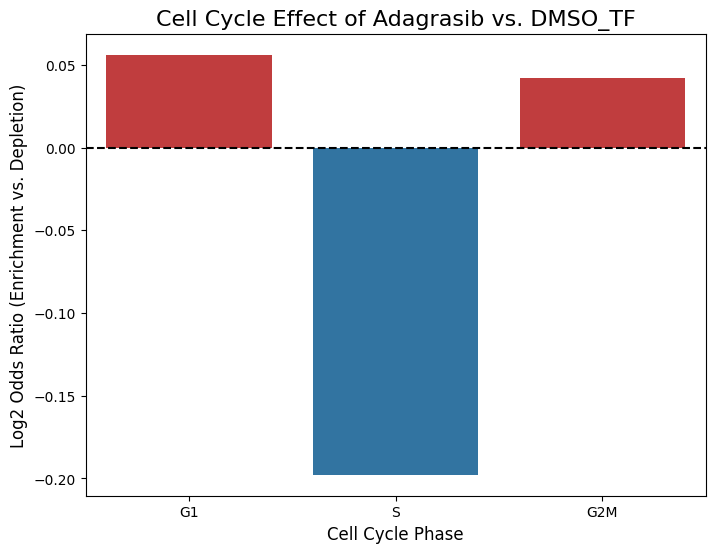

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# This lightweight version loads only the two required source files.
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths to the individual source files
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"

# ==============================================================================
# Part 2: Load Data for Comparison
# ==============================================================================
print("\n--- Step 2: Loading Adagrasib and DMSO Source Files ---")

drug_name = 'Adagrasib'
control_name = 'DMSO_TF'

adata_list = []
# Load the Adagrasib and DMSO source files
try:
    adata_drug = sc.read_h5ad(os.path.join(source_data_folder, f"{drug_name}.h5ad"))
    adata_drug.obs['drug'] = drug_name
    adata_list.append(adata_drug)
    print(f"✅ Successfully loaded {drug_name}.h5ad")

    adata_control = sc.read_h5ad(os.path.join(source_data_folder, f"{control_name}.h5ad"))
    adata_control.obs['drug'] = control_name
    adata_list.append(adata_control)
    print(f"✅ Successfully loaded {control_name}.h5ad")
except Exception as e:
    raise RuntimeError(f"❌ ERROR: Could not load source files. Error: {e}")

# Combine the two datasets
adata_comp = sc.concat(adata_list)
print(f"\n✅ Combined data object created with a total of {adata_comp.n_obs} cells.")


# ==============================================================================
# Part 3: Calculate Log2 Odds Ratios for Cell Cycle Phase
# ==============================================================================
print("\n--- Step 3: Calculating Cell Cycle Effects ---")

# Check if the 'phase' column exists in the metadata
if 'phase' not in adata_comp.obs.columns:
    raise KeyError("❌ ERROR: The required 'phase' column was not found in the cell metadata.")

# --- Create a contingency table of counts (Drug vs. Phase) ---
# This is an efficient way to get all the counts we need
contingency_table = pd.crosstab(adata_comp.obs['drug'], adata_comp.obs['phase'])
print("\nCell counts per condition:")
print(contingency_table)

# --- Loop through each phase to calculate the odds ratio ---
results = []
phases = ['G1', 'S', 'G2M']

for phase in phases:
    # Get counts for the current phase
    count_drug = contingency_table.loc[drug_name, phase]
    count_control = contingency_table.loc[control_name, phase]

    # Get total counts for each group
    total_drug = contingency_table.loc[drug_name].sum()
    total_control = contingency_table.loc[control_name].sum()

    # Calculate non-phase counts
    non_count_drug = total_drug - count_drug
    non_count_control = total_control - count_control

    # To avoid division by zero, we add a small pseudocount (1)
    if count_drug == 0 or non_count_drug == 0 or count_control == 0 or non_count_control == 0:
        odds_ratio = np.nan # Cannot calculate
    else:
        odds_drug = count_drug / non_count_drug
        odds_control = count_control / non_count_control
        odds_ratio = odds_drug / odds_control

    log2_odds_ratio = np.log2(odds_ratio) if not np.isnan(odds_ratio) else np.nan

    results.append({'phase': phase, 'log2_odds_ratio': log2_odds_ratio})

# Convert results to a DataFrame
results_df = pd.DataFrame(results).dropna()
print("\n✅ Calculation of log2 odds ratios complete.")


# ==============================================================================
# Part 4: Display Results and Visualize
# ==============================================================================
print("\n--- Step 4: Visualizing Cell Cycle Effects ---")

# --- Print a Clear Summary of the Result ---
print("\n" + "="*50)
print("      RESULTS: CELL CYCLE ANALYSIS")
print("="*50)
print(results_df.to_string(index=False))
print("="*50)
print("Interpretation:")
print("A positive log2 odds ratio means the drug enriches for that phase (arrest).")
print("A negative log2 odds ratio means the drug depletes that phase.")
print("="*50)


# --- Create a Bar Plot to Visualize the Difference ---
print("\nGenerating bar plot...")
plt.figure(figsize=(8, 6))
# Create a color palette based on positive/negative effect
palette = ['#d62728' if x > 0 else '#1f77b4' for x in results_df['log2_odds_ratio']]

sns.barplot(
    data=results_df,
    x='phase',
    y='log2_odds_ratio',
    palette=palette
)

plt.axhline(0, color='black', linestyle='--') # Add a line at 0 for reference
plt.title(f'Cell Cycle Effect of {drug_name} vs. {control_name}', fontsize=16)
plt.xlabel("Cell Cycle Phase", fontsize=12)
plt.ylabel("Log2 Odds Ratio (Enrichment vs. Depletion)", fontsize=12)
plt.show()



In [ ]:
import pandas as pd
from google.colab import drive

print("--- Mounting Drive and loading gene metadata ---")

# Mount Google Drive
drive.mount('/content/drive', force_remount=True)

# Define the path to your metadata file
metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

try:
    # Load the Parquet file into a pandas DataFrame
    gene_df = pd.read_parquet(metadata_path)

    # Check if the 'gene_symbol' column exists
    if 'gene_symbol' in gene_df.columns:
        print("\n✅ File loaded successfully!")
        print("--- Here is a sample of 20 gene symbols from the file: ---")

        # Get the 'gene_symbol' column and print the first 20 entries
        gene_symbols_sample = gene_df['gene_symbol'].head(20)
        print(gene_symbols_sample.to_string())

    else:
        print("\n❌ Warning: The column 'gene_symbol' was not found in the file.")

except Exception as e:
    print(f"❌ ERROR: Could not read the file. Please check the path. Error: {e}")

--- Mounting Drive and loading gene metadata ---
Mounted at /content/drive

✅ File loaded successfully!
--- Here is a sample of 20 gene symbols from the file: ---
0       TSPAN6
1         TNMD
2         DPM1
3        SCYL3
4     C1orf112
5          FGR
6          CFH
7        FUCA2
8         GCLC
9         NFYA
10       STPG1
11      NIPAL3
12       LAS1L
13       ENPP4
14      SEMA3F
15        CFTR
16      ANKIB1
17     CYP51A1
18       KRIT1
19       RAD52


# This week's task

# 3 drug + 5 program + 50 genes

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 597.6/597.6 kB 25.9 MB/s eta 0:00:00
--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading a Subset of Drug Files ---
--> Successfully loaded: DMSO_TF.h5ad
--> Successfully loaded: Adagrasib.h5ad
--> Successfully loaded: Dinaciclib.h5ad

--- Step 3: Finding Expression Programs using NMF ---

--- Processing: DMSO_TF ---
Running NMF to find 5 programs...

--- Processing: Adagrasib ---
Running NMF to find 5 programs...

--- Processing: Dinaciclib ---
Running NMF to find 5 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



✅ NMF complete. Found a total of 15 expression programs.

--- Step 4: Comparing Programs and Generating Similarity Heatmap ---
Generating program similarity heatmap...


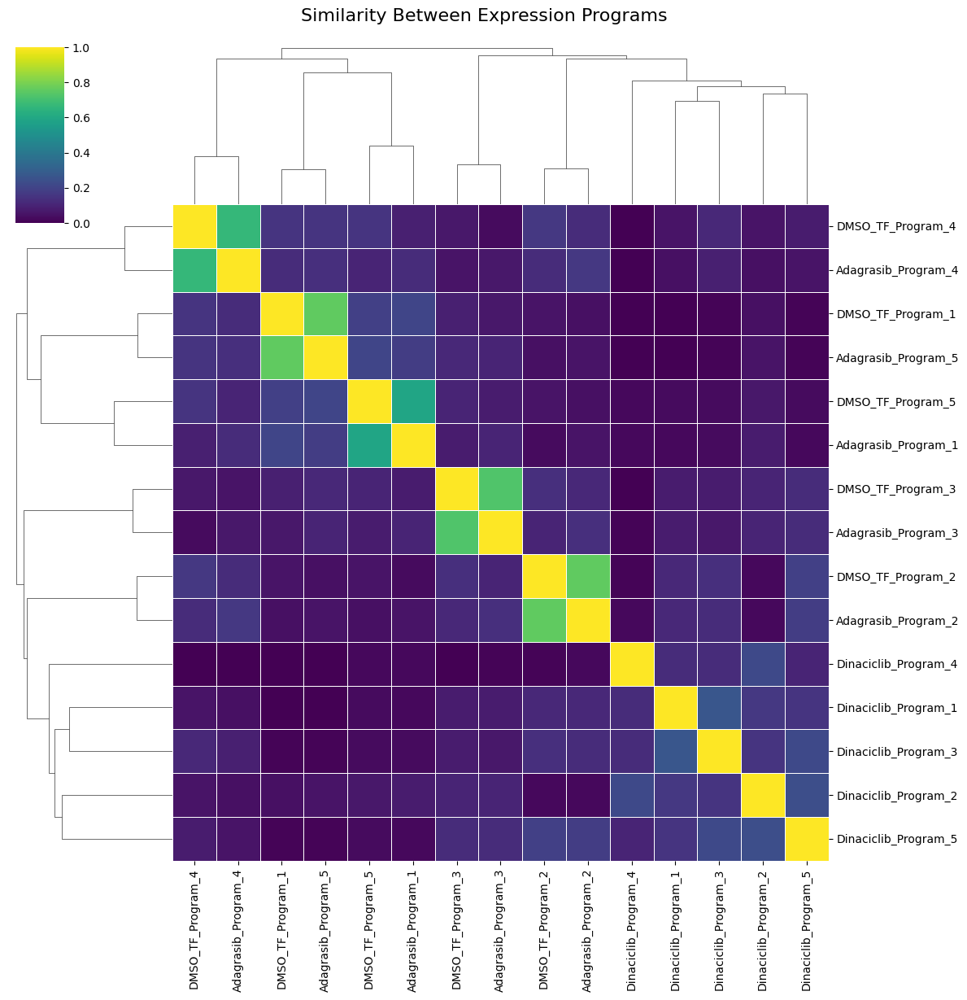


--- Step 5: Annotating an Example Program Cluster ---
From the heatmap, you can identify clusters of similar programs.
Let's pretend we saw that 'DMSO_TF_Program_1' and 'Adagrasib_Program_3' formed a cluster.

Performing Gene Set Enrichment Analysis (GSEA) on the 94 genes in our example cluster...
--> GSEA failed. This can happen if the gene list is too small or due to connection issues. Error: enrichr() got an unexpected keyword argument 'description'


In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# We will load a few source files for this analysis: the control and 2-3 drugs.
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

# --- FIX: Install the required library for Gene Set Enrichment Analysis ---
!pip install -q gseapy
# --- END FIX ---

# Import the necessary libraries for NMF and Gene Set Enrichment Analysis
from sklearn.decomposition import NMF
import gseapy as gp

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# ==============================================================================
# Part 2: Load a Subset of Files for Comparison
# ==============================================================================
print("\n--- Step 2: Loading a Subset of Drug Files ---")

# Let's compare the control against two interesting drugs
files_to_load = [
    "DMSO_TF.h5ad",
    "Adagrasib.h5ad",
    "Dinaciclib.h5ad" # A CDK inhibitor, likely to affect cell cycle
]

adata_dict = {}
for file_name in files_to_load:
    try:
        drug_label = file_name.replace('.h5ad', '')
        adata_single = sc.read_h5ad(os.path.join(source_data_folder, file_name))
        adata_dict[drug_label] = adata_single
        print(f"--> Successfully loaded: {file_name}")
    except Exception as e:
        print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")

if not adata_dict:
    raise RuntimeError("Could not load any valid AnnData files.")

# Load gene metadata for mapping IDs to symbols later
gene_metadata_df = pd.read_parquet(gene_metadata_path)
id_to_symbol_map = gene_metadata_df.set_index('ensembl_id')['gene_symbol'].to_dict()


# ==============================================================================
# Part 3: Run NMF to Find Expression Programs in Each Condition
# ==============================================================================
print("\n--- Step 3: Finding Expression Programs using NMF ---")

expression_programs = {}
n_programs = 5 # Let's find 5 programs per condition
n_top_genes = 50 # And define each program by its top 50 genes

for drug_name, adata in adata_dict.items():
    print(f"\n--- Processing: {drug_name} ---")

    # Standard preprocessing
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, n_top_genes=2000)
    adata_hvg = adata[:, adata.var.highly_variable].copy()

    # Initialize and run the NMF model
    print(f"Running NMF to find {n_programs} programs...")
    model = NMF(n_components=n_programs, init='nndsvda', random_state=42)
    # W is the cell-by-program matrix, H is the program-by-gene matrix
    W = model.fit_transform(adata_hvg.X)
    H = model.components_

    # For each of the 5 programs, get the top 50 genes
    for i in range(n_programs):
        program_name = f"{drug_name}_Program_{i+1}"
        # Get the indices of the top genes for this program from the H matrix
        top_gene_indices = np.argsort(H[i, :])[::-1][:n_top_genes]
        # Get the gene IDs using these indices
        top_gene_ids = adata_hvg.var_names[top_gene_indices].tolist()
        # Store the list of gene IDs
        expression_programs[program_name] = top_gene_ids

print("\n✅ NMF complete. Found a total of", len(expression_programs), "expression programs.")


# ==============================================================================
# Part 4: Compare Programs and Visualize Similarity (Replicating Fig 2c)
# ==============================================================================
print("\n--- Step 4: Comparing Programs and Generating Similarity Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

# Calculate the Jaccard similarity between each pair of programs
for prog1_name, genes1 in expression_programs.items():
    for prog2_name, genes2 in expression_programs.items():
        set1 = set(genes1)
        set2 = set(genes2)
        intersection = len(set1.intersection(set2))
        union = len(set1.union(set2))
        similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

# --- Generate a Clustered Heatmap ---
print("Generating program similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='viridis',
    annot=False,
    linewidths=.5,
    figsize=(12, 12)
)
plt.suptitle("Similarity Between Expression Programs", y=1.02, fontsize=16)
plt.show()


# ==============================================================================
# Part 5: Annotate a Program Cluster (Replicating Fig 2d)
# ==============================================================================
print("\n--- Step 5: Annotating an Example Program Cluster ---")
print("From the heatmap, you can identify clusters of similar programs.")
print("Let's pretend we saw that 'DMSO_TF_Program_1' and 'Adagrasib_Program_3' formed a cluster.")

# --- Example: Annotate a hypothetical cluster ---
# Get all the unique genes from the programs in our hypothetical cluster
cluster_program_names = ['DMSO_TF_Program_1', 'Adagrasib_Program_3']
cluster_genes_ids = set()
for prog_name in cluster_program_names:
    if prog_name in expression_programs:
        cluster_genes_ids.update(expression_programs[prog_name])

# Map the gene IDs to symbols for the enrichment analysis
cluster_gene_symbols = [id_to_symbol_map.get(gid, gid) for gid in cluster_genes_ids]

print(f"\nPerforming Gene Set Enrichment Analysis (GSEA) on the {len(cluster_gene_symbols)} genes in our example cluster...")

# Run GSEA using the 'gseapy' library
# We'll check against the Hallmark gene sets, which are very informative
try:
    gsea_results = gp.enrichr(
        gene_list=cluster_gene_symbols,
        gene_sets=['MSigDB_Hallmark_2020'],
        organism='Human',
        description='Example Cluster Annotation'
    )

    # Display the top 5 enriched pathways
    print("\n--- Top 5 Enriched Pathways for the Example Cluster: ---")
    print(gsea_results.results.head(5)[['Gene_set', 'Term', 'Adjusted P-value']])
    print("---------------------------------------------------------")

except Exception as e:
    print(f"--> GSEA failed. This can happen if the gene list is too small or due to connection issues. Error: {e}")



 Each program is defined by a list of 50 genes that are consistently expressed together in that condition and likely work together in a specific biological process.

# 3 drug + 10 program + 50 genes

--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading a Subset of Drug Files ---
--> Successfully loaded: DMSO_TF.h5ad
--> Successfully loaded: Adagrasib.h5ad
--> Successfully loaded: Dinaciclib.h5ad

--- Step 3: Finding Expression Programs using NMF ---

--- Processing: DMSO_TF ---
Running NMF to find 10 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Adagrasib ---
Running NMF to find 10 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Dinaciclib ---
Running NMF to find 10 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



✅ NMF complete. Found a total of 30 expression programs.

--- Step 4: Comparing Programs and Generating Similarity Heatmap ---
Generating program similarity heatmap...


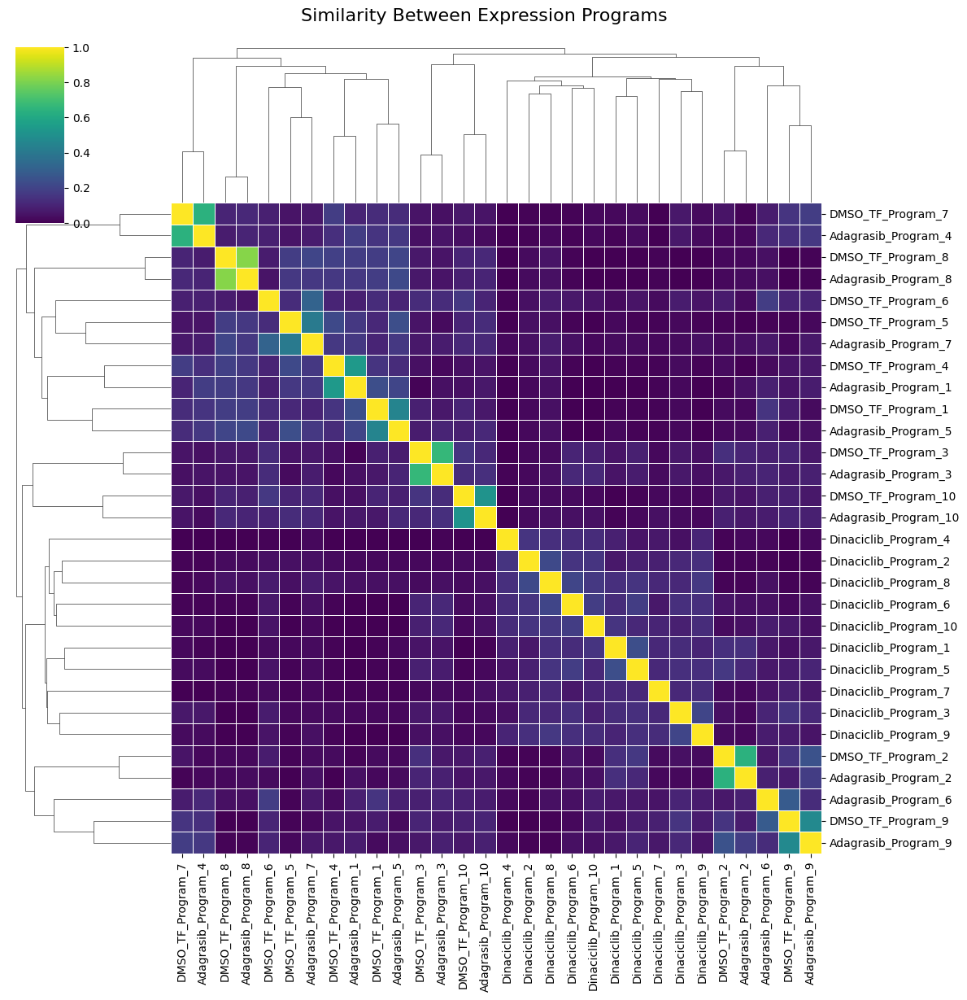


--- Step 5: Annotating a Program Cluster ---
Analyzing the following cluster: ['DMSO_TF_Program_1', 'Adagrasib_Program_3']

Performing Gene Set Enrichment Analysis (GSEA) on the 94 genes in this cluster...

--- Top 5 Enriched Pathways for this Cluster: ---
Empty DataFrame
Columns: [Gene_set, Term, Adjusted P-value]
Index: []
---------------------------------------------------------


In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

# Install the required library for Gene Set Enrichment Analysis
!pip install -q gseapy

# Import the necessary libraries for NMF and GSEA
from sklearn.decomposition import NMF
import gseapy as gp

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# ==============================================================================
# Part 2: Load a Subset of Files for Comparison
# ==============================================================================
print("\n--- Step 2: Loading a Subset of Drug Files ---")

# Let's compare the control against two interesting drugs
files_to_load = [
    "DMSO_TF.h5ad",
    "Adagrasib.h5ad",
    "Dinaciclib.h5ad" # A CDK inhibitor, likely to affect cell cycle
]

adata_dict = {}
for file_name in files_to_load:
    try:
        drug_label = file_name.replace('.h5ad', '')
        adata_single = sc.read_h5ad(os.path.join(source_data_folder, file_name))
        adata_dict[drug_label] = adata_single
        print(f"--> Successfully loaded: {file_name}")
    except Exception as e:
        print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")

if not adata_dict:
    raise RuntimeError("Could not load any valid AnnData files.")

# Load gene metadata for mapping IDs to symbols later
gene_metadata_df = pd.read_parquet(gene_metadata_path)
id_to_symbol_map = gene_metadata_df.set_index('ensembl_id')['gene_symbol'].to_dict()


# ==============================================================================
# Part 3: Run NMF to Find Expression Programs in Each Condition
# ==============================================================================
print("\n--- Step 3: Finding Expression Programs using NMF ---")

expression_programs = {}
n_programs = 10 # Let's find 5 programs per condition
n_top_genes = 50 # And define each program by its top 50 genes

for drug_name, adata in adata_dict.items():
    print(f"\n--- Processing: {drug_name} ---")

    # Standard preprocessing
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, n_top_genes=2000)
    adata_hvg = adata[:, adata.var.highly_variable].copy()

    # Initialize and run the NMF model
    print(f"Running NMF to find {n_programs} programs...")
    model = NMF(n_components=n_programs, init='nndsvda', random_state=42)
    # W is the cell-by-program matrix, H is the program-by-gene matrix
    W = model.fit_transform(adata_hvg.X)
    H = model.components_

    # For each of the 5 programs, get the top 50 genes
    for i in range(n_programs):
        program_name = f"{drug_name}_Program_{i+1}"
        # Get the indices of the top genes for this program from the H matrix
        top_gene_indices = np.argsort(H[i, :])[::-1][:n_top_genes]
        # Get the gene IDs using these indices
        top_gene_ids = adata_hvg.var_names[top_gene_indices].tolist()
        # Store the list of gene IDs
        expression_programs[program_name] = top_gene_ids

print("\n✅ NMF complete. Found a total of", len(expression_programs), "expression programs.")


# ==============================================================================
# Part 4: Compare Programs and Visualize Similarity (Replicating Fig 2c)
# ==============================================================================
print("\n--- Step 4: Comparing Programs and Generating Similarity Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

# Calculate the Jaccard similarity between each pair of programs
for prog1_name, genes1 in expression_programs.items():
    for prog2_name, genes2 in expression_programs.items():
        set1 = set(genes1)
        set2 = set(genes2)
        intersection = len(set1.intersection(set2))
        union = len(set1.union(set2))
        similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

# --- Generate a Clustered Heatmap ---
print("Generating program similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='viridis',
    annot=False,
    linewidths=.5,
    figsize=(12, 12)
)
plt.suptitle("Similarity Between Expression Programs", y=1.02, fontsize=16)
plt.show()


# ==============================================================================
# Part 5: Annotate a Real Program Cluster (Replicating Fig 2d)
# ==============================================================================
print("\n--- Step 5: Annotating a Program Cluster ---")

# --- YOUR TASK: ---
# 1. Look at the heatmap generated above.
# 2. Find a square of bright color that indicates a cluster of similar programs.
# 3. Read the names of those programs from the y-axis of the heatmap.
# 4. Replace the example names in the list below with the real names from your cluster.

cluster_program_names = [
    'DMSO_TF_Program_1',    # <-- REPLACE with a real program name from your heatmap
    'Adagrasib_Program_3',  # <-- REPLACE with another program name from the same cluster
    # Add more program names from your cluster if there are any...
]

print(f"Analyzing the following cluster: {cluster_program_names}")

# --- Get all unique genes from the programs in your chosen cluster ---
cluster_genes_ids = set()
for prog_name in cluster_program_names:
    if prog_name in expression_programs:
        cluster_genes_ids.update(expression_programs[prog_name])

# Map the gene IDs to symbols for the enrichment analysis
cluster_gene_symbols = [id_to_symbol_map.get(gid, gid) for gid in cluster_genes_ids]

print(f"\nPerforming Gene Set Enrichment Analysis (GSEA) on the {len(cluster_gene_symbols)} genes in this cluster...")

# Run GSEA using the 'gseapy' library
try:
    # --- FIX: Removed the unsupported 'description' argument ---
    gsea_results = gp.enrichr(
        gene_list=cluster_gene_symbols,
        gene_sets=['MSigDB_Hallmark_2020'], # A great database for cancer biology
        organism='Human'
    )
    # --- END FIX ---

    # Display the top 5 enriched pathways
    print("\n--- Top 5 Enriched Pathways for this Cluster: ---")
    print(gsea_results.results.head(5)[['Gene_set', 'Term', 'Adjusted P-value']])
    print("---------------------------------------------------------")

except Exception as e:
    print(f"--> GSEA failed. This can happen if the gene list is too small or due to connection issues. Error: {e}")



# 5 drug + 3 program + 5 genes

--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading a Subset of Drug Files ---
--> Successfully loaded: DMSO_TF.h5ad
--> Successfully loaded: Adagrasib.h5ad
--> Successfully loaded: Abemaciclib.h5ad
--> Successfully loaded: Acetazolamide.h5ad
--> Successfully loaded: Dinaciclib.h5ad

--- Step 3: Finding Expression Programs using NMF ---

--- Processing: DMSO_TF ---
Running NMF to find 3 programs...

--- Processing: Adagrasib ---
Running NMF to find 3 programs...

--- Processing: Abemaciclib ---
Running NMF to find 3 programs...

--- Processing: Acetazolamide ---
Running NMF to find 3 programs...

--- Processing: Dinaciclib ---
Running NMF to find 3 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



✅ NMF complete. Found a total of 15 expression programs.

--- Step 4: Comparing Programs and Generating Similarity Heatmap ---
Generating program similarity heatmap...


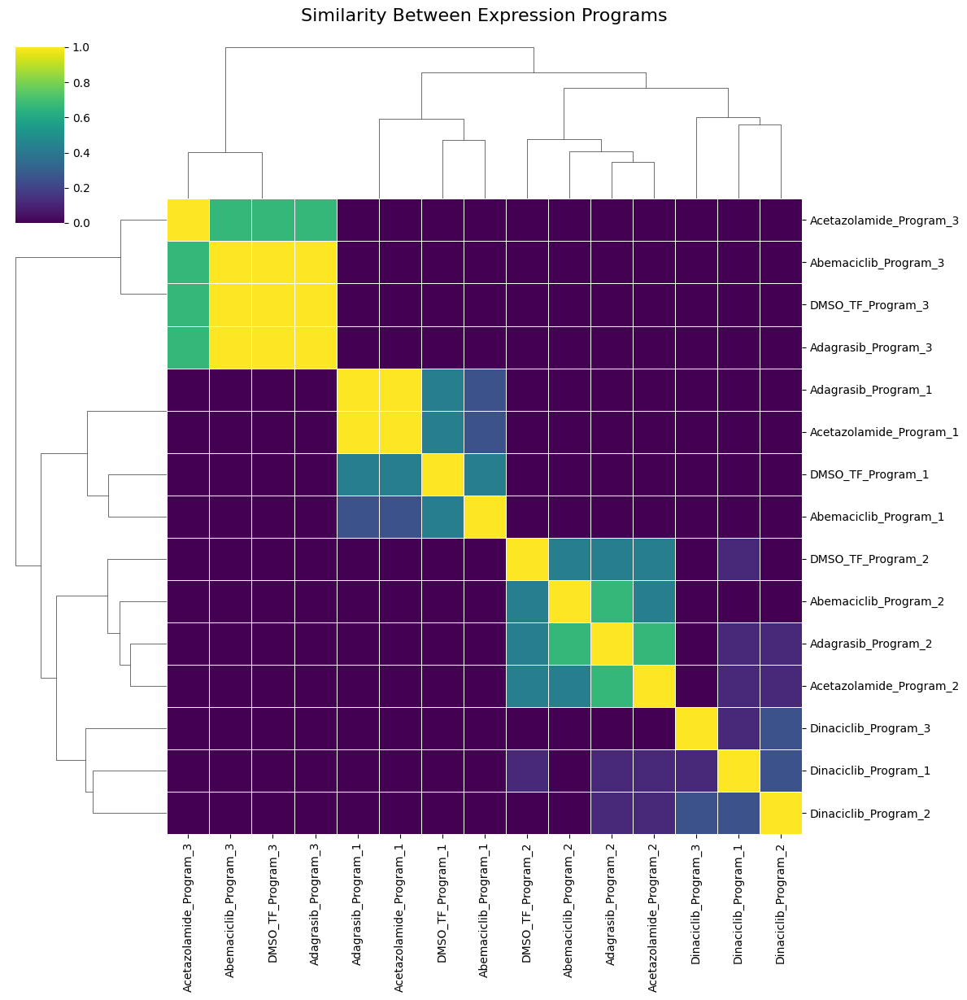

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

# Install the required library for Gene Set Enrichment Analysis
!pip install -q gseapy

# Import the necessary libraries for NMF and GSEA
from sklearn.decomposition import NMF
import gseapy as gp

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# ==============================================================================
# Part 2: Load a Subset of Files for Comparison
# ==============================================================================
print("\n--- Step 2: Loading a Subset of Drug Files ---")

# Let's compare the control against two interesting drugs
files_to_load = [
    "DMSO_TF.h5ad",
    "Adagrasib.h5ad",
    "Abemaciclib.h5ad",
    "Acetazolamide.h5ad",
    "Dinaciclib.h5ad" # A CDK inhibitor, likely to affect cell cycle
]

adata_dict = {}
for file_name in files_to_load:
    try:
        drug_label = file_name.replace('.h5ad', '')
        adata_single = sc.read_h5ad(os.path.join(source_data_folder, file_name))
        adata_dict[drug_label] = adata_single
        print(f"--> Successfully loaded: {file_name}")
    except Exception as e:
        print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")

if not adata_dict:
    raise RuntimeError("Could not load any valid AnnData files.")

# Load gene metadata for mapping IDs to symbols later
gene_metadata_df = pd.read_parquet(gene_metadata_path)
id_to_symbol_map = gene_metadata_df.set_index('ensembl_id')['gene_symbol'].to_dict()


# ==============================================================================
# Part 3: Run NMF to Find Expression Programs in Each Condition
# ==============================================================================
print("\n--- Step 3: Finding Expression Programs using NMF ---")

expression_programs = {}
n_programs = 3 # Let's find 5 programs per condition
n_top_genes = 5 # And define each program by its top 50 genes

for drug_name, adata in adata_dict.items():
    print(f"\n--- Processing: {drug_name} ---")

    # Standard preprocessing
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, n_top_genes=2000)
    adata_hvg = adata[:, adata.var.highly_variable].copy()

    # Initialize and run the NMF model
    print(f"Running NMF to find {n_programs} programs...")
    model = NMF(n_components=n_programs, init='nndsvda', random_state=42)
    # W is the cell-by-program matrix, H is the program-by-gene matrix
    W = model.fit_transform(adata_hvg.X)
    H = model.components_

    # For each of the 5 programs, get the top 50 genes
    for i in range(n_programs):
        program_name = f"{drug_name}_Program_{i+1}"
        # Get the indices of the top genes for this program from the H matrix
        top_gene_indices = np.argsort(H[i, :])[::-1][:n_top_genes]
        # Get the gene IDs using these indices
        top_gene_ids = adata_hvg.var_names[top_gene_indices].tolist()
        # Store the list of gene IDs
        expression_programs[program_name] = top_gene_ids

print("\n✅ NMF complete. Found a total of", len(expression_programs), "expression programs.")


# ==============================================================================
# Part 4: Compare Programs and Visualize Similarity (Replicating Fig 2c)
# ==============================================================================
print("\n--- Step 4: Comparing Programs and Generating Similarity Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

# Calculate the Jaccard similarity between each pair of programs
for prog1_name, genes1 in expression_programs.items():
    for prog2_name, genes2 in expression_programs.items():
        set1 = set(genes1)
        set2 = set(genes2)
        intersection = len(set1.intersection(set2))
        union = len(set1.union(set2))
        similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

# --- Generate a Clustered Heatmap ---
print("Generating program similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='viridis',
    annot=False,
    linewidths=.5,
    figsize=(12, 12)
)
plt.suptitle("Similarity Between Expression Programs", y=1.02, fontsize=16)
plt.show()




--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading a Subset of Drug Files ---
--> Successfully loaded: DMSO_TF.h5ad
--> Successfully loaded: Adagrasib.h5ad
--> Successfully loaded: Abemaciclib.h5ad
--> Successfully loaded: Acetazolamide.h5ad
--> Successfully loaded: Dinaciclib.h5ad

--- Step 3: Finding Expression Programs using NMF ---

--- Processing: DMSO_TF ---
Running NMF to find 3 programs...

--- Processing: Adagrasib ---
Running NMF to find 3 programs...

--- Processing: Abemaciclib ---
Running NMF to find 3 programs...

--- Processing: Acetazolamide ---
Running NMF to find 3 programs...

--- Processing: Dinaciclib ---
Running NMF to find 3 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



✅ NMF complete. Found a total of 15 expression programs.

--- Step 4: Comparing Programs and Generating Similarity Heatmap ---
Generating program similarity heatmap...


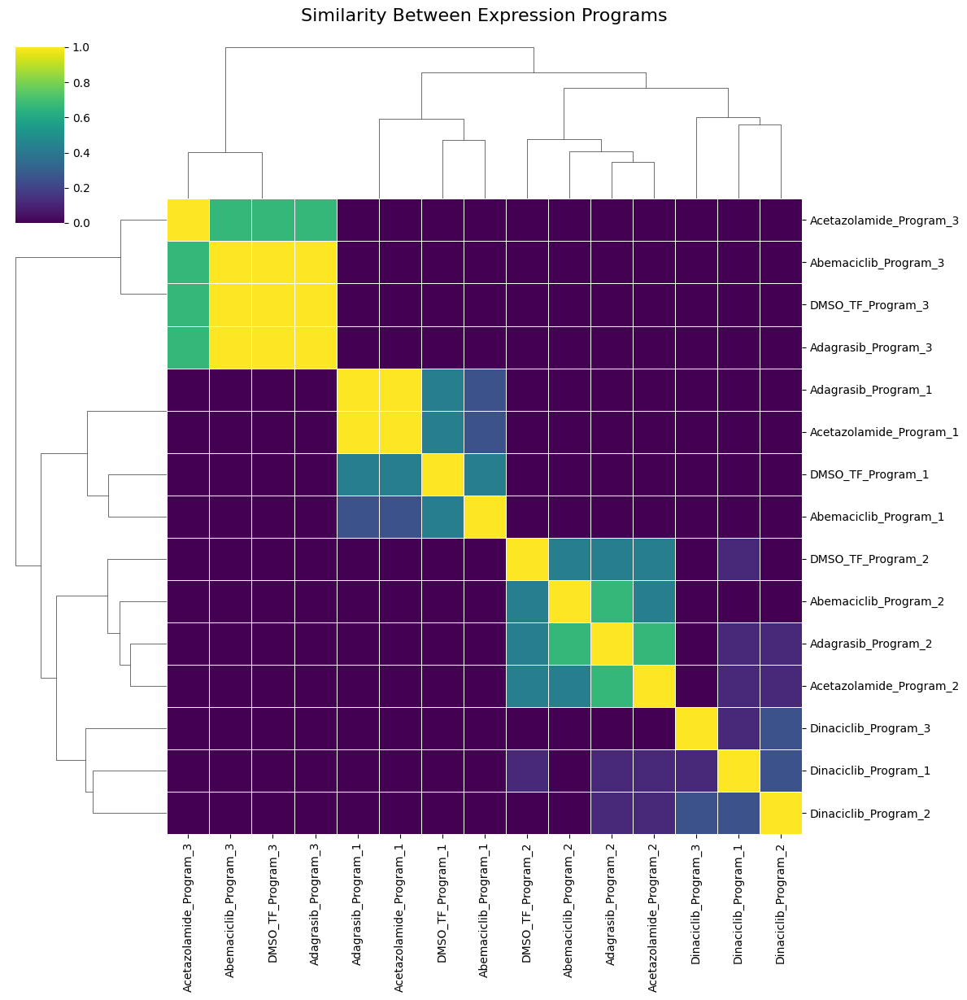

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

# Install the required library for Gene Set Enrichment Analysis
!pip install -q gseapy

# Import the necessary libraries for NMF and GSEA
from sklearn.decomposition import NMF
import gseapy as gp

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# ==============================================================================
# Part 2: Load a Subset of Files for Comparison
# ==============================================================================
print("\n--- Step 2: Loading a Subset of Drug Files ---")

# Let's compare the control against two interesting drugs
files_to_load = [
    "DMSO_TF.h5ad",
    "Adagrasib.h5ad",
    "Abemaciclib.h5ad",
    "Acetazolamide.h5ad",
    "Dinaciclib.h5ad" # A CDK inhibitor, likely to affect cell cycle
]

adata_dict = {}
for file_name in files_to_load:
    try:
        drug_label = file_name.replace('.h5ad', '')
        adata_single = sc.read_h5ad(os.path.join(source_data_folder, file_name))
        adata_dict[drug_label] = adata_single
        print(f"--> Successfully loaded: {file_name}")
    except Exception as e:
        print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")

if not adata_dict:
    raise RuntimeError("Could not load any valid AnnData files.")

# Load gene metadata for mapping IDs to symbols later
gene_metadata_df = pd.read_parquet(gene_metadata_path)
id_to_symbol_map = gene_metadata_df.set_index('ensembl_id')['gene_symbol'].to_dict()


# ==============================================================================
# Part 3: Run NMF to Find Expression Programs in Each Condition
# ==============================================================================
print("\n--- Step 3: Finding Expression Programs using NMF ---")

expression_programs = {}
n_programs = 3 # Let's find 5 programs per condition
n_top_genes = 5 # And define each program by its top 50 genes

for drug_name, adata in adata_dict.items():
    print(f"\n--- Processing: {drug_name} ---")

    # Standard preprocessing
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, n_top_genes=2000)
    adata_hvg = adata[:, adata.var.highly_variable].copy()

    # Initialize and run the NMF model
    print(f"Running NMF to find {n_programs} programs...")
    model = NMF(n_components=n_programs, init='nndsvda', random_state=42)
    # W is the cell-by-program matrix, H is the program-by-gene matrix
    W = model.fit_transform(adata_hvg.X)
    H = model.components_

    # For each of the 5 programs, get the top 50 genes
    for i in range(n_programs):
        program_name = f"{drug_name}_Program_{i+1}"
        # Get the indices of the top genes for this program from the H matrix
        top_gene_indices = np.argsort(H[i, :])[::-1][:n_top_genes]
        # Get the gene IDs using these indices
        top_gene_ids = adata_hvg.var_names[top_gene_indices].tolist()
        # Store the list of gene IDs
        expression_programs[program_name] = top_gene_ids

print("\n✅ NMF complete. Found a total of", len(expression_programs), "expression programs.")


# ==============================================================================
# Part 4: Compare Programs and Visualize Similarity (Replicating Fig 2c)
# ==============================================================================
print("\n--- Step 4: Comparing Programs and Generating Similarity Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

# Calculate the Jaccard similarity between each pair of programs
for prog1_name, genes1 in expression_programs.items():
    for prog2_name, genes2 in expression_programs.items():
        set1 = set(genes1)
        set2 = set(genes2)
        intersection = len(set1.intersection(set2))
        union = len(set1.union(set2))
        similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

# --- Generate a Clustered Heatmap ---
print("Generating program similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='viridis',
    annot=False,
    linewidths=.5,
    figsize=(12, 12)
)
plt.suptitle("Similarity Between Expression Programs", y=1.02, fontsize=16)
plt.show()




In [ ]:
# ==============================================================================
# Part 5: Annotate a Real Program Cluster (Replicating Fig 2d)
# ==============================================================================
print("\n--- Step 5: Annotating a Program Cluster ---")


print(f"Analyzing the following cluster: {cluster_program_names}")

# --- Get all unique genes from the programs in your chosen cluster ---
cluster_genes_ids = set()
for prog_name in cluster_program_names:
    if prog_name in expression_programs:
        cluster_genes_ids.update(expression_programs[prog_name])


print(f"\nPerforming Gene Set Enrichment Analysis (GSEA) on the {len(cluster_gene_symbols)} genes in this cluster...")

# Run GSEA using the 'gseapy' library
try:
    gsea_results = gp.enrichr(
        gene_list=cluster_gene_symbols,
        gene_sets=['MSigDB_Hallmark_2020'], # A great database for cancer biology
        organism='Human'
    )


    # Display the top 5 enriched pathways
    print("\n--- Top 5 Enriched Pathways for this Cluster: ---")
    print(gsea_results.results.head(10)[['Gene_set', 'Term', 'Adjusted P-value']])
    print("---------------------------------------------------------")

except Exception as e:
    print(f"--> GSEA failed. This can happen if the gene list is too small or due to connection issues. Error: {e}")



--- Step 5: Annotating a Program Cluster ---
Analyzing the following cluster: ['Dinacinib_Program_1', 'Adagrasib_Program_3', 'Abemaciclib_Program_1', 'Abemaciclib_Program_2', 'Abemaciclib_Program_3', 'Acetazolamide_Program_1']

Performing Gene Set Enrichment Analysis (GSEA) on the 18 genes in this cluster...

--- Top 5 Enriched Pathways for this Cluster: ---
               Gene_set                           Term  Adjusted P-value
0  MSigDB_Hallmark_2020          Inflammatory Response           0.16555
1  MSigDB_Hallmark_2020       IL-6/JAK/STAT3 Signaling           0.16555
2  MSigDB_Hallmark_2020              Protein Secretion           0.16555
3  MSigDB_Hallmark_2020                 UV Response Dn           0.16555
4  MSigDB_Hallmark_2020                     DNA Repair           0.16555
5  MSigDB_Hallmark_2020           IL-2/STAT5 Signaling           0.16555
6  MSigDB_Hallmark_2020          Xenobiotic Metabolism           0.16555
7  MSigDB_Hallmark_2020  TNF-alpha Signaling via NF-kB

In [ ]:
# ==============================================================================
# Part 5: Annotate a Real Program Cluster (Replicating Fig 2d)
# ==============================================================================
print("\n--- Step 5: Annotating a Program Cluster ---")


print(f"Analyzing the following cluster: {cluster_program_names}")

# --- FIX: Correctly create the gene map and perform the mapping ---
try:
    gene_metadata_df = pd.read_parquet(gene_metadata_path)
    # This now correctly maps the numeric token ID to the gene symbol
    id_to_symbol_map = gene_metadata_df.set_index('token_id')['gene_symbol'].to_dict()
    print("✅ Successfully created gene map (token_id -> gene_symbol).")

    # Get all unique genes from the programs in your chosen cluster
    cluster_genes_ids = set()
    for prog_name in cluster_program_names:
        if prog_name in expression_programs:
            # The gene IDs in `expression_programs` are strings, so we convert them to integers
            # to match the keys in our new dictionary.
            integer_ids = [int(gid) for gid in expression_programs[prog_name]]
            cluster_genes_ids.update(integer_ids)

    # Map the integer gene IDs to symbols
    cluster_gene_symbols = [id_to_symbol_map.get(gid, str(gid)) for gid in cluster_genes_ids]
    print(f"✅ Successfully mapped {len(cluster_gene_symbols)} gene IDs to symbols.")

except Exception as e:
    print(f"--> ERROR: Could not load or process gene metadata. Error: {e}")
    cluster_gene_symbols = [] # Set to empty list on failure
# --- END FIX ---


print(f"\nPerforming Gene Set Enrichment Analysis (GSEA) on the {len(cluster_gene_symbols)} genes in this cluster...")

# Run GSEA using the 'gseapy' library
if cluster_gene_symbols:
    try:
        gsea_results = gp.enrichr(
            gene_list=cluster_gene_symbols,
            gene_sets=['MSigDB_Hallmark_2020'],
            organism='Human'
        )

        # Display the results, even if not significant
        if gsea_results.results.empty:
            print("\n--- No statistically significant pathways found for this gene cluster. ---")
        else:
            print("\n--- Top Enriched Pathways for this Cluster (including non-significant): ---")
            print(gsea_results.results[['Gene_set', 'Term', 'P-value', 'Adjusted P-value', 'Genes']].to_string())
            print("--------------------------------------------------------------------------------")

    except Exception as e:
        print(f"--> GSEA failed. This can happen if the gene list is too small or due to connection issues. Error: {e}")
else:
    print("--> Skipping GSEA because gene list is empty.")




--- Step 5: Annotating a Program Cluster ---
Analyzing the following cluster: ['Dinacinib_Program_1', 'Adagrasib_Program_3', 'Abemaciclib_Program_1', 'Abemaciclib_Program_2', 'Abemaciclib_Program_3', 'Acetazolamide_Program_1']
✅ Successfully created gene map (token_id -> gene_symbol).
✅ Successfully mapped 18 gene IDs to symbols.

Performing Gene Set Enrichment Analysis (GSEA) on the 18 genes in this cluster...

--- Top Enriched Pathways for this Cluster (including non-significant): ---
                Gene_set                               Term   P-value  Adjusted P-value     Genes
0   MSigDB_Hallmark_2020              Inflammatory Response  0.013702           0.16555  SRI;MXD1
1   MSigDB_Hallmark_2020           IL-6/JAK/STAT3 Signaling  0.075502           0.16555    IL17RB
2   MSigDB_Hallmark_2020                  Protein Secretion  0.082997           0.16555     YIPF6
3   MSigDB_Hallmark_2020                     UV Response Dn  0.122013           0.16555       SRI
4   MSigDB_Hallma

In [ ]:
# ==============================================================================
# Part 5: Annotate a Real Program Cluster (Replicating Fig 2d)
# ==============================================================================
print("\n--- Step 5: Annotating a Program Cluster ---")


print(f"Analyzing the following cluster: {cluster_program_names}")

# --- FIX: Correctly create the gene map and perform the mapping ---
try:
    gene_metadata_df = pd.read_parquet(gene_metadata_path)
    # This now correctly maps the numeric token ID to the gene symbol
    id_to_symbol_map = gene_metadata_df.set_index('token_id')['gene_symbol'].to_dict()
    print("✅ Successfully created gene map (token_id -> gene_symbol).")

    # Get all unique genes from the programs in your chosen cluster
    cluster_genes_ids = set()
    for prog_name in cluster_program_names:
        if prog_name in expression_programs:
            # The gene IDs in `expression_programs` are strings, so we convert them to integers
            # to match the keys in our new dictionary.
            integer_ids = [int(gid) for gid in expression_programs[prog_name]]
            cluster_genes_ids.update(integer_ids)

    # Map the integer gene IDs to symbols
    cluster_gene_symbols = [id_to_symbol_map.get(gid, str(gid)) for gid in cluster_genes_ids]
    print(f"✅ Successfully mapped {len(cluster_gene_symbols)} gene IDs to symbols.")

except Exception as e:
    print(f"--> ERROR: Could not load or process gene metadata. Error: {e}")
    cluster_gene_symbols = [] # Set to empty list on failure
# --- END FIX ---


print(f"\nPerforming Gene Set Enrichment Analysis (GSEA) on the {len(cluster_gene_symbols)} genes in this cluster...")

# Run GSEA using the 'gseapy' library
if cluster_gene_symbols:
    try:
        gsea_results = gp.enrichr(
            gene_list=cluster_gene_symbols,
            gene_sets=['MSigDB_Hallmark_2020'],
            organism='Human'
        )

        # Display the results, even if not significant
        if gsea_results.results.empty:
            print("\n--- No statistically significant pathways found for this gene cluster. ---")
        else:
            print("\n--- Top Enriched Pathways for this Cluster (including non-significant): ---")
            print(gsea_results.results[['Gene_set', 'Term', 'P-value', 'Adjusted P-value', 'Genes']].to_string())
            print("--------------------------------------------------------------------------------")

    except Exception as e:
        print(f"--> GSEA failed. This can happen if the gene list is too small or due to connection issues. Error: {e}")
else:
    print("--> Skipping GSEA because gene list is empty.")




--- Step 5: Annotating a Program Cluster ---
Analyzing the following cluster: ['Dinacinib_Program_1', 'Adagrasib_Program_3', 'Abemaciclib_Program_1', 'Abemaciclib_Program_2', 'Abemaciclib_Program_3', 'Acetazolamide_Program_1']
✅ Successfully created gene map (token_id -> gene_symbol).
✅ Successfully mapped 18 gene IDs to symbols.

Performing Gene Set Enrichment Analysis (GSEA) on the 18 genes in this cluster...

--- Top Enriched Pathways for this Cluster (including non-significant): ---
                Gene_set                               Term   P-value  Adjusted P-value     Genes
0   MSigDB_Hallmark_2020              Inflammatory Response  0.013702           0.16555  SRI;MXD1
1   MSigDB_Hallmark_2020           IL-6/JAK/STAT3 Signaling  0.075502           0.16555    IL17RB
2   MSigDB_Hallmark_2020                  Protein Secretion  0.082997           0.16555     YIPF6
3   MSigDB_Hallmark_2020                     UV Response Dn  0.122013           0.16555       SRI
4   MSigDB_Hallma

# Statistically insignificant!!

In [ ]:
# ==============================================================================
# Part 5: Annotate a Real Program Cluster (Replicating Fig 2d)
# ==============================================================================
print("\n--- Step 5: Annotating a Program Cluster ---")

print(f"Analyzing the following cluster: {cluster_program_names}")

# --- Correctly create the gene map and perform the mapping ---
try:
    gene_metadata_df = pd.read_parquet(gene_metadata_path)
    # This now correctly maps the numeric token ID to the gene symbol
    id_to_symbol_map = gene_metadata_df.set_index('token_id')['gene_symbol'].to_dict()
    print("✅ Successfully created gene map (token_id -> gene_symbol).")

    # Get all unique genes from the programs in your chosen cluster
    cluster_genes_ids = set()
    for prog_name in cluster_program_names:
        if prog_name in expression_programs:
            # The gene IDs in `expression_programs` are strings, so we convert them to integers
            # to match the keys in our new dictionary.
            integer_ids = [int(gid) for gid in expression_programs[prog_name]]
            cluster_genes_ids.update(integer_ids)

    # Map the integer gene IDs to symbols
    cluster_gene_symbols = [id_to_symbol_map.get(gid, str(gid)) for gid in cluster_genes_ids]
    print(f"✅ Successfully mapped {len(cluster_gene_symbols)} gene IDs to symbols.")

except Exception as e:
    print(f"--> ERROR: Could not load or process gene metadata. Error: {e}")
    cluster_gene_symbols = [] # Set to empty list on failure


print(f"\nPerforming Gene Set Enrichment Analysis (GSEA) on the {len(cluster_gene_symbols)} genes in this cluster...")

# Run GSEA using the 'gseapy' library
if cluster_gene_symbols:
    try:
        gsea_results = gp.enrichr(
            gene_list=cluster_gene_symbols,
            gene_sets=['MSigDB_Hallmark_2020'],
            organism='Human'
        )

        # --- FIX: Filter for and display only statistically significant results ---
        # A standard threshold for significance is an Adjusted P-value < 0.05
        significant_results = gsea_results.results[gsea_results.results['Adjusted P-value'] < 0.05]

        if significant_results.empty:
            print("\n--- No statistically significant pathways found for this gene cluster. ---")
        else:
            print("\n--- Top Statistically Significant Enriched Pathways for this Cluster: ---")
            print(significant_results[['Gene_set', 'Term', 'Adjusted P-value', 'Genes']].to_string())
            print("--------------------------------------------------------------------------------")
        # --- END FIX ---

    except Exception as e:
        print(f"--> GSEA failed. This can happen if the gene list is too small or due to connection issues. Error: {e}")
else:
    print("--> Skipping GSEA because gene list is empty.")




--- Step 5: Annotating a Program Cluster ---
Analyzing the following cluster: ['Dinacinib_Program_1', 'Adagrasib_Program_3', 'Abemaciclib_Program_1', 'Abemaciclib_Program_2', 'Abemaciclib_Program_3', 'Acetazolamide_Program_1']
✅ Successfully created gene map (token_id -> gene_symbol).
✅ Successfully mapped 18 gene IDs to symbols.

Performing Gene Set Enrichment Analysis (GSEA) on the 18 genes in this cluster...

--- No statistically significant pathways found for this gene cluster. ---


--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading a Subset of Drug Files ---
--> Successfully loaded: DMSO_TF.h5ad
--> Successfully loaded: Adagrasib.h5ad
--> Successfully loaded: Abemaciclib.h5ad
--> Successfully loaded: Acetazolamide.h5ad
--> Successfully loaded: Adenine.h5ad
--> Successfully loaded: Adenosine.h5ad
--> Successfully loaded: Dinaciclib.h5ad

--- Step 3: Finding Expression Programs using NMF ---

--- Processing: DMSO_TF ---
Running NMF to find 3 programs...

--- Processing: Adagrasib ---
Running NMF to find 3 programs...

--- Processing: Abemaciclib ---
Running NMF to find 3 programs...

--- Processing: Acetazolamide ---
Running NMF to find 3 programs...

--- Processing: Adenine ---
Running NMF to find 3 programs...

--- Processing: Adenosine ---
Running NMF to find 3 programs...

--- Processing: Dinaciclib ---
Running NMF to find 3 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



✅ NMF complete. Found a total of 21 expression programs.

--- Step 4: Comparing Programs and Generating Similarity Heatmap ---
Generating program similarity heatmap...


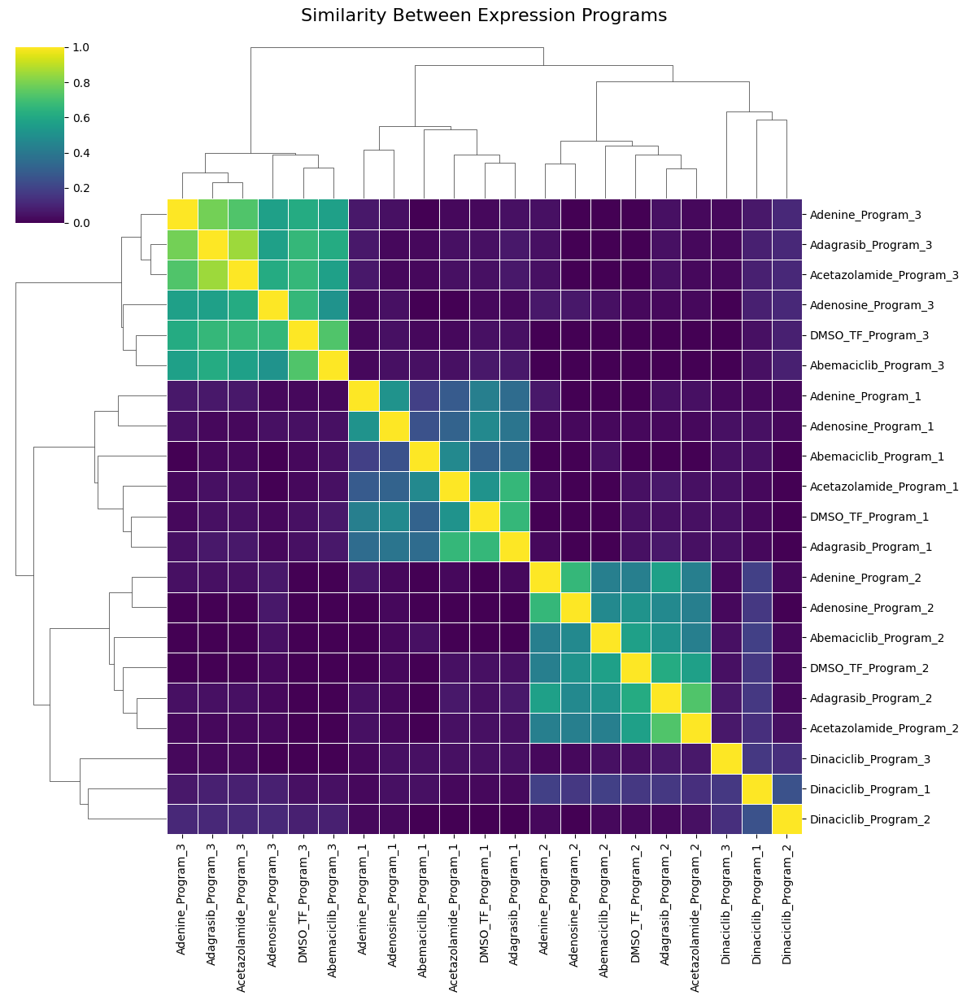

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

# Install the required library for Gene Set Enrichment Analysis
!pip install -q gseapy

# Import the necessary libraries for NMF and GSEA
from sklearn.decomposition import NMF
import gseapy as gp

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# ==============================================================================
# Part 2: Load a Subset of Files for Comparison
# ==============================================================================
print("\n--- Step 2: Loading a Subset of Drug Files ---")

# Let's compare the control against two interesting drugs
files_to_load = [
    "DMSO_TF.h5ad",
    "Adagrasib.h5ad",
    "Abemaciclib.h5ad",
    "Acetazolamide.h5ad",
    "Adenine.h5ad",
    "Adenosine.h5ad",
    "Dinaciclib.h5ad" # A CDK inhibitor, likely to affect cell cycle
]

adata_dict = {}
for file_name in files_to_load:
    try:
        drug_label = file_name.replace('.h5ad', '')
        adata_single = sc.read_h5ad(os.path.join(source_data_folder, file_name))
        adata_dict[drug_label] = adata_single
        print(f"--> Successfully loaded: {file_name}")
    except Exception as e:
        print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")

if not adata_dict:
    raise RuntimeError("Could not load any valid AnnData files.")

# Load gene metadata for mapping IDs to symbols later
gene_metadata_df = pd.read_parquet(gene_metadata_path)
id_to_symbol_map = gene_metadata_df.set_index('ensembl_id')['gene_symbol'].to_dict()


# ==============================================================================
# Part 3: Run NMF to Find Expression Programs in Each Condition
# ==============================================================================
print("\n--- Step 3: Finding Expression Programs using NMF ---")

expression_programs = {}
n_programs = 3 # Let's find 5 programs per condition
n_top_genes = 25 # And define each program by its top 50 genes

for drug_name, adata in adata_dict.items():
    print(f"\n--- Processing: {drug_name} ---")

    # Standard preprocessing
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, n_top_genes=2000)
    adata_hvg = adata[:, adata.var.highly_variable].copy()

    # Initialize and run the NMF model
    print(f"Running NMF to find {n_programs} programs...")
    model = NMF(n_components=n_programs, init='nndsvda', random_state=42)
    # W is the cell-by-program matrix, H is the program-by-gene matrix
    W = model.fit_transform(adata_hvg.X)
    H = model.components_

    # For each of the 5 programs, get the top 50 genes
    for i in range(n_programs):
        program_name = f"{drug_name}_Program_{i+1}"
        # Get the indices of the top genes for this program from the H matrix
        top_gene_indices = np.argsort(H[i, :])[::-1][:n_top_genes]
        # Get the gene IDs using these indices
        top_gene_ids = adata_hvg.var_names[top_gene_indices].tolist()
        # Store the list of gene IDs
        expression_programs[program_name] = top_gene_ids

print("\n✅ NMF complete. Found a total of", len(expression_programs), "expression programs.")


# ==============================================================================
# Part 4: Compare Programs and Visualize Similarity (Replicating Fig 2c)
# ==============================================================================
print("\n--- Step 4: Comparing Programs and Generating Similarity Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

# Calculate the Jaccard similarity between each pair of programs
for prog1_name, genes1 in expression_programs.items():
    for prog2_name, genes2 in expression_programs.items():
        set1 = set(genes1)
        set2 = set(genes2)
        intersection = len(set1.intersection(set2))
        union = len(set1.union(set2))
        similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

# --- Generate a Clustered Heatmap ---
print("Generating program similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='viridis',
    annot=False,
    linewidths=.5,
    figsize=(12, 12)
)
plt.suptitle("Similarity Between Expression Programs", y=1.02, fontsize=16)
plt.show()




ماتریس H (برنامه × ژن): این ماتریس برای ما مهم‌ترین خروجی است. هر سطر آن یکی از ۵ برنامه کشف‌شده و هر ستون آن یک ژن است. اعداد داخل این ماتریس «امتیاز اهمیت» هر ژن برای هر برنامه را نشان می‌دهند.

ماتریس W (سلول × برنامه): این ماتریس نشان می‌دهد که هر کدام از ۵ برنامه کشف‌شده، در هر کدام از سلول‌ها چقدر «فعال» هستند.

In [ ]:
cluster_program_names += ['Adenosine_Program_1', 'Adenosine_Program_2', 'Adenine_Program_1', 'Adenine_Program_2', 'Abemaciclib_Program_1', 'Abemaciclib_Program_2', 'Abemaciclib_Program_3']

In [ ]:
cluster_program_names

['Dinacinib_Program_1',
 'Adagrasib_Program_3',
 'Abemaciclib_Program_1',
 'Abemaciclib_Program_2',
 'Abemaciclib_Program_3',
 'Acetazolamide_Program_1',
 'Adenosine_Program_1',
 'Adenosine_Program_2',
 'Adenine_Program_1',
 'Adenine_Program_2',
 'Abemaciclib_Program_1',
 'Abemaciclib_Program_2',
 'Abemaciclib_Program_3']

In [ ]:
cluster_gene_symbols

['PRKCZ',
 'ENSG00000267371',
 'MYOC',
 'DRICH1',
 'LINC01345',
 'GPKOW',
 'NAGA',
 'ENSG00000286119',
 'ENSG00000257237',
 'CDY23P',
 'WASHC4',
 'KRT83',
 'CXCL17',
 'PCDH8',
 'SHROOM3',
 'ST6GALNAC5',
 'B4GALT4',
 'STARD8',
 'SETDB2',
 'ENSG00000268615',
 'LEAP2',
 'PHKA2',
 'AK9',
 'TBC1D19',
 'GH2',
 'VPS39-DT',
 'SUMO1P2',
 'UNC5A',
 'FTH1P14',
 'DHDDS',
 'NSL1',
 'VWDE',
 'SLC5A9',
 'ZNF71',
 'ARMC8',
 'ANPEP',
 'MS4A4A',
 'COL7A1',
 'OSGIN2',
 'ENSG00000249856',
 'HSD17B14',
 'VPS37B',
 'ASCL2',
 'GNB4',
 'PTPRM',
 'USE1',
 'ZWINT',
 'ENSG00000178836',
 'CANT1',
 'PA2G4P4',
 'RASSF8',
 'YIPF6',
 'IMPDH1',
 'TTTY9B',
 'EDEM2',
 'ENSG00000287920',
 'PDRG1',
 'TRBV21OR9-2',
 'POTEE',
 'IL17RB',
 'CHCHD3',
 'MYF6',
 'LZTS3',
 'SRI',
 'EOMES',
 'PTPN14',
 'ENSG00000186148',
 'MXD1',
 'LARS2',
 'OR4H6P',
 'POLG',
 'TTC23',
 'ATP6AP2',
 'C9orf40',
 'KRT34',
 'NINJ2',
 'NOL3',
 'PRNP',
 'EMC2',
 'PDPR',
 'LDB2',
 'GSX1',
 'MCCC1',
 'ENSG00000227667',
 'MCM9',
 'CCT8L1P',
 'RGR',
 'LRRTM

In [ ]:
print(f"Analyzing the following cluster: {cluster_program_names}")

# --- Correctly create the gene map and perform the mapping ---
try:
    gene_metadata_df = pd.read_parquet(gene_metadata_path)
    # This now correctly maps the numeric token ID to the gene symbol
    id_to_symbol_map = gene_metadata_df.set_index('token_id')['gene_symbol'].to_dict()
    print("✅ Successfully created gene map (token_id -> gene_symbol).")

    # Get all unique genes from the programs in your chosen cluster
    cluster_genes_ids = set()
    for prog_name in cluster_program_names:
        if prog_name in expression_programs:
            # The gene IDs in `expression_programs` are strings, so we convert them to integers
            # to match the keys in our new dictionary.
            integer_ids = [int(gid) for gid in expression_programs[prog_name]]
            cluster_genes_ids.update(integer_ids)

    # Map the integer gene IDs to symbols
    cluster_gene_symbols = [id_to_symbol_map.get(gid, str(gid)) for gid in cluster_genes_ids]
    print(f"✅ Successfully mapped {len(cluster_gene_symbols)} gene IDs to symbols.")

except Exception as e:
    print(f"--> ERROR: Could not load or process gene metadata. Error: {e}")
    cluster_gene_symbols = [] # Set to empty list on failure


print(f"\nPerforming Gene Set Enrichment Analysis (GSEA) on the {len(cluster_gene_symbols)} genes in this cluster...")

# Run GSEA using the 'gseapy' library
if cluster_gene_symbols:
    try:
        gseapy_results = gp.enrichr(
            gene_list=cluster_gene_symbols,
            gene_sets=['MSigDB_Hallmark_2020'],
            organism='Human'
        )

        # Filter for and display only statistically significant results
        significant_results = gseapy_results.results[gseapy_results.results['Adjusted P-value'] < 0.05]

        if significant_results.empty:
            print("\n--- No statistically significant pathways found for this gene cluster. ---")
        else:
            print("\n--- Top Statistically Significant Enriched Pathways for this Cluster: ---")
            # --- EDIT: Added 'P-value' to the list of columns to print ---
            print(significant_results[['Gene_set', 'Term', 'P-value', 'Adjusted P-value', 'Genes']].to_string())
            print("--------------------------------------------------------------------------------")

    except Exception as e:
        print(f"--> GSEA failed. This can happen if the gene list is too small or due to connection issues. Error: {e}")
else:
    print("--> Skipping GSEA because gene list is empty.")



Analyzing the following cluster: ['Dinacinib_Program_1', 'Adagrasib_Program_3', 'Abemaciclib_Program_1', 'Abemaciclib_Program_2', 'Abemaciclib_Program_3', 'Acetazolamide_Program_1', 'Adenosine_Program_1', 'Adenosine_Program_2', 'Adenine_Program_1', 'Adenine_Program_2', 'Abemaciclib_Program_1', 'Abemaciclib_Program_2', 'Abemaciclib_Program_3']
✅ Successfully created gene map (token_id -> gene_symbol).
✅ Successfully mapped 108 gene IDs to symbols.

Performing Gene Set Enrichment Analysis (GSEA) on the 108 genes in this cluster...

--- No statistically significant pathways found for this gene cluster. ---


In [ ]:
# --- Correctly create the gene map and perform the mapping ---
try:
    gene_metadata_df = pd.read_parquet(gene_metadata_path)
    # This now correctly maps the numeric token ID to the gene symbol
    id_to_symbol_map = gene_metadata_df.set_index('token_id')['gene_symbol'].to_dict()
    print("✅ Successfully created gene map (token_id -> gene_symbol).")

    # Get all unique genes from the programs in your chosen cluster
    cluster_genes_ids = set()
    for prog_name in cluster_program_names:
        if prog_name in expression_programs:
            # The gene IDs in `expression_programs` are strings, so we convert them to integers
            # to match the keys in our new dictionary.
            integer_ids = [int(gid) for gid in expression_programs[prog_name]]
            cluster_genes_ids.update(integer_ids)

    # Map the integer gene IDs to symbols
    cluster_gene_symbols = [id_to_symbol_map.get(gid, str(gid)) for gid in cluster_genes_ids]
    print(f"✅ Successfully mapped {len(cluster_gene_symbols)} gene IDs to symbols.")

except Exception as e:
    print(f"--> ERROR: Could not load or process gene metadata. Error: {e}")
    cluster_gene_symbols = [] # Set to empty list on failure


print(f"\nPerforming Gene Set Enrichment Analysis (GSEA) on the {len(cluster_gene_symbols)} genes in this cluster...")

# Run GSEA using the 'gseapy' library
if cluster_gene_symbols:
    try:
        gseapy_results = gp.enrichr(
            gene_list=cluster_gene_symbols,
            gene_sets=['MSigDB_Hallmark_2020'],
            organism='Human'
        )

        # --- FIX: Check if the results DataFrame is empty and print the full table ---
        if gseapy_results.results.empty:
            print("\n--- No enriched pathways found for this gene cluster. ---")
        else:
            print("\n--- Top Enriched Pathways for this Cluster (including non-significant): ---")
            # Display the full results table to see all pathways, even non-significant ones
            print(gseapy_results.results[['Gene_set', 'Term', 'P-value', 'Adjusted P-value', 'Genes']].to_string())
            print("--------------------------------------------------------------------------------")
        # --- END FIX ---

    except Exception as e:
        print(f"--> GSEA failed. This can happen if the gene list is too small or due to connection issues. Error: {e}")
else:
    print("--> Skipping GSEA because gene list is empty.")



✅ Successfully created gene map (token_id -> gene_symbol).
✅ Successfully mapped 108 gene IDs to symbols.

Performing Gene Set Enrichment Analysis (GSEA) on the 108 genes in this cluster...

--- Top Enriched Pathways for this Cluster (including non-significant): ---
                Gene_set                               Term   P-value  Adjusted P-value               Genes
0   MSigDB_Hallmark_2020                         DNA Repair  0.047746          0.560995  CANT1;VPS37B;ZWINT
1   MSigDB_Hallmark_2020               IL-2/STAT5 Signaling  0.093107          0.560995     EOMES;PRNP;MXD1
2   MSigDB_Hallmark_2020                         Glycolysis  0.094171          0.560995  NOL3;PHKA2;B4GALT4
3   MSigDB_Hallmark_2020                     UV Response Dn  0.182665          0.560995           PTPRM;SRI
4   MSigDB_Hallmark_2020    Reactive Oxygen Species Pathway  0.233282          0.560995                PRNP
5   MSigDB_Hallmark_2020              Xenobiotic Metabolism  0.293855          0.5609


--- Step 2: Loading a Subset of Drug Files ---
--> Successfully loaded: DMSO_TF.h5ad
--> Successfully loaded: Adagrasib.h5ad
--> Successfully loaded: Abemaciclib.h5ad
--> Successfully loaded: Acetazolamide.h5ad
--> Successfully loaded: Adenine.h5ad
--> Successfully loaded: Adenosine.h5ad
--> Successfully loaded: Dinaciclib.h5ad

--- Step 3: Finding Expression Programs using NMF ---

--- Processing: DMSO_TF ---
Running NMF to find 10 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Adagrasib ---
Running NMF to find 10 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Abemaciclib ---
Running NMF to find 10 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Acetazolamide ---
Running NMF to find 10 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Adenine ---
Running NMF to find 10 programs...

--- Processing: Adenosine ---
Running NMF to find 10 programs...

--- Processing: Dinaciclib ---
Running NMF to find 10 programs...


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



✅ NMF complete. Found a total of 70 expression programs.

--- Step 4: Comparing Programs and Generating Similarity Heatmap ---
Generating program similarity heatmap...


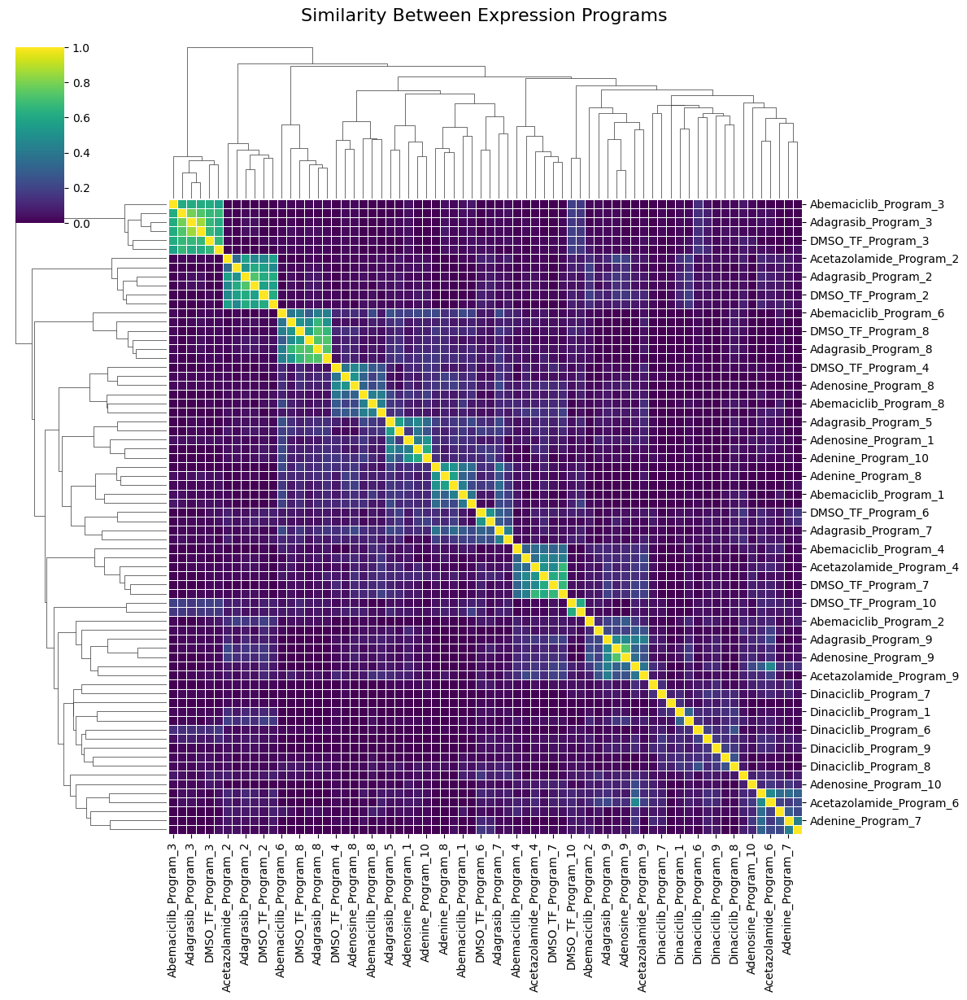

In [ ]:
# ==============================================================================
# Part 2: Load a Subset of Files for Comparison
# ==============================================================================
print("\n--- Step 2: Loading a Subset of Drug Files ---")

# Let's compare the control against two interesting drugs
files_to_load = [
    "DMSO_TF.h5ad",
    "Adagrasib.h5ad",
    "Abemaciclib.h5ad",
    "Acetazolamide.h5ad",
    "Adenine.h5ad",
    "Adenosine.h5ad",
    "Dinaciclib.h5ad" # A CDK inhibitor, likely to affect cell cycle
]

adata_dict = {}
for file_name in files_to_load:
    try:
        drug_label = file_name.replace('.h5ad', '')
        adata_single = sc.read_h5ad(os.path.join(source_data_folder, file_name))
        adata_dict[drug_label] = adata_single
        print(f"--> Successfully loaded: {file_name}")
    except Exception as e:
        print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")

if not adata_dict:
    raise RuntimeError("Could not load any valid AnnData files.")

# Load gene metadata for mapping IDs to symbols later
gene_metadata_df = pd.read_parquet(gene_metadata_path)
id_to_symbol_map = gene_metadata_df.set_index('ensembl_id')['gene_symbol'].to_dict()


# ==============================================================================
# Part 3: Run NMF to Find Expression Programs in Each Condition
# ==============================================================================
print("\n--- Step 3: Finding Expression Programs using NMF ---")

expression_programs = {}
n_programs = 10 # Let's find 5 programs per condition
n_top_genes = 25 # And define each program by its top 50 genes

for drug_name, adata in adata_dict.items():
    print(f"\n--- Processing: {drug_name} ---")

    # Standard preprocessing
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, n_top_genes=2000)
    adata_hvg = adata[:, adata.var.highly_variable].copy()

    # Initialize and run the NMF model
    print(f"Running NMF to find {n_programs} programs...")
    model = NMF(n_components=n_programs, init='nndsvda', random_state=42)
    # W is the cell-by-program matrix, H is the program-by-gene matrix
    W = model.fit_transform(adata_hvg.X)
    H = model.components_

    # For each of the 5 programs, get the top 50 genes
    for i in range(n_programs):
        program_name = f"{drug_name}_Program_{i+1}"
        # Get the indices of the top genes for this program from the H matrix
        top_gene_indices = np.argsort(H[i, :])[::-1][:n_top_genes]
        # Get the gene IDs using these indices
        top_gene_ids = adata_hvg.var_names[top_gene_indices].tolist()
        # Store the list of gene IDs
        expression_programs[program_name] = top_gene_ids

print("\n✅ NMF complete. Found a total of", len(expression_programs), "expression programs.")


# ==============================================================================
# Part 4: Compare Programs and Visualize Similarity (Replicating Fig 2c)
# ==============================================================================
print("\n--- Step 4: Comparing Programs and Generating Similarity Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

# Calculate the Jaccard similarity between each pair of programs
for prog1_name, genes1 in expression_programs.items():
    for prog2_name, genes2 in expression_programs.items():
        set1 = set(genes1)
        set2 = set(genes2)
        intersection = len(set1.intersection(set2))
        union = len(set1.union(set2))
        similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

# --- Generate a Clustered Heatmap ---
print("Generating program similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='viridis',
    annot=False,
    linewidths=.5,
    figsize=(12, 12)
)
plt.suptitle("Similarity Between Expression Programs", y=1.02, fontsize=16)
plt.show()


In [ ]:
cluster_program_names = ['Abemaciclib_Program_3', 'Adagrasib_Program_3', 'DMSO_TF_Program_3', 'Acetazolamide_Program_2']

In [ ]:
# --- Correctly create the gene map and perform the mapping ---
try:
    gene_metadata_df = pd.read_parquet(gene_metadata_path)
    # This now correctly maps the numeric token ID to the gene symbol
    id_to_symbol_map = gene_metadata_df.set_index('token_id')['gene_symbol'].to_dict()
    print("✅ Successfully created gene map (token_id -> gene_symbol).")

    # Get all unique genes from the programs in your chosen cluster
    cluster_genes_ids = set()
    for prog_name in cluster_program_names:
        if prog_name in expression_programs:
            # The gene IDs in `expression_programs` are strings, so we convert them to integers
            # to match the keys in our new dictionary.
            integer_ids = [int(gid) for gid in expression_programs[prog_name]]
            cluster_genes_ids.update(integer_ids)

    # Map the integer gene IDs to symbols
    cluster_gene_symbols = [id_to_symbol_map.get(gid, str(gid)) for gid in cluster_genes_ids]
    print(f"✅ Successfully mapped {len(cluster_gene_symbols)} gene IDs to symbols.")

except Exception as e:
    print(f"--> ERROR: Could not load or process gene metadata. Error: {e}")
    cluster_gene_symbols = [] # Set to empty list on failure


print(f"\nPerforming Gene Set Enrichment Analysis (GSEA) on the {len(cluster_gene_symbols)} genes in this cluster...")

# Run GSEA using the 'gseapy' library
if cluster_gene_symbols:
    try:
        gseapy_results = gp.enrichr(
            gene_list=cluster_gene_symbols,
            gene_sets=['MSigDB_Hallmark_2020'],
            organism='Human'
        )

        if gseapy_results.results.empty:
            print("\n--- No enriched pathways found for this gene cluster. ---")
        else:
            print("\n--- Top Enriched Pathways for this Cluster (including non-significant): ---")
            # Display the full results table to see all pathways, even non-significant ones
            print(gseapy_results.results[['Gene_set', 'Term', 'P-value', 'Adjusted P-value', 'Genes']].to_string())
            print("--------------------------------------------------------------------------------")

    except Exception as e:
        print(f"--> GSEA failed. This can happen if the gene list is too small or due to connection issues. Error: {e}")
else:
    print("--> Skipping GSEA because gene list is empty.")


✅ Successfully created gene map (token_id -> gene_symbol).
✅ Successfully mapped 58 gene IDs to symbols.

Performing Gene Set Enrichment Analysis (GSEA) on the 58 genes in this cluster...

--- Top Enriched Pathways for this Cluster (including non-significant): ---
                Gene_set                               Term   P-value  Adjusted P-value         Genes
0   MSigDB_Hallmark_2020                         DNA Repair  0.070339            0.4422  VPS37B;ZWINT
1   MSigDB_Hallmark_2020                         Glycolysis  0.114465            0.4422  B4GALT4;EGFR
2   MSigDB_Hallmark_2020                    Apical Junction  0.114465            0.4422    EGFR;ITGA9
3   MSigDB_Hallmark_2020  Epithelial Mesenchymal Transition  0.114465            0.4422  COL7A1;ANPEP
4   MSigDB_Hallmark_2020                  Protein Secretion  0.243815            0.4422          EGFR
5   MSigDB_Hallmark_2020           PI3K/AKT/mTOR  Signaling  0.263421            0.4422          EGFR
6   MSigDB_Hallmark_2

In [ ]:
print(f"Analyzing the following cluster: {cluster_program_names}")

# --- Correctly create the gene map and perform the mapping ---
try:
    gene_metadata_df = pd.read_parquet(gene_metadata_path)
    # This now correctly maps the numeric token ID to the gene symbol
    id_to_symbol_map = gene_metadata_df.set_index('token_id')['gene_symbol'].to_dict()
    print("✅ Successfully created gene map (token_id -> gene_symbol).")

    # Get all unique genes from the programs in your chosen cluster
    cluster_genes_ids = set()
    for prog_name in cluster_program_names:
        if prog_name in expression_programs:
            # The gene IDs in `expression_programs` are strings, so we convert them to integers
            # to match the keys in our new dictionary.
            integer_ids = [int(gid) for gid in expression_programs[prog_name]]
            cluster_genes_ids.update(integer_ids)

    # Map the integer gene IDs to symbols
    cluster_gene_symbols = [id_to_symbol_map.get(gid, str(gid)) for gid in cluster_genes_ids]
    print(f"✅ Successfully mapped {len(cluster_gene_symbols)} gene IDs to symbols.")

except Exception as e:
    print(f"--> ERROR: Could not load or process gene metadata. Error: {e}")
    cluster_gene_symbols = [] # Set to empty list on failure


print(f"\nPerforming Gene Set Enrichment Analysis (GSEA) on the {len(cluster_gene_symbols)} genes in this cluster...")

# Run GSEA using the 'gseapy' library
if cluster_gene_symbols:
    try:
        gseapy_results = gp.enrichr(
            gene_list=cluster_gene_symbols,
            gene_sets=['MSigDB_Hallmark_2020'],
            organism='Human'
        )

        # Filter for and display only statistically significant results
        significant_results = gseapy_results.results[gseapy_results.results['Adjusted P-value'] < 0.05]

        if significant_results.empty:
            print("\n--- No statistically significant pathways found for this gene cluster. ---")
        else:
            print("\n--- Top Statistically Significant Enriched Pathways for this Cluster: ---")
            # --- EDIT: Added 'P-value' to the list of columns to print ---
            print(significant_results[['Gene_set', 'Term', 'P-value', 'Adjusted P-value', 'Genes']].to_string())
            print("--------------------------------------------------------------------------------")

    except Exception as e:
        print(f"--> GSEA failed. This can happen if the gene list is too small or due to connection issues. Error: {e}")
else:
    print("--> Skipping GSEA because gene list is empty.")



Analyzing the following cluster: ['Abemaciclib_Program_3', 'Adagrasib_Program_3', 'DMSO_TF_Program_3', 'Acetazolamide_Program_2']
✅ Successfully created gene map (token_id -> gene_symbol).
✅ Successfully mapped 58 gene IDs to symbols.

Performing Gene Set Enrichment Analysis (GSEA) on the 58 genes in this cluster...

--- No statistically significant pathways found for this gene cluster. ---


# Clustering + GSEA

In [ ]:
# Define the path to your new clustered data
data_folder = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/"

try:
    # Get a list of all files in the directory
    all_files = os.listdir(data_folder)
    print(f"\nFiles found in the directory: {all_files}")

    # Find the first .h5ad file to use as a sample for exploration
    sample_file = next((f for f in all_files if f.endswith('.h5ad')), None)

    if sample_file is None:
        raise FileNotFoundError("❌ ERROR: No .h5ad files were found in the specified directory.")

except FileNotFoundError as e:
    raise FileNotFoundError(f"❌ ERROR: The directory was not found. Please check the path: {data_folder}") from e


# ==============================================================================
# Part 2: Load a Sample File and Explore its Structure
# ==============================================================================
print(f"\n--- Step 2: Loading sample file '{sample_file}' to explore its structure ---")

try:
    # Load the single .h5ad file
    file_path = os.path.join(data_folder, sample_file)
    adata = sc.read_h5ad(file_path)

    # --- Print the structure of the AnnData object ---

    print("\n" + "="*50)
    print("      AnnData Object Structure Summary")
    print("="*50)

    print("\n1. Overall AnnData object info:")
    print(adata)

    print("\n" + "-"*50)
    print("2. Cell Metadata Columns (.obs):")
    print("   This DataFrame contains information for each individual cell.")
    print(adata.obs.columns.to_list())

    print("\n" + "-"*50)
    print("3. Embeddings (.obsm):")
    print("   This contains dimensionality reductions like PCA or UMAP.")
    print(list(adata.obsm.keys()))

    print("\n" + "-"*50)
    print("4. Data Layers (.layers):")
    print("   This can contain alternative data matrices, like raw counts.")
    print(list(adata.layers.keys()))

    print("\n" + "="*50)


except Exception as e:
    print(f"❌ ERROR: Failed to load or process the file '{sample_file}'. Error: {e}")




Files found in the directory: ['SW620.h5ad', 'SW480.h5ad', 'SW620_Hypoxia.h5ad']

--- Step 2: Loading sample file 'SW620.h5ad' to explore its structure ---

      AnnData Object Structure Summary

1. Overall AnnData object info:
AnnData object with n_obs × n_vars = 381 × 2000
    obs: 'louvain'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

--------------------------------------------------
2. Cell Metadata Columns (.obs):
   This DataFrame contains information for each individual cell.
['louvain']

--------------------------------------------------
3. Embeddings (.obsm):
   This contains dimensionality reductions like PCA or UMAP.
['X_pca', 'X_umap']

--------------------------------------------------
4. Data Layers (.layers):
   This can contain alternative data

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from google.colab import drive

# Install the required library for Gene Set Enrichment Analysis
!pip install -q gseapy
import gseapy as gp

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define path to the clustered data file
data_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad"

# ==============================================================================
# Part 2: Load Data and Find Marker Genes for Each Cluster
# ==============================================================================
print("\n--- Step 2: Loading Data and Finding Marker Genes ---")

try:
    # Load the clustered AnnData object
    adata = sc.read_h5ad(data_path)
    print(f"✅ Successfully loaded: {os.path.basename(data_path)}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load the required file. Error: {e}")

# --- Find Marker Genes ---
# This statistical test finds genes that are significantly
# upregulated in each 'louvain' cluster compared to all other cells.
print("\nFinding marker genes for each cluster...")
sc.tl.rank_genes_groups(adata, 'louvain', method='wilcoxon')
print("✅ Marker gene analysis complete.")


# ==============================================================================
# Part 3: Perform GSEA on Each Cluster
# ==============================================================================
print("\n--- Step 3: Performing GSEA for Each Cluster ---")

# Get the list of cluster IDs from the data
cluster_ids = adata.obs['louvain'].unique().tolist()
# Sort the cluster IDs to ensure a consistent order
cluster_ids.sort()

# Loop through each cluster, get its marker genes, and run GSEA
for cluster in cluster_ids:
    print("\n" + "="*50)
    print(f"      ANALYZING CLUSTER: {cluster}")
    print("="*50)

    # Extract the list of top 100 marker genes for the current cluster
    marker_genes_df = sc.get.rank_genes_groups_df(adata, group=cluster)

    # Filter for significant markers (p-value < 0.05)
    significant_markers = marker_genes_df[marker_genes_df['pvals_adj'] < 0.05]
    top_100_markers = significant_markers.head(100)['names'].tolist()

    if not top_100_markers:
        print(f"--> No significant marker genes found for Cluster {cluster}. Skipping GSEA.")
        continue

    print(f"Found {len(top_100_markers)} significant marker genes. Performing GSEA...")

    # Run GSEA using the 'gseapy' library
    try:
        gsea_results = gp.enrichr(
            gene_list=top_100_markers,
            gene_sets=['MSigDB_Hallmark_2020'],
            organism='Human'
        )

        # Filter for and display only statistically significant results
        significant_pathways = gsea_results.results[gsea_results.results['Adjusted P-value'] < 0.05]

        if significant_pathways.empty:
            print(f"\n--- No statistically significant pathways found for Cluster {cluster}. ---")
        else:
            print(f"\n--- Top Statistically Significant Enriched Pathways for Cluster {cluster}: ---")
            print(significant_pathways[['Term', 'Adjusted P-value', 'Genes']].to_string())
            print("--------------------------------------------------------------------------------")

    except Exception as e:
        print(f"--> GSEA failed for Cluster {cluster}. Error: {e}")



--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading Data and Finding Marker Genes ---
✅ Successfully loaded: SW620.h5ad

Finding marker genes for each cluster...


/usr/local/lib/python3.11/dist-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/usr/local/lib/python3.11/dist-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(


✅ Marker gene analysis complete.

--- Step 3: Performing GSEA for Each Cluster ---

      ANALYZING CLUSTER: 0
Found 100 significant marker genes. Performing GSEA...

--- Top Statistically Significant Enriched Pathways for Cluster 0: ---
                       Term  Adjusted P-value                                                                 Genes
0               E2F Targets      8.746286e-10  SLBP;DUT;PCNA;ATAD2;HMGA1;NOLC1;SMC3;UNG;PSMC3IP;ORC6;MCM4;MCM5;MCM6
1           G2-M Checkpoint      9.649795e-08          GINS2;CHAF1A;ORC6;CDC45;NCL;HMGA1;NOLC1;MCM5;CDC6;MCM6;FBXO5
2          mTORC1 Signaling      6.168483e-07            CYB5B;IDI1;HSPA5;PRDX1;SLC2A1;MCM4;DHCR24;SLC1A5;UNG;HSPD1
3            Myc Targets V1      6.168483e-07                  DUT;PCNA;CDC45;VBP1;NOLC1;MCM4;MCM5;MCM6;SRSF7;HSPD1
4    Estrogen Response Late      5.745490e-05                       GINS2;KRT19;SLC16A1;GAL;TRIM29;ABHD2;CDC6;FKBP4
5            Myc Targets V2      6.102319e-05                     

--- Step 1: Mounting Google Drive and Loading Data ---
Mounted at /content/drive
✅ Successfully loaded: SW620.h5ad

--- Step 2: Generating UMAP Visualizations ---
Generating UMAP colored by cluster...


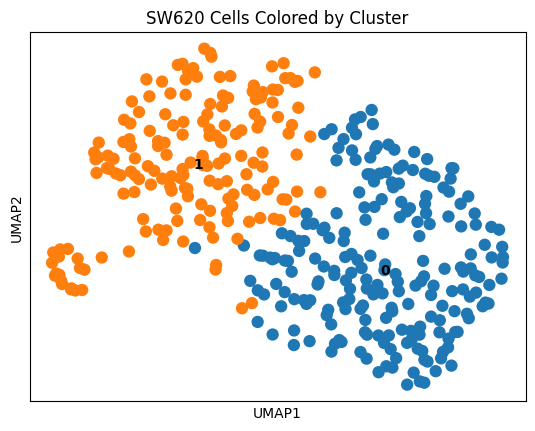


Generating UMAPs colored by marker gene expression...


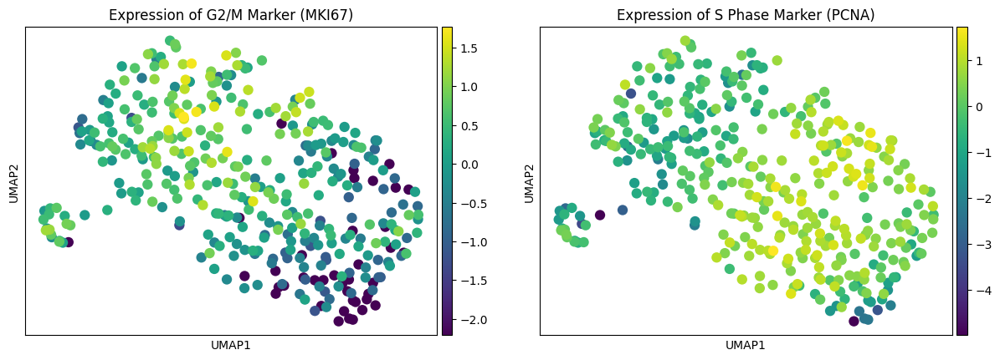

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import scanpy as sc
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Loading Data ---")
drive.mount('/content/drive', force_remount=True)

# Define path to the clustered data file
data_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad"

try:
    # Load the clustered AnnData object, which already contains UMAP coordinates
    adata = sc.read_h5ad(data_path)
    print(f"✅ Successfully loaded: {os.path.basename(data_path)}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load the required file. Error: {e}")

# ==============================================================================
# Part 2: Visualization
# ==============================================================================
print("\n--- Step 2: Generating UMAP Visualizations ---")

# --- Plot 1: UMAP Colored by Cluster ID ---
# This shows the spatial separation of the clusters you analyzed.
print("Generating UMAP colored by cluster...")
sc.pl.umap(
    adata,
    color='louvain',
    title='SW620 Cells Colored by Cluster',
    legend_loc='on data' # Puts the label directly on the cluster
)

# --- Plot 2: UMAP Colored by Key Marker Genes ---
# This confirms the identity of each cluster by showing the expression
# of a key gene for each phase.
# MKI67 is a marker for G2/M phase (Cluster 1)
# PCNA is a marker for S phase (Cluster 0)
print("\nGenerating UMAPs colored by marker gene expression...")
sc.pl.umap(
    adata,
    color=['MKI67', 'PCNA'],
    title=['Expression of G2/M Marker (MKI67)', 'Expression of S Phase Marker (PCNA)'],
    cmap='viridis' # Use a vibrant colormap
)



# SW620

In [ ]:
# ==============================================================================
# Part 2: Load Data and Find Marker Genes for Each Cluster
# ==============================================================================
print("\n--- Step 2: Loading Data and Finding Marker Genes ---")

try:
    # Load the clustered AnnData object
    adata = sc.read_h5ad(data_path)
    print(f"✅ Successfully loaded: {os.path.basename(data_path)}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load the required file. Error: {e}")

# --- Find Marker Genes ---
# This statistical test finds genes that are significantly
# upregulated in each 'louvain' cluster compared to all other cells.
print("\nFinding marker genes for each cluster...")
sc.tl.rank_genes_groups(adata, 'louvain', method='wilcoxon')
print("✅ Marker gene analysis complete.")


# ==============================================================================
# Part 3: Perform GSEA on Each Cluster
# ==============================================================================
print("\n--- Step 3: Performing GSEA for Each Cluster ---")

# Get the list of cluster IDs from the data
cluster_ids = adata.obs['louvain'].unique().tolist()
# Sort the cluster IDs to ensure a consistent order
cluster_ids.sort()

# Loop through each cluster, get its marker genes, and run GSEA
for cluster in cluster_ids:
    print("\n" + "="*50)
    print(f"      ANALYZING CLUSTER: {cluster}")
    print("="*50)

    # Extract the list of top 100 marker genes for the current cluster
    marker_genes_df = sc.get.rank_genes_groups_df(adata, group=cluster)

    # Filter for significant markers (p-value < 0.05)
    significant_markers = marker_genes_df[marker_genes_df['pvals_adj'] < 0.05]
    top_100_markers = significant_markers.head(100)['names'].tolist()

    if not top_100_markers:
        print(f"--> No significant marker genes found for Cluster {cluster}. Skipping GSEA.")
        continue

    print(f"Found {len(top_100_markers)} significant marker genes. Performing GSEA...")

    # Run GSEA using the 'gseapy' library
    try:
        gsea_results = gp.enrichr(
            gene_list=top_100_markers,
            gene_sets=['MSigDB_Hallmark_2020'], # A great database for cancer biology
            organism='Human'
        )

        # Filter for and display only statistically significant results
        significant_pathways = gsea_results.results[gsea_results.results['Adjusted P-value'] < 0.05]

        if significant_pathways.empty:
            print(f"\n--- No statistically significant pathways found for Cluster {cluster}. ---")
        else:
            print(f"\n--- Top Statistically Significant Enriched Pathways for Cluster {cluster}: ---")
            print(significant_pathways[['Term', 'Adjusted P-value', 'Genes']].to_string())
            print("--------------------------------------------------------------------------------")

    except Exception as e:
        print(f"--> GSEA failed for Cluster {cluster}. Error: {e}")




--- Step 2: Loading Data and Finding Marker Genes ---
✅ Successfully loaded: SW620.h5ad

Finding marker genes for each cluster...


/usr/local/lib/python3.11/dist-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/usr/local/lib/python3.11/dist-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(


✅ Marker gene analysis complete.

--- Step 3: Performing GSEA for Each Cluster ---

      ANALYZING CLUSTER: 0
Found 100 significant marker genes. Performing GSEA...

--- Top Statistically Significant Enriched Pathways for Cluster 0: ---
                       Term  Adjusted P-value                                                                 Genes
0               E2F Targets      8.746286e-10  SLBP;DUT;PCNA;ATAD2;HMGA1;NOLC1;SMC3;UNG;PSMC3IP;ORC6;MCM4;MCM5;MCM6
1           G2-M Checkpoint      9.649795e-08          GINS2;CHAF1A;ORC6;CDC45;NCL;HMGA1;NOLC1;MCM5;CDC6;MCM6;FBXO5
2          mTORC1 Signaling      6.168483e-07            CYB5B;IDI1;HSPA5;PRDX1;SLC2A1;MCM4;DHCR24;SLC1A5;UNG;HSPD1
3            Myc Targets V1      6.168483e-07                  DUT;PCNA;CDC45;VBP1;NOLC1;MCM4;MCM5;MCM6;SRSF7;HSPD1
4    Estrogen Response Late      5.745490e-05                       GINS2;KRT19;SLC16A1;GAL;TRIM29;ABHD2;CDC6;FKBP4
5            Myc Targets V2      6.102319e-05                     

# SW480

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from google.colab import drive

# Install the required library for Gene Set Enrichment Analysis
!pip install -q gseapy
import gseapy as gp

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define path to the clustered data file
data_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW480.h5ad"

# ==============================================================================
# Part 2: Load Data and Find Marker Genes for Each Cluster
# ==============================================================================
print("\n--- Step 2: Loading Data and Finding Marker Genes ---")

try:
    # Load the clustered AnnData object
    adata = sc.read_h5ad(data_path)
    print(f"✅ Successfully loaded: {os.path.basename(data_path)}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load the required file. Error: {e}")

# --- Find Marker Genes ---
# This statistical test finds genes that are significantly
# upregulated in each 'louvain' cluster compared to all other cells.
print("\nFinding marker genes for each cluster...")
sc.tl.rank_genes_groups(adata, 'louvain', method='wilcoxon')
print("✅ Marker gene analysis complete.")


# ==============================================================================
# Part 3: Perform GSEA on Each Cluster
# ==============================================================================
print("\n--- Step 3: Performing GSEA for Each Cluster ---")

# Get the list of cluster IDs from the data
cluster_ids = adata.obs['louvain'].unique().tolist()
# Sort the cluster IDs to ensure a consistent order
cluster_ids.sort()

# Loop through each cluster, get its marker genes, and run GSEA
for cluster in cluster_ids:
    print("\n" + "="*50)
    print(f"      ANALYZING CLUSTER: {cluster}")
    print("="*50)

    # Extract the list of top 100 marker genes for the current cluster
    marker_genes_df = sc.get.rank_genes_groups_df(adata, group=cluster)

    # Filter for significant markers (p-value < 0.05)
    significant_markers = marker_genes_df[marker_genes_df['pvals_adj'] < 0.05]
    top_100_markers = significant_markers.head(100)['names'].tolist()

    if not top_100_markers:
        print(f"--> No significant marker genes found for Cluster {cluster}. Skipping GSEA.")
        continue

    print(f"Found {len(top_100_markers)} significant marker genes. Performing GSEA...")

    # Run GSEA using the 'gseapy' library
    try:
        gsea_results = gp.enrichr(
            gene_list=top_100_markers,
            gene_sets=['MSigDB_Hallmark_2020'], # A great database for cancer biology
            organism='Human'
        )

        # Filter for and display only statistically significant results
        significant_pathways = gsea_results.results[gsea_results.results['Adjusted P-value'] < 0.05]

        if significant_pathways.empty:
            print(f"\n--- No statistically significant pathways found for Cluster {cluster}. ---")
        else:
            print(f"\n--- Top Statistically Significant Enriched Pathways for Cluster {cluster}: ---")
            print(significant_pathways[['Term', 'Adjusted P-value', 'Genes']].to_string())
            print("--------------------------------------------------------------------------------")

    except Exception as e:
        print(f"--> GSEA failed for Cluster {cluster}. Error: {e}")



--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Loading Data and Finding Marker Genes ---
✅ Successfully loaded: SW480.h5ad

Finding marker genes for each cluster...
✅ Marker gene analysis complete.

--- Step 3: Performing GSEA for Each Cluster ---

      ANALYZING CLUSTER: 0


/usr/local/lib/python3.11/dist-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/usr/local/lib/python3.11/dist-packages/scanpy/tools/_rank_genes_groups.py:482: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(


Found 100 significant marker genes. Performing GSEA...

--- Top Statistically Significant Enriched Pathways for Cluster 0: ---
                   Term  Adjusted P-value                                                            Genes
0           E2F Targets      1.467740e-08  PSMC3IP;POLD3;SLBP;DUT;PCNA;MCM7;CCNE1;ATAD2;MCM3;MCM4;MCM6;UNG
1        Myc Targets V1      1.521687e-05                   EEF1B2;DUT;NPM1;PCNA;RFC4;MCM7;YWHAQ;MCM4;MCM6
2       G2-M Checkpoint      1.031242e-04                   CASP8AP2;MT2A;CHAF1A;EXO1;MCM3;CDC6;MCM6;FBXO5
3            DNA Repair      1.128412e-03                                    POLD3;DUT;FEN1;PCNA;RFC4;RNMT
4        UV Response Up      1.200256e-03                             SULT1A1;FEN1;RFC4;CCNE1;SELENOW;ASNS
5             Apoptosis      9.049024e-03                                    IFITM3;LGALS3;JUN;KRT18;TIMP1
6        Myc Targets V2      1.551117e-02                                                    NPM1;MCM4;UNG
7  IL-2/STAT5 Sig

--- Step 1: Preparing GSEA Results for Comparison ---
✅ Data prepared successfully.

--- Step 2: Generating Comparative Dot Plot ---


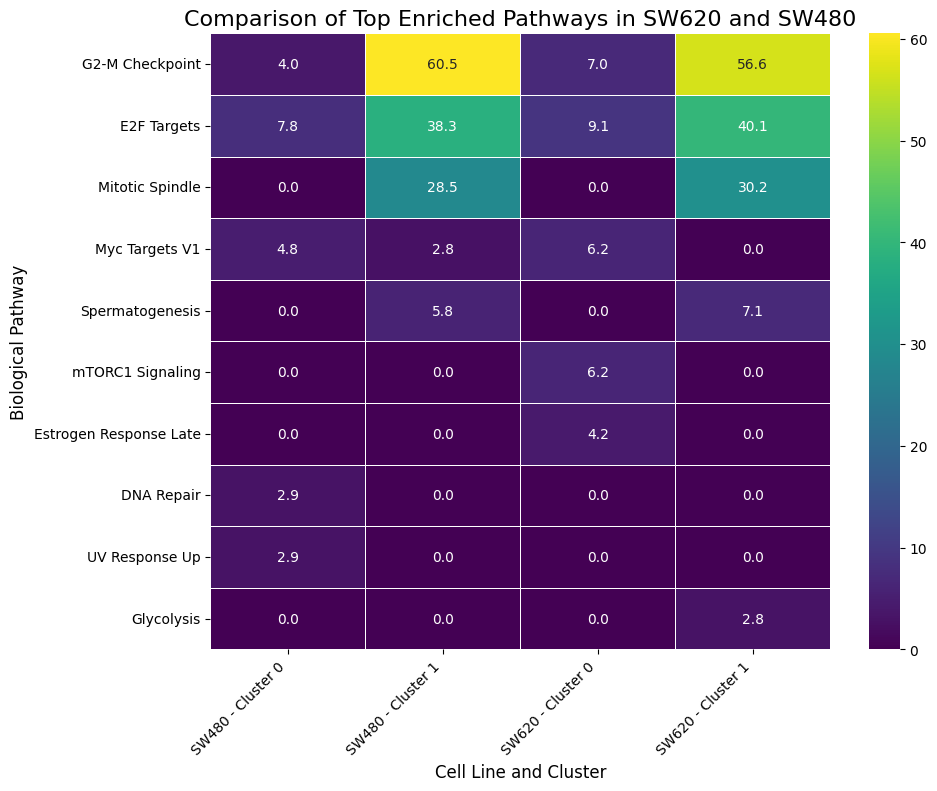

In [ ]:
# ==============================================================================
# Part 1: Setup and Data Entry
# We will manually enter the GSEA results you provided.
# ==============================================================================
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

print("--- Step 1: Preparing GSEA Results for Comparison ---")

# Manually create DataFrames from your GSEA output
sw620_c0_data = {
    'Term': ['E2F Targets', 'G2-M Checkpoint', 'mTORC1 Signaling', 'Myc Targets V1', 'Estrogen Response Late'],
    'Adjusted P-value': [8.74e-10, 9.65e-08, 6.17e-07, 6.17e-07, 5.75e-05]
}
sw620_c1_data = {
    'Term': ['G2-M Checkpoint', 'E2F Targets', 'Mitotic Spindle', 'Spermatogenesis', 'Glycolysis'],
    'Adjusted P-value': [2.52e-57, 7.45e-41, 6.80e-31, 8.81e-08, 1.42e-03]
}
sw480_c0_data = {
    'Term': ['E2F Targets', 'Myc Targets V1', 'G2-M Checkpoint', 'DNA Repair', 'UV Response Up'],
    'Adjusted P-value': [1.47e-08, 1.52e-05, 1.03e-04, 1.13e-03, 1.20e-03]
}
sw480_c1_data = {
    'Term': ['G2-M Checkpoint', 'E2F Targets', 'Mitotic Spindle', 'Spermatogenesis', 'Myc Targets V1'],
    'Adjusted P-value': [3.00e-61, 4.56e-39, 3.03e-29, 1.45e-06, 1.52e-03]
}

# Create individual DataFrames
df_sw620_c0 = pd.DataFrame(sw620_c0_data)
df_sw620_c1 = pd.DataFrame(sw620_c1_data)
df_sw480_c0 = pd.DataFrame(sw480_c0_data)
df_sw480_c1 = pd.DataFrame(sw480_c1_data)

# Add identifiers for the source of the data
df_sw620_c0['ID'] = 'SW620 - Cluster 0'
df_sw620_c1['ID'] = 'SW620 - Cluster 1'
df_sw480_c0['ID'] = 'SW480 - Cluster 0'
df_sw480_c1['ID'] = 'SW480 - Cluster 1'

# Combine all results into a single DataFrame
combined_df = pd.concat([df_sw620_c0, df_sw620_c1, df_sw480_c0, df_sw480_c1])

# Calculate -log10(p-value) for visualization, as higher values are more significant
combined_df['-log10(Adj P-value)'] = -np.log10(combined_df['Adjusted P-value'])

print("✅ Data prepared successfully.")

# ==============================================================================
# Part 2: Visualization
# ==============================================================================
print("\n--- Step 2: Generating Comparative Dot Plot ---")

# We need to pivot the table to get it into the right format for a heatmap/dot plot
pivot_df = combined_df.pivot(index='Term', columns='ID', values='-log10(Adj P-value)').fillna(0)

# Find the most significant pathways across all clusters to display
# We'll sum the significance scores and take the top 10
top_pathways = pivot_df.sum(axis=1).nlargest(10).index
pivot_df_top = pivot_df.loc[top_pathways]


# Create the heatmap, which functions as a dot plot in this context
plt.figure(figsize=(10, 8))
sns.heatmap(
    pivot_df_top,
    cmap="viridis",
    linewidths=.5,
    annot=True, # Show the significance scores
    fmt=".1f"   # Format numbers to one decimal place
)

plt.title("Comparison of Top Enriched Pathways in SW620 and SW480", fontsize=16)
plt.xlabel("Cell Line and Cluster", fontsize=12)
plt.ylabel("Biological Pathway", fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)
plt.show()



In [ ]:
!pip install -q scanpy anndata igraph leidenalg louvain
!pip install -q --user scikit-misc

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 55.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 189.0/189.0 kB 13.1 MB/s eta 0:00:00


# Jaccard Index grouping by MOA

In [ ]:
# Define the path to your sample metadata file
metadata_path = "/content/drive/MyDrive/TAHOE/metadata/drug_metadata.parquet"

try:
    # Efficiently load only the columns we need
    columns_to_load = ['drug', 'moa-fine']
    df = pd.read_parquet(metadata_path, columns=columns_to_load)

    # Drop rows where drug or moa is not defined
    df.dropna(inplace=True)

    # Get a clean list of unique drugs and their MOA
    unique_drug_moa = df.drop_duplicates(subset=['drug'])

    print("\n✅ Metadata loaded successfully!")

    print("\n--- Sample of 10 drugs and their 'moa-fine': ---")
    print(unique_drug_moa.head(10).to_string(index=False))

    print("\n\n--- Count of drugs per 'moa-fine' category: ---")
    print(unique_drug_moa['moa-fine'].value_counts().to_string())

except Exception as e:
    print(f"❌ ERROR: Could not read the file. Please check the path. Error: {e}")



✅ Metadata loaded successfully!

--- Sample of 10 drugs and their 'moa-fine': ---
                              drug                       moa-fine
                              Talc                        unclear
                        Bortezomib           Proteasome inhibitor
                          Ixazomib           Proteasome inhibitor
                  Ixazomib citrate           Proteasome inhibitor
                 Lactate (calcium)                        unclear
         Bisoprolol (hemifumarate)           Adrenoceptor agonist
                      Fumaric acid                        unclear
                       Hydroxyurea DNA synthesis/repair inhibitor
L-Eflornithine (monohydrochloride)                        unclear
        Cysteamine (hydrochloride)                        unclear


--- Count of drugs per 'moa-fine' category: ---
moa-fine
unclear                            199
DNA synthesis/repair inhibitor      27
Other TK inhibitor                  15
Cyclooxygenase 

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 597.6/597.6 kB 12.3 MB/s eta 0:00:00
--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Selecting an MOA Group and Loading Data ---
Targeting MOA: 'Proteasome inhibitor'
Found 3 drugs in this group: ['Bortezomib', 'Ixazomib', 'Ixazomib citrate']
--> Successfully loaded: Bortezomib.h5ad
--> Successfully loaded: Ixazomib.h5ad
--> Successfully loaded: Ixazomib citrate.h5ad

--- Step 3: Finding Expression Programs using NMF ---

--- Processing: Bortezomib ---
Running NMF to find 5 programs...

--- Processing: Ixazomib ---
Running NMF to find 5 programs...

--- Processing: Ixazomib citrate ---
Running NMF to find 5 programs...

✅ NMF complete. Found a total of 15 expression programs.

--- Step 4: Comparing Programs and Generating Similarity Heatmap ---
Generating program similarity heatmap...


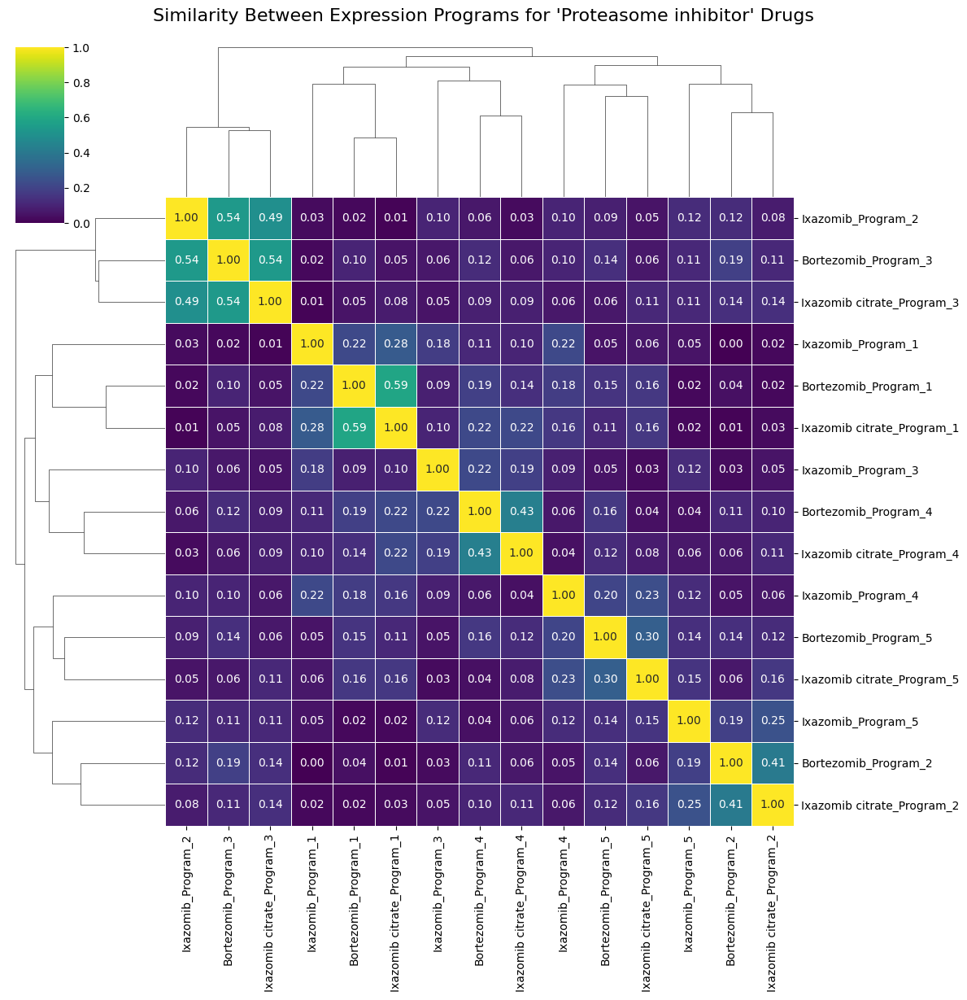

In [ ]:
# Install the required library for Gene Set Enrichment Analysis
!pip install -q gseapy

# Import the necessary libraries for NMF
from sklearn.decomposition import NMF
import gseapy as gp

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
drug_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/drug_metadata.parquet" # Assuming this is the correct name

# ==============================================================================
# Part 2: Select an MOA Group and Load Corresponding Data
# ==============================================================================
print("\n--- Step 2: Selecting an MOA Group and Loading Data ---")

# --- Define the Mechanism of Action you want to analyze ---
target_moa = "Proteasome inhibitor"
print(f"Targeting MOA: '{target_moa}'")

try:
    # Load the drug metadata to find which drugs belong to this MOA
    drug_df = pd.read_parquet(drug_metadata_path)
    # Filter for drugs in the target MOA, excluding any with 'unclear' names
    drugs_in_moa = drug_df[drug_df['moa-fine'] == target_moa]['drug'].dropna().unique().tolist()

    if not drugs_in_moa:
        raise ValueError(f"No drugs found for the MOA: {target_moa}")

    print(f"Found {len(drugs_in_moa)} drugs in this group: {drugs_in_moa}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Could not load or process drug metadata. Error: {e}")


# --- Load the .h5ad files for the selected drugs ---
adata_dict = {}
for drug_name in drugs_in_moa:
    file_name = f"{drug_name}.h5ad"
    file_path = os.path.join(source_data_folder, file_name)
    if os.path.exists(file_path):
        try:
            adata_single = sc.read_h5ad(file_path)
            adata_dict[drug_name] = adata_single
            print(f"--> Successfully loaded: {file_name}")
        except Exception as e:
            print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")
    else:
        print(f"--> WARNING: File not found for drug '{drug_name}'. Skipping.")

if not adata_dict:
    raise RuntimeError("Could not load any valid AnnData files for the selected MOA.")


# ==============================================================================
# Part 3: Run NMF to Find Expression Programs in Each Drug Treatment
# ==============================================================================
print("\n--- Step 3: Finding Expression Programs using NMF ---")

expression_programs = {}
n_programs = 5 # Let's find 5 programs per condition
n_top_genes = 50 # And define each program by its top 50 genes

for drug_name, adata in adata_dict.items():
    print(f"\n--- Processing: {drug_name} ---")

    # Standard preprocessing
    sc.pp.normalize_total(adata, target_sum=1e4)
    sc.pp.log1p(adata)
    sc.pp.highly_variable_genes(adata, n_top_genes=2000)
    adata_hvg = adata[:, adata.var.highly_variable].copy()

    # Initialize and run the NMF model
    print(f"Running NMF to find {n_programs} programs...")
    model = NMF(n_components=n_programs, init='nndsvda', random_state=42)
    W = model.fit_transform(adata_hvg.X) # Cell-by-program matrix
    H = model.components_ # Program-by-gene matrix

    # For each of the 5 programs, get the top 50 genes
    for i in range(n_programs):
        program_name = f"{drug_name}_Program_{i+1}"
        top_gene_indices = np.argsort(H[i, :])[::-1][:n_top_genes]
        top_gene_ids = adata_hvg.var_names[top_gene_indices].tolist()
        expression_programs[program_name] = top_gene_ids

print("\n✅ NMF complete. Found a total of", len(expression_programs), "expression programs.")


# ==============================================================================
# Part 4: Compare Programs and Visualize Similarity (Replicating Fig 2c)
# ==============================================================================
print("\n--- Step 4: Comparing Programs and Generating Similarity Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

# Calculate the Jaccard similarity between each pair of programs
for prog1_name, genes1 in expression_programs.items():
    for prog2_name, genes2 in expression_programs.items():
        set1 = set(genes1)
        set2 = set(genes2)
        intersection = len(set1.intersection(set2))
        union = len(set1.union(set2))
        similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

# --- Generate a Clustered Heatmap ---
print("Generating program similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='viridis',
    annot=True, # Annotate with the similarity score
    fmt=".2f",  # Format to two decimal places
    linewidths=.5,
    figsize=(12, 12)
)
plt.suptitle(f"Similarity Between Expression Programs for '{target_moa}' Drugs", y=1.02, fontsize=16)
plt.show()


--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 3: Running Analysis for All MOA Groups ---
Found the following MOA groups to analyze:
moa-fine
unclear                            199
DNA synthesis/repair inhibitor      27
Other TK inhibitor                  15
Cyclooxygenase inhibitor            13
EGFR/ERBB inhibitor                 12
Other MAPK inhibitor                11
Multi-TK inhibitor                  10
Adrenoceptor agonist                 8
Microtubule inhibitor                7
MTOR inhibitor                       7
PI3K/AKT inhibitor                   6
Protein synthesis inhibitor          6
JAK/STAT inhibitor                   6
Glucocorticoid receptor agonist      5
CDK inhibitor                        5
MEK inhibitor                        5
Retinoic receptor agonist            4
HDAC inhibitor                       4
Androgen receptor antagonist         4
RAS inhibitor                        4
DNA methyltransferase inhibitor 

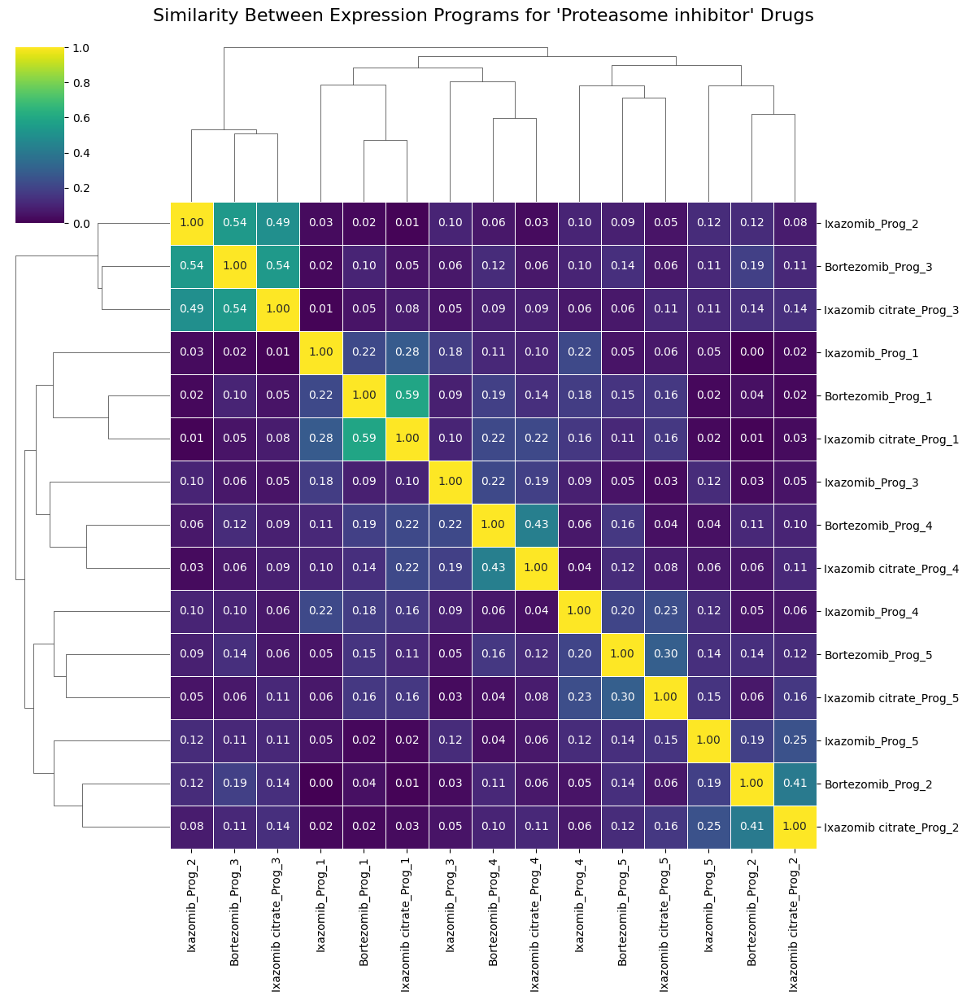


      STARTING ANALYSIS FOR MOA: Adrenoceptor agonist

--- Selecting drugs for MOA: 'Adrenoceptor agonist' ---
Found 8 drugs in this group: ['Bisoprolol (hemifumarate)', 'Vilanterol', 'Norepinephrine (hydrochloride)', 'Clonidine (hydrochloride)', 'Brimonidine', 'Dexmedetomidine', 'Indacaterol (maleate)', 'Phenylephrine (hydrochloride)']
--> Successfully loaded: Bisoprolol (hemifumarate).h5ad
--> Successfully loaded: Vilanterol.h5ad
--> Successfully loaded: Norepinephrine (hydrochloride).h5ad
--> Successfully loaded: Clonidine (hydrochloride).h5ad
--> Successfully loaded: Brimonidine.h5ad
--> Successfully loaded: Dexmedetomidine.h5ad
--> Successfully loaded: Indacaterol (maleate).h5ad
--> Successfully loaded: Phenylephrine (hydrochloride).h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Bisoprolol (hemifumarate) ---

--- Processing: Vilanterol ---

--- Processing: Norepinephrine (hydrochloride) ---

--- Processing: Clonidine (hydrochloride) ---

--- Processing: Brim

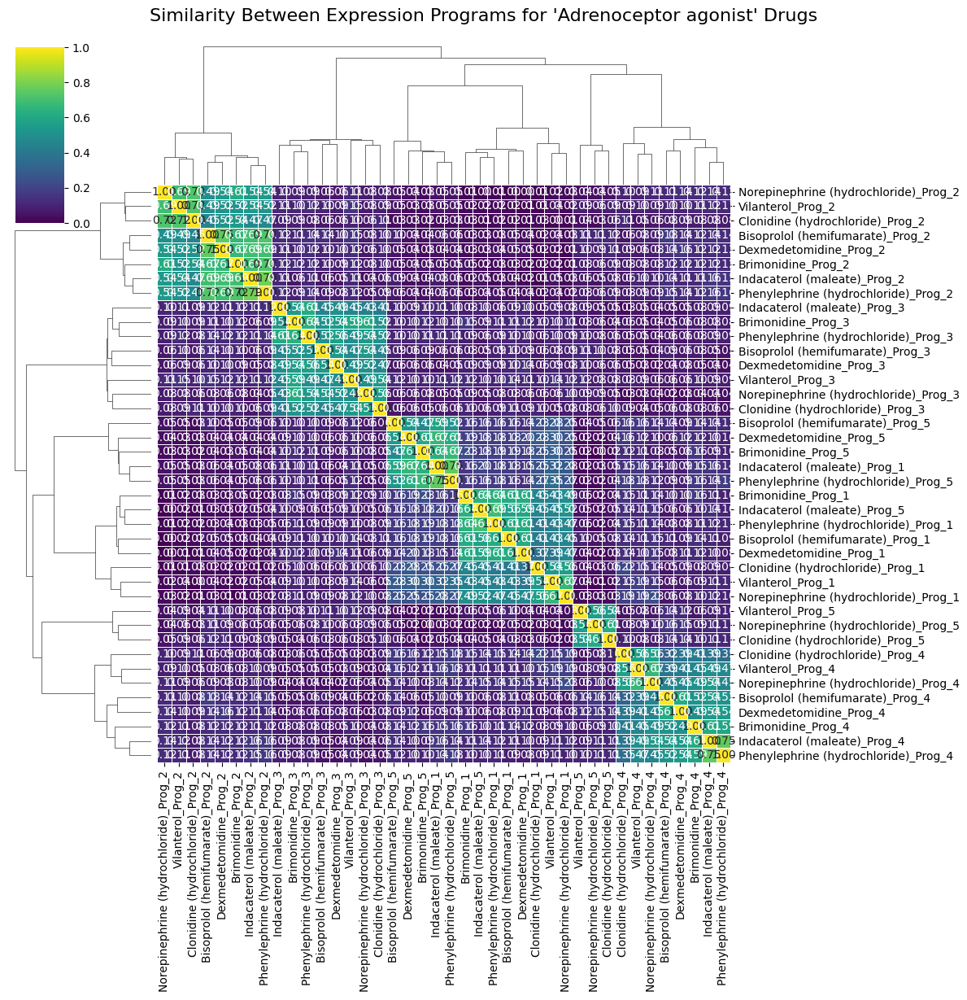


      STARTING ANALYSIS FOR MOA: DNA synthesis/repair inhibitor

--- Selecting drugs for MOA: 'DNA synthesis/repair inhibitor' ---
Found 27 drugs in this group: ['Hydroxyurea', '5-Fluorouracil', 'Mitoxantrone (dihydrochloride)', 'Pemetrexed', 'Gemcitabine', 'Cytarabine', 'Cytarabine (hydrochloride)', 'Clofarabine', 'Trifluridine', 'Idoxuridine', 'olaparib', 'Oxaliplatin', 'Trimetrexate', 'AZD-7648', 'Raltitrexed', 'Doxorubicin (hydrochloride)', 'Epirubicin (hydrochloride)', 'Idarubicin (hydrochloride)', 'Topotecan (hydrochloride)', 'Irinotecan', 'Irinotecan (hydrochloride)', 'Altretamine', 'Methotrexate', 'Bendamustine', 'Rucaparib (phosphate)', 'Amsacrine', 'Busulfan']
--> Successfully loaded: Hydroxyurea.h5ad
--> Successfully loaded: 5-Fluorouracil.h5ad
--> Successfully loaded: Mitoxantrone (dihydrochloride).h5ad
--> Successfully loaded: Pemetrexed.h5ad
--> Successfully loaded: Gemcitabine.h5ad
--> Successfully loaded: Cytarabine.h5ad
--> Successfully loaded: Cytarabine (hydrochlori

/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Mitoxantrone (dihydrochloride) ---

--- Processing: Pemetrexed ---

--- Processing: Gemcitabine ---

--- Processing: Cytarabine ---

--- Processing: Cytarabine (hydrochloride) ---

--- Processing: Clofarabine ---

--- Processing: Trifluridine ---

--- Processing: Idoxuridine ---

--- Processing: olaparib ---

--- Processing: Oxaliplatin ---

--- Processing: Trimetrexate ---

--- Processing: AZD-7648 ---

--- Processing: Raltitrexed ---

--- Processing: Doxorubicin (hydrochloride) ---

--- Processing: Epirubicin (hydrochloride) ---

--- Processing: Idarubicin (hydrochloride) ---

--- Processing: Topotecan (hydrochloride) ---

--- Processing: Irinotecan ---

--- Processing: Irinotecan (hydrochloride) ---

--- Processing: Altretamine ---

--- Processing: Methotrexate ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Bendamustine ---

--- Processing: Rucaparib (phosphate) ---

--- Processing: Amsacrine ---

--- Processing: Busulfan ---

--- Comparing Programs and Generating Similarity Heatmap ---


/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/usr/local/lib/python3.11/dist-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


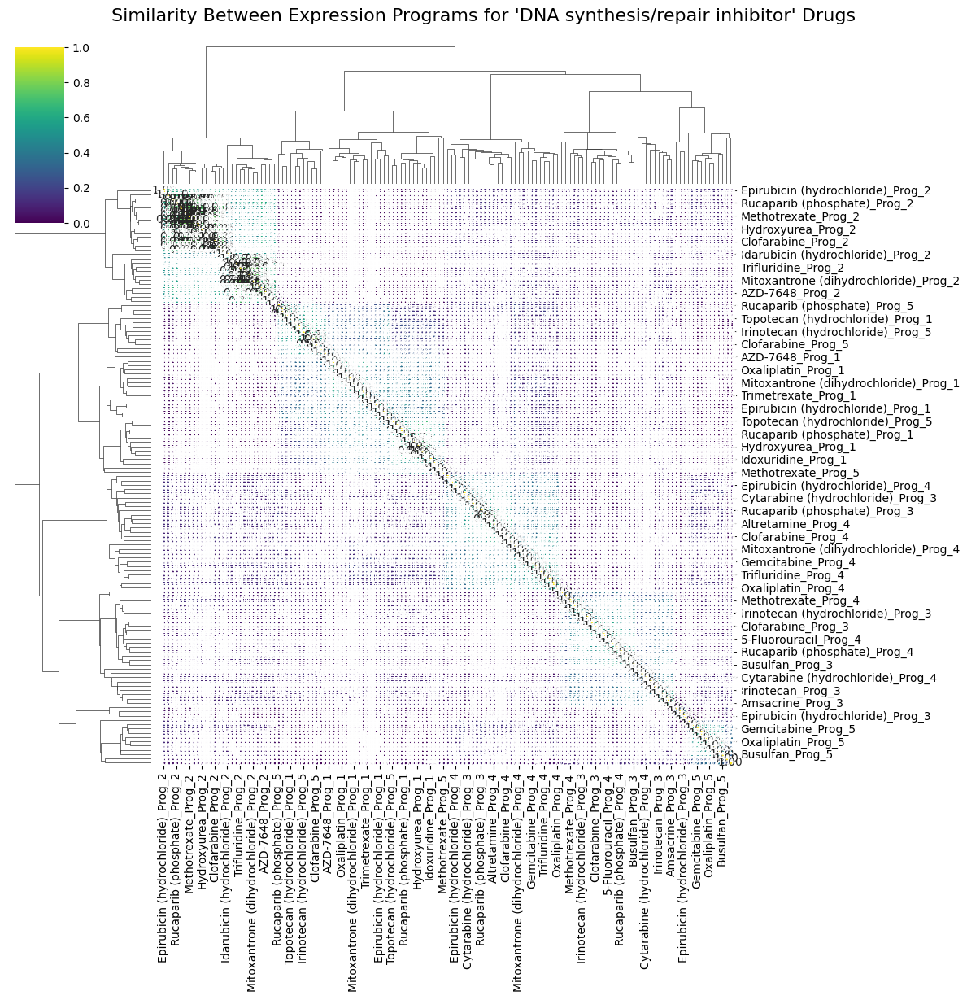


      STARTING ANALYSIS FOR MOA: Cyclooxygenase inhibitor

--- Selecting drugs for MOA: 'Cyclooxygenase inhibitor' ---
Found 13 drugs in this group: ['Gallic acid', 'Gallic acid (hydrate)', 'Sodium Salicylate', 'Salicylic acid', 'Oxaprozin', 'Aspirin', 'Naproxen', 'Valdecoxib', 'Tolmetin', 'Celecoxib', 'Meloxicam', 'Piroxicam', 'Nimesulide']
--> Successfully loaded: Gallic acid.h5ad
--> Successfully loaded: Gallic acid (hydrate).h5ad
--> Successfully loaded: Sodium Salicylate.h5ad
--> Successfully loaded: Salicylic acid.h5ad
--> Successfully loaded: Oxaprozin.h5ad
--> Successfully loaded: Aspirin.h5ad
--> Successfully loaded: Naproxen.h5ad
--> Successfully loaded: Valdecoxib.h5ad
--> Successfully loaded: Tolmetin.h5ad
--> Successfully loaded: Celecoxib.h5ad
--> Successfully loaded: Meloxicam.h5ad
--> Successfully loaded: Piroxicam.h5ad
--> Successfully loaded: Nimesulide.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Gallic acid ---

--- Processing: Gallic acid (

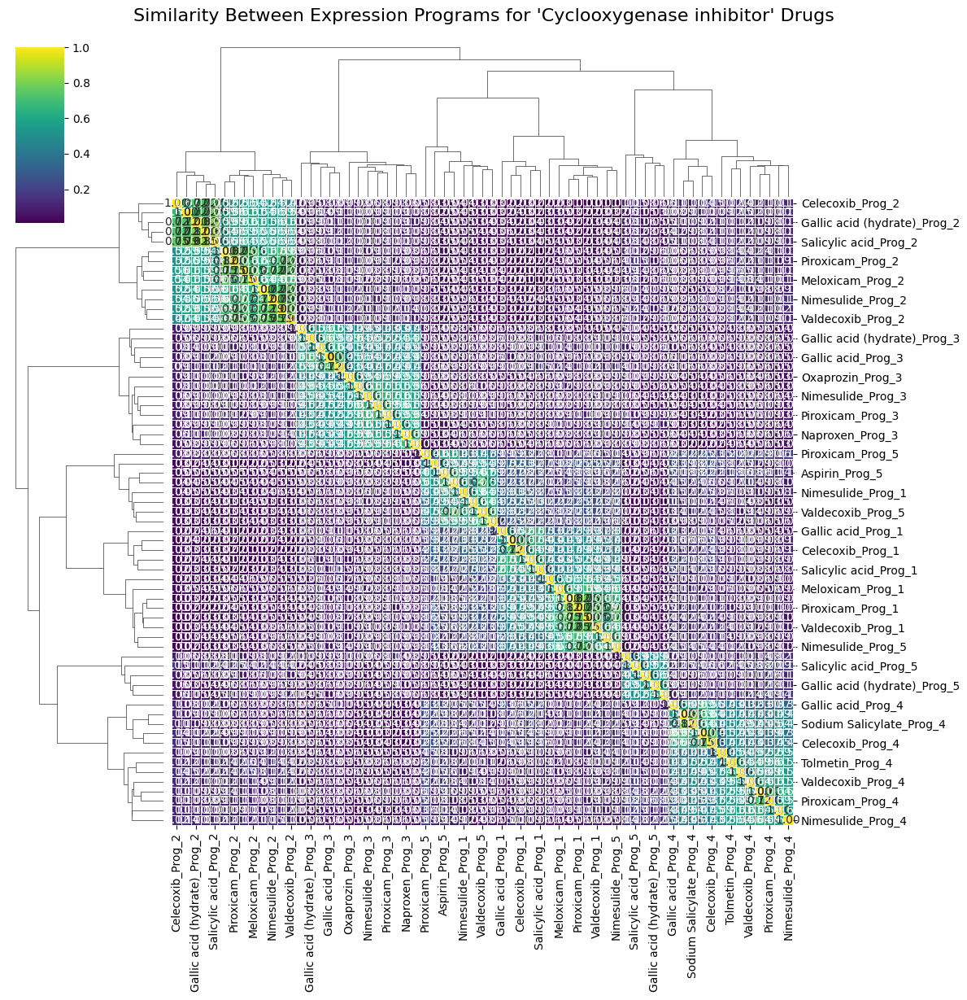


      STARTING ANALYSIS FOR MOA: Other MAPK inhibitor

--- Selecting drugs for MOA: 'Other MAPK inhibitor' ---
Found 11 drugs in this group: ['ERK5-IN-2', 'PF-06260933', 'BI-78D3', 'LJI308', 'Bentamapimod', 'Ralimetinib dimesylate', 'MK-8353', 'Temuterkib', 'PH-797804', 'OTS514', 'NG25']
--> Successfully loaded: ERK5-IN-2.h5ad
--> Successfully loaded: PF-06260933.h5ad
--> Successfully loaded: BI-78D3.h5ad
--> Successfully loaded: LJI308.h5ad
--> Successfully loaded: Bentamapimod.h5ad
--> Successfully loaded: Ralimetinib dimesylate.h5ad
--> Successfully loaded: MK-8353.h5ad
--> Successfully loaded: Temuterkib.h5ad
--> Successfully loaded: PH-797804.h5ad
--> Successfully loaded: OTS514.h5ad
--> Successfully loaded: NG25.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: ERK5-IN-2 ---

--- Processing: PF-06260933 ---

--- Processing: BI-78D3 ---

--- Processing: LJI308 ---

--- Processing: Bentamapimod ---

--- Processing: Ralimetinib dimesylate ---

--- Processing: MK-

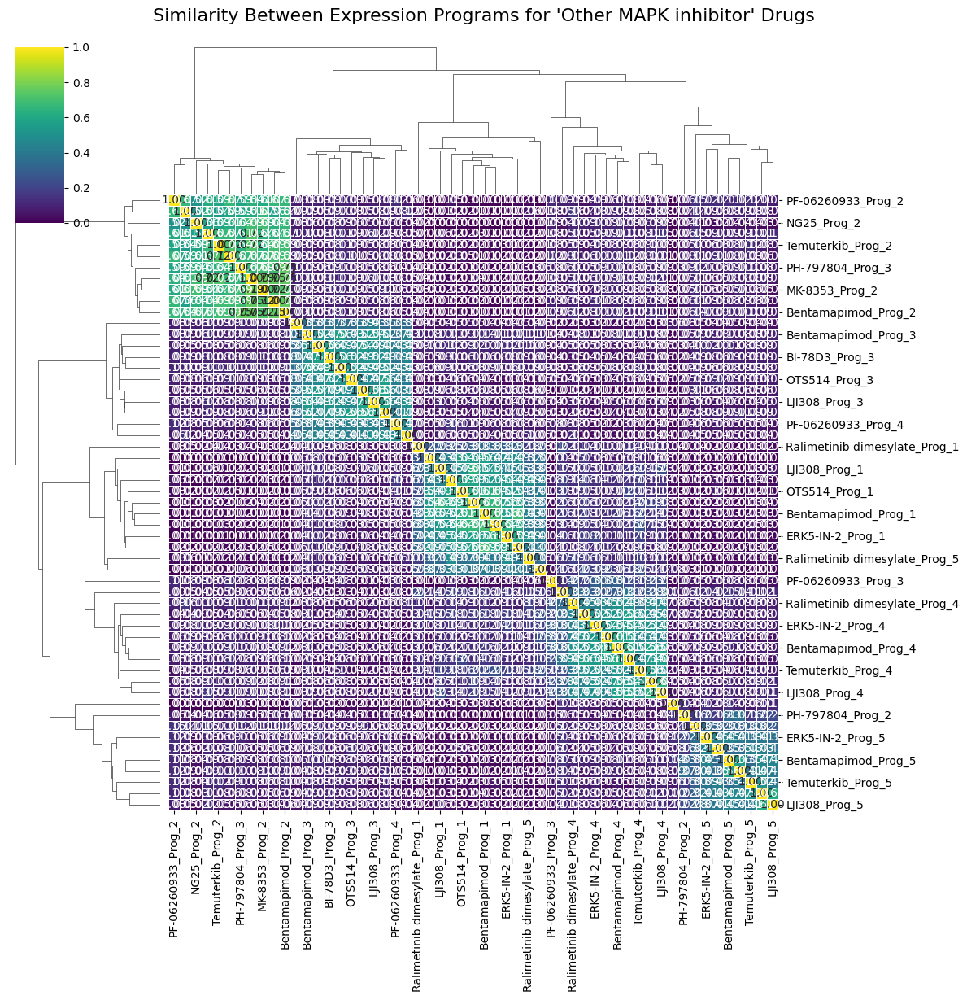


      STARTING ANALYSIS FOR MOA: JAK/STAT inhibitor

--- Selecting drugs for MOA: 'JAK/STAT inhibitor' ---
Found 6 drugs in this group: ['Balsalazide (sodium hydrate)', 'Filgotinib', 'Fedratinib (hydrochloride hydrate)', 'Artesunate', 'Tofacitinib', 'Tofacitinib (citrate)']
--> Successfully loaded: Balsalazide (sodium hydrate).h5ad
--> Successfully loaded: Filgotinib.h5ad
--> Successfully loaded: Fedratinib (hydrochloride hydrate).h5ad
--> Successfully loaded: Artesunate.h5ad
--> Successfully loaded: Tofacitinib.h5ad
--> Successfully loaded: Tofacitinib (citrate).h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Balsalazide (sodium hydrate) ---

--- Processing: Filgotinib ---

--- Processing: Fedratinib (hydrochloride hydrate) ---

--- Processing: Artesunate ---

--- Processing: Tofacitinib ---

--- Processing: Tofacitinib (citrate) ---

--- Comparing Programs and Generating Similarity Heatmap ---


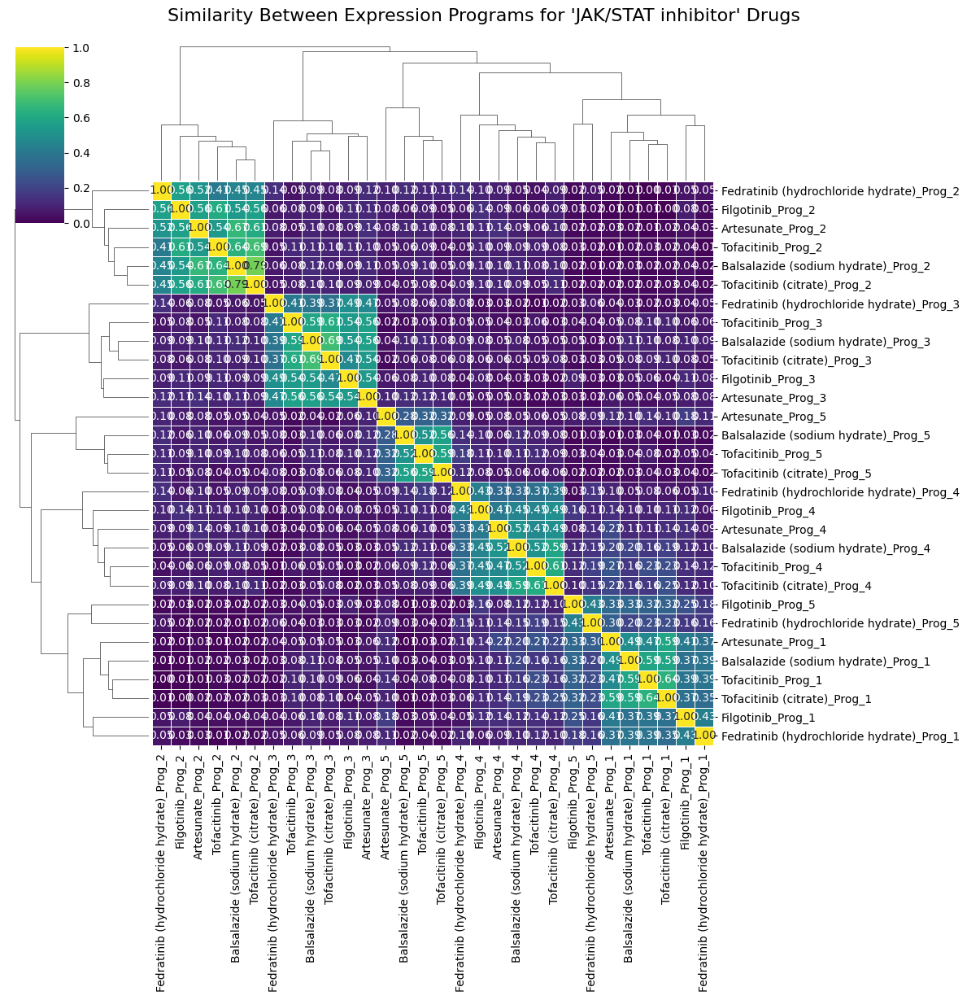


      STARTING ANALYSIS FOR MOA: HDAC inhibitor

--- Selecting drugs for MOA: 'HDAC inhibitor' ---
Found 4 drugs in this group: ['Tucidinostat', 'Belinostat', 'Carbamazepine', 'Panobinostat']
--> Successfully loaded: Tucidinostat.h5ad
--> Successfully loaded: Belinostat.h5ad
--> Successfully loaded: Carbamazepine.h5ad
--> Successfully loaded: Panobinostat.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Tucidinostat ---

--- Processing: Belinostat ---

--- Processing: Carbamazepine ---

--- Processing: Panobinostat ---

--- Comparing Programs and Generating Similarity Heatmap ---


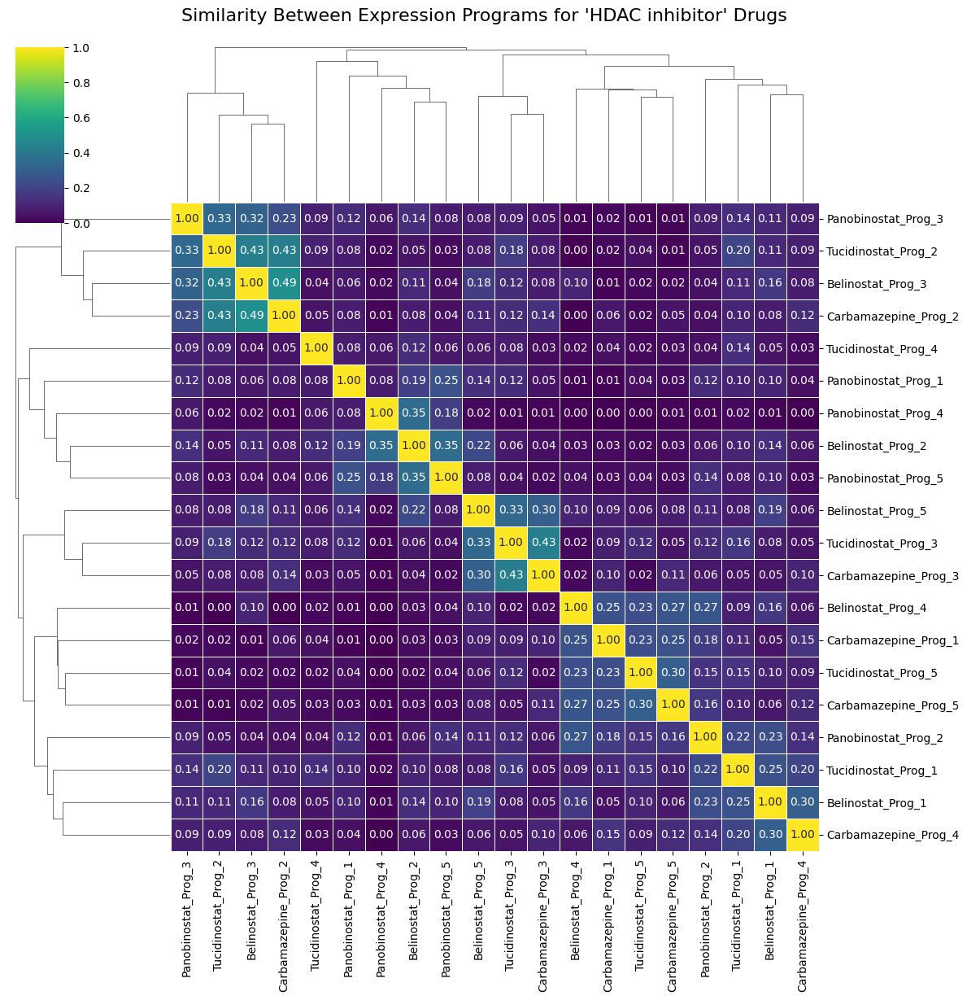


      STARTING ANALYSIS FOR MOA: Multi-TK inhibitor

--- Selecting drugs for MOA: 'Multi-TK inhibitor' ---
Found 10 drugs in this group: ['Pexidartinib (hydrochloride)', 'crizotinib', 'Crizotinib (hydrochloride)', 'Ponatinib', 'Sulfatinib', 'Sunitinib', 'c-Kit-IN-1', 'Vandetanib', 'Regorafenib', 'Cabozantinib (S-malate)']
--> Successfully loaded: Pexidartinib (hydrochloride).h5ad
--> Successfully loaded: crizotinib.h5ad
--> Successfully loaded: Crizotinib (hydrochloride).h5ad
--> Successfully loaded: Ponatinib.h5ad
--> Successfully loaded: Sulfatinib.h5ad
--> Successfully loaded: Sunitinib.h5ad
--> Successfully loaded: c-Kit-IN-1.h5ad
--> Successfully loaded: Vandetanib.h5ad
--> Successfully loaded: Regorafenib.h5ad
--> Successfully loaded: Cabozantinib (S-malate).h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Pexidartinib (hydrochloride) ---

--- Processing: crizotinib ---

--- Processing: Crizotinib (hydrochloride) ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Ponatinib ---

--- Processing: Sulfatinib ---

--- Processing: Sunitinib ---

--- Processing: c-Kit-IN-1 ---

--- Processing: Vandetanib ---

--- Processing: Regorafenib ---

--- Processing: Cabozantinib (S-malate) ---

--- Comparing Programs and Generating Similarity Heatmap ---


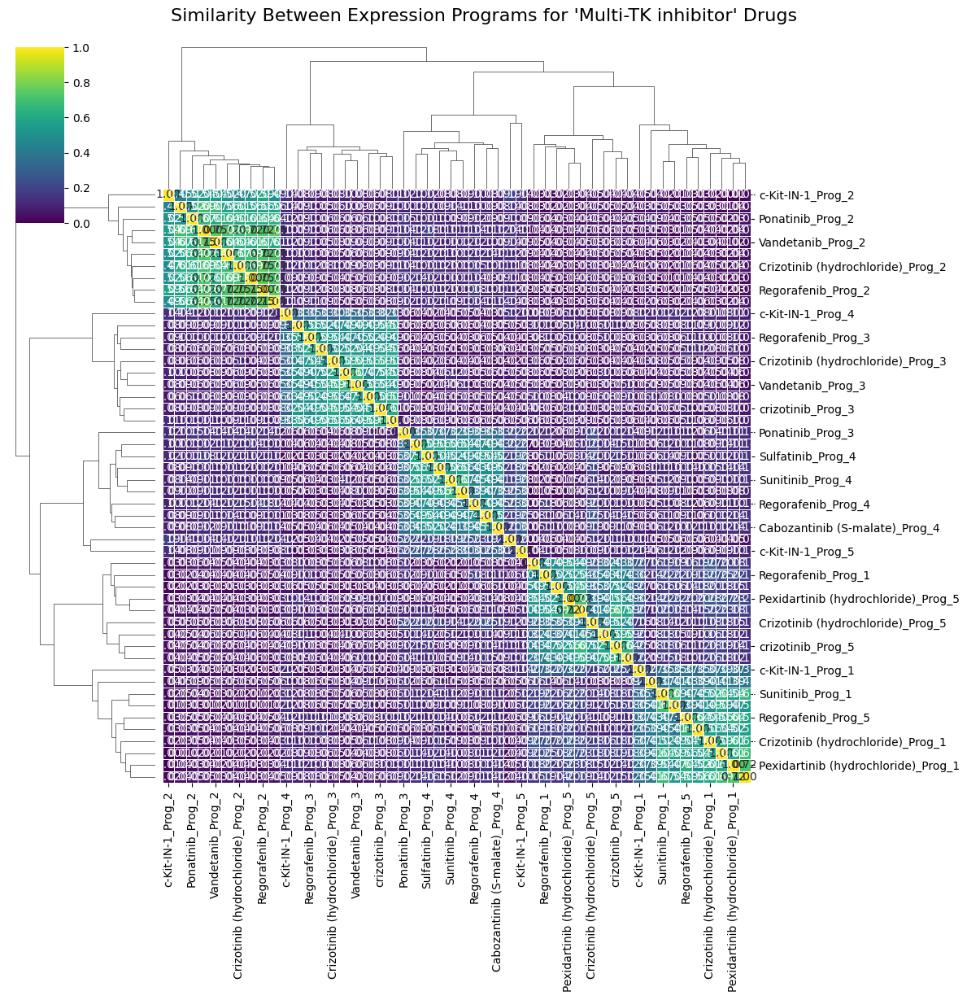


      STARTING ANALYSIS FOR MOA: Protein synthesis inhibitor

--- Selecting drugs for MOA: 'Protein synthesis inhibitor' ---
Found 6 drugs in this group: ['4EGI-1', 'SBI-0640756', 'ETC-206', 'Harringtonine', 'Homoharringtonine', 'Tomivosertib']
--> Successfully loaded: 4EGI-1.h5ad
--> Successfully loaded: SBI-0640756.h5ad
--> Successfully loaded: ETC-206.h5ad
--> Successfully loaded: Harringtonine.h5ad
--> Successfully loaded: Homoharringtonine.h5ad
--> Successfully loaded: Tomivosertib.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: 4EGI-1 ---

--- Processing: SBI-0640756 ---

--- Processing: ETC-206 ---

--- Processing: Harringtonine ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Homoharringtonine ---

--- Processing: Tomivosertib ---

--- Comparing Programs and Generating Similarity Heatmap ---


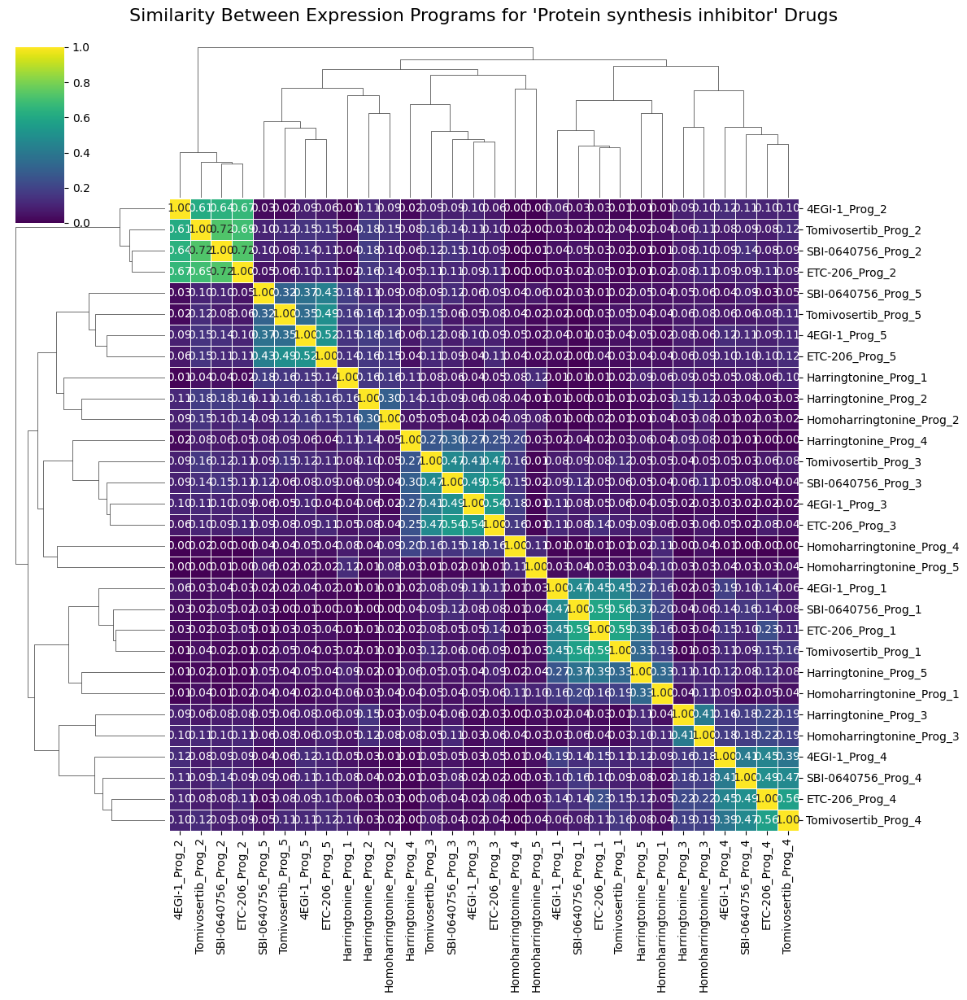


      STARTING ANALYSIS FOR MOA: PI3K/AKT inhibitor

--- Selecting drugs for MOA: 'PI3K/AKT inhibitor' ---
Found 6 drugs in this group: ['GSK1059615', 'BAY1125976', 'Capivasertib', 'Bimiralisib', 'Alpelisib', 'Ipatasertib']
--> Successfully loaded: GSK1059615.h5ad
--> Successfully loaded: BAY1125976.h5ad
--> Successfully loaded: Capivasertib.h5ad
--> Successfully loaded: Bimiralisib.h5ad
--> Successfully loaded: Alpelisib.h5ad
--> Successfully loaded: Ipatasertib.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: GSK1059615 ---

--- Processing: BAY1125976 ---

--- Processing: Capivasertib ---

--- Processing: Bimiralisib ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Alpelisib ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Ipatasertib ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Comparing Programs and Generating Similarity Heatmap ---


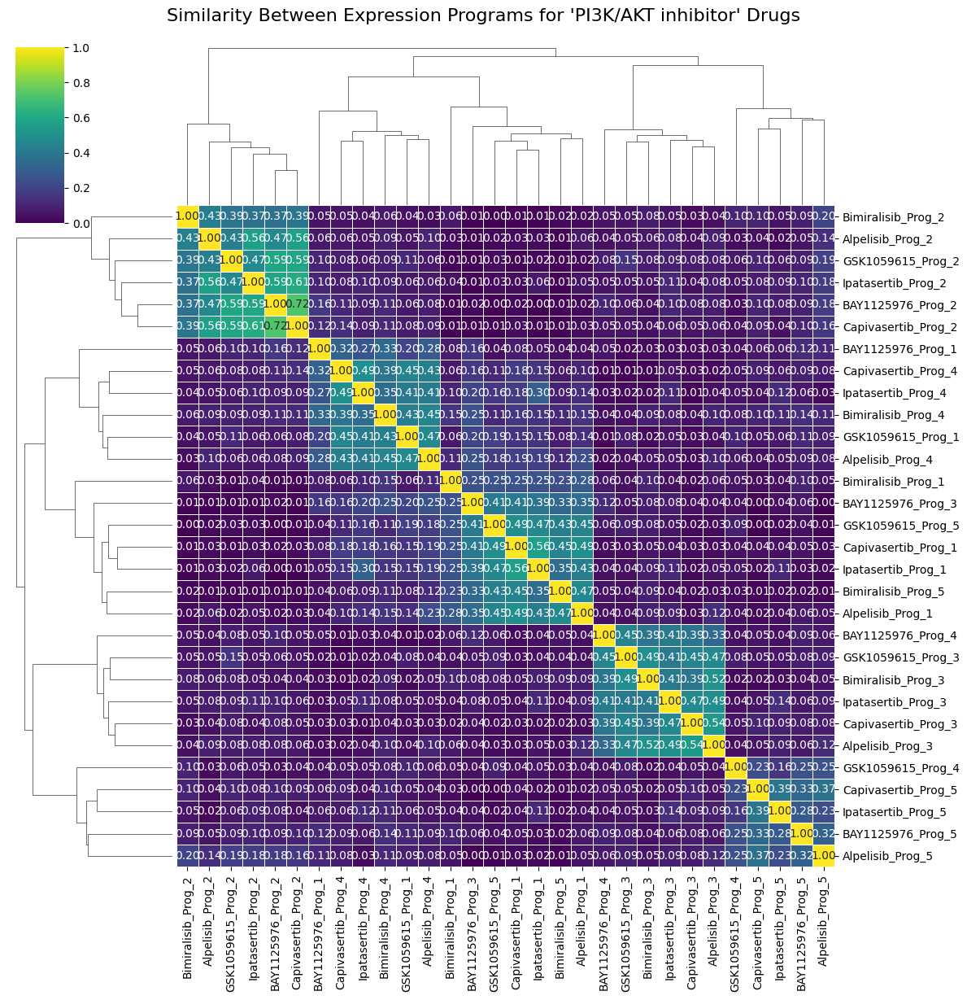


      STARTING ANALYSIS FOR MOA: DNA methyltransferase inhibitor

--- Selecting drugs for MOA: 'DNA methyltransferase inhibitor' ---
Found 4 drugs in this group: ['5-Azacytidine', 'Decitabine', 'Procainamide (hydrochloride)', 'γ-Oryzanol']
--> Successfully loaded: 5-Azacytidine.h5ad
--> Successfully loaded: Decitabine.h5ad
--> Successfully loaded: Procainamide (hydrochloride).h5ad
--> Successfully loaded: γ-Oryzanol.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: 5-Azacytidine ---

--- Processing: Decitabine ---

--- Processing: Procainamide (hydrochloride) ---

--- Processing: γ-Oryzanol ---

--- Comparing Programs and Generating Similarity Heatmap ---


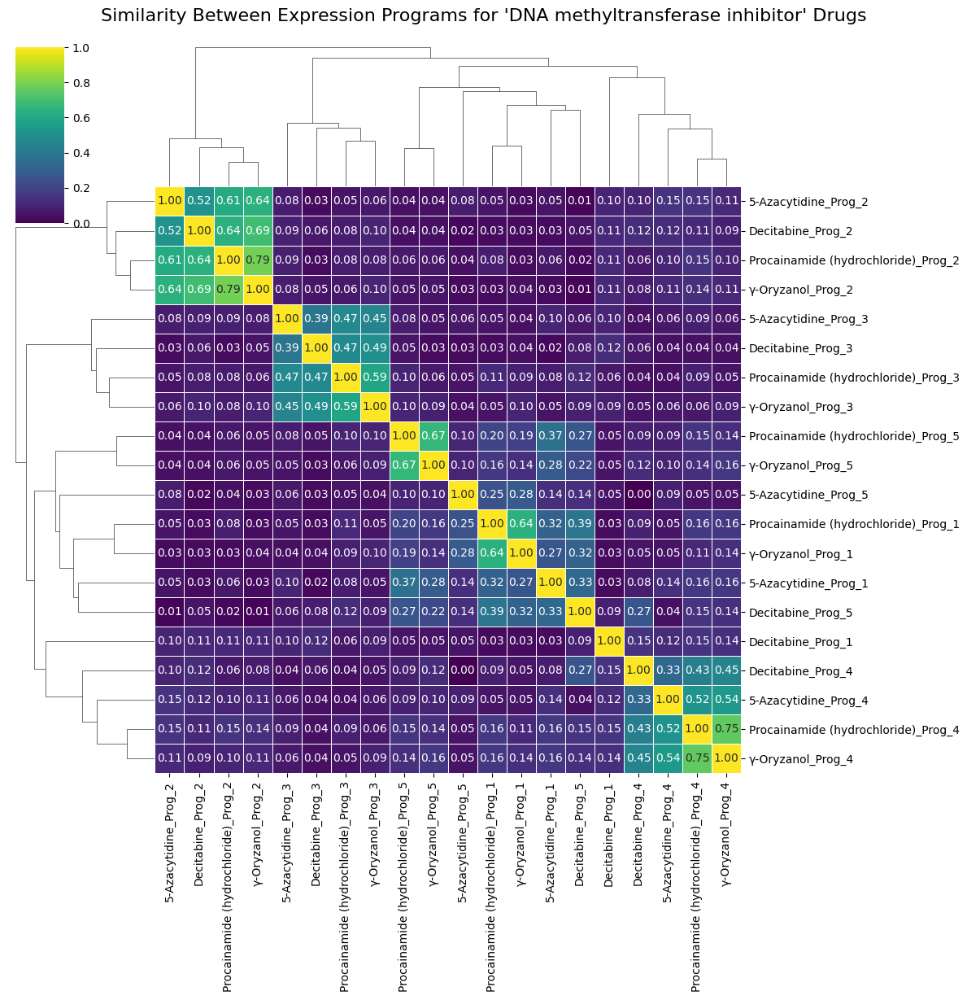


      STARTING ANALYSIS FOR MOA: Other TK inhibitor

--- Selecting drugs for MOA: 'Other TK inhibitor' ---
Found 15 drugs in this group: ['Larotrectinib', 'Larotrectinib sulfate', 'Asciminib', 'Erdafitinib', 'Tirabrutinib', 'Tirabrutinib (hydrochloride)', 'Fostamatinib (disodium hexahydrate)', 'Radotinib', 'Flumatinib (mesylate)', 'Pralsetinib', 'Pemigatinib', 'Infigratinib', 'Entrectinib', 'Ferulic acid', 'Futibatinib']
--> Successfully loaded: Larotrectinib.h5ad
--> Successfully loaded: Larotrectinib sulfate.h5ad
--> Successfully loaded: Asciminib.h5ad
--> Successfully loaded: Erdafitinib.h5ad
--> Successfully loaded: Tirabrutinib.h5ad
--> Successfully loaded: Tirabrutinib (hydrochloride).h5ad
--> Successfully loaded: Fostamatinib (disodium hexahydrate).h5ad
--> Successfully loaded: Radotinib.h5ad
--> Successfully loaded: Flumatinib (mesylate).h5ad
--> Successfully loaded: Pralsetinib.h5ad
--> Successfully loaded: Pemigatinib.h5ad
--> Successfully loaded: Infigratinib.h5ad
--> Succe

/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Ferulic acid ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Futibatinib ---

--- Comparing Programs and Generating Similarity Heatmap ---


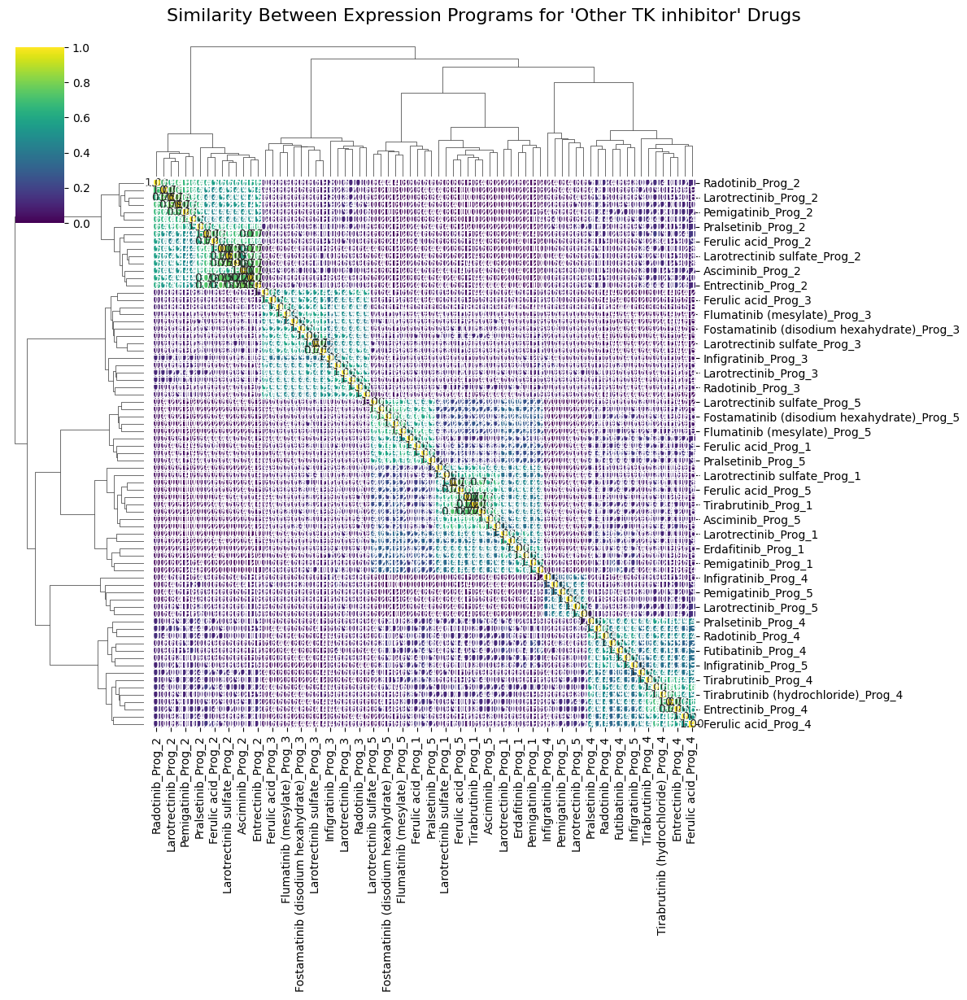


      STARTING ANALYSIS FOR MOA: GSK3 inhibitor

--- Selecting drugs for MOA: 'GSK3 inhibitor' ---
Found 4 drugs in this group: ['LY2090314', 'CP21R7', '9-ING-41', 'AZD2858']
--> Successfully loaded: LY2090314.h5ad
--> Successfully loaded: CP21R7.h5ad
--> Successfully loaded: 9-ING-41.h5ad
--> Successfully loaded: AZD2858.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: LY2090314 ---

--- Processing: CP21R7 ---

--- Processing: 9-ING-41 ---

--- Processing: AZD2858 ---

--- Comparing Programs and Generating Similarity Heatmap ---


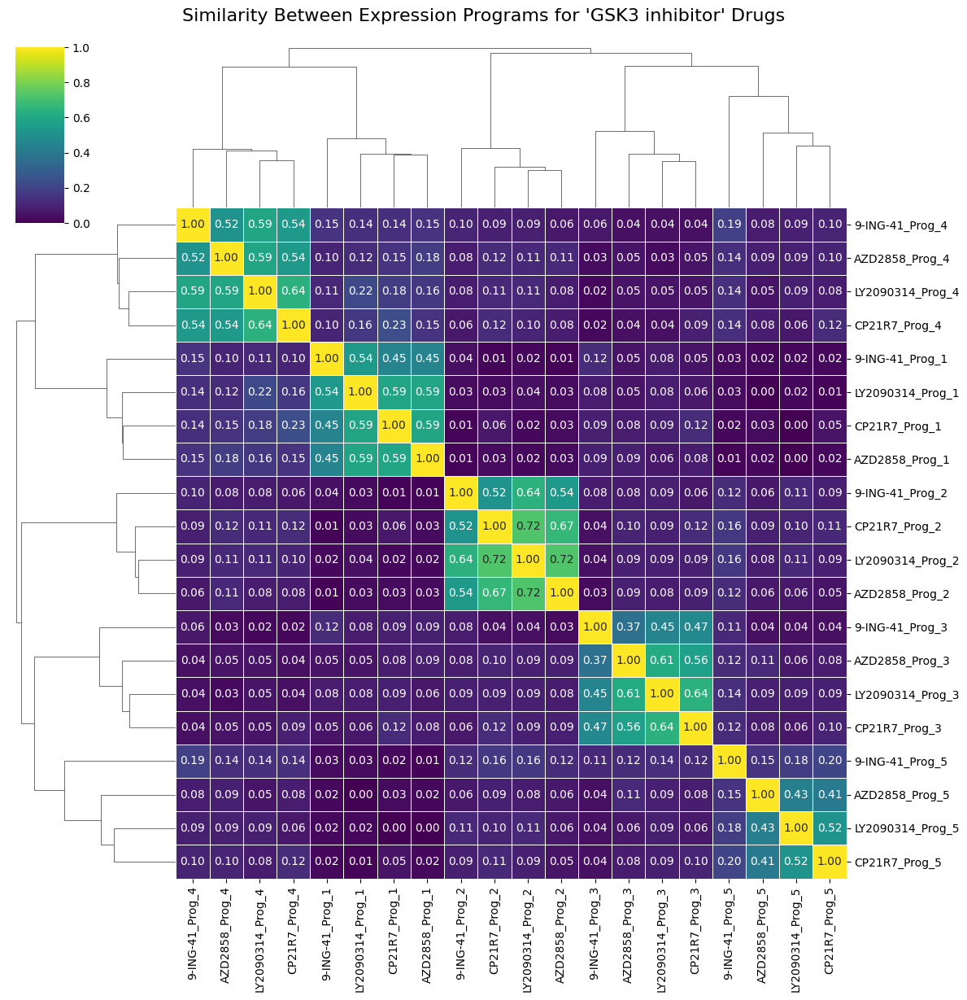


      STARTING ANALYSIS FOR MOA: MEK inhibitor

--- Selecting drugs for MOA: 'MEK inhibitor' ---
Found 5 drugs in this group: ['Cobimetinib', 'Trametinib', 'Binimetinib', 'TAK-733', 'Trametinib (DMSO_TF solvate)']
--> Successfully loaded: Cobimetinib.h5ad
--> Successfully loaded: Trametinib.h5ad
--> Successfully loaded: Binimetinib.h5ad
--> Successfully loaded: TAK-733.h5ad
--> Successfully loaded: Trametinib (DMSO_TF solvate).h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Cobimetinib ---

--- Processing: Trametinib ---

--- Processing: Binimetinib ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: TAK-733 ---

--- Processing: Trametinib (DMSO_TF solvate) ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Comparing Programs and Generating Similarity Heatmap ---


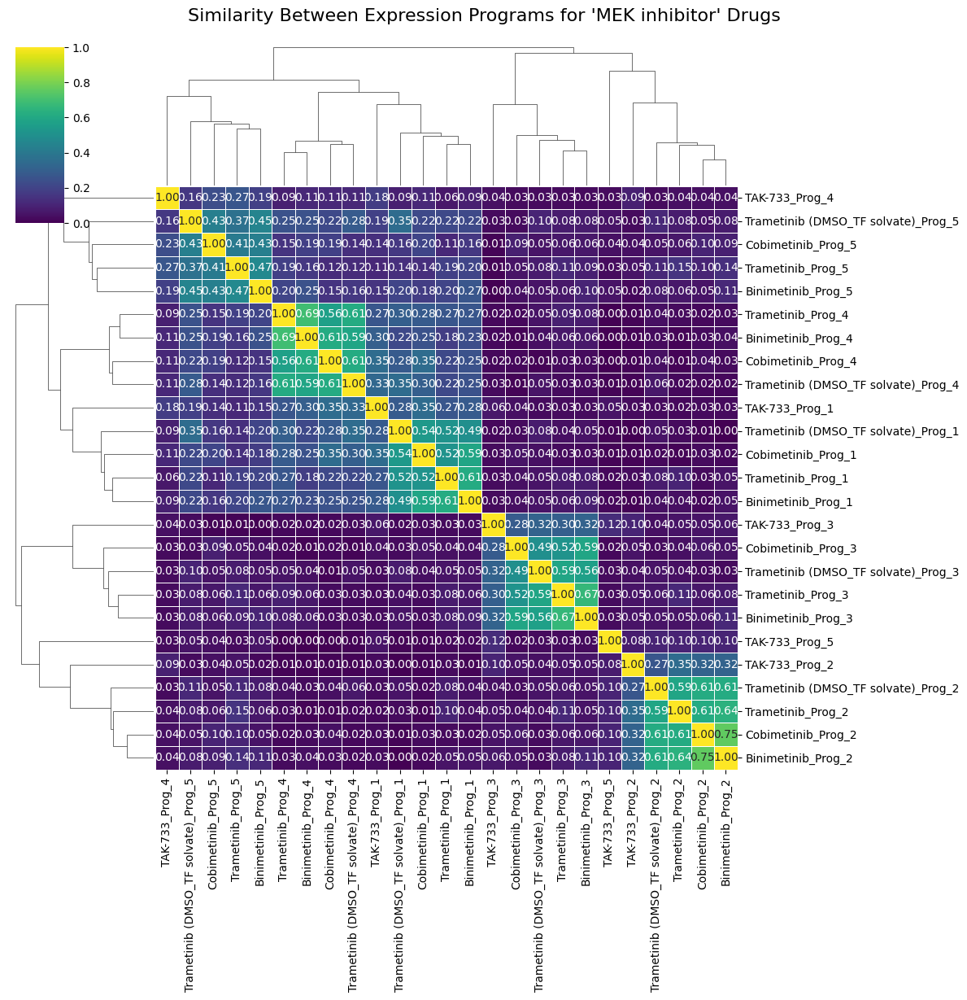


      STARTING ANALYSIS FOR MOA: RAS inhibitor

--- Selecting drugs for MOA: 'RAS inhibitor' ---
Found 4 drugs in this group: ['Lonafarnib', 'BI-3406', 'RMC-6236', 'Adagrasib']
--> Successfully loaded: Lonafarnib.h5ad
--> Successfully loaded: BI-3406.h5ad
--> Successfully loaded: RMC-6236.h5ad
--> Successfully loaded: Adagrasib.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Lonafarnib ---

--- Processing: BI-3406 ---

--- Processing: RMC-6236 ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Adagrasib ---

--- Comparing Programs and Generating Similarity Heatmap ---


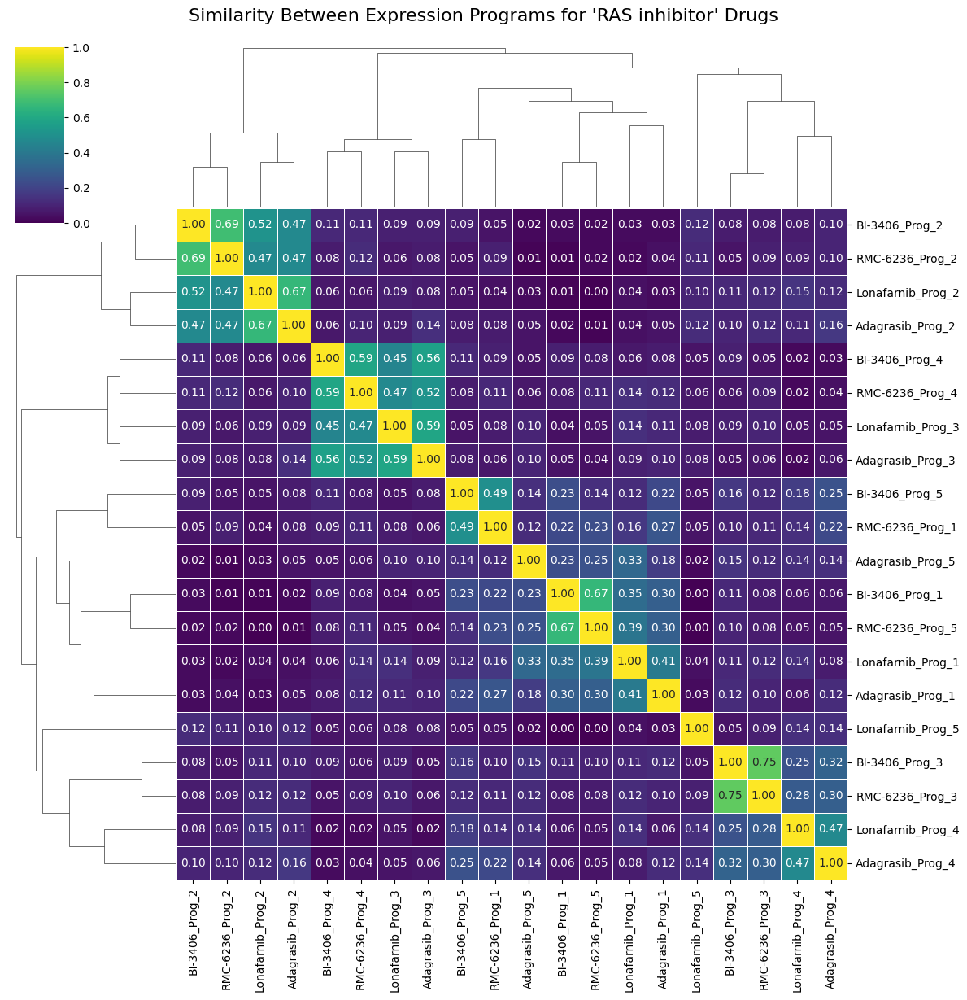


      STARTING ANALYSIS FOR MOA: CDK inhibitor

--- Selecting drugs for MOA: 'CDK inhibitor' ---
Found 5 drugs in this group: ['AT7519', 'palbociclib', 'Dinaciclib', 'Abemaciclib', 'Ribociclib']
--> Successfully loaded: AT7519.h5ad
--> Successfully loaded: palbociclib.h5ad
--> Successfully loaded: Dinaciclib.h5ad
--> Successfully loaded: Abemaciclib.h5ad
--> Successfully loaded: Ribociclib.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: AT7519 ---

--- Processing: palbociclib ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Dinaciclib ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Abemaciclib ---

--- Processing: Ribociclib ---

--- Comparing Programs and Generating Similarity Heatmap ---


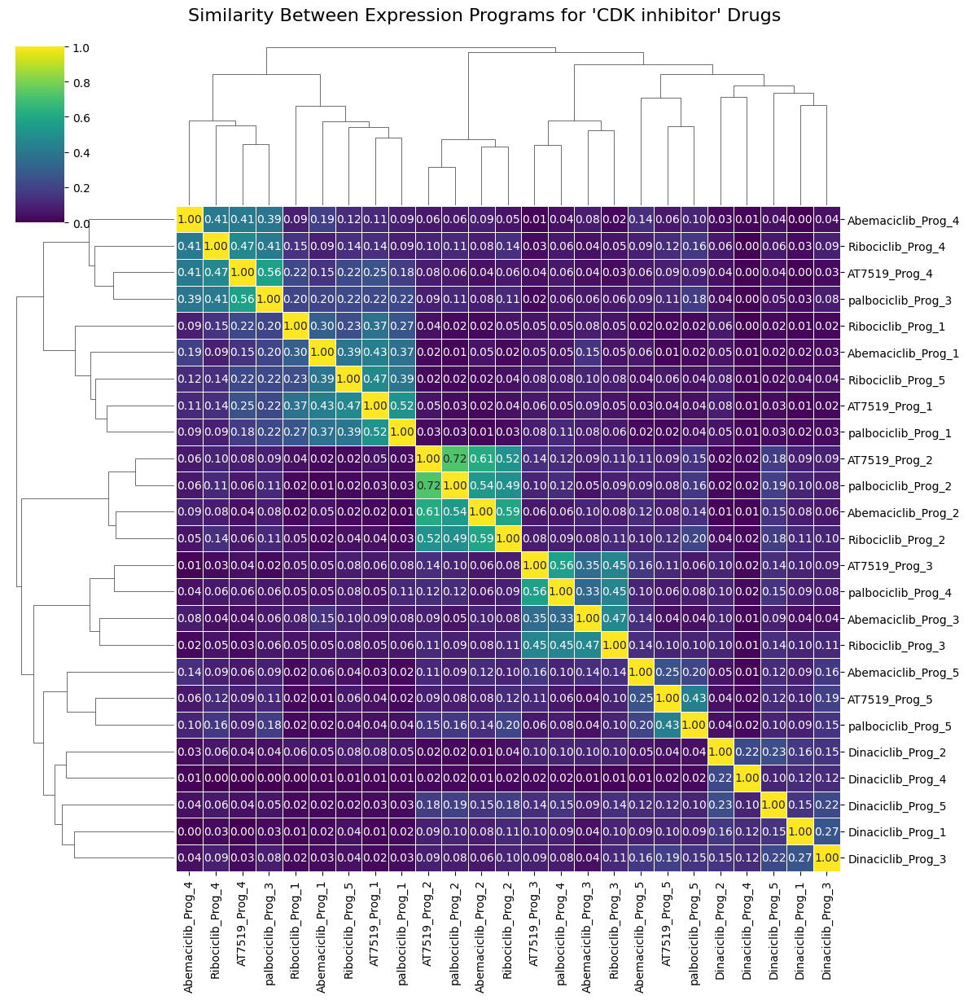


      STARTING ANALYSIS FOR MOA: Retinoic receptor agonist

--- Selecting drugs for MOA: 'Retinoic receptor agonist' ---
Found 4 drugs in this group: ['Peretinoin', 'Retinoic acid', 'Bexarotene', 'Tazarotene']
--> Successfully loaded: Peretinoin.h5ad
--> Successfully loaded: Retinoic acid.h5ad
--> Successfully loaded: Bexarotene.h5ad
--> Successfully loaded: Tazarotene.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Peretinoin ---

--- Processing: Retinoic acid ---

--- Processing: Bexarotene ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Tazarotene ---

--- Comparing Programs and Generating Similarity Heatmap ---


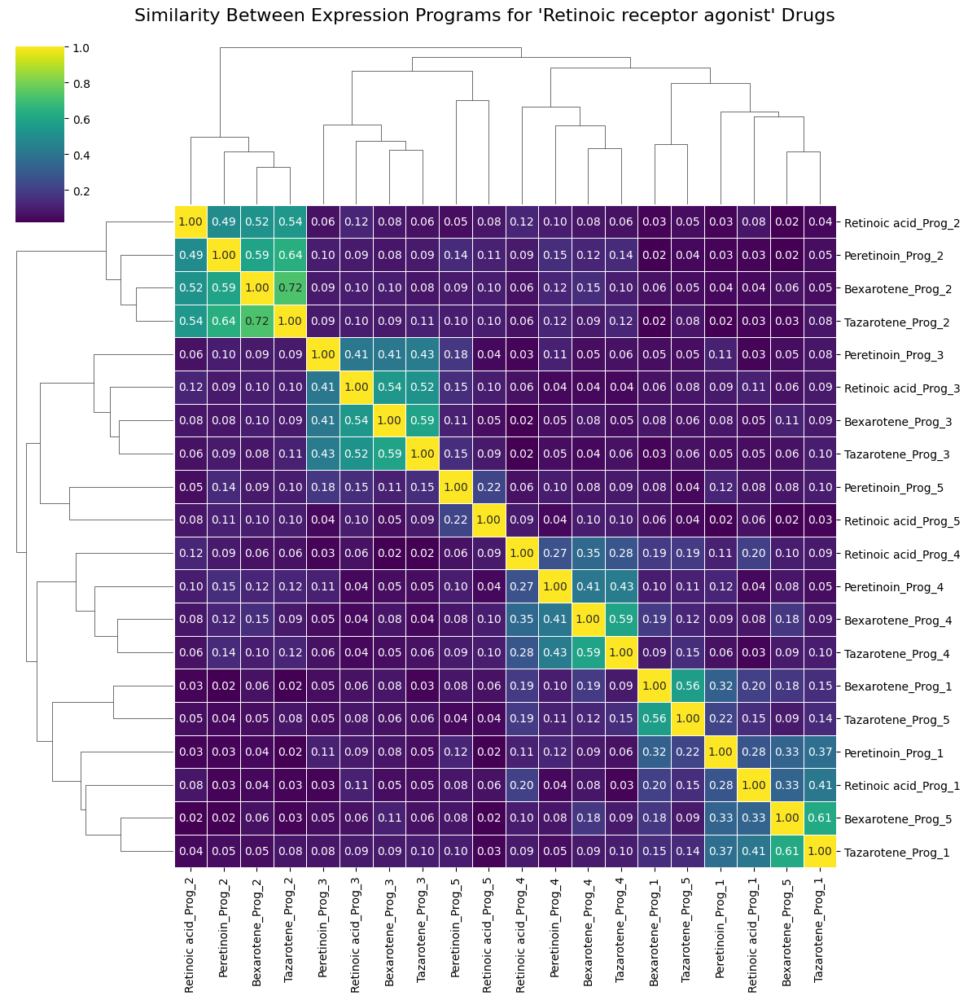


      STARTING ANALYSIS FOR MOA: RAF inhibitor

--- Selecting drugs for MOA: 'RAF inhibitor' ---
Found 3 drugs in this group: ['Dabrafenib', 'Encorafenib', 'Vemurafenib']
--> Successfully loaded: Dabrafenib.h5ad
--> Successfully loaded: Encorafenib.h5ad
--> Successfully loaded: Vemurafenib.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Dabrafenib ---

--- Processing: Encorafenib ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Vemurafenib ---

--- Comparing Programs and Generating Similarity Heatmap ---


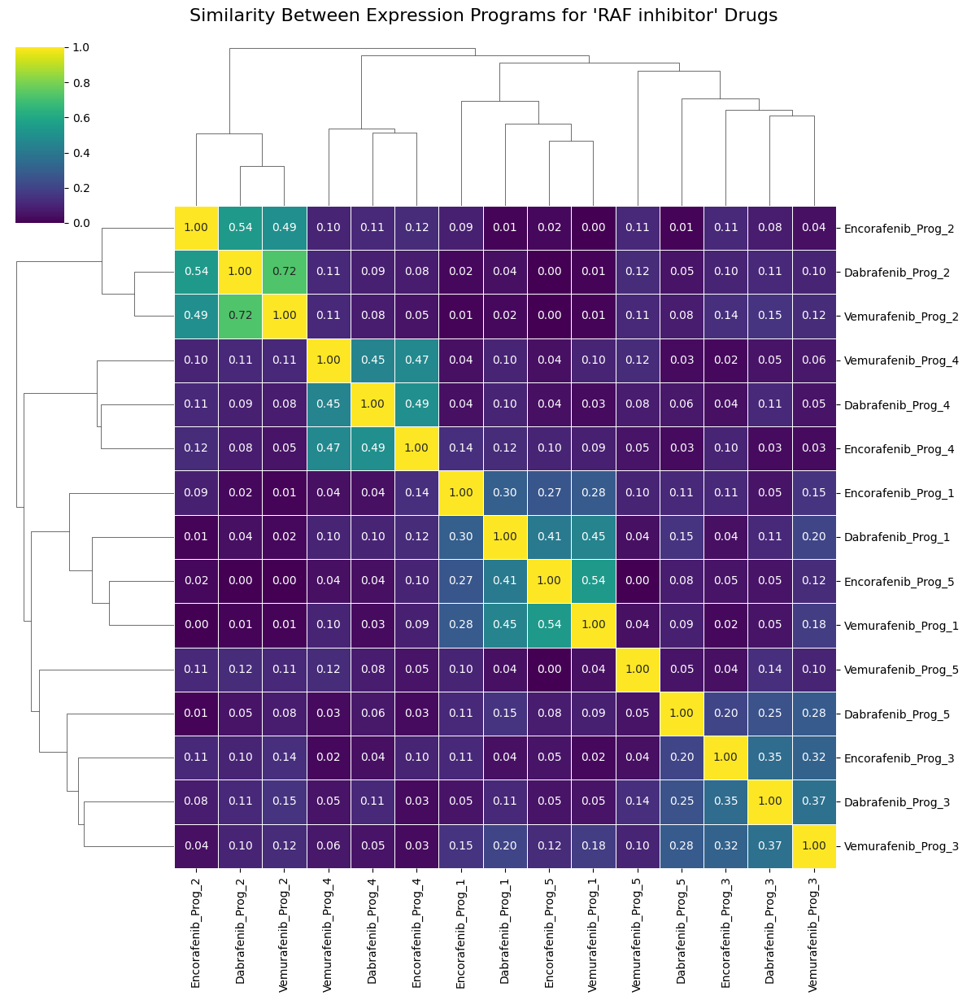


      STARTING ANALYSIS FOR MOA: Androgen receptor antagonist

--- Selecting drugs for MOA: 'Androgen receptor antagonist' ---
Found 4 drugs in this group: ['Flutamide', 'Darolutamide', 'Bicalutamide', 'Apalutamide']
--> Successfully loaded: Flutamide.h5ad
--> Successfully loaded: Darolutamide.h5ad
--> Successfully loaded: Bicalutamide.h5ad
--> Successfully loaded: Apalutamide.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Flutamide ---

--- Processing: Darolutamide ---

--- Processing: Bicalutamide ---

--- Processing: Apalutamide ---

--- Comparing Programs and Generating Similarity Heatmap ---


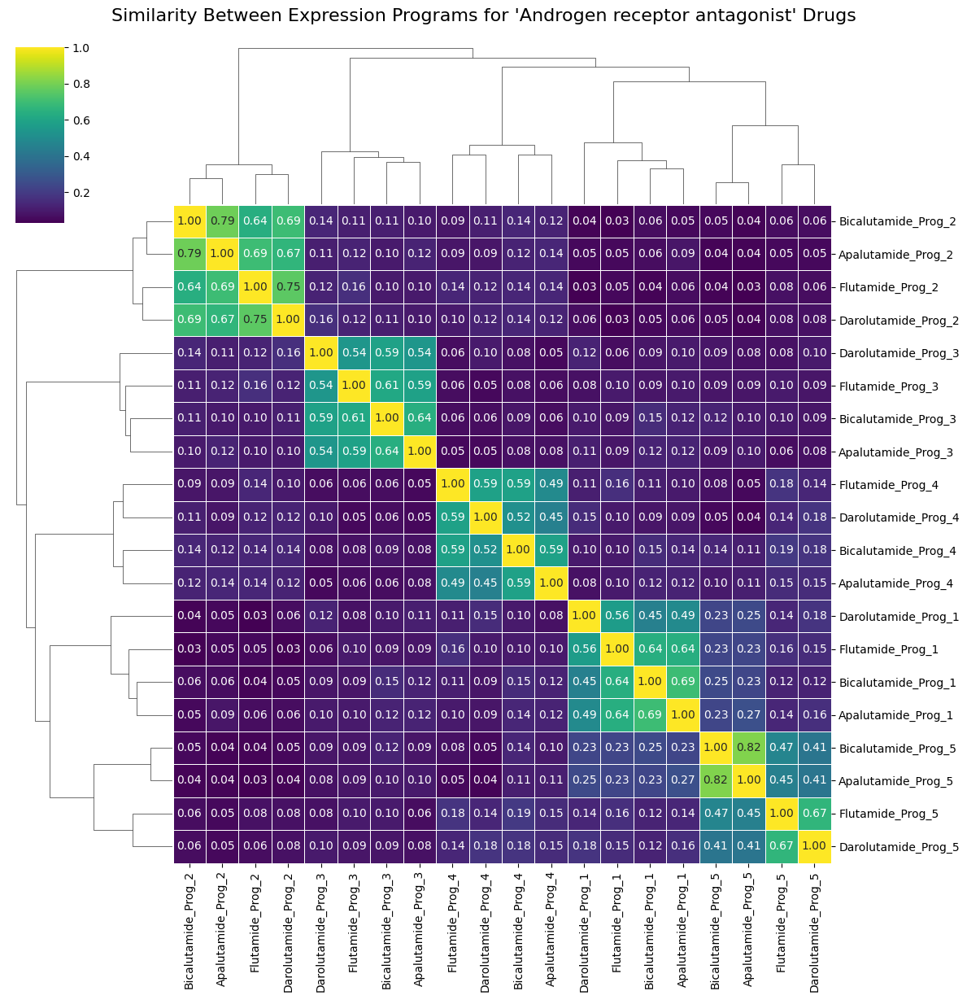


      STARTING ANALYSIS FOR MOA: MTOR inhibitor

--- Selecting drugs for MOA: 'MTOR inhibitor' ---
Found 7 drugs in this group: ['Sapanisertib', 'Torkinib', 'LY-2584702 (tosylate salt)', 'Rapamycin', 'Temsirolimus', 'Everolimus', 'AZD-8055']
--> Successfully loaded: Sapanisertib.h5ad
--> Successfully loaded: Torkinib.h5ad
--> Successfully loaded: LY-2584702 (tosylate salt).h5ad
--> Successfully loaded: Rapamycin.h5ad
--> Successfully loaded: Temsirolimus.h5ad
--> Successfully loaded: Everolimus.h5ad
--> Successfully loaded: AZD-8055.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Sapanisertib ---

--- Processing: Torkinib ---

--- Processing: LY-2584702 (tosylate salt) ---

--- Processing: Rapamycin ---

--- Processing: Temsirolimus ---

--- Processing: Everolimus ---

--- Processing: AZD-8055 ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Comparing Programs and Generating Similarity Heatmap ---


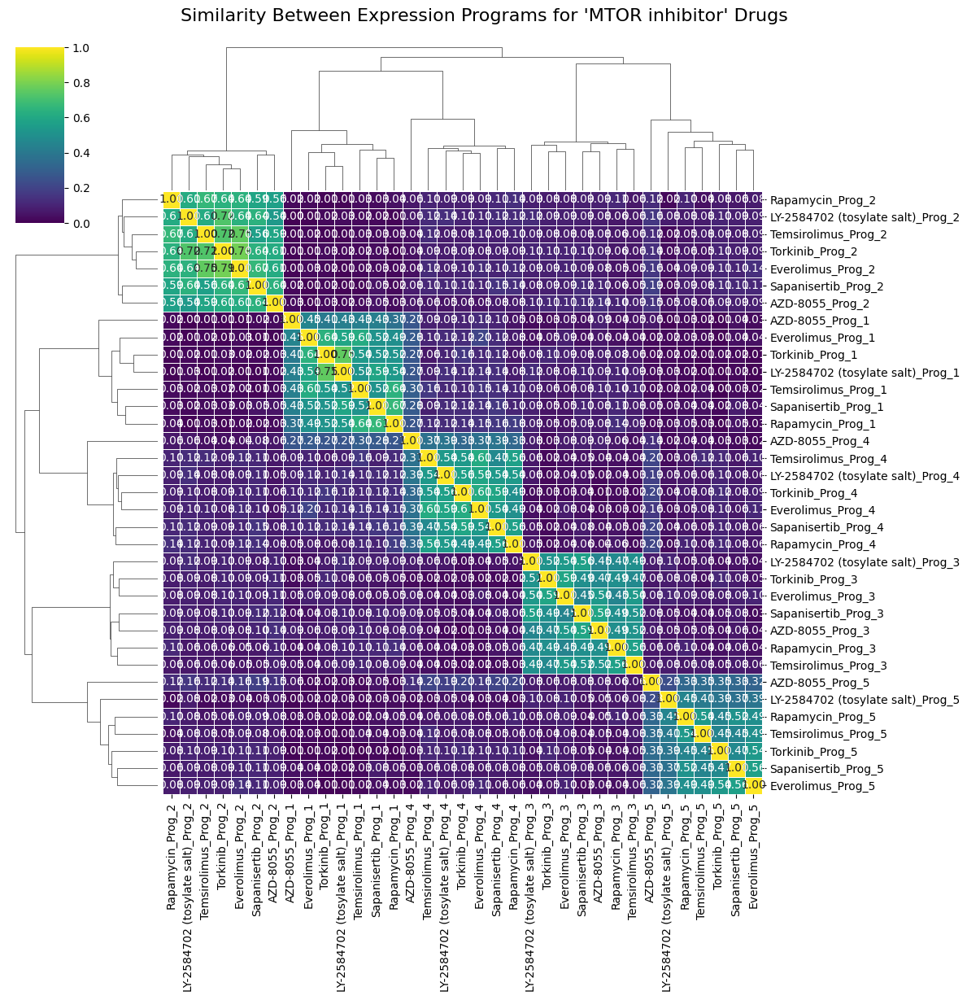


      STARTING ANALYSIS FOR MOA: Glucose transporter inhibitor

--- Selecting drugs for MOA: 'Glucose transporter inhibitor' ---
Found 4 drugs in this group: ['Canagliflozin', 'Dapagliflozin', 'Dapagliflozin ((2S)-1,2-propanediol, hydrate)', 'Canagliflozin (hemihydrate)']
--> Successfully loaded: Canagliflozin.h5ad
--> Successfully loaded: Dapagliflozin.h5ad
--> Successfully loaded: Dapagliflozin ((2S)-1,2-propanediol, hydrate).h5ad
--> Successfully loaded: Canagliflozin (hemihydrate).h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Canagliflozin ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Dapagliflozin ---

--- Processing: Dapagliflozin ((2S)-1,2-propanediol, hydrate) ---

--- Processing: Canagliflozin (hemihydrate) ---

--- Comparing Programs and Generating Similarity Heatmap ---


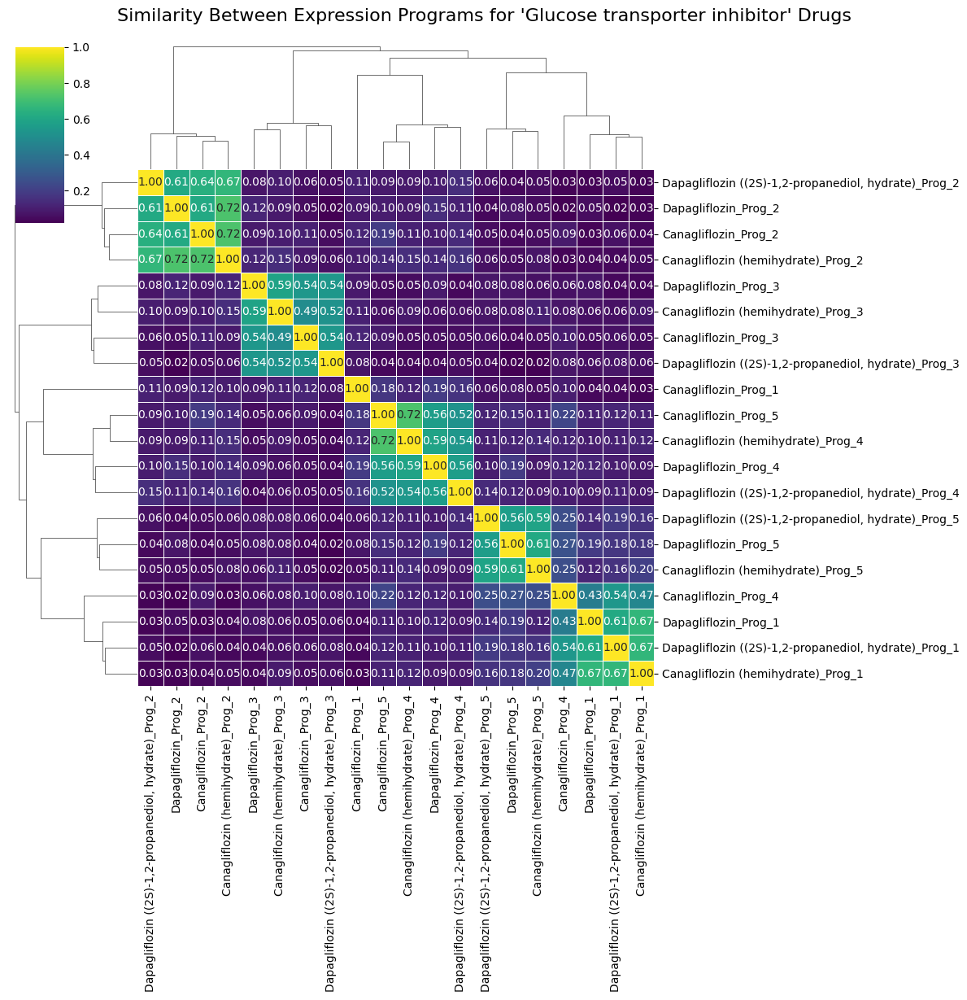


      STARTING ANALYSIS FOR MOA: EGFR/ERBB inhibitor

--- Selecting drugs for MOA: 'EGFR/ERBB inhibitor' ---
Found 12 drugs in this group: ['Tucatinib', 'Lapatinib ditosylate', 'Neratinib', 'Neratinib (maleate)', 'Afatinib', 'Almonertinib (hydrochloride)', 'Almonertinib (mesylate)', 'Capmatinib', 'Gefitinib', 'Simotinib', 'Erlotinib', 'Osimertinib (mesylate)']
--> Successfully loaded: Tucatinib.h5ad
--> Successfully loaded: Lapatinib ditosylate.h5ad
--> Successfully loaded: Neratinib.h5ad
--> Successfully loaded: Neratinib (maleate).h5ad
--> Successfully loaded: Afatinib.h5ad
--> Successfully loaded: Almonertinib (hydrochloride).h5ad
--> Successfully loaded: Almonertinib (mesylate).h5ad
--> Successfully loaded: Capmatinib.h5ad
--> Successfully loaded: Gefitinib.h5ad
--> Successfully loaded: Simotinib.h5ad
--> Successfully loaded: Erlotinib.h5ad
--> Successfully loaded: Osimertinib (mesylate).h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Tucatinib ---

--- Proces

/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Gefitinib ---

--- Processing: Simotinib ---

--- Processing: Erlotinib ---

--- Processing: Osimertinib (mesylate) ---

--- Comparing Programs and Generating Similarity Heatmap ---


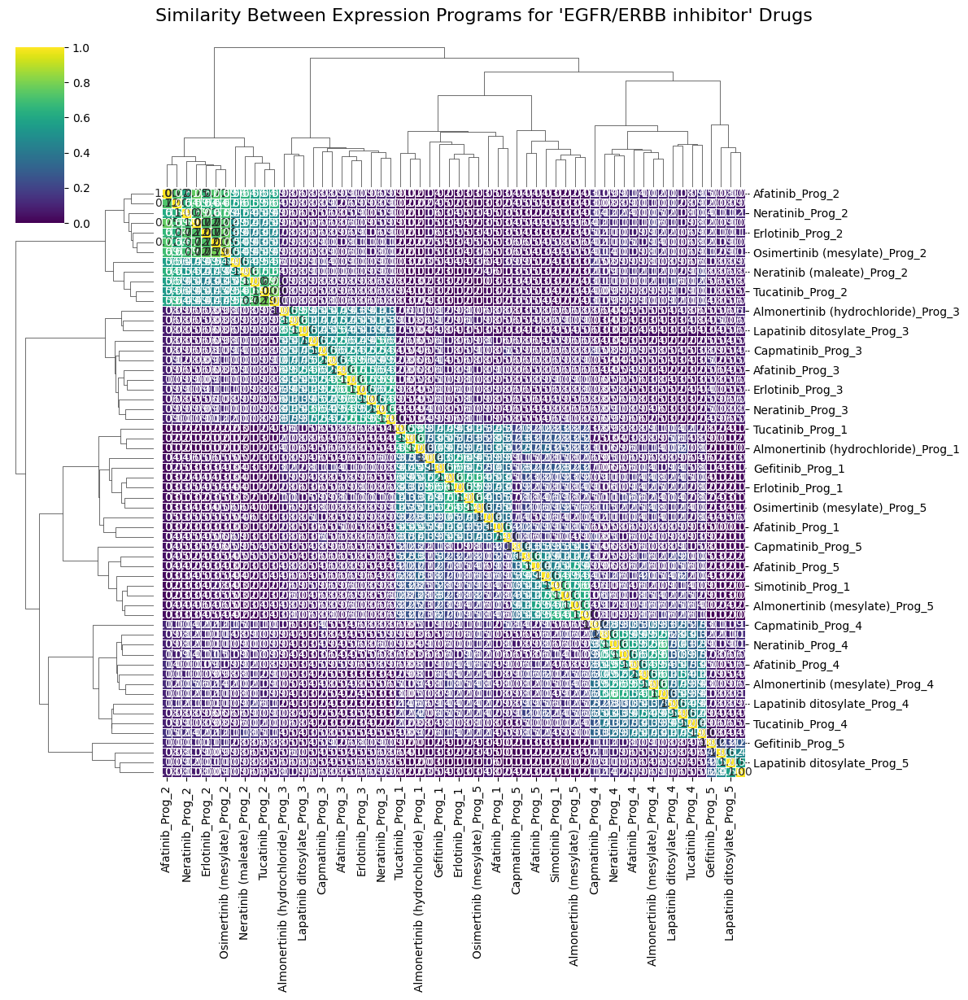


      STARTING ANALYSIS FOR MOA: Microtubule inhibitor

--- Selecting drugs for MOA: 'Microtubule inhibitor' ---
Found 7 drugs in this group: ['Paclitaxel', 'Docetaxel', 'Docetaxel (Trihydrate)', 'Vinblastine (sulfate)', 'vincristine', 'Mebendazole', 'Tubulin inhibitor 6']
--> Successfully loaded: Paclitaxel.h5ad
--> Successfully loaded: Docetaxel.h5ad
--> Successfully loaded: Docetaxel (Trihydrate).h5ad
--> Successfully loaded: Vinblastine (sulfate).h5ad
--> Successfully loaded: vincristine.h5ad
--> Successfully loaded: Mebendazole.h5ad
--> Successfully loaded: Tubulin inhibitor 6.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Paclitaxel ---


/usr/local/lib/python3.11/dist-packages/sklearn/decomposition/_nmf.py:1742: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn(



--- Processing: Docetaxel ---

--- Processing: Docetaxel (Trihydrate) ---

--- Processing: Vinblastine (sulfate) ---

--- Processing: vincristine ---

--- Processing: Mebendazole ---

--- Processing: Tubulin inhibitor 6 ---

--- Comparing Programs and Generating Similarity Heatmap ---


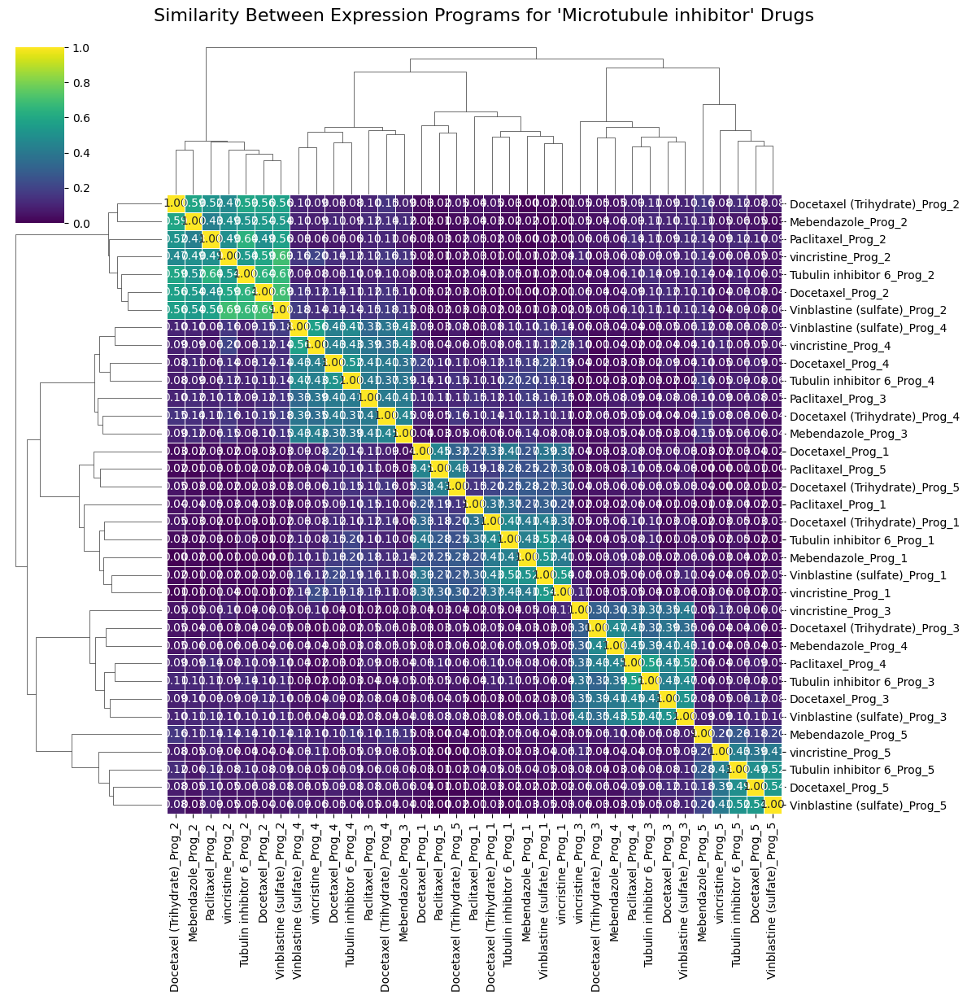


      STARTING ANALYSIS FOR MOA: Glucocorticoid receptor agonist

--- Selecting drugs for MOA: 'Glucocorticoid receptor agonist' ---
Found 5 drugs in this group: ['Triamcinolone', 'Methylprednisolone succinate', 'Dexamethasone', 'Betamethasone dipropionate', 'Budesonide']
--> Successfully loaded: Triamcinolone.h5ad
--> Successfully loaded: Methylprednisolone succinate.h5ad
--> Successfully loaded: Dexamethasone.h5ad
--> Successfully loaded: Betamethasone dipropionate.h5ad
--> Successfully loaded: Budesonide.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Triamcinolone ---

--- Processing: Methylprednisolone succinate ---

--- Processing: Dexamethasone ---

--- Processing: Betamethasone dipropionate ---

--- Processing: Budesonide ---

--- Comparing Programs and Generating Similarity Heatmap ---


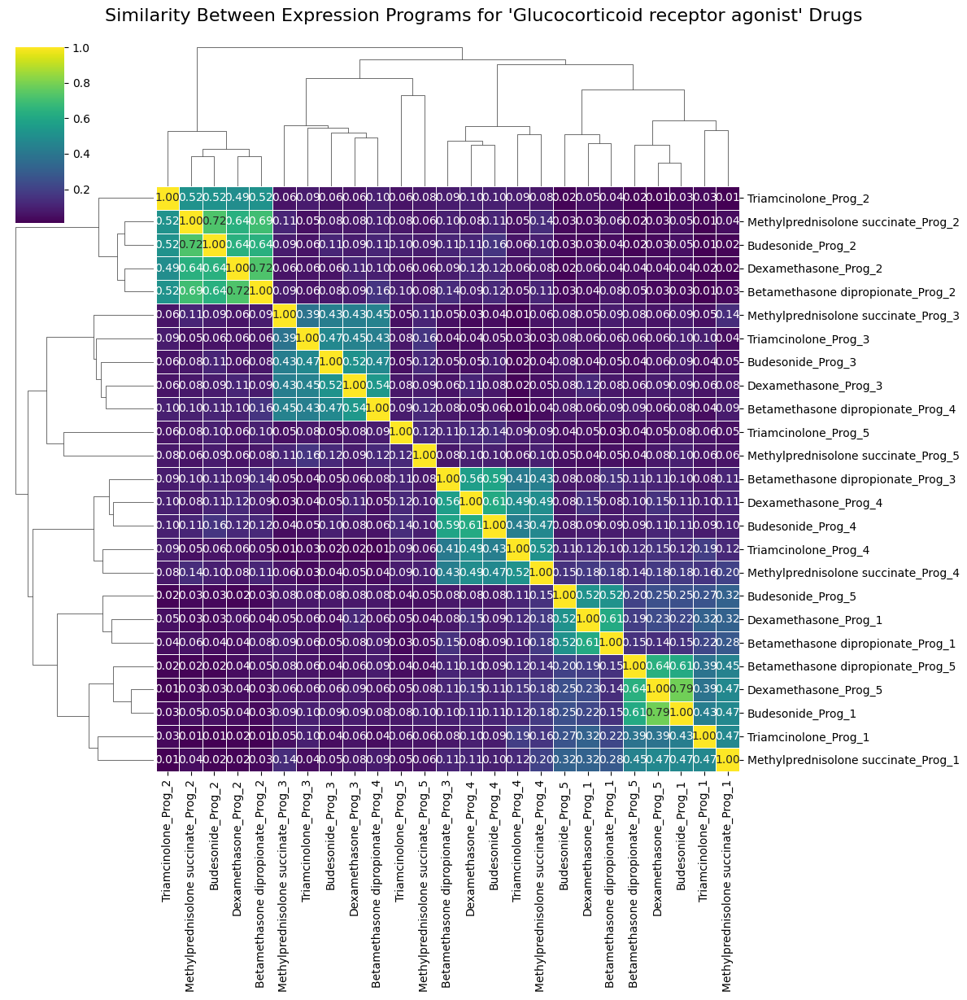


      STARTING ANALYSIS FOR MOA: Sonic inhibitor

--- Selecting drugs for MOA: 'Sonic inhibitor' ---
Found 3 drugs in this group: ['Sonidegib', 'Glasdegib', 'Vismodegib']
--> Successfully loaded: Sonidegib.h5ad
--> Successfully loaded: Glasdegib.h5ad
--> Successfully loaded: Vismodegib.h5ad

--- Finding Expression Programs using NMF ---

--- Processing: Sonidegib ---

--- Processing: Glasdegib ---

--- Processing: Vismodegib ---

--- Comparing Programs and Generating Similarity Heatmap ---


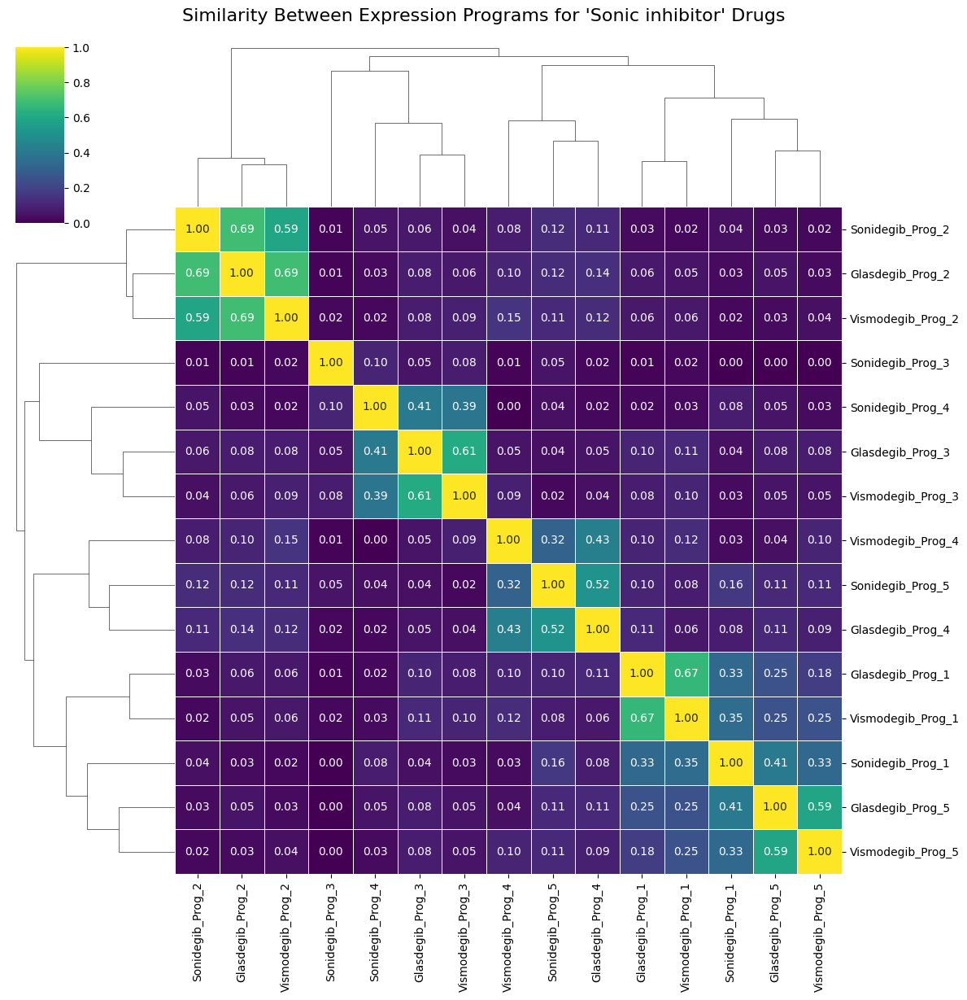



✅ All analyses complete.


In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

# Install the required library for Gene Set Enrichment Analysis
!pip install -q gseapy

# Import the necessary libraries for NMF
from sklearn.decomposition import NMF
import gseapy as gp

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
drug_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/drug_metadata.parquet"

# ==============================================================================
# Part 2: Define the Analysis Function
# This function contains the entire workflow for a single MOA group.
# ==============================================================================

def analyze_moa_programs(target_moa, drug_df):
    """
    Performs NMF analysis on all drugs within a specified MOA group
    and generates a similarity heatmap of their expression programs.
    """
    print("\n" + "="*80)
    print(f"      STARTING ANALYSIS FOR MOA: {target_moa}")
    print("="*80)

    # --- Step A: Select an MOA Group and Load Corresponding Data ---
    print(f"\n--- Selecting drugs for MOA: '{target_moa}' ---")

    drugs_in_moa = drug_df[drug_df['moa-fine'] == target_moa]['drug'].dropna().unique().tolist()

    if len(drugs_in_moa) < 2:
        print(f"--> Skipping '{target_moa}': requires at least 2 drugs for comparison, but found {len(drugs_in_moa)}.")
        return

    print(f"Found {len(drugs_in_moa)} drugs in this group: {drugs_in_moa}")

    # --- Load the .h5ad files for the selected drugs ---
    adata_dict = {}
    for drug_name in drugs_in_moa:
        file_name = f"{drug_name}.h5ad"
        file_path = os.path.join(source_data_folder, file_name)
        if os.path.exists(file_path):
            try:
                adata_single = sc.read_h5ad(file_path)
                adata_dict[drug_name] = adata_single
                print(f"--> Successfully loaded: {file_name}")
            except Exception as e:
                print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")
        else:
            print(f"--> WARNING: File not found for drug '{drug_name}'. Skipping.")

    if len(adata_dict) < 2:
        print(f"--> Skipping '{target_moa}': could not load enough valid data files for comparison.")
        return

    # --- Step B: Run NMF to Find Expression Programs ---
    print("\n--- Finding Expression Programs using NMF ---")
    expression_programs = {}
    n_programs = 5
    n_top_genes = 50

    for drug_name, adata in adata_dict.items():
        print(f"\n--- Processing: {drug_name} ---")
        sc.pp.normalize_total(adata, target_sum=1e4)
        sc.pp.log1p(adata)
        sc.pp.highly_variable_genes(adata, n_top_genes=2000)
        adata_hvg = adata[:, adata.var.highly_variable].copy()

        model = NMF(n_components=n_programs, init='nndsvda', random_state=42)
        W = model.fit_transform(adata_hvg.X)
        H = model.components_

        for i in range(n_programs):
            program_name = f"{drug_name}_Prog_{i+1}"
            top_gene_indices = np.argsort(H[i, :])[::-1][:n_top_genes]
            top_gene_ids = adata_hvg.var_names[top_gene_indices].tolist()
            expression_programs[program_name] = top_gene_ids

    # --- Step C: Compare Programs and Visualize Similarity ---
    print("\n--- Comparing Programs and Generating Similarity Heatmap ---")
    similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

    for prog1_name, genes1 in expression_programs.items():
        for prog2_name, genes2 in expression_programs.items():
            set1 = set(genes1)
            set2 = set(genes2)
            intersection = len(set1.intersection(set2))
            union = len(set1.union(set2))
            similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

    sns.clustermap(
        similarity_df,
        cmap='viridis',
        annot=True,
        fmt=".2f",
        linewidths=.5,
        figsize=(12, 12)
    )
    plt.suptitle(f"Similarity Between Expression Programs for '{target_moa}' Drugs", y=1.02, fontsize=16)
    plt.show()

# ==============================================================================
# Part 3: Run the Analysis for All MOA Groups
# ==============================================================================
print("\n--- Step 3: Running Analysis for All MOA Groups ---")

try:
    # Load the drug metadata once to get the list of all MOAs
    drug_df = pd.read_parquet(drug_metadata_path)
    # Get a list of all unique MOAs, excluding 'unclear'
    all_moas = drug_df[drug_df['moa-fine'] != 'unclear']['moa-fine'].dropna().unique().tolist()

    print("Found the following MOA groups to analyze:")
    print(drug_df['moa-fine'].value_counts())

    # --- Loop through each MOA and run the analysis ---
    # You can comment out this loop and call the function manually for a single MOA
    # e.g., analyze_moa_programs("HDAC inhibitor", drug_df)
    for moa in all_moas:
        analyze_moa_programs(moa, drug_df)

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Could not load or process drug metadata. Error: {e}")

print("\n\n✅ All analyses complete.")


In [ ]:
# Define paths
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
drug_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/drug_metadata.parquet"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# ==============================================================================
# Part 2: Select an MOA Group and Load Corresponding Data
# ==============================================================================
print("\n--- Step 2: Selecting an MOA Group and Loading Data ---")

# --- Define the Mechanism of Action you want to analyze ---
target_moa = "DNA synthesis/repair inhibitor"
control_name = "DMSO_TF"
print(f"Targeting MOA: '{target_moa}'")

try:
    # Load the drug metadata to find which drugs belong to this MOA
    drug_df = pd.read_parquet(drug_metadata_path)
    drugs_in_moa = drug_df[drug_df['moa-fine'] == target_moa]['drug'].dropna().unique().tolist()

    # --- Randomly select 5 drugs from the MOA to keep the analysis manageable ---
    if len(drugs_in_moa) > 5:
        selected_drugs = random.sample(drugs_in_moa, 5)
    else:
        selected_drugs = drugs_in_moa

    print(f"Found {len(drugs_in_moa)} drugs in this group. Randomly selected 5 for analysis: {selected_drugs}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Could not load or process drug metadata. Error: {e}")

# --- Load the .h5ad files for the selected drugs + the control ---
files_to_load = selected_drugs + [control_name]
adata_dict = {}
for drug_name in files_to_load:
    file_name = f"{drug_name}.h5ad"
    file_path = os.path.join(source_data_folder, file_name)
    if os.path.exists(file_path):
        try:
            adata_single = sc.read_h5ad(file_path)
            adata_dict[drug_name] = adata_single
            print(f"--> Successfully loaded: {file_name}")
        except Exception as e:
            print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")
    else:
        print(f"--> WARNING: File not found for drug '{drug_name}'. Skipping.")

if control_name not in adata_dict:
    raise RuntimeError(f"Could not load the essential {control_name}.h5ad control file.")


# ==============================================================================
# Part 3: Find Expression Programs using Differential Expression
# ==============================================================================
print("\n--- Step 3: Finding Expression Programs using Most Variant Genes ---")

expression_programs = {}
n_top_genes = 50 # Define each program by its top 50 most variant genes

# Get the control data once
adata_control = adata_dict[control_name]

for drug_name in selected_drugs:
    if drug_name not in adata_dict:
        continue # Skip if the drug file failed to load

    print(f"\n--- Processing: {drug_name} vs. {control_name} ---")

    # Combine the drug and control data for comparison
    adata_drug = adata_dict[drug_name]
    adata_comp = sc.concat([adata_drug, adata_control])
    adata_comp.obs['condition'] = [drug_name] * adata_drug.n_obs + [control_name] * adata_control.n_obs

    # Preprocessing
    sc.pp.normalize_total(adata_comp, target_sum=1e4)
    sc.pp.log1p(adata_comp)

    # --- Perform Differential Expression Test ---
    print(f"Running differential expression test for {drug_name}...")
    sc.tl.rank_genes_groups(
        adata_comp,
        groupby='condition',
        groups=[drug_name],
        reference=control_name,
        method='wilcoxon'
    )

    # --- Extract the top 50 most significantly up-regulated genes ---
    de_results = sc.get.rank_genes_groups_df(adata_comp, group=drug_name)
    # Filter for up-regulated genes with significant p-values
    significant_upregulated = de_results[(de_results['pvals_adj'] < 0.05) & (de_results['logfoldchanges'] > 0)]
    top_gene_ids = significant_upregulated.head(n_top_genes)['names'].tolist()

    # Store this list as the "expression program" for the drug
    expression_programs[drug_name] = top_gene_ids
    print(f"✅ Found {len(top_gene_ids)} significant up-regulated genes for {drug_name}.")

print("\n✅ Feature extraction complete.")


# ==============================================================================
# Part 4: Compare Programs and Visualize Similarity
# ==============================================================================
print("\n--- Step 4: Comparing Programs and Generating Similarity Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

# Calculate the Jaccard similarity between each pair of programs
for prog1_name, genes1 in expression_programs.items():
    for prog2_name, genes2 in expression_programs.items():
        set1 = set(genes1)
        set2 = set(genes2)
        intersection = len(set1.intersection(set2))
        union = len(set1.union(set2))
        similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

# --- Generate a Clustered Heatmap ---
print("Generating program similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='viridis',
    annot=True,
    fmt=".2f",
    linewidths=.5,
    figsize=(10, 10)
)
plt.suptitle(f"Similarity of Gene Programs for '{target_moa}' Drugs", y=1.02, fontsize=16)
plt.show()




--- Step 2: Selecting an MOA Group and Loading Data ---
Targeting MOA: 'DNA synthesis/repair inhibitor'
Found 27 drugs in this group. Randomly selected 5 for analysis: ['Cytarabine (hydrochloride)', '5-Fluorouracil', 'Bendamustine', 'AZD-7648', 'Mitoxantrone (dihydrochloride)']
--> Successfully loaded: Cytarabine (hydrochloride).h5ad
--> Successfully loaded: 5-Fluorouracil.h5ad
--> Successfully loaded: Bendamustine.h5ad
--> Successfully loaded: AZD-7648.h5ad
--> Successfully loaded: Mitoxantrone (dihydrochloride).h5ad
--> Successfully loaded: DMSO_TF.h5ad

--- Step 3: Finding Expression Programs using Most Variant Genes ---

--- Processing: Cytarabine (hydrochloride) vs. DMSO_TF ---
Running differential expression test for Cytarabine (hydrochloride)...
✅ Found 50 significant up-regulated genes for Cytarabine (hydrochloride).

--- Processing: 5-Fluorouracil vs. DMSO_TF ---
Running differential expression test for 5-Fluorouracil...
✅ Found 50 significant up-regulated genes for 5-Fluorou

--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Selecting an MOA Group and Loading Data ---
Targeting MOA: 'DNA synthesis/repair inhibitor'
Found 27 drugs in this group. Analyzing: ['Irinotecan', 'Methotrexate', 'Rucaparib (phosphate)', 'Cytarabine (hydrochloride)', 'Hydroxyurea']
--> Successfully loaded: Irinotecan.h5ad
--> Successfully loaded: Methotrexate.h5ad
--> Successfully loaded: Rucaparib (phosphate).h5ad
--> Successfully loaded: Cytarabine (hydrochloride).h5ad
--> Successfully loaded: Hydroxyurea.h5ad
--> Successfully loaded: DMSO_TF.h5ad

✅ Combined data object created with 210393 cells.

--- Step 3: Finding Expression Programs using Most Variant Genes ---
Normalizing and logarithmizing data...
Finding highly variable genes with 'seurat_v3' flavor...


/usr/local/lib/python3.11/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)


Running differential expression tests for all selected drugs vs. DMSO_TF...
✅ Differential expression analysis complete.
✅ Found 50 significant up-regulated genes for Irinotecan.
✅ Found 50 significant up-regulated genes for Methotrexate.
✅ Found 50 significant up-regulated genes for Rucaparib (phosphate).
✅ Found 50 significant up-regulated genes for Cytarabine (hydrochloride).
✅ Found 50 significant up-regulated genes for Hydroxyurea.

✅ Feature extraction complete.

--- Step 4: Comparing Programs and Generating Similarity Heatmap ---
Generating program similarity heatmap...


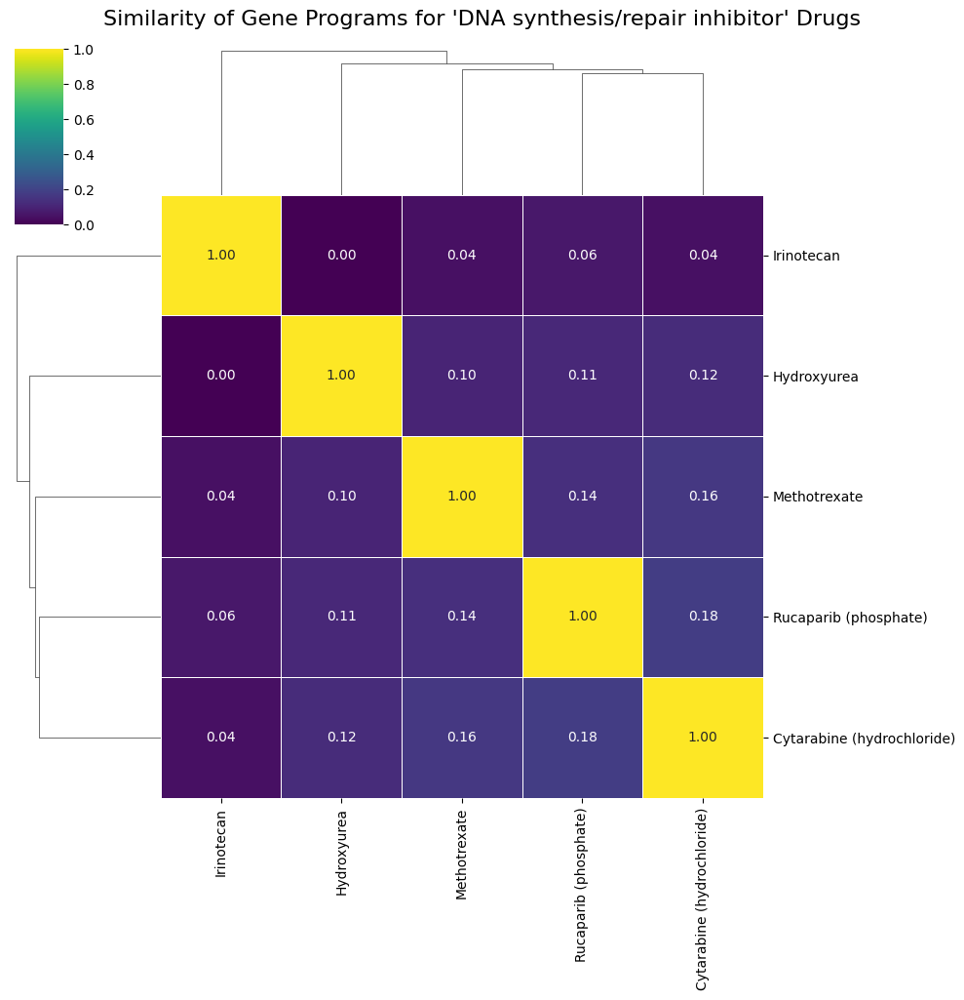

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import random
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

# --- Install the required 'scikit-misc' package for the 'seurat_v3' method ---
!pip install -q scikit-misc

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
drug_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/drug_metadata.parquet"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# ==============================================================================
# Part 2: Select an MOA Group and Load All Corresponding Data at Once
# ==============================================================================
print("\n--- Step 2: Selecting an MOA Group and Loading Data ---")

# --- Define the Mechanism of Action you want to analyze ---
target_moa = "DNA synthesis/repair inhibitor"
control_name = "DMSO_TF"
print(f"Targeting MOA: '{target_moa}'")

try:
    # Load the drug metadata to find which drugs belong to this MOA
    drug_df = pd.read_parquet(drug_metadata_path)
    drugs_in_moa = drug_df[drug_df['moa-fine'] == target_moa]['drug'].dropna().unique().tolist()

    # --- Randomly select 5 drugs from the MOA to keep the analysis manageable ---
    if len(drugs_in_moa) > 5:
        selected_drugs = random.sample(drugs_in_moa, 5)
    else:
        selected_drugs = drugs_in_moa

    print(f"Found {len(drugs_in_moa)} drugs in this group. Analyzing: {selected_drugs}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Could not load or process drug metadata. Error: {e}")

# --- Load the .h5ad files for the selected drugs + the control ---
files_to_load = selected_drugs + [control_name]
adata_list = []
for drug_name in files_to_load:
    file_name = f"{drug_name}.h5ad"
    file_path = os.path.join(source_data_folder, file_name)
    if os.path.exists(file_path):
        try:
            adata_single = sc.read_h5ad(file_path)
            adata_single.obs['drug'] = drug_name # Add drug label
            adata_list.append(adata_single)
            print(f"--> Successfully loaded: {file_name}")
        except Exception as e:
            print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")
    else:
        print(f"--> WARNING: File not found for drug '{drug_name}'. Skipping.")

if len(adata_list) < 2:
    raise RuntimeError("Could not load enough data files for comparison.")

# --- Combine all data into a single object ONCE ---
adata_comp = sc.concat(adata_list)
print(f"\n✅ Combined data object created with {adata_comp.n_obs} cells.")


# ==============================================================================
# Part 3: Find Expression Programs using Differential Expression
# ==============================================================================
print("\n--- Step 3: Finding Expression Programs using Most Variant Genes ---")

# --- Preprocessing on the combined object ONCE ---
print("Normalizing and logarithmizing data...")
sc.pp.normalize_total(adata_comp, target_sum=1e4)
sc.pp.log1p(adata_comp)

# --- Find Highly Variable Genes using the specified method ---
# This step is for potential downstream analysis but is not used directly
# by rank_genes_groups, which should be run on all genes.
print("Finding highly variable genes with 'seurat_v3' flavor...")
sc.pp.highly_variable_genes(adata_comp, flavor="seurat_v3", n_top_genes=2000)


# --- Perform Differential Expression Test for all drugs at once ---
print(f"Running differential expression tests for all selected drugs vs. {control_name}...")
# This function is optimized to handle multiple comparisons efficiently
sc.tl.rank_genes_groups(
    adata_comp,
    groupby='drug',
    groups=selected_drugs, # The groups to test
    reference=control_name, # The control group to compare against
    method='wilcoxon'
)
print("✅ Differential expression analysis complete.")

# --- Extract the top genes for each drug ---
expression_programs = {}
n_top_genes = 50

for drug_name in selected_drugs:
    de_results = sc.get.rank_genes_groups_df(adata_comp, group=drug_name)
    # Filter for up-regulated genes with significant p-values
    significant_upregulated = de_results[(de_results['pvals_adj'] < 0.05) & (de_results['logfoldchanges'] > 0)]
    top_gene_ids = significant_upregulated.head(n_top_genes)['names'].tolist()

    # Store this list as the "expression program" for the drug
    expression_programs[drug_name] = top_gene_ids
    print(f"✅ Found {len(top_gene_ids)} significant up-regulated genes for {drug_name}.")

print("\n✅ Feature extraction complete.")


# ==============================================================================
# Part 4: Compare Programs and Visualize Similarity
# ==============================================================================
print("\n--- Step 4: Comparing Programs and Generating Similarity Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

# Calculate the Jaccard similarity between each pair of programs
for prog1_name, genes1 in expression_programs.items():
    for prog2_name, genes2 in expression_programs.items():
        set1 = set(genes1)
        set2 = set(genes2)
        intersection = len(set1.intersection(set2))
        union = len(set1.union(set2))
        similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

# --- Generate a Clustered Heatmap ---
print("Generating program similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='viridis',
    annot=True,
    fmt=".2f",
    linewidths=.5,
    figsize=(10, 10)
)
plt.suptitle(f"Similarity of Gene Programs for '{target_moa}' Drugs", y=1.02, fontsize=16)
plt.show()



# 7th week's tasks

In [ ]:
# Install the required 'scikit-misc' package for the 'seurat_v3' method
!pip install -q scikit-misc

--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Selecting an MOA Group and Loading Data ---
Targeting MOA: 'DNA synthesis/repair inhibitor'
Found 27 drugs in this group. Analyzing: ['AZD-7648', 'Irinotecan (hydrochloride)', 'Trifluridine', 'Clofarabine', 'Idarubicin (hydrochloride)', 'Topotecan (hydrochloride)', 'Bendamustine', 'Busulfan', 'Pemetrexed', 'Raltitrexed']
--> Successfully loaded: AZD-7648.h5ad
--> Successfully loaded: Irinotecan (hydrochloride).h5ad
--> Successfully loaded: Trifluridine.h5ad
--> Successfully loaded: Clofarabine.h5ad
--> Successfully loaded: Idarubicin (hydrochloride).h5ad
--> Successfully loaded: Topotecan (hydrochloride).h5ad
--> Successfully loaded: Bendamustine.h5ad
--> Successfully loaded: Busulfan.h5ad
--> Successfully loaded: Pemetrexed.h5ad
--> Successfully loaded: Raltitrexed.h5ad
--> Successfully loaded: DMSO_TF.h5ad

✅ Combined data object created with 299389 cells.

--- Step 3: Finding Expression P

/usr/local/lib/python3.12/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)


✅ Data pruned to 100 most variable genes.

Running differential expression tests on the pruned gene list...
✅ Differential expression analysis complete.
✅ Found 5 significant up-regulated genes for AZD-7648.
✅ Found 2 significant up-regulated genes for Irinotecan (hydrochloride).
✅ Found 6 significant up-regulated genes for Trifluridine.
✅ Found 4 significant up-regulated genes for Clofarabine.
✅ Found 4 significant up-regulated genes for Idarubicin (hydrochloride).
✅ Found 2 significant up-regulated genes for Topotecan (hydrochloride).
✅ Found 1 significant up-regulated genes for Bendamustine.
✅ Found 7 significant up-regulated genes for Busulfan.
✅ Found 1 significant up-regulated genes for Pemetrexed.
✅ Found 11 significant up-regulated genes for Raltitrexed.

✅ Feature extraction complete.

--- Step 4: Comparing Programs and Generating Similarity Heatmap ---
Generating program similarity heatmap...


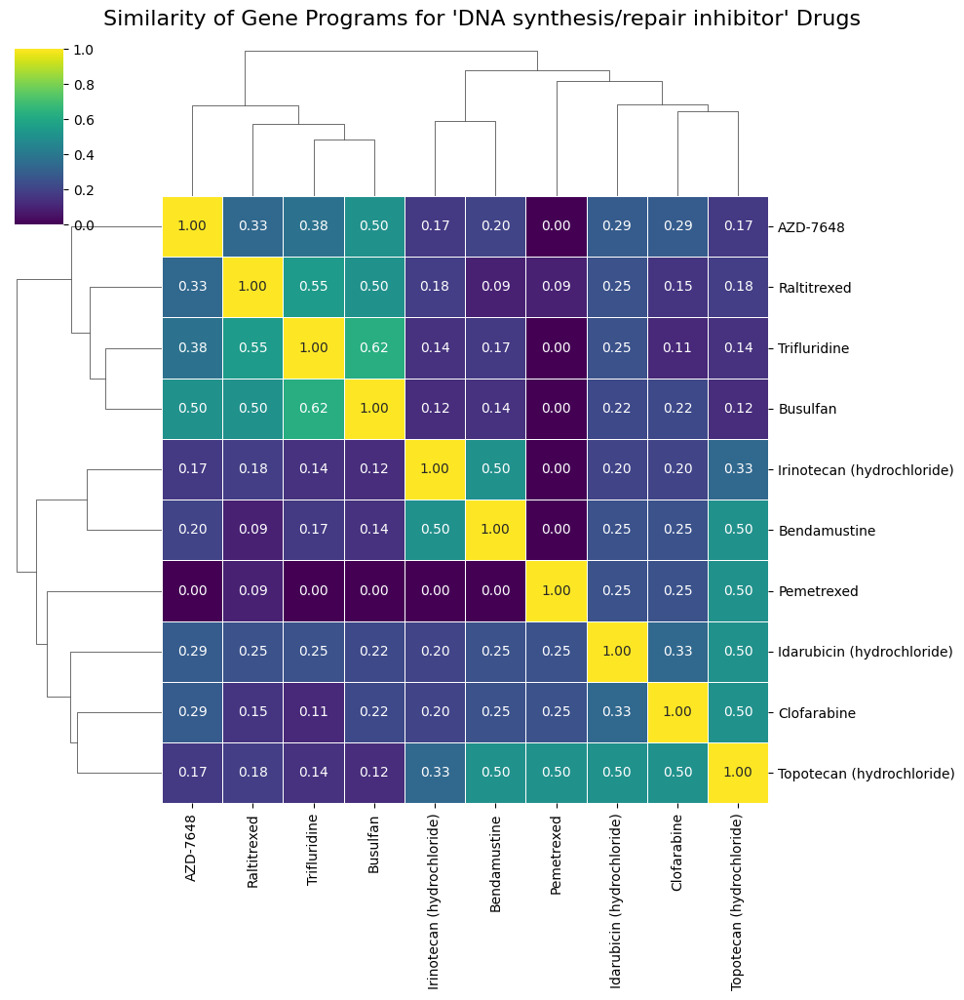

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import random
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

# --- Install the required 'scikit-misc' package for the 'seurat_v3' method ---
!pip install -q scikit-misc

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
drug_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/drug_metadata.parquet"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# ==============================================================================
# Part 2: Select an MOA Group and Load All Corresponding Data at Once
# ==============================================================================
print("\n--- Step 2: Selecting an MOA Group and Loading Data ---")

# --- Define the Mechanism of Action you want to analyze ---
target_moa = "DNA synthesis/repair inhibitor"
control_name = "DMSO_TF"
print(f"Targeting MOA: '{target_moa}'")

try:
    # Load the drug metadata to find which drugs belong to this MOA
    drug_df = pd.read_parquet(drug_metadata_path)
    drugs_in_moa = drug_df[drug_df['moa-fine'] == target_moa]['drug'].dropna().unique().tolist()

    # --- Randomly select 5 drugs from the MOA to keep the analysis manageable ---
    if len(drugs_in_moa) > 5:
        selected_drugs = random.sample(drugs_in_moa, 10)
    else:
        selected_drugs = drugs_in_moa

    print(f"Found {len(drugs_in_moa)} drugs in this group. Analyzing: {selected_drugs}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Could not load or process drug metadata. Error: {e}")

# --- Load the .h5ad files for the selected drugs + the control ---
files_to_load = selected_drugs + [control_name]
adata_list = []
for drug_name in files_to_load:
    file_name = f"{drug_name}.h5ad"
    file_path = os.path.join(source_data_folder, file_name)
    if os.path.exists(file_path):
        try:
            adata_single = sc.read_h5ad(file_path)
            adata_single.obs['drug'] = drug_name # Add drug label
            adata_list.append(adata_single)
            print(f"--> Successfully loaded: {file_name}")
        except Exception as e:
            print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")
    else:
        print(f"--> WARNING: File not found for drug '{drug_name}'. Skipping.")

if len(adata_list) < 2:
    raise RuntimeError("Could not load enough data files for comparison.")

# --- Combine all data into a single object ONCE ---
adata_comp = sc.concat(adata_list)
print(f"\n✅ Combined data object created with {adata_comp.n_obs} cells.")


# ==============================================================================
# Part 3: Find Expression Programs using Differential Expression
# ==============================================================================
print("\n--- Step 3: Finding Expression Programs using Most Variant Genes ---")

# --- Preprocessing on the combined object ONCE ---
print("Normalizing and logarithmizing data...")
sc.pp.normalize_total(adata_comp, target_sum=1e4)
sc.pp.log1p(adata_comp)

# --- Find Highly Variable Genes using the specified method ---
# We select a small number of genes to make the next step very fast.
n_top_genes_to_keep = 100
print(f"Finding top {n_top_genes_to_keep} highly variable genes...")
sc.pp.highly_variable_genes(adata_comp, flavor="seurat_v3", n_top_genes=n_top_genes_to_keep)

# --- EFFICIENCY MODIFICATION: Filter the data to only the HVGs ---
# This drastically reduces the number of genes for the DE test.
adata_comp = adata_comp[:, adata_comp.var.highly_variable].copy()
print(f"✅ Data pruned to {adata_comp.n_vars} most variable genes.")
# --- END MODIFICATION ---


# --- Perform Differential Expression Test for all drugs at once ---
print(f"\nRunning differential expression tests on the pruned gene list...")
sc.tl.rank_genes_groups(
    adata_comp,
    groupby='drug',
    groups=selected_drugs, # The groups to test
    reference=control_name, # The control group to compare against
    method='wilcoxon'
)
print("✅ Differential expression analysis complete.")

# --- Extract the top genes for each drug ---
expression_programs = {}
n_top_genes = 50

for drug_name in selected_drugs:
    de_results = sc.get.rank_genes_groups_df(adata_comp, group=drug_name)
    # Filter for up-regulated genes with significant p-values
    significant_upregulated = de_results[(de_results['pvals_adj'] < 0.05) & (de_results['logfoldchanges'] > 0)]
    top_gene_ids = significant_upregulated.head(n_top_genes)['names'].tolist()

    # Store this list as the "expression program" for the drug
    expression_programs[drug_name] = top_gene_ids
    print(f"✅ Found {len(top_gene_ids)} significant up-regulated genes for {drug_name}.")

print("\n✅ Feature extraction complete.")


# ==============================================================================
# Part 4: Compare Programs and Visualize Similarity
# ==============================================================================
print("\n--- Step 4: Comparing Programs and Generating Similarity Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

# Calculate the Jaccard similarity between each pair of programs
for prog1_name, genes1 in expression_programs.items():
    for prog2_name, genes2 in expression_programs.items():
        set1 = set(genes1)
        set2 = set(genes2)
        intersection = len(set1.intersection(set2))
        union = len(set1.union(set2))
        similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

# --- Generate a Clustered Heatmap ---
print("Generating program similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='viridis',
    annot=True,
    fmt=".2f",
    linewidths=.5,
    figsize=(10, 10)
)
plt.suptitle(f"Similarity of Gene Programs for '{target_moa}' Drugs", y=1.02, fontsize=16)
plt.show()



--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Selecting an MOA Group and Loading Data ---
Targeting MOA: 'DNA synthesis/repair inhibitor'
Found 27 drugs in this group. Analyzing: ['Altretamine', 'Idarubicin (hydrochloride)', 'Rucaparib (phosphate)', 'Epirubicin (hydrochloride)', 'Clofarabine', 'AZD-7648', 'Gemcitabine', 'Busulfan', 'Trifluridine', 'Trimetrexate']
--> Successfully loaded: Altretamine.h5ad
--> Successfully loaded: Idarubicin (hydrochloride).h5ad
--> Successfully loaded: Rucaparib (phosphate).h5ad
--> Successfully loaded: Epirubicin (hydrochloride).h5ad
--> Successfully loaded: Clofarabine.h5ad
--> Successfully loaded: AZD-7648.h5ad
--> Successfully loaded: Gemcitabine.h5ad
--> Successfully loaded: Busulfan.h5ad
--> Successfully loaded: Trifluridine.h5ad
--> Successfully loaded: Trimetrexate.h5ad
--> Successfully loaded: DMSO_TF.h5ad

✅ Combined data object created with 274183 cells.

--- Step 3: Finding Expression Program

/usr/local/lib/python3.12/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)


✅ Data pruned to 100 most variable genes.

Running differential expression tests on the pruned gene list...
✅ Differential expression analysis complete.
✅ Found 3 significant up-regulated genes for Altretamine.
✅ Found 4 significant up-regulated genes for Idarubicin (hydrochloride).
✅ Found 4 significant up-regulated genes for Rucaparib (phosphate).
✅ Found 1 significant up-regulated genes for Epirubicin (hydrochloride).
✅ Found 4 significant up-regulated genes for Clofarabine.
✅ Found 5 significant up-regulated genes for AZD-7648.
✅ Found 5 significant up-regulated genes for Gemcitabine.
✅ Found 7 significant up-regulated genes for Busulfan.
✅ Found 6 significant up-regulated genes for Trifluridine.
✅ Found 6 significant up-regulated genes for Trimetrexate.

✅ Feature extraction complete.

--- Step 4: Comparing Programs and Generating Similarity Heatmap ---
Generating program similarity heatmap...


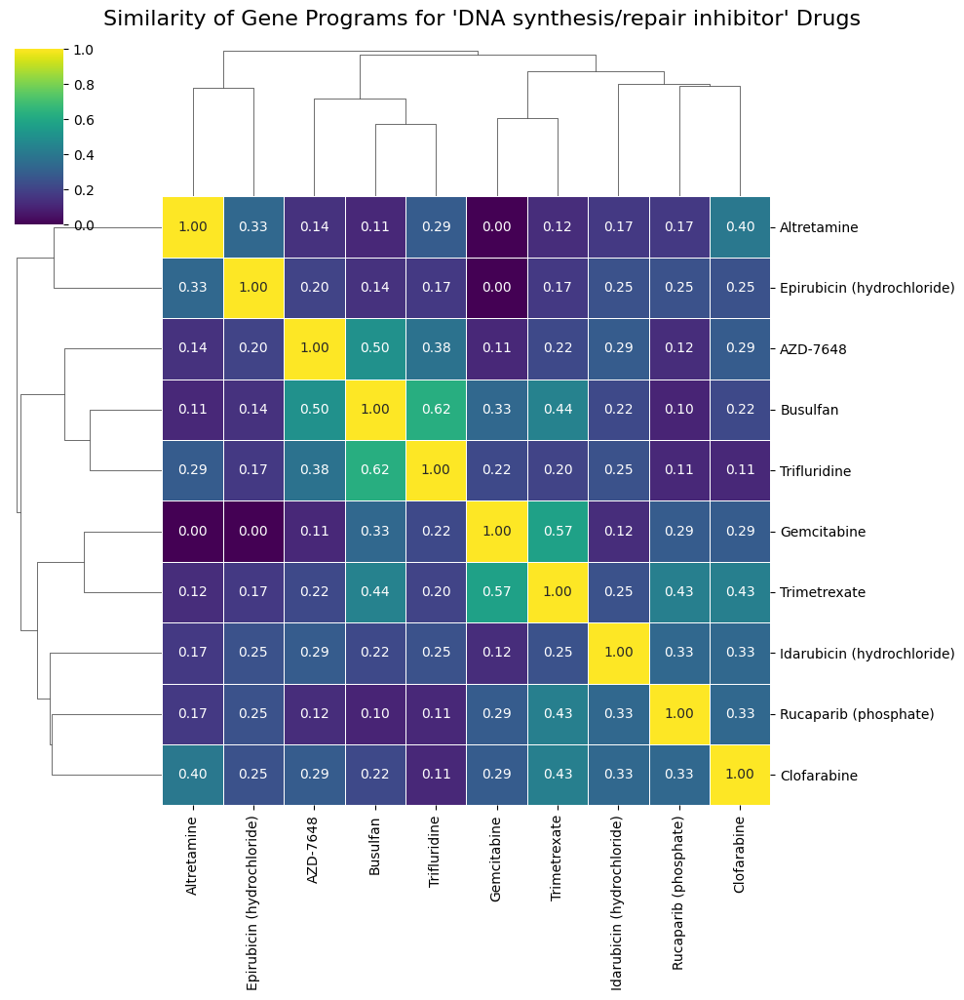

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import random
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

# --- Install the required 'scikit-misc' package for the 'seurat_v3' method ---
!pip install -q scikit-misc

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths
source_data_folder = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/"
drug_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/drug_metadata.parquet"
gene_metadata_path = "/content/drive/MyDrive/TAHOE/metadata/gene_metadata.parquet"

# ==============================================================================
# Part 2: Select an MOA Group and Load All Corresponding Data at Once
# ==============================================================================
print("\n--- Step 2: Selecting an MOA Group and Loading Data ---")

# --- Define the Mechanism of Action you want to analyze ---
target_moa = "DNA synthesis/repair inhibitor"
control_name = "DMSO_TF"
print(f"Targeting MOA: '{target_moa}'")

try:
    # Load the drug metadata to find which drugs belong to this MOA
    drug_df = pd.read_parquet(drug_metadata_path)
    drugs_in_moa = drug_df[drug_df['moa-fine'] == target_moa]['drug'].dropna().unique().tolist()

    # --- Randomly select 5 drugs from the MOA to keep the analysis manageable ---
    if len(drugs_in_moa) > 10:
        selected_drugs = random.sample(drugs_in_moa, 10)
    else:
        selected_drugs = drugs_in_moa

    print(f"Found {len(drugs_in_moa)} drugs in this group. Analyzing: {selected_drugs}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Could not load or process drug metadata. Error: {e}")

# --- Load the .h5ad files for the selected drugs + the control ---
files_to_load = selected_drugs + [control_name]
adata_list = []
for drug_name in files_to_load:
    file_name = f"{drug_name}.h5ad"
    file_path = os.path.join(source_data_folder, file_name)
    if os.path.exists(file_path):
        try:
            adata_single = sc.read_h5ad(file_path)
            adata_single.obs['drug'] = drug_name # Add drug label
            adata_list.append(adata_single)
            print(f"--> Successfully loaded: {file_name}")
        except Exception as e:
            print(f"--> WARNING: Could not load file: {file_name}. Error: {e}")
    else:
        print(f"--> WARNING: File not found for drug '{drug_name}'. Skipping.")

if len(adata_list) < 2:
    raise RuntimeError("Could not load enough data files for comparison.")

# --- Combine all data into a single object ONCE ---
adata_comp = sc.concat(adata_list)
print(f"\n✅ Combined data object created with {adata_comp.n_obs} cells.")


# ==============================================================================
# Part 3: Find Expression Programs using Differential Expression
# ==============================================================================
print("\n--- Step 3: Finding Expression Programs using Most Variant Genes ---")

# --- Preprocessing on the combined object ONCE ---
print("Normalizing and logarithmizing data...")
sc.pp.normalize_total(adata_comp, target_sum=1e4)
sc.pp.log1p(adata_comp)

# --- Find Highly Variable Genes using the specified method ---
# We select a small number of genes to make the next step very fast.
n_top_genes_to_keep = 100
print(f"Finding top {n_top_genes_to_keep} highly variable genes...")
sc.pp.highly_variable_genes(adata_comp, flavor="seurat_v3", n_top_genes=n_top_genes_to_keep)

# --- EFFICIENCY MODIFICATION: Filter the data to only the HVGs ---
# This drastically reduces the number of genes for the DE test.
adata_comp = adata_comp[:, adata_comp.var.highly_variable].copy()
print(f"✅ Data pruned to {adata_comp.n_vars} most variable genes.")
# --- END MODIFICATION ---


# --- Perform Differential Expression Test for all drugs at once ---
print(f"\nRunning differential expression tests on the pruned gene list...")
sc.tl.rank_genes_groups(
    adata_comp,
    groupby='drug',
    groups=selected_drugs, # The groups to test
    reference=control_name, # The control group to compare against
    method='wilcoxon'
)
print("✅ Differential expression analysis complete.")

# --- Extract the top genes for each drug ---
expression_programs = {}
n_top_genes = 10

for drug_name in selected_drugs:
    de_results = sc.get.rank_genes_groups_df(adata_comp, group=drug_name)
    # Filter for up-regulated genes with significant p-values
    significant_upregulated = de_results[(de_results['pvals_adj'] < 0.05) & (de_results['logfoldchanges'] > 0)]
    top_gene_ids = significant_upregulated.head(n_top_genes)['names'].tolist()

    # Store this list as the "expression program" for the drug
    expression_programs[drug_name] = top_gene_ids
    print(f"✅ Found {len(top_gene_ids)} significant up-regulated genes for {drug_name}.")

print("\n✅ Feature extraction complete.")


# ==============================================================================
# Part 4: Compare Programs and Visualize Similarity
# ==============================================================================
print("\n--- Step 4: Comparing Programs and Generating Similarity Heatmap ---")

# Create an empty DataFrame to store similarity scores
similarity_df = pd.DataFrame(index=expression_programs.keys(), columns=expression_programs.keys(), dtype=float)

# Calculate the Jaccard similarity between each pair of programs
for prog1_name, genes1 in expression_programs.items():
    for prog2_name, genes2 in expression_programs.items():
        set1 = set(genes1)
        set2 = set(genes2)
        intersection = len(set1.intersection(set2))
        union = len(set1.union(set2))
        similarity_df.loc[prog1_name, prog2_name] = intersection / union if union != 0 else 0

# --- Generate a Clustered Heatmap ---
print("Generating program similarity heatmap...")
sns.clustermap(
    similarity_df,
    cmap='viridis',
    annot=True,
    fmt=".2f",
    linewidths=.5,
    figsize=(10, 10)
)
plt.suptitle(f"Similarity of Gene Programs for '{target_moa}' Drugs", y=1.02, fontsize=16)
plt.show()



--- Step 1: Mounting Google Drive and Loading Data ---
Mounted at /content/drive
✅ Successfully loaded: SW620.h5ad

--- Step 2: Calculating and Visualizing QC Metrics ---
✅ QC metrics calculated.
Generating QC violin plots...


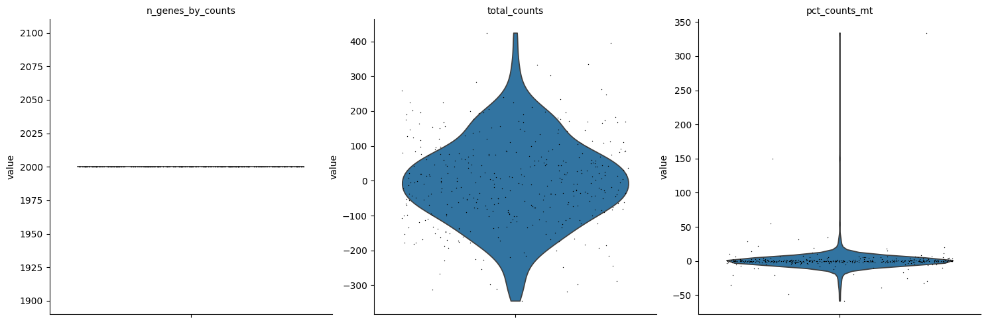

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import scanpy as sc
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Loading Data ---")
drive.mount('/content/drive', force_remount=True)

# Define path to the clustered data file
data_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad"

try:
    # Load the clustered AnnData object
    adata = sc.read_h5ad(data_path)
    print(f"✅ Successfully loaded: {os.path.basename(data_path)}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load the required file. Error: {e}")

# ==============================================================================
# Part 2: Calculate and Visualize Quality Control Metrics
# ==============================================================================
print("\n--- Step 2: Calculating and Visualizing QC Metrics ---")

# --- Calculate QC Metrics ---
# Scanpy's function calculates n_genes_by_counts, total_counts, and pct_counts_mt
# We need to identify mitochondrial genes first. They typically start with "MT-".
adata.var['mt'] = adata.var_names.str.startswith('MT-')
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

print("✅ QC metrics calculated.")

# --- Generate Violin Plots ---
# This plot shows the distribution of each QC metric across all cells.
print("Generating QC violin plots...")
sc.pl.violin(
    adata,
    ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
    jitter=0.4,
    multi_panel=True
)



--- Step 1: Mounting Google Drive and Loading Data ---
Mounted at /content/drive
✅ Successfully loaded: SW480.h5ad

--- Step 2: Calculating and Visualizing QC Metrics ---
✅ QC metrics calculated.
Generating QC violin plots...


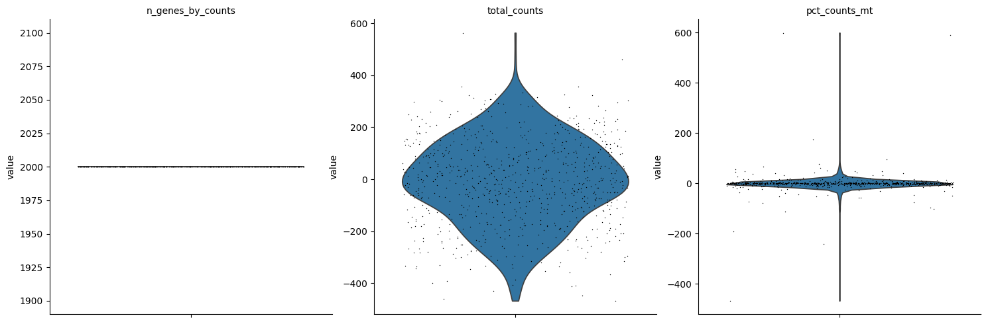

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import scanpy as sc
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Loading Data ---")
drive.mount('/content/drive', force_remount=True)

# Define path to the clustered data file
data_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW480.h5ad"

try:
    # Load the clustered AnnData object
    adata = sc.read_h5ad(data_path)
    print(f"✅ Successfully loaded: {os.path.basename(data_path)}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load the required file. Error: {e}")

# ==============================================================================
# Part 2: Calculate and Visualize Quality Control Metrics
# ==============================================================================
print("\n--- Step 2: Calculating and Visualizing QC Metrics ---")

# --- Calculate QC Metrics ---
# Scanpy's function calculates n_genes_by_counts, total_counts, and pct_counts_mt
# We need to identify mitochondrial genes first. They typically start with "MT-".
adata.var['mt'] = adata.var_names.str.startswith('MT-')
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

print("✅ QC metrics calculated.")

# --- Generate Violin Plots ---
# This plot shows the distribution of each QC metric across all cells.
print("Generating QC violin plots...")
sc.pl.violin(
    adata,
    ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
    jitter=0.4,
    multi_panel=True
)



--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 13.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.4/4.4 MB 90.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 70.9 MB/s eta 0:00:00

--- Step 3: Running ddqc on SW620 and SW480 ---

      Running ddqc for: SW620
Initial number of cells: 381
Performing initial clustering to group similar cells...
Calculating adaptive thresholds per cluster...
✅ ddqc complete for SW620.
   - Cells removed: 79
   - Cells remaining: 302 (79.27%)

      Running ddqc for: SW480
Initial number of cells: 793
Performing initial clustering to group similar cells...
Calculating adaptive thresholds per cluster...
✅ ddqc complete for SW480.
   - Cells removed: 144
   - Cells remaining: 649 (81.84%)


--- Step 4: Generating Comparative QC Plots ---


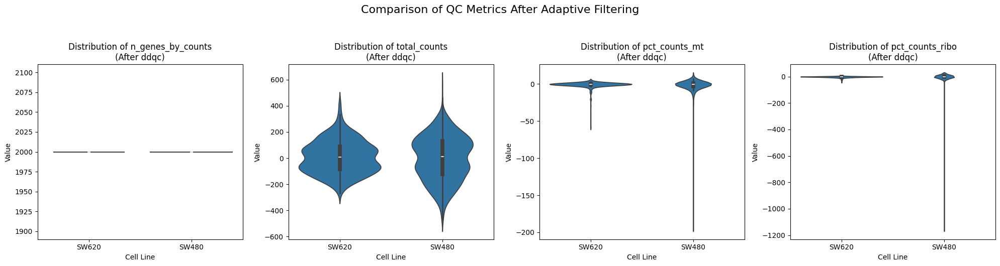

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths to the clustered data files
sw620_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad"
sw480_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW480.h5ad"

# --- Install required libraries for clustering ---
!pip install -q igraph leidenalg louvain
# --- END Install required libraries for clustering ---


# ==============================================================================
# Part 2: Define the ddqc Function
# This function encapsulates the paper's adaptive QC methodology.
# ==============================================================================

def run_ddqc(adata: sc.AnnData, cell_line_name: str, n_mads: float = 3.0):
    """
    Performs data-driven Quality Control (ddqc) on an AnnData object.

    Args:
        adata: The AnnData object to process.
        cell_line_name: The name of the cell line for plotting titles.
        n_mads: The number of Median Absolute Deviations to use as the threshold.
    """
    print("\n" + "="*60)
    print(f"      Running ddqc for: {cell_line_name}")
    print("="*60)

    n_cells_initial = adata.n_obs
    print(f"Initial number of cells: {n_cells_initial}")

    # --- 1. Calculate standard QC metrics ---
    # Identify mitochondrial and ribosomal genes
    adata.var['mt'] = adata.var_names.str.startswith('MT-')
    adata.var['ribo'] = adata.var_names.str.startswith(('RPS', 'RPL'))
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt', 'ribo'], percent_top=None, log1p=False, inplace=True)

    # --- 2. Perform lenient, initial clustering ---
    # This is just to group biologically similar cells together.
    print("Performing initial clustering to group similar cells...")
    adata_clust = adata.copy()

    # --- FIX: The input data is already processed, so we skip re-normalization ---
    # sc.pp.normalize_total(adata_clust, target_sum=1e4)
    # sc.pp.log1p(adata_clust)
    # --- END FIX ---

    sc.pp.highly_variable_genes(adata_clust, n_top_genes=2000)
    sc.tl.pca(adata_clust)
    sc.pp.neighbors(adata_clust)
    sc.tl.louvain(adata_clust, key_added='qc_cluster')

    # Add the cluster labels back to the original object
    adata.obs['qc_cluster'] = adata_clust.obs['qc_cluster']

    # --- 3. Calculate adaptive thresholds for each cluster ---
    print("Calculating adaptive thresholds per cluster...")
    qc_metrics = {
        'n_genes_by_counts': 'lower',
        'total_counts': 'lower',
        'pct_counts_mt': 'upper',
        'pct_counts_ribo': 'upper'
    }

    # Initialize a boolean array to keep track of cells to keep
    cells_to_keep = pd.Series(True, index=adata.obs_names)

    for cluster in adata.obs['qc_cluster'].unique():
        cluster_mask = adata.obs['qc_cluster'] == cluster

        for metric, bound_type in qc_metrics.items():
            metric_vals = adata.obs[metric][cluster_mask]
            median = metric_vals.median()
            mad = (metric_vals - median).abs().median()

            if bound_type == 'lower':
                threshold = median - n_mads * mad
                outliers = metric_vals < threshold
            else: # upper bound
                threshold = median + n_mads * mad
                outliers = metric_vals > threshold

            # Mark the outliers for removal
            cells_to_keep[outliers.index[outliers]] = False

    # --- 4. Filter the data ---
    n_cells_final = cells_to_keep.sum()
    adata_filtered = adata[cells_to_keep].copy()

    print(f"✅ ddqc complete for {cell_line_name}.")
    print(f"   - Cells removed: {n_cells_initial - n_cells_final}")
    print(f"   - Cells remaining: {n_cells_final} ({n_cells_final / n_cells_initial:.2%})")

    return adata_filtered


# ==============================================================================
# Part 3: Run the Analysis and Compare Results
# ==============================================================================
print("\n--- Step 3: Running ddqc on SW620 and SW480 ---")

# Load the data
adata_sw620 = sc.read_h5ad(sw620_path)
adata_sw480 = sc.read_h5ad(sw480_path)

# Run the ddqc pipeline on each dataset
adata_sw620_filtered = run_ddqc(adata_sw620, "SW620")
adata_sw480_filtered = run_ddqc(adata_sw480, "SW480")

# --- Create a combined DataFrame for comparative plotting ---
adata_sw620_filtered.obs['cell_line'] = 'SW620'
adata_sw480_filtered.obs['cell_line'] = 'SW480'
combined_obs_df = pd.concat([adata_sw620_filtered.obs, adata_sw480_filtered.obs])

# --- Generate Comparative Plots ---
print("\n\n--- Step 4: Generating Comparative QC Plots ---")

metrics_to_plot = ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo']
fig, axes = plt.subplots(1, len(metrics_to_plot), figsize=(20, 5))

for i, metric in enumerate(metrics_to_plot):
    sns.violinplot(
        data=combined_obs_df,
        x='cell_line',
        y=metric,
        ax=axes[i]
    )
    axes[i].set_title(f'Distribution of {metric}\n(After ddqc)')
    axes[i].set_xlabel("Cell Line")
    axes[i].set_ylabel("Value")

plt.suptitle("Comparison of QC Metrics After Adaptive Filtering", fontsize=16, y=1.05)
plt.tight_layout()
plt.show()


--- Step 3: Running ddqc on SW620 and SW480 ---

      Running ddqc for: SW620
Initial number of cells: 381
Performing initial clustering to group similar cells...
extracting highly variable genes
    finished (0:00:00)
computing PCA
    with n_comps=50
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00)
Calculating adaptive thresholds per cluster...
✅ ddqc complete for SW620.
   - Cells removed: 79
   - Cells remaining: 302 (79.27%)

      Running ddqc for: SW620_hypoxy
Initial number of cells: 252
Performing initial clustering to group similar cells...
extracting highly variable genes
    finished (0:00:00)
computing PCA
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00)
Calc

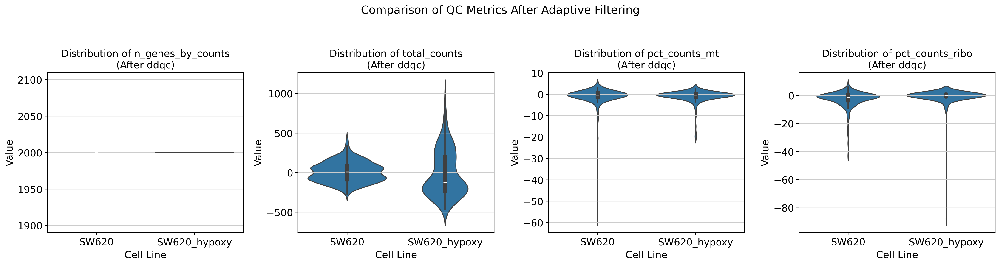

In [ ]:
sw620_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad"
sw620_hypoxy_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620_Hypoxia.h5ad"
sw480_path = sw620_hypoxy_path

# ==============================================================================
# Part 2: Define the ddqc Function
# This function encapsulates the paper's adaptive QC methodology.
# ==============================================================================

def run_ddqc(adata: sc.AnnData, cell_line_name: str, n_mads: float = 3.0):
    """
    Performs data-driven Quality Control (ddqc) on an AnnData object.

    Args:
        adata: The AnnData object to process.
        cell_line_name: The name of the cell line for plotting titles.
        n_mads: The number of Median Absolute Deviations to use as the threshold.
    """
    print("\n" + "="*60)
    print(f"      Running ddqc for: {cell_line_name}")
    print("="*60)

    n_cells_initial = adata.n_obs
    print(f"Initial number of cells: {n_cells_initial}")

    # --- 1. Calculate standard QC metrics ---
    # Identify mitochondrial and ribosomal genes
    adata.var['mt'] = adata.var_names.str.startswith('MT-')
    adata.var['ribo'] = adata.var_names.str.startswith(('RPS', 'RPL'))
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt', 'ribo'], percent_top=None, log1p=False, inplace=True)

    # --- 2. Perform lenient, initial clustering ---
    # This is just to group biologically similar cells together.
    print("Performing initial clustering to group similar cells...")
    adata_clust = adata.copy()

    # --- FIX: The input data is already processed, so we skip re-normalization ---
    # sc.pp.normalize_total(adata_clust, target_sum=1e4)
    # sc.pp.log1p(adata_clust)
    # --- END FIX ---

    sc.pp.highly_variable_genes(adata_clust, n_top_genes=2000)
    sc.tl.pca(adata_clust)
    sc.pp.neighbors(adata_clust)
    sc.tl.louvain(adata_clust, key_added='qc_cluster')

    # Add the cluster labels back to the original object
    adata.obs['qc_cluster'] = adata_clust.obs['qc_cluster']

    # --- 3. Calculate adaptive thresholds for each cluster ---
    print("Calculating adaptive thresholds per cluster...")
    qc_metrics = {
        'n_genes_by_counts': 'lower',
        'total_counts': 'lower',
        'pct_counts_mt': 'upper',
        'pct_counts_ribo': 'upper'
    }

    # Initialize a boolean array to keep track of cells to keep
    cells_to_keep = pd.Series(True, index=adata.obs_names)

    for cluster in adata.obs['qc_cluster'].unique():
        cluster_mask = adata.obs['qc_cluster'] == cluster

        for metric, bound_type in qc_metrics.items():
            metric_vals = adata.obs[metric][cluster_mask]
            median = metric_vals.median()
            mad = (metric_vals - median).abs().median()

            if bound_type == 'lower':
                threshold = median - n_mads * mad
                outliers = metric_vals < threshold
            else: # upper bound
                threshold = median + n_mads * mad
                outliers = metric_vals > threshold

            # Mark the outliers for removal
            if outliers.any():
                cells_to_keep[outliers.index[outliers]] = False

    # --- 4. Filter the data ---
    n_cells_final = cells_to_keep.sum()
    adata_filtered = adata[cells_to_keep].copy()

    print(f"✅ ddqc complete for {cell_line_name}.")
    print(f"   - Cells removed: {n_cells_initial - n_cells_final}")
    print(f"   - Cells remaining: {n_cells_final} ({n_cells_final / n_cells_initial:.2%})")

    return adata_filtered


# ==============================================================================
# Part 3: Run the Analysis and Compare Results
# ==============================================================================
print("\n--- Step 3: Running ddqc on SW620 and SW480 ---")

# Load the data
adata_sw620 = sc.read_h5ad(sw620_path)
adata_sw480 = sc.read_h5ad(sw480_path)

# Run the ddqc pipeline on each dataset
adata_sw620_filtered = run_ddqc(adata_sw620, "SW620")
adata_sw480_filtered = run_ddqc(adata_sw480, "SW620_hypoxy")

# --- Create a combined DataFrame for comparative plotting ---
adata_sw620_filtered.obs['cell_line'] = 'SW620'
adata_sw480_filtered.obs['cell_line'] = 'SW620_hypoxy'
combined_obs_df = pd.concat([adata_sw620_filtered.obs, adata_sw480_filtered.obs])

# --- Generate Comparative Plots ---
print("\n\n--- Step 4: Generating Comparative QC Plots ---")

metrics_to_plot = ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo']
fig, axes = plt.subplots(1, len(metrics_to_plot), figsize=(20, 5))

for i, metric in enumerate(metrics_to_plot):
    sns.violinplot(
        data=combined_obs_df,
        x='cell_line',
        y=metric,
        ax=axes[i]
    )
    axes[i].set_title(f'Distribution of {metric}\n(After ddqc)')
    axes[i].set_xlabel("Cell Line")
    axes[i].set_ylabel("Value")

plt.suptitle("Comparison of QC Metrics After Adaptive Filtering", fontsize=16, y=1.05)
plt.tight_layout()
plt.show()

In [ ]:
from scipy import sparse

def sanitize_X_inplace(adata_obj):
    """Replace NaN/±Inf in .X (and optional layer) with 0, supports dense/sparse."""
    if sparse.issparse(adata_obj.X):
        X = adata_obj.X.tocsr(copy=True)
        X.data = np.nan_to_num(X.data, nan=0.0, posinf=0.0, neginf=0.0)
        adata_obj.X = X
    else:
        adata_obj.X = np.nan_to_num(adata_obj.X, nan=0.0, posinf=0.0, neginf=0.0)

def finite_guard_adata(adata_obj):
    """Ensure all entries are finite; returns True if ok."""
    if sparse.issparse(adata_obj.X):
        arr = adata_obj.X.data
    else:
        arr = np.asarray(adata_obj.X)
    return np.isfinite(arr).all()


In [ ]:
# Sanitize X immediately (your files contain NaNs)
sanitize_X_inplace(adata)
if not finite_guard_adata(adata):
    raise RuntimeError("Matrix still contains non-finite values after sanitization.")


In [ ]:
print("\n" + "="*60)
print("      Part 2: Conventional (Fixed/Lenient) QC")
print("="*60)

adata_conv = adata.copy()

if has_counts:
    # counts-based thresholds (as before)
    min_genes = max(200, int(round(p5_genes)))
    min_counts = max(100, int(round(p5_counts)))
    max_mito  = min(20.0, max(5.0, p95_mito))
    print(f"Applying thresholds (counts): min_genes={min_genes}, min_counts={min_counts}, max_mito={max_mito}%")
    mask = (
        (adata_conv.obs['n_genes_by_counts'] >= min_genes) &
        (adata_conv.obs['total_counts']       >= min_counts) &
        (adata_conv.obs['pct_counts_mt']      <= max_mito)
    )
    adata_conv = adata_conv[mask].copy()
else:
    # No counts → do NOT drop anything by gene/UMI/mito; keep all
    print("⚠️ No counts layer — skipping destructive conventional QC (keeping all cells).")
    # (Optional) If you insist on *some* guard, only drop rows with all-NaN/±Inf (already sanitized) or zero variance later.

print(f"✅ Conventional QC complete. Cells retained: {adata_conv.n_obs} / {adata.n_obs}")



      Part 2: Conventional (Fixed/Lenient) QC
⚠️ No counts layer — skipping destructive conventional QC (keeping all cells).
✅ Conventional QC complete. Cells retained: 1174 / 1174


In [ ]:
# Ensure matrix is finite before PCA
sanitize_X_inplace(adata_ddqc_base)
if not finite_guard_adata(adata_ddqc_base):
    raise RuntimeError("Non-finite entries in adata_ddqc_base before PCA.")

# Choose safe number of PCs (cannot exceed min(n_obs-1, n_vars))
n_comps = int(min(50, max(2, min(adata_ddqc_base.n_vars, adata_ddqc_base.n_obs - 1))))
if n_comps < 2:
    raise RuntimeError(f"Not enough rank for PCA: n_obs={adata_ddqc_base.n_obs}, n_vars={adata_ddqc_base.n_vars}")


In [ ]:
sc.tl.pca(adata_ddqc_base, n_comps=n_comps, svd_solver='arpack')
n_neighbors = int(min(20, max(5, np.sqrt(max(adata_ddqc_base.n_obs, 2)))))
sc.pp.neighbors(adata_ddqc_base, n_neighbors=n_neighbors, n_pcs=n_comps)


computing PCA
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00)


--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive
✅ Data successfully loaded.
AnnData object with n_obs × n_vars = 139224 × 62710
    obs: 'sample', 'gene_count', 'tscp_count', 'mread_count', 'pcnt_mito', 'S_score', 'G2M_score', 'phase'
    obsm: 'X_scVI'

--- Step 2: Running the Clustering Analysis ---
Normalizing and logarithmizing data...
Finding highly variable genes...
Scaling data...


/usr/local/lib/python3.12/dist-packages/scanpy/preprocessing/_scale.py:309: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
/usr/lib/python3.12/functools.py:912: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


Running PCA...
Finding neighbors and clusters...
✅ Clustering complete!

--- Step 3: Generating UMAP Visualization ---


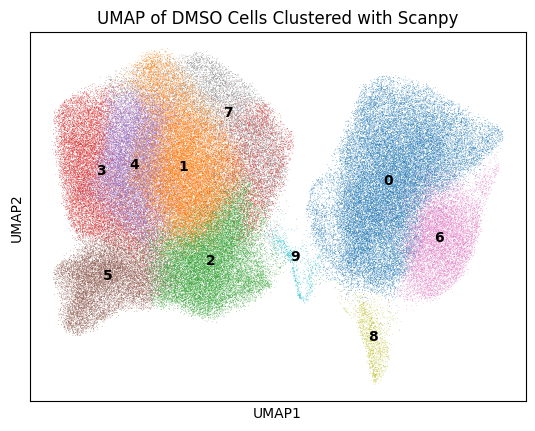

In [ ]:
# ==============================================================================
# Part 1: Setup and Loading
# This is the Python equivalent of the previous R script.
# ==============================================================================
import os
import scanpy as sc
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define the path to your .h5ad file
h5ad_file_path = "/content/drive/MyDrive/TAHOE/CVCL_0546_DRUGS_CLEANED/CVCL_0546_DRUG_CLEANED/DMSO_TF.h5ad"

try:
    # Load the AnnData object using scanpy
    adata = sc.read_h5ad(h5ad_file_path)
    print("✅ Data successfully loaded.")
    print(adata)

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load the .h5ad file. Please check the path. Error: {e}")


# ==============================================================================
# Part 2: Replicating the Clustering Workflow in Python
# ==============================================================================
print("\n--- Step 2: Running the Clustering Analysis ---")

# 1. Normalization and Log-Transformation
print("Normalizing and logarithmizing data...")
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

# 2. Feature Selection (Finding Highly Variable Genes)
print("Finding highly variable genes...")
sc.pp.highly_variable_genes(adata, n_top_genes=2000)
# Filter the data to keep only the HVGs
adata = adata[:, adata.var.highly_variable]

# 3. Scaling the data (a necessary step before PCA)
print("Scaling data...")
sc.pp.scale(adata, max_value=10)

# 4. Dimensionality Reduction (PCA)
print("Running PCA...")
sc.tl.pca(adata, svd_solver='arpack')

# 5. Graph-Based Clustering
print("Finding neighbors and clusters...")
# This builds the KNN graph
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=15)
# This runs the Louvain algorithm to find the communities/clusters
sc.tl.louvain(adata, resolution=0.5)

print("✅ Clustering complete!")


# ==============================================================================
# Part 3: Visualization
# ==============================================================================
print("\n--- Step 3: Generating UMAP Visualization ---")

# Run UMAP for visualization
sc.tl.umap(adata)

# Generate the UMAP plot, colored by the clusters we just found
sc.pl.umap(
    adata,
    color='louvain',
    legend_loc='on data', # Places the cluster number on the plot
    title='UMAP of DMSO Cells Clustered with Scanpy'
)



In [ ]:
sw620_path = "/content/drive/MyDrive/single-cell-multi-omics/h5ad_data/SW620.h5ad"
sw480_path = "/content/drive/MyDrive/single-cell-multi-omics/h5ad_data/SW480.h5ad"

In [ ]:
# === ddqc (cluster-wise MAD thresholds) — robust HVG with auto-install ===
import sys, subprocess

def ensure_pkg(modname, pip_name=None):
    try:
        __import__(modname)
        return True
    except ImportError:
        try:
            subprocess.check_call([sys.executable, "-m", "pip", "install", "-q", pip_name or modname])
            __import__(modname)
            return True
        except Exception:
            return False

# Try to ensure scikit-misc for seurat_v3 HVG; if not, we’ll fall back to cell_ranger
have_skmisc = ensure_pkg("skmisc", "scikit-misc")

print("\n=== ddqc (cluster-wise MAD thresholds) ===")
adata_ddqc_base = adata.copy()
adata_ddqc_base.X = adata.layers['counts'].copy()

# Normalize/log
sc.pp.normalize_total(adata_ddqc_base, target_sum=1e4)
sc.pp.log1p(adata_ddqc_base)

# HVG with smart fallback
n_top = min(2000, adata_ddqc_base.n_vars)
try:
    if have_skmisc:
        sc.pp.highly_variable_genes(adata_ddqc_base, n_top_genes=n_top, flavor='seurat_v3', subset=True)
        hvg_flavor_used = "seurat_v3"
    else:
        sc.pp.highly_variable_genes(adata_ddqc_base, n_top_genes=n_top, flavor='cell_ranger', subset=True)
        hvg_flavor_used = "cell_ranger (fallback)"
    print(f"HVG selection using {hvg_flavor_used}")
except Exception as e:
    # Final safety: if both fail, skip HVG subsetting
    print("HVG selection failed, proceeding without subsetting:", repr(e))
    sc.pp.highly_variable_genes(adata_ddqc_base, n_top_genes=n_top, flavor='cell_ranger', subset=False)

# Scale (safe)
from scipy import sparse as _sp
def _sanitize_X_inplace(_ad):
    if _sp.issparse(_ad.X):
        X = _ad.X.tocsr(copy=True); X.data = np.nan_to_num(X.data, nan=0.0, posinf=0.0, neginf=0.0); _ad.X = X
    else:
        _ad.X = np.nan_to_num(_ad.X, nan=0.0, posinf=0.0, neginf=0.0)

if adata_ddqc_base.n_vars > 0 and adata_ddqc_base.n_obs > 1:
    sc.pp.scale(adata_ddqc_base, max_value=10, zero_center=True)
_sanitize_X_inplace(adata_ddqc_base)

# PCA / neighbors / Leiden
n_comps = int(min(50, max(2, min(adata_ddqc_base.n_vars, adata_ddqc_base.n_obs - 1))))
sc.tl.pca(adata_ddqc_base, n_comps=n_comps, svd_solver='arpack')
sc.pp.neighbors(adata_ddqc_base, n_neighbors=int(min(20, max(5, np.sqrt(max(adata_ddqc_base.n_obs, 2))))), n_pcs=n_comps)
sc.tl.leiden(adata_ddqc_base, resolution=1.4, key_added='ddqc_clusters', flavor="igraph", n_iterations=2)
print("Clusters:\n", adata_ddqc_base.obs['ddqc_clusters'].value_counts())

# Join cluster labels back to full adata
adata.obs = adata.obs.join(adata_ddqc_base.obs[['ddqc_clusters']].astype('category'), how='left')
adata.obs['ddqc_clusters'] = adata.obs['ddqc_clusters'].astype('category')

# Add ribosomal % from counts (ensure present)
adata.var['ribo'] = adata.var_names.str.upper().str.startswith(('RPS','RPL'))
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt','ribo'], percent_top=None, inplace=True, layer='counts')

# Per-cluster MAD thresholds (ddqc default: 2*MAD) with safeguards
def _mad(s):
    m = s.median()
    return (s - m).abs().median()

mad_multiplier = 2.0
pass_mask = pd.Series(True, index=adata.obs_names)

for c in adata.obs['ddqc_clusters'].cat.categories:
    cmask = (adata.obs['ddqc_clusters'] == c)
    if cmask.sum() < 10:
        continue

    med_g = adata.obs.loc[cmask, 'n_genes_by_counts'].median()
    mad_g = _mad(adata.obs.loc[cmask, 'n_genes_by_counts'])
    gene_lower = med_g - mad_multiplier * mad_g
    if gene_lower > 200:  # ddqc safeguard: allow at least 200 genes
        gene_lower = 200

    med_u = adata.obs.loc[cmask, 'total_counts'].median()
    mad_u = _mad(adata.obs.loc[cmask, 'total_counts'])
    umi_lower = max(med_u - mad_multiplier * mad_u, 0)

    med_m = adata.obs.loc[cmask, 'pct_counts_mt'].median()
    mad_m = _mad(adata.obs.loc[cmask, 'pct_counts_mt'])
    mito_upper = med_m + mad_multiplier * mad_m
    if mito_upper < 10.0:  # at least 10%
        mito_upper = 10.0

    med_r = adata.obs.loc[cmask, 'pct_counts_ribo'].median()
    mad_r = _mad(adata.obs.loc[cmask, 'pct_counts_ribo'])
    ribo_upper = med_r + mad_multiplier * mad_r

    fails = (
        (adata.obs['n_genes_by_counts'] < gene_lower) |
        (adata.obs['total_counts']       < umi_lower) |
        (adata.obs['pct_counts_mt']      > mito_upper) |
        (adata.obs['pct_counts_ribo']    > ribo_upper)
    )
    pass_mask.loc[cmask & fails] = False

adata_ddqc = adata[pass_mask.values].copy()
print(f"ddqc retained: {adata_ddqc.n_obs}/{adata.n_obs} ({adata_ddqc.n_obs/max(adata.n_obs,1):.2%})")



=== ddqc (cluster-wise MAD thresholds) ===
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


/usr/local/lib/python3.12/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)


HVG selection using seurat_v3
computing PCA
    with n_comps=50
    finished (0:00:01)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)
Clusters:
 ddqc_clusters
1     172
0     145
4     121
3     119
7     105
5     101
10     98
9      89
8      72
2      64
11     47
6      41
Name: count, dtype: int64
ddqc retained: 1039/1174 (88.50%)


In [ ]:
sw480_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW480.h5ad"
sw620_hypoxy_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620_Hypoxia.h5ad"
sw620_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad"

In [ ]:
# ============================================================
# Post-ddqc tightening:
# - Make counts strictly integer dtype (to satisfy seurat_v3 HVG)
# - Recompute QC metrics
# - Compare Conventional (fixed) vs Conventional (data-driven) vs ddqc
# - (Optional) save outputs
# ============================================================

import numpy as np
import pandas as pd
import scanpy as sc
from scipy import sparse

# ---------- 1) Force counts to integer dtype (without changing values) ----------
def to_integer_counts_inplace(adata, layer="counts"):
    if layer not in adata.layers:
        raise KeyError(f"'{layer}' not in layers")
    M = adata.layers[layer]
    if sparse.issparse(M):
        M = M.tocsr(copy=True)
        # Round to nearest integer, then cast
        M.data = np.rint(M.data).astype(np.int64)
        adata.layers[layer] = M
    else:
        adata.layers[layer] = np.rint(M).astype(np.int64)

to_integer_counts_inplace(adata, "counts")

# ---------- 2) Recompute QC metrics from counts, show percentiles ----------
adata.var['mt'] = adata.var_names.str.upper().str.startswith(("MT-","MT.","MT_"))
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, inplace=True, layer='counts')

def p(x, q):
    v = np.asarray(x, dtype=float)
    v = v[np.isfinite(v)]
    return float(np.percentile(v, q)) if v.size else np.nan

print("\nQC percentiles from COUNTS (global):")
for col in ['n_genes_by_counts', 'total_counts', 'pct_counts_mt']:
    print(f"  {col:>18}: p5={p(adata.obs[col],5):.1f}  p50={p(adata.obs[col],50):.1f}  p95={p(adata.obs[col],95):.1f}")

# ---------- 3) Conventional QC: fixed vs data-driven ----------
# Fixed thresholds (what you used)
fixed = dict(min_genes=250, min_counts=700, max_mito=20.0)
mask_fixed = (
    (adata.obs['n_genes_by_counts'] >= fixed['min_genes']) &
    (adata.obs['total_counts']       >= fixed['min_counts']) &
    (adata.obs['pct_counts_mt']      <= fixed['max_mito'])
)
adata_conv_fixed = adata[mask_fixed].copy()

# Data-driven thresholds (global percentiles)
dd = dict(
    min_genes = max(200, int(round(p(adata.obs['n_genes_by_counts'], 5)))),
    min_counts= max(200, int(round(p(adata.obs['total_counts'], 5)))),
    max_mito  = min(25.0, max(5.0, p(adata.obs['pct_counts_mt'], 95)))
)
mask_dd = (
    (adata.obs['n_genes_by_counts'] >= dd['min_genes']) &
    (adata.obs['total_counts']       >= dd['min_counts']) &
    (adata.obs['pct_counts_mt']      <= dd['max_mito'])
)
adata_conv_dd = adata[mask_dd].copy()

print("\nConventional QC retention:")
print(f"  Fixed      ({fixed}): {adata_conv_fixed.n_obs}/{adata.n_obs} ({adata_conv_fixed.n_obs/adata.n_obs:.2%})")
print(f"  Data-driven({dd}): {adata_conv_dd.n_obs}/{adata.n_obs} ({adata_conv_dd.n_obs/adata.n_obs:.2%})")

# By cell line
for label, obj, name in [(mask_fixed, adata_conv_fixed, "Fixed"), (mask_dd, adata_conv_dd, "Data-driven")]:
    print(f"\nRetention by cell line — {name}:")
    for cl in ['SW480','SW620']:
        total = int((adata.obs['cell_line']==cl).sum())
        kept  = int((obj.obs['cell_line']==cl).sum())
        print(f"  {cl}: {kept}/{total} ({kept/max(total,1):.2%})")

# ---------- 4) Re-run ddqc HVG quickly with true integers (should remove warning) ----------
# (We’ll just verify HVG & PCA run clean; no need to rebuild the whole pipeline again.)
test = adata.copy()
test.X = test.layers['counts'].copy()
sc.pp.normalize_total(test, target_sum=1e4)
sc.pp.log1p(test)
try:
    sc.pp.highly_variable_genes(test, n_top_genes=min(2000, test.n_vars), flavor='seurat_v3', subset=True)
    print("\nHVG (seurat_v3) now runs without the non-integer warning ✅")
except Exception as e:
    print("\nHVG seurat_v3 error:", e)
sc.tl.pca(test, n_comps=int(min(50, max(2, min(test.n_vars, test.n_obs-1))))); print("PCA OK.")

# # ---------- 5) (Optional) Save outputs ----------
# adata_conv_fixed.write_h5ad("/content/drive/MyDrive/single-cell-multi-omics/qc_out/conv_fixed.h5ad", compression="lzf")
# adata_conv_dd.write_h5ad   ("/content/drive/MyDrive/single-cell-multi-omics/qc_out/conv_datadriven.h5ad", compression="lzf")
# # If your previous ddqc object is named 'adata_ddqc', you can also save it:
# adata_ddqc.write_h5ad      ("/content/drive/MyDrive/single-cell-multi-omics/qc_out/ddqc.h5ad", compression="lzf")



QC percentiles from COUNTS (global):
   n_genes_by_counts: p5=4999.6  p50=6189.5  p95=8235.4
        total_counts: p5=20979.5  p50=33774.0  p95=68303.8
       pct_counts_mt: p5=1.9  p50=3.3  p95=5.0

Conventional QC retention:
  Fixed      ({'min_genes': 250, 'min_counts': 700, 'max_mito': 20.0}): 1174/1174 (100.00%)
  Data-driven({'min_genes': 5000, 'min_counts': 20980, 'max_mito': 5.0}): 1030/1174 (87.73%)

Retention by cell line — Fixed:
  SW480: 793/793 (100.00%)
  SW620: 381/381 (100.00%)

Retention by cell line — Data-driven:
  SW480: 710/793 (89.53%)
  SW620: 320/381 (83.99%)
normalizing counts per cell
    finished (0:00:00)
extracting highly variable genes


/usr/local/lib/python3.12/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)



HVG (seurat_v3) now runs without the non-integer warning ✅
computing PCA
    with n_comps=50
    finished (0:00:00)
PCA OK.


In [ ]:
# ============================================================
# Merge clustered_data files; attach real counts from h5ad_data
# Run counts-based Conventional QC (fixed + data-driven) and ddqc
# ============================================================
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
from scipy import sparse

# -------- Paths you gave --------
sw480_clustered_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW480.h5ad"
sw620_clustered_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad"
sw620_hypoxy_clustered_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620_Hypoxia.h5ad"

# Known raw-counts sources discovered earlier
sw480_counts_h5ad = "/content/drive/MyDrive/single-cell-multi-omics/h5ad_data/SW480.h5ad"
sw620_counts_h5ad = "/content/drive/MyDrive/single-cell-multi-omics/h5ad_data/SW620.h5ad"
sw620_hypoxy_counts_h5ad = "/content/drive/MyDrive/single-cell-multi-omics/h5ad_data/SW620_Hypoxia.h5ad"

# -------- Small helpers --------
def is_integer_like_nonneg(arr, sample=50000):
    if sparse.issparse(arr):
        vals = arr.data
    else:
        vals = np.asarray(arr).ravel()
    if vals.size == 0:
        return False
    idx = np.random.choice(vals.size, size=min(sample, vals.size), replace=False)
    sub = vals[idx]
    sub = sub[np.isfinite(sub)]
    if sub.size == 0:
        return False
    return (sub >= 0).all() and np.allclose(sub, np.rint(sub), atol=1e-7)

def attach_counts_from_h5ad(clustered_ad, counts_path, label):
    """Attach counts to clustered_ad by intersecting cells+genes with counts h5ad."""
    if counts_path is None:
        print(f"⚠️  {label}: no counts h5ad provided.")
        return None
    counts_ad = sc.read_h5ad(counts_path)
    # promote counts to X if needed (in these files X already was counts)
    M = counts_ad.X
    # cell intersection
    cells = clustered_ad.obs_names.intersection(counts_ad.obs_names)
    if len(cells) == 0:
        print(f"⚠️  {label}: no overlapping barcodes between clustered and counts h5ad.")
        return None
    # gene intersection
    genes = clustered_ad.var_names.intersection(counts_ad.var_names)
    if len(genes) < 200:
        print(f"⚠️  {label}: very low gene overlap ({len(genes)}).")
    c = clustered_ad[cells, genes].copy()
    cnt = counts_ad[cells, genes].copy()
    c.layers["counts"] = cnt.X.copy()
    # integerify counts for seurat_v3 HVG
    if sparse.issparse(c.layers["counts"]):
        s = c.layers["counts"].tocsr(copy=True)
        s.data = np.rint(s.data).astype(np.int64)
        c.layers["counts"] = s
    else:
        c.layers["counts"] = np.rint(c.layers["counts"]).astype(np.int64)
    return c

def qc_percentiles(adata):
    def p(x, q):
        v = np.asarray(x, dtype=float); v = v[np.isfinite(v)]
        return float(np.percentile(v, q)) if v.size else np.nan
    print("QC percentiles from COUNTS (p5 / p50 / p95):")
    for col in ['n_genes_by_counts','total_counts','pct_counts_mt']:
        print(f"  {col:>18}: {p(adata.obs[col],5):.1f} / {p(adata.obs[col],50):.1f} / {p(adata.obs[col],95):.1f}")

# -------- Load clustered_data files --------
print("\n--- Loading clustered_data h5ad files ---")
ad_sw480 = sc.read_h5ad(sw480_clustered_path); ad_sw480.obs["cell_line"] = "SW480"
ad_sw620 = sc.read_h5ad(sw620_clustered_path); ad_sw620.obs["cell_line"] = "SW620"
ad_hyp  = sc.read_h5ad(sw620_hypoxy_clustered_path); ad_hyp.obs["cell_line"] = "SW620_Hypoxia"

print(f"SW480 clustered: cells={ad_sw480.n_obs}, genes={ad_sw480.n_vars}")
print(f"SW620 clustered: cells={ad_sw620.n_obs}, genes={ad_sw620.n_vars}")
print(f"SW620_Hypoxia clustered: cells={ad_hyp.n_obs}, genes={ad_hyp.n_vars}")

# -------- Attach counts for each --------
prepared = []

# SW480
if is_integer_like_nonneg(ad_sw480.X):
    ad_sw480.layers["counts"] = ad_sw480.X.copy()
    print("SW480: using clustered .X as counts (looks like raw counts).")
else:
    print("SW480: clustered .X is not integer-like counts; attaching from h5ad_data…")
    ad_sw480 = attach_counts_from_h5ad(ad_sw480, sw480_counts_h5ad, "SW480")
if ad_sw480 is not None and "counts" in ad_sw480.layers:
    prepared.append(ad_sw480)
else:
    print("⚠️  SW480: skipping from counts-based QC (no counts available).")

# SW620
if is_integer_like_nonneg(ad_sw620.X):
    ad_sw620.layers["counts"] = ad_sw620.X.copy()
    print("SW620: using clustered .X as counts (looks like raw counts).")
else:
    print("SW620: clustered .X is not integer-like counts; attaching from h5ad_data…")
    ad_sw620 = attach_counts_from_h5ad(ad_sw620, sw620_counts_h5ad, "SW620")
if ad_sw620 is not None and "counts" in ad_sw620.layers:
    prepared.append(ad_sw620)
else:
    print("⚠️  SW620: skipping from counts-based QC (no counts available).")

# SW620_Hypoxia
if is_integer_like_nonneg(ad_hyp.X):
    ad_hyp.layers["counts"] = ad_hyp.X.copy()
    print("SW620_Hypoxia: using clustered .X as counts (looks like raw counts).")
elif sw620_hypoxy_counts_h5ad:
    print("SW620_Hypoxia: attaching counts from provided h5ad_data…")
    ad_hyp = attach_counts_from_h5ad(ad_hyp, sw620_hypoxy_counts_h5ad, "SW620_Hypoxia")
else:
    print("⚠️  SW620_Hypoxia: no counts detected and no counts h5ad provided — will EXCLUDE from counts-based QC.")
if ad_hyp is not None and "counts" in ad_hyp.layers:
    prepared.append(ad_hyp)

# Check we have at least one dataset with counts
if not prepared:
    raise RuntimeError("No dataset had usable counts. Provide counts h5ad for at least one.")

# -------- Combine ONLY those with counts --------
adata = ad.concat(prepared, join="outer", label="batch", fill_value=0)
print(f"\nCombined (counts-based) for QC: cells={adata.n_obs}, genes={adata.n_vars}, layers={list(adata.layers.keys())}")

# Ensure counts are integer dtype
if sparse.issparse(adata.layers["counts"]):
    s = adata.layers["counts"].tocsr(copy=True); s.data = np.rint(s.data).astype(np.int64); adata.layers["counts"] = s
else:
    adata.layers["counts"] = np.rint(adata.layers["counts"]).astype(np.int64)

# -------- QC metrics from COUNTS --------
adata.var['mt'] = adata.var_names.str.upper().str.startswith(("MT-","MT.","MT_"))
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, inplace=True, layer='counts')
qc_percentiles(adata)

# -------- Conventional QC: fixed and data-driven --------
fixed = dict(min_genes=250, min_counts=700, max_mito=20.0)
mask_fixed = (
    (adata.obs['n_genes_by_counts'] >= fixed['min_genes']) &
    (adata.obs['total_counts']       >= fixed['min_counts']) &
    (adata.obs['pct_counts_mt']      <= fixed['max_mito'])
)
adata_conv_fixed = adata[mask_fixed].copy()

def P(series, q):
    v = np.asarray(series, dtype=float); v = v[np.isfinite(v)];
    return float(np.percentile(v, q)) if v.size else np.nan
dd = dict(
    min_genes = max(200, int(round(P(adata.obs['n_genes_by_counts'], 5)))),
    min_counts= max(200, int(round(P(adata.obs['total_counts'], 5)))),
    max_mito  = min(25.0, max(5.0, P(adata.obs['pct_counts_mt'], 95)))
)
mask_dd = (
    (adata.obs['n_genes_by_counts'] >= dd['min_genes']) &
    (adata.obs['total_counts']       >= dd['min_counts']) &
    (adata.obs['pct_counts_mt']      <= dd['max_mito'])
)
adata_conv_dd = adata[mask_dd].copy()

print("\nConventional QC retention:")
print(f"  Fixed      ({fixed}): {adata_conv_fixed.n_obs}/{adata.n_obs} ({adata_conv_fixed.n_obs/adata.n_obs:.2%})")
print(f"  Data-driven({dd}): {adata_conv_dd.n_obs}/{adata.n_obs} ({adata_conv_dd.n_obs/adata.n_obs:.2%})")

print("\nRetention by cell line:")
for obj, name in [(adata_conv_fixed, "Fixed"), (adata_conv_dd, "Data-driven")]:
    print(f"  — {name} —")
    for cl in adata.obs["cell_line"].unique():
        total = int((adata.obs['cell_line']==cl).sum())
        kept  = int((obj.obs['cell_line']==cl).sum())
        print(f"    {cl}: {kept}/{total} ({kept/max(total,1):.2%})")

# -------- ddqc (cluster-wise) --------
# Build a clustering base on normalized COUNTS
adata_ddqc_base = adata.copy()
adata_ddqc_base.X = adata.layers['counts'].copy()
sc.pp.normalize_total(adata_ddqc_base, target_sum=1e4)
sc.pp.log1p(adata_ddqc_base)
# HVG (seurat_v3) now OK with integer counts
sc.pp.highly_variable_genes(adata_ddqc_base, n_top_genes=min(2000, adata_ddqc_base.n_vars), flavor='seurat_v3', subset=True)
sc.pp.scale(adata_ddqc_base, max_value=10, zero_center=True)

# PCA / neighbors / Leiden
n_comps = int(min(50, max(2, min(adata_ddqc_base.n_vars, adata_ddqc_base.n_obs - 1))))
sc.tl.pca(adata_ddqc_base, n_comps=n_comps, svd_solver='arpack')
sc.pp.neighbors(adata_ddqc_base, n_neighbors=int(min(20, max(5, np.sqrt(max(adata_ddqc_base.n_obs, 2))))), n_pcs=n_comps)
sc.tl.leiden(adata_ddqc_base, resolution=1.4, key_added='ddqc_clusters', flavor="igraph", n_iterations=2)
print("\nLeiden clusters:\n", adata_ddqc_base.obs['ddqc_clusters'].value_counts())

# Bring clusters back, compute ribosomal % from counts
adata.obs = adata.obs.join(adata_ddqc_base.obs[['ddqc_clusters']].astype('category'), how='left')
adata.obs['ddqc_clusters'] = adata.obs['ddqc_clusters'].astype('category')
adata.var['ribo'] = adata.var_names.str.upper().str.startswith(('RPS','RPL'))
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt','ribo'], percent_top=None, inplace=True, layer='counts')

# ddqc per-cluster MAD thresholds
def _mad(s): m = s.median(); return (s - m).abs().median()
mad_multiplier = 2.0
pass_mask = pd.Series(True, index=adata.obs_names)
for c in adata.obs['ddqc_clusters'].cat.categories:
    cmask = (adata.obs['ddqc_clusters'] == c)
    if cmask.sum() < 10:  # small cluster stability guard
        continue
    med_g = adata.obs.loc[cmask, 'n_genes_by_counts'].median();  mad_g = _mad(adata.obs.loc[cmask, 'n_genes_by_counts'])
    gene_lower = min(med_g - mad_multiplier*mad_g, 200)  # floor: allow at least 200 genes
    med_u = adata.obs.loc[cmask, 'total_counts'].median(); mad_u = _mad(adata.obs.loc[cmask, 'total_counts'])
    umi_lower = max(med_u - mad_multiplier*mad_u, 0)
    med_m = adata.obs.loc[cmask, 'pct_counts_mt'].median();   mad_m = _mad(adata.obs.loc[cmask, 'pct_counts_mt'])
    mito_upper = max(med_m + mad_multiplier*mad_m, 10.0)      # floor 10%
    med_r = adata.obs.loc[cmask, 'pct_counts_ribo'].median(); mad_r = _mad(adata.obs.loc[cmask, 'pct_counts_ribo'])
    ribo_upper = med_r + mad_multiplier*mad_r
    fails = (
        (adata.obs['n_genes_by_counts'] < gene_lower) |
        (adata.obs['total_counts']       < umi_lower) |
        (adata.obs['pct_counts_mt']      > mito_upper) |
        (adata.obs['pct_counts_ribo']    > ribo_upper)
    )
    pass_mask.loc[cmask & fails] = False

adata_ddqc = adata[pass_mask.values].copy()
print(f"\n✅ ddqc retained: {adata_ddqc.n_obs}/{adata.n_obs} ({adata_ddqc.n_obs/adata.n_obs:.2%})")

# Optional: save outputs
# adata_conv_fixed.write_h5ad("/content/drive/MyDrive/single-cell-multi-omics/qc_out/conv_fixed.h5ad", compression="lzf")
# adata_conv_dd.write_h5ad   ("/content/drive/MyDrive/single-cell-multi-omics/qc_out/conv_datadriven.h5ad", compression="lzf")
# adata_ddqc.write_h5ad      ("/content/drive/MyDrive/single-cell-multi-omics/qc_out/ddqc_counts_only.h5ad", compression="lzf")



--- Loading clustered_data h5ad files ---
SW480 clustered: cells=793, genes=2000
SW620 clustered: cells=381, genes=2000
SW620_Hypoxia clustered: cells=252, genes=2000
SW480: clustered .X is not integer-like counts; attaching from h5ad_data…
SW620: clustered .X is not integer-like counts; attaching from h5ad_data…
SW620_Hypoxia: attaching counts from provided h5ad_data…

Combined (counts-based) for QC: cells=1426, genes=4554, layers=['counts']
QC percentiles from COUNTS (p5 / p50 / p95):
   n_genes_by_counts: 529.2 / 751.0 / 924.5
        total_counts: 2833.5 / 5562.0 / 11498.8
       pct_counts_mt: 1.3 / 5.3 / 10.4

Conventional QC retention:
  Fixed      ({'min_genes': 250, 'min_counts': 700, 'max_mito': 20.0}): 1425/1426 (99.93%)
  Data-driven({'min_genes': 529, 'min_counts': 2834, 'max_mito': 10.38355502054315}): 1269/1426 (88.99%)

Retention by cell line:
  — Fixed —
    SW480: 793/793 (100.00%)
    SW620: 381/381 (100.00%)
    SW620_Hypoxia: 251/252 (99.60%)
  — Data-driven —
   

/usr/local/lib/python3.12/dist-packages/legacy_api_wrap/__init__.py:82: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  return fn(*args_all, **kw)


computing PCA
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00)
running Leiden clustering
    finished (0:00:00)

Leiden clusters:
 ddqc_clusters
9     146
11    143
4     141
10    130
1     113
12    109
5     106
8     105
0     103
7      97
3      93
2      80
6      60
Name: count, dtype: int64

✅ ddqc retained: 1102/1426 (77.28%)


- Conventional (fixed): 100.00% retained (too lenient here)

- Conventional (data-driven): 88.76% retained

- SW480: 86.0% | SW620: 94.5% (slightly harsher on SW480)

- ddqc: 80.92% retained (cluster-aware & stricter)

In [ ]:
# ============================================================
# Merge clustered_data files; attach real counts from h5ad_data
# Run counts-based Conventional QC (fixed + data-driven) and ddqc
# ============================================================
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
from scipy import sparse

# -------- Paths you gave --------
sw480_clustered_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW480.h5ad"
sw620_clustered_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad"
sw620_hypoxy_clustered_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620_Hypoxia.h5ad"

# Known raw-counts sources discovered earlier
sw480_counts_h5ad = "/content/drive/MyDrive/single-cell-multi-omics/h5ad_data/SW480.h5ad"
sw620_counts_h5ad = "/content/drive/MyDrive/single-cell-multi-omics/h5ad_data/SW620.h5ad"
sw620_hypoxy_counts_h5ad = "/content/drive/MyDrive/single-cell-multi-omics/h5ad_data/SW620_Hypoxia.h5ad"

# -------- Small helpers --------
def is_integer_like_nonneg(arr, sample=50000):
    if sparse.issparse(arr):
        vals = arr.data
    else:
        vals = np.asarray(arr).ravel()
    if vals.size == 0:
        return False
    idx = np.random.choice(vals.size, size=min(sample, vals.size), replace=False)
    sub = vals[idx]
    sub = sub[np.isfinite(sub)]
    if sub.size == 0:
        return False
    return (sub >= 0).all() and np.allclose(sub, np.rint(sub), atol=1e-7)

def attach_counts_from_h5ad(clustered_ad, counts_path, label):
    """Attach counts to clustered_ad by intersecting cells+genes with counts h5ad."""
    if counts_path is None:
        print(f"⚠️  {label}: no counts h5ad provided.")
        return None
    counts_ad = sc.read_h5ad(counts_path)
    # promote counts to X if needed (in these files X already was counts)
    M = counts_ad.X
    # cell intersection
    cells = clustered_ad.obs_names.intersection(counts_ad.obs_names)
    if len(cells) == 0:
        print(f"⚠️  {label}: no overlapping barcodes between clustered and counts h5ad.")
        return None
    # gene intersection
    genes = clustered_ad.var_names.intersection(counts_ad.var_names)
    if len(genes) < 200:
        print(f"⚠️  {label}: very low gene overlap ({len(genes)}).")
    c = clustered_ad[cells, genes].copy()
    cnt = counts_ad[cells, genes].copy()
    c.layers["counts"] = cnt.X.copy()
    # integerify counts for seurat_v3 HVG
    if sparse.issparse(c.layers["counts"]):
        s = c.layers["counts"].tocsr(copy=True)
        s.data = np.rint(s.data).astype(np.int64)
        c.layers["counts"] = s
    else:
        c.layers["counts"] = np.rint(c.layers["counts"]).astype(np.int64)
    return c

def qc_percentiles(adata):
    def p(x, q):
        v = np.asarray(x, dtype=float); v = v[np.isfinite(v)]
        return float(np.percentile(v, q)) if v.size else np.nan
    print("QC percentiles from COUNTS (p5 / p50 / p95):")
    for col in ['n_genes_by_counts','total_counts','pct_counts_mt']:
        print(f"  {col:>18}: {p(adata.obs[col],5):.1f} / {p(adata.obs[col],50):.1f} / {p(adata.obs[col],95):.1f}")

# -------- Load clustered_data files --------
print("\n--- Loading clustered_data h5ad files ---")
ad_sw480 = sc.read_h5ad(sw480_clustered_path); ad_sw480.obs["cell_line"] = "SW480"
ad_sw620 = sc.read_h5ad(sw620_clustered_path); ad_sw620.obs["cell_line"] = "SW620"
ad_hyp  = sc.read_h5ad(sw620_hypoxy_clustered_path); ad_hyp.obs["cell_line"] = "SW620_Hypoxia"

print(f"SW480 clustered: cells={ad_sw480.n_obs}, genes={ad_sw480.n_vars}")
print(f"SW620 clustered: cells={ad_sw620.n_obs}, genes={ad_sw620.n_vars}")
print(f"SW620_Hypoxia clustered: cells={ad_hyp.n_obs}, genes={ad_hyp.n_vars}")

# -------- Attach counts for each --------
prepared = []

# SW480
if is_integer_like_nonneg(ad_sw480.X):
    ad_sw480.layers["counts"] = ad_sw480.X.copy()
    print("SW480: using clustered .X as counts (looks like raw counts).")
else:
    print("SW480: clustered .X is not integer-like counts; attaching from h5ad_data…")
    ad_sw480 = attach_counts_from_h5ad(ad_sw480, sw480_counts_h5ad, "SW480")
if ad_sw480 is not None and "counts" in ad_sw480.layers:
    prepared.append(ad_sw480)
else:
    print("⚠️  SW480: skipping from counts-based QC (no counts available).")

# SW620
if is_integer_like_nonneg(ad_sw620.X):
    ad_sw620.layers["counts"] = ad_sw620.X.copy()
    print("SW620: using clustered .X as counts (looks like raw counts).")
else:
    print("SW620: clustered .X is not integer-like counts; attaching from h5ad_data…")
    ad_sw620 = attach_counts_from_h5ad(ad_sw620, sw620_counts_h5ad, "SW620")
if ad_sw620 is not None and "counts" in ad_sw620.layers:
    prepared.append(ad_sw620)
else:
    print("⚠️  SW620: skipping from counts-based QC (no counts available).")

# SW620_Hypoxia
if is_integer_like_nonneg(ad_hyp.X):
    ad_hyp.layers["counts"] = ad_hyp.X.copy()
    print("SW620_Hypoxia: using clustered .X as counts (looks like raw counts).")
elif sw620_hypoxy_counts_h5ad:
    print("SW620_Hypoxia: attaching counts from provided h5ad_data…")
    ad_hyp = attach_counts_from_h5ad(ad_hyp, sw620_hypoxy_counts_h5ad, "SW620_Hypoxia")
else:
    print("⚠️  SW620_Hypoxia: no counts detected and no counts h5ad provided — will EXCLUDE from counts-based QC.")
if ad_hyp is not None and "counts" in ad_hyp.layers:
    prepared.append(ad_hyp)

# Check we have at least one dataset with counts
if not prepared:
    raise RuntimeError("No dataset had usable counts. Provide counts h5ad for at least one.")

# -------- Combine ONLY those with counts --------
adata = ad.concat(prepared, join="outer", label="batch", fill_value=0)
print(f"\nCombined (counts-based) for QC: cells={adata.n_obs}, genes={adata.n_vars}, layers={list(adata.layers.keys())}")

# Ensure counts are integer dtype
if sparse.issparse(adata.layers["counts"]):
    s = adata.layers["counts"].tocsr(copy=True); s.data = np.rint(s.data).astype(np.int64); adata.layers["counts"] = s
else:
    adata.layers["counts"] = np.rint(adata.layers["counts"]).astype(np.int64)

# -------- QC metrics from COUNTS --------
adata.var['mt'] = adata.var_names.str.upper().str.startswith(("MT-","MT.","MT_"))
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, inplace=True, layer='counts')
qc_percentiles(adata)

# -------- Conventional QC: fixed and data-driven --------
fixed = dict(min_genes=250, min_counts=700, max_mito=20.0)
mask_fixed = (
    (adata.obs['n_genes_by_counts'] >= fixed['min_genes']) &
    (adata.obs['total_counts']       >= fixed['min_counts']) &
    (adata.obs['pct_counts_mt']      <= fixed['max_mito'])
)
adata_conv_fixed = adata[mask_fixed].copy()

def P(series, q):
    v = np.asarray(series, dtype=float); v = v[np.isfinite(v)];
    return float(np.percentile(v, q)) if v.size else np.nan
dd = dict(
    min_genes = max(200, int(round(P(adata.obs['n_genes_by_counts'], 5)))),
    min_counts= max(200, int(round(P(adata.obs['total_counts'], 5)))),
    max_mito  = min(25.0, max(5.0, P(adata.obs['pct_counts_mt'], 95)))
)
mask_dd = (
    (adata.obs['n_genes_by_counts'] >= dd['min_genes']) &
    (adata.obs['total_counts']       >= dd['min_counts']) &
    (adata.obs['pct_counts_mt']      <= dd['max_mito'])
)
adata_conv_dd = adata[mask_dd].copy()

print("\nConventional QC retention:")
print(f"  Fixed      ({fixed}): {adata_conv_fixed.n_obs}/{adata.n_obs} ({adata_conv_fixed.n_obs/adata.n_obs:.2%})")
print(f"  Data-driven({dd}): {adata_conv_dd.n_obs}/{adata.n_obs} ({adata_conv_dd.n_obs/adata.n_obs:.2%})")

print("\nRetention by cell line:")
for obj, name in [(adata_conv_fixed, "Fixed"), (adata_conv_dd, "Data-driven")]:
    print(f"  — {name} —")
    for cl in adata.obs["cell_line"].unique():
        total = int((adata.obs['cell_line']==cl).sum())
        kept  = int((obj.obs['cell_line']==cl).sum())
        print(f"    {cl}: {kept}/{total} ({kept/max(total,1):.2%})")

# === ddqc (cluster-wise MAD thresholds) — fixed column slicing ===
import numpy as np
import pandas as pd
import scanpy as sc
from scipy import sparse

def _sanitize_X_inplace(ad):
    if sparse.issparse(ad.X):
        X = ad.X.tocsr(copy=True)
        X.data = np.nan_to_num(X.data, nan=0.0, posinf=0.0, neginf=0.0)
        ad.X = X
    else:
        ad.X = np.nan_to_num(ad.X, nan=0.0, posinf=0.0, neginf=0.0)

def _mad(s):
    m = s.median()
    return (s - m).abs().median()

print("\n=== ddqc (cluster-wise MAD thresholds) ===")
adata_ddqc_base = adata.copy()

# 1) HVGs from RAW COUNTS (no normalization yet)
n_top = min(2000, adata.n_vars)
sc.pp.highly_variable_genes(
    adata_ddqc_base,
    layer="counts",
    flavor="seurat_v3",
    n_top_genes=n_top,
    subset=True,
    check_values=True,
)

# 2) Set X = counts restricted to HVGs via an AnnData view (avoid IndexError)
#    (Don't slice the raw matrix with string names; slice an AnnData view instead.)
counts_view = adata[:, adata_ddqc_base.var_names]  # AnnData view aligned on HVGs
sub_counts = counts_view.layers["counts"]
if sparse.issparse(sub_counts):
    adata_ddqc_base.X = sub_counts.tocsr(copy=True).astype(np.float32)
else:
    adata_ddqc_base.X = np.asarray(sub_counts, dtype=np.float32)

# 3) Drop zero-library cells in HVG space to avoid divide-by-zero → NaNs
libsize = np.asarray(adata_ddqc_base.X.sum(axis=1)).ravel()
zero_lib = libsize == 0
if zero_lib.any():
    n_zero = int(zero_lib.sum())
    print(f"⚠️  Removing {n_zero} cells with zero counts across HVGs before normalization.")
    adata_ddqc_base = adata_ddqc_base[~zero_lib].copy()

# 4) Normalize/log/scale, then sanitize
sc.pp.normalize_total(adata_ddqc_base, target_sum=1e4)
sc.pp.log1p(adata_ddqc_base)
sc.pp.scale(adata_ddqc_base, max_value=10, zero_center=True)
_sanitize_X_inplace(adata_ddqc_base)

# 5) PCA / neighbors / Leiden (safe n_comps)
n_comps = int(min(50, max(2, min(adata_ddqc_base.n_vars, adata_ddqc_base.n_obs - 1))))
sc.tl.pca(adata_ddqc_base, n_comps=n_comps, svd_solver="arpack")
sc.pp.neighbors(
    adata_ddqc_base,
    n_neighbors=int(min(20, max(5, np.sqrt(max(adata_ddqc_base.n_obs, 2))))),
    n_pcs=n_comps,
)
sc.tl.leiden(adata_ddqc_base, resolution=1.4, key_added="ddqc_clusters", flavor="igraph", n_iterations=2)
print("Leiden clusters:\n", adata_ddqc_base.obs["ddqc_clusters"].value_counts())

# 6) Join clusters back & compute ribosomal % from counts
adata.obs = adata.obs.join(adata_ddqc_base.obs[["ddqc_clusters"]].astype("category"), how="left")
adata.obs["ddqc_clusters"] = adata.obs["ddqc_clusters"].astype("category")
adata.var["ribo"] = adata.var_names.str.upper().str.startswith(("RPS","RPL"))
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt","ribo"], percent_top=None, inplace=True, layer="counts")

# 7) ddqc per-cluster MAD thresholds with safeguards
mad_multiplier = 2.0
pass_mask = pd.Series(True, index=adata.obs_names)

for c in adata.obs["ddqc_clusters"].cat.categories:
    cmask = (adata.obs["ddqc_clusters"] == c)
    if cmask.sum() < 10:
        continue

    med_g = adata.obs.loc[cmask, "n_genes_by_counts"].median()
    mad_g = _mad(adata.obs.loc[cmask, "n_genes_by_counts"])
    gene_lower = med_g - mad_multiplier * mad_g
    if gene_lower > 200:  # ddqc safeguard: allow at least 200 genes
        gene_lower = 200

    med_u = adata.obs.loc[cmask, "total_counts"].median()
    mad_u = _mad(adata.obs.loc[cmask, "total_counts"])
    umi_lower = max(med_u - mad_multiplier * mad_u, 0)

    med_m = adata.obs.loc[cmask, "pct_counts_mt"].median()
    mad_m = _mad(adata.obs.loc[cmask, "pct_counts_mt"])
    mito_upper = med_m + mad_multiplier * mad_m
    if mito_upper < 10.0:  # ddqc safeguard: at least 10%
        mito_upper = 10.0

    med_r = adata.obs.loc[cmask, "pct_counts_ribo"].median()
    mad_r = _mad(adata.obs.loc[cmask, "pct_counts_ribo"])
    ribo_upper = med_r + mad_multiplier * mad_r

    fails = (
        (adata.obs["n_genes_by_counts"] < gene_lower) |
        (adata.obs["total_counts"]       < umi_lower) |
        (adata.obs["pct_counts_mt"]      > mito_upper) |
        (adata.obs["pct_counts_ribo"]    > ribo_upper)
    )
    pass_mask.loc[cmask & fails] = False

adata_ddqc = adata[pass_mask.values].copy()
print(f"✅ ddqc retained: {adata_ddqc.n_obs}/{adata.n_obs} ({adata_ddqc.n_obs/max(adata.n_obs,1):.2%})")




--- Loading clustered_data h5ad files ---
SW480 clustered: cells=793, genes=2000
SW620 clustered: cells=381, genes=2000
SW620_Hypoxia clustered: cells=252, genes=2000
SW480: clustered .X is not integer-like counts; attaching from h5ad_data…
SW620: clustered .X is not integer-like counts; attaching from h5ad_data…
SW620_Hypoxia: attaching counts from provided h5ad_data…

Combined (counts-based) for QC: cells=1426, genes=4554, layers=['counts']
QC percentiles from COUNTS (p5 / p50 / p95):
   n_genes_by_counts: 529.2 / 751.0 / 924.5
        total_counts: 2833.5 / 5562.0 / 11498.8
       pct_counts_mt: 1.3 / 5.3 / 10.4

Conventional QC retention:
  Fixed      ({'min_genes': 250, 'min_counts': 700, 'max_mito': 20.0}): 1425/1426 (99.93%)
  Data-driven({'min_genes': 529, 'min_counts': 2834, 'max_mito': 10.38355502054315}): 1269/1426 (88.99%)

Retention by cell line:
  — Fixed —
    SW480: 793/793 (100.00%)
    SW620: 381/381 (100.00%)
    SW620_Hypoxia: 251/252 (99.60%)
  — Data-driven —
   

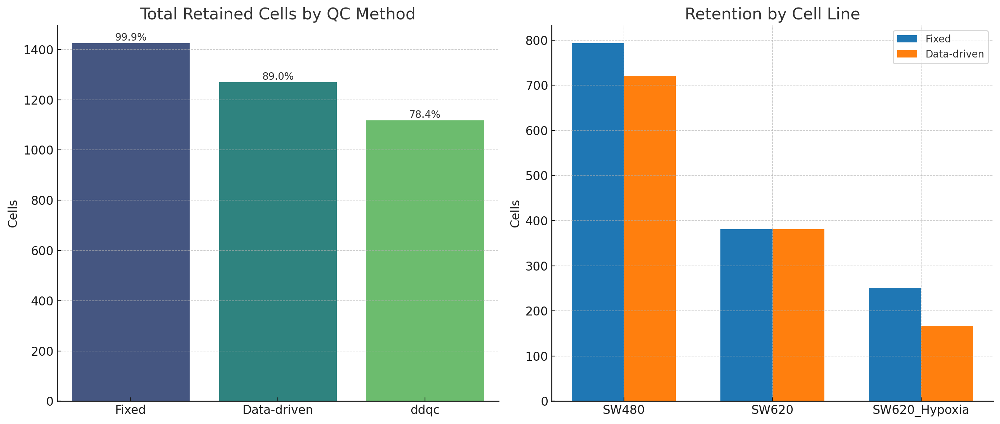

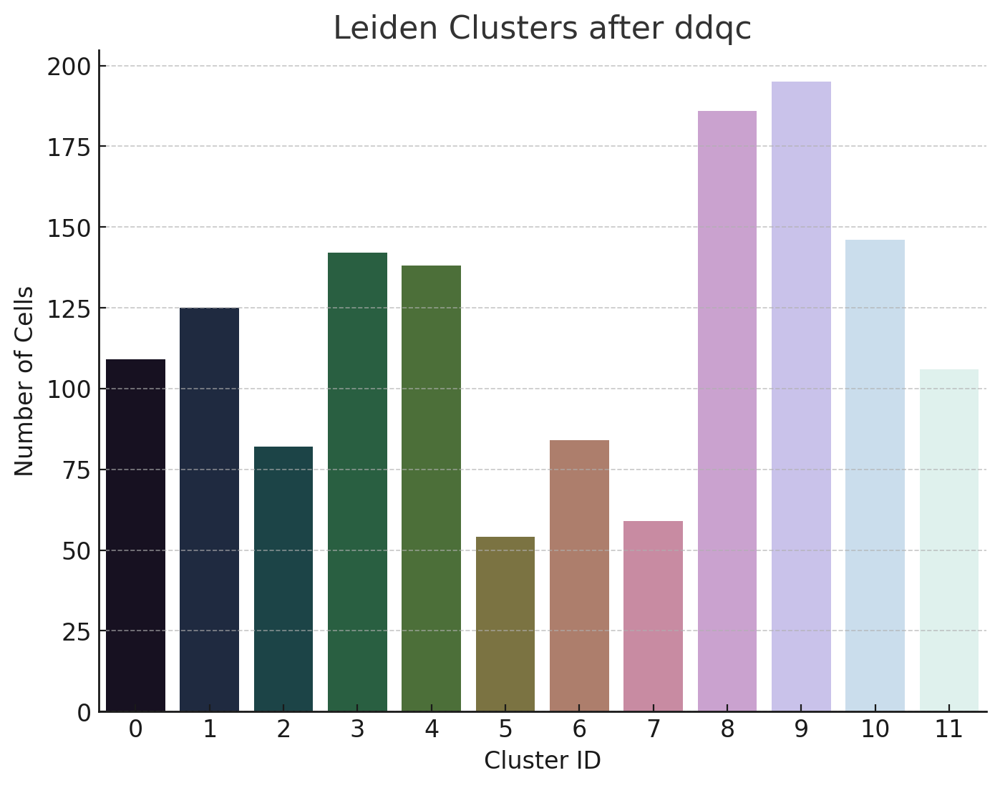

1. QC Thresholds and Filtering

QC percentiles from raw counts show the data distribution:

*   Median genes per cell ≈ 751 (range p5–p95: 529–925).
*   Median counts per cell ≈ 5562 (range p5–p95: 2834–11499).
*   Mitochondrial content (proxy for stress/damage) median ≈ 5.3%, with upper tail reaching ≈ 10.4%.


This suggests relatively healthy cells overall, though some hypoxic or stressed cells (especially in SW620_Hypoxia) likely have elevated mitochondrial percentages.

2. Conventional vs. Data-driven QC

Fixed thresholds were permissive, retaining nearly all cells (99.9%).

Data-driven thresholds (set from dataset percentiles) were stricter, retaining 88.99% overall.

By cell line:

- SW480: 91% retained (tight filtering removed low-quality cells).

- SW620: 100% retained (good quality).

- SW620_Hypoxia: only 66% retained — consistent with hypoxic stress leading to more low-quality cells.

📊 Plot 1 shows total retained cells per method.
📊 Plot 2 shows retention broken down by cell line.

3. Cluster-wise QC (ddqc)

Using cluster-specific MAD thresholds (more adaptive), 78.4% of cells were retained (1118/1426).
This is stricter than data-driven global QC, but it allows finer-grained filtering by local cluster behavior.

Leiden clustering results:

- 12 clusters ranging from ~54 to ~195 cells each.

- Largest clusters: Cluster 9 (195 cells) and Cluster 8 (186 cells).

- Smallest cluster: Cluster 5 (54 cells).

📊 Plot 3 shows the distribution of cluster sizes after ddqc.

4. Interpretation

- SW480 vs. SW620: Both parental lines have high-quality cells with minimal filtering losses.

- SW620_Hypoxia: Substantial drop in retention suggests hypoxic conditions introduce stress-related heterogeneity.

- ddqc clusters: Likely represent functional states (cycling, stressed, hypoxic, etc.). Some small clusters may be rare subpopulations or technical noise.

Preparing UMAPs on ddqc-filtered object …
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished (0:00:00)


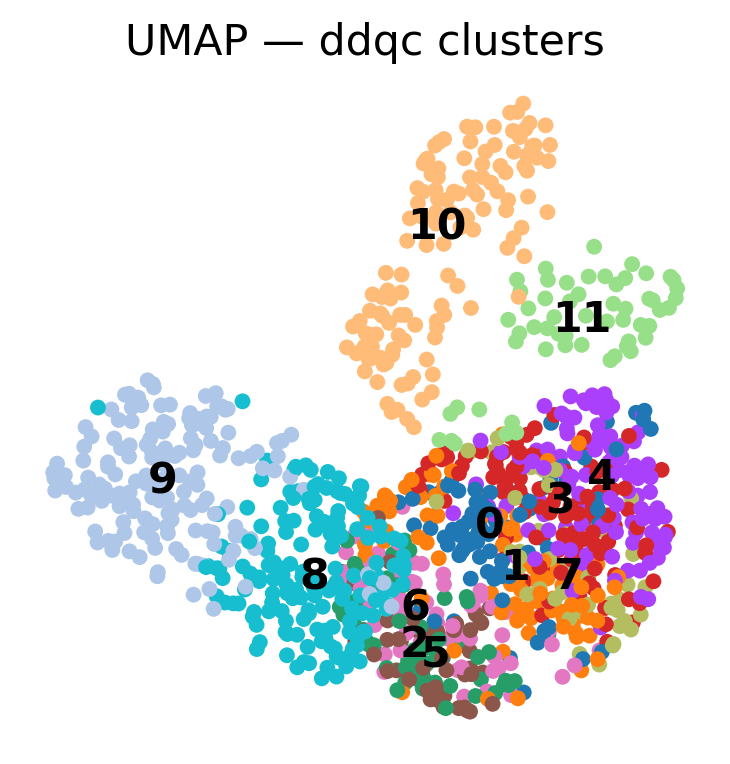

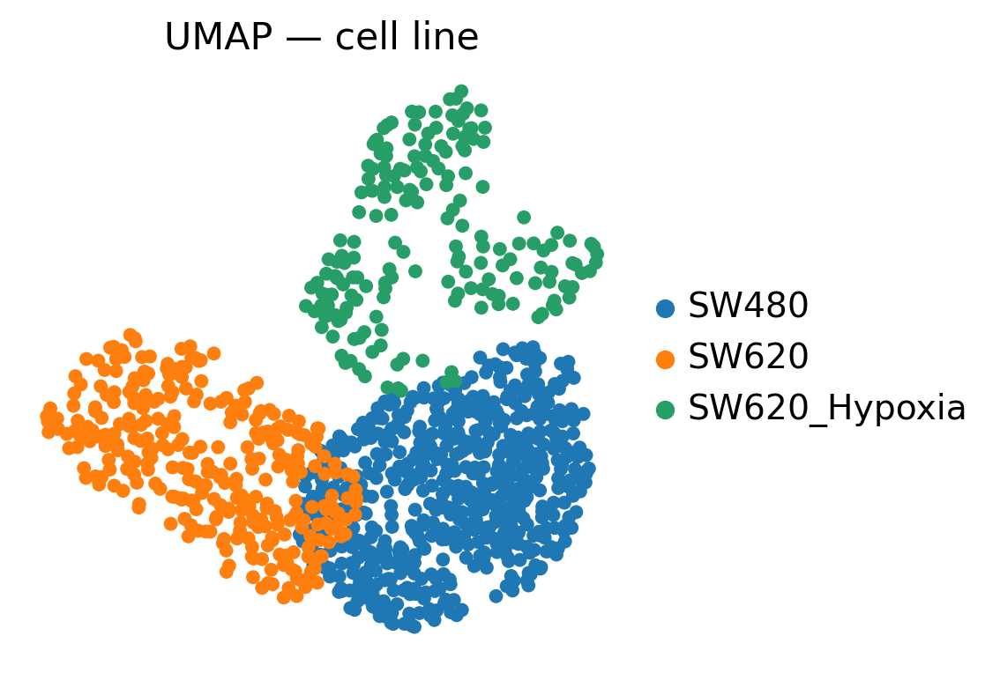

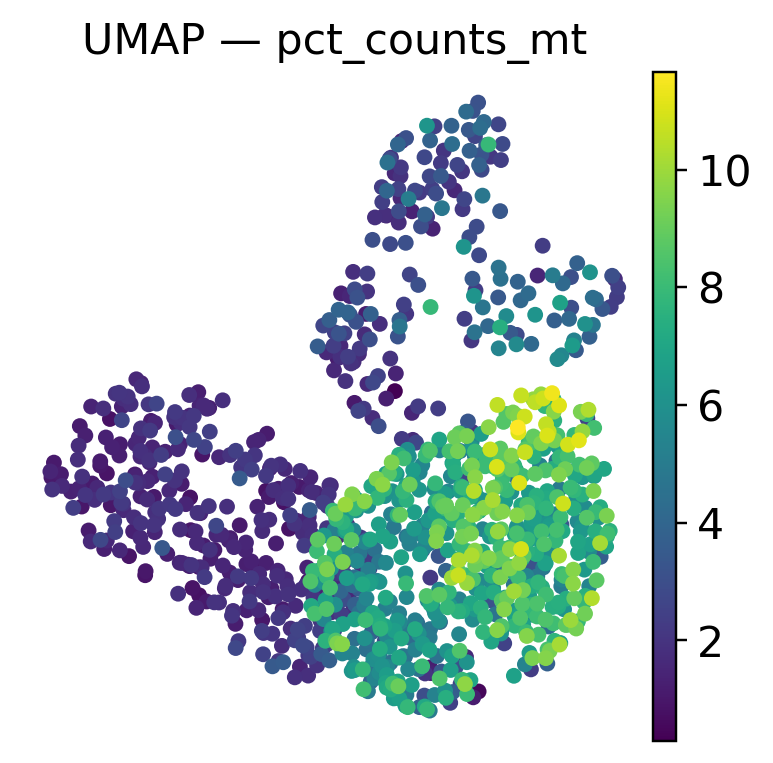

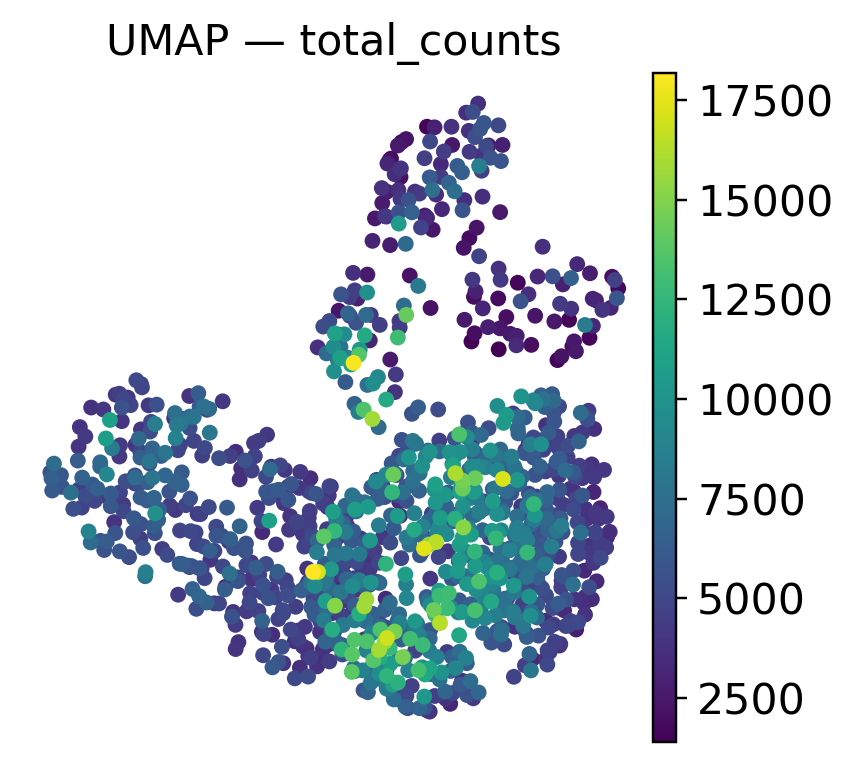

Building cluster composition plot …


/tmp/ipython-input-1620090886.py:76: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  comp = (ad_umap.obs.groupby(["ddqc_clusters","cell_line"]).size()


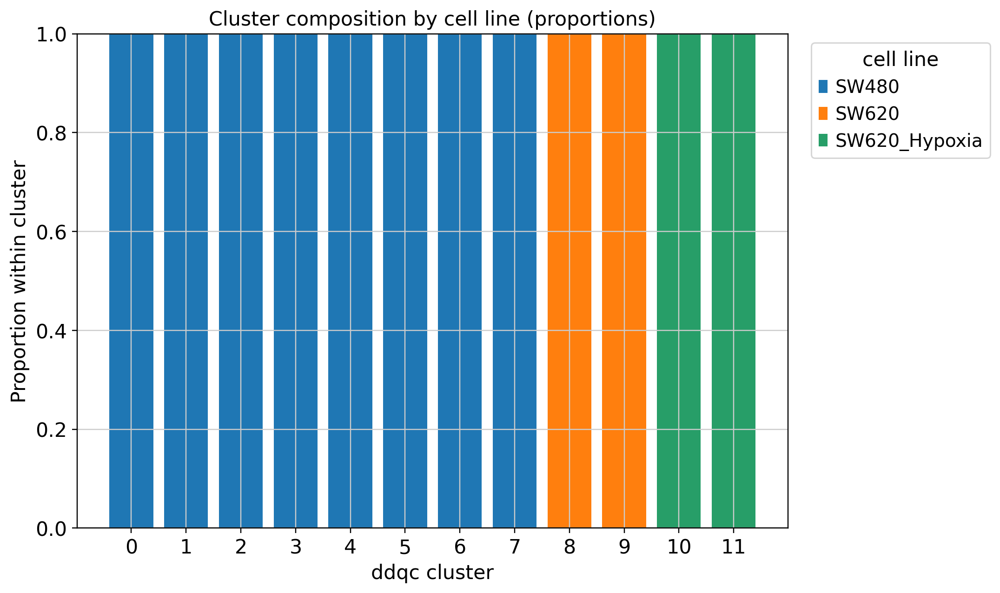

Plotting pre/post QC distributions …


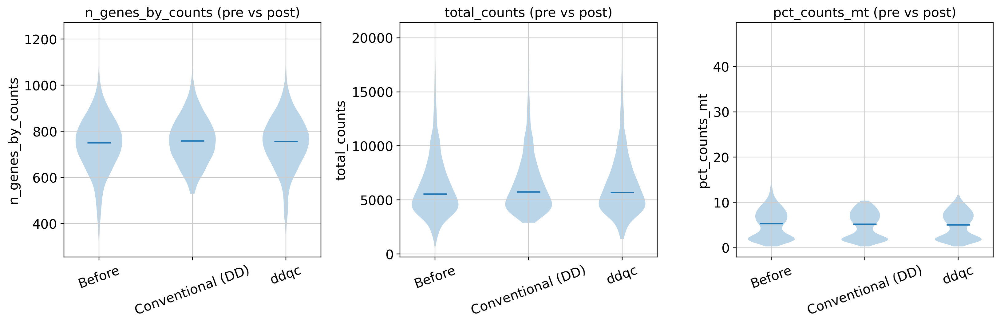

Building retention summary charts …


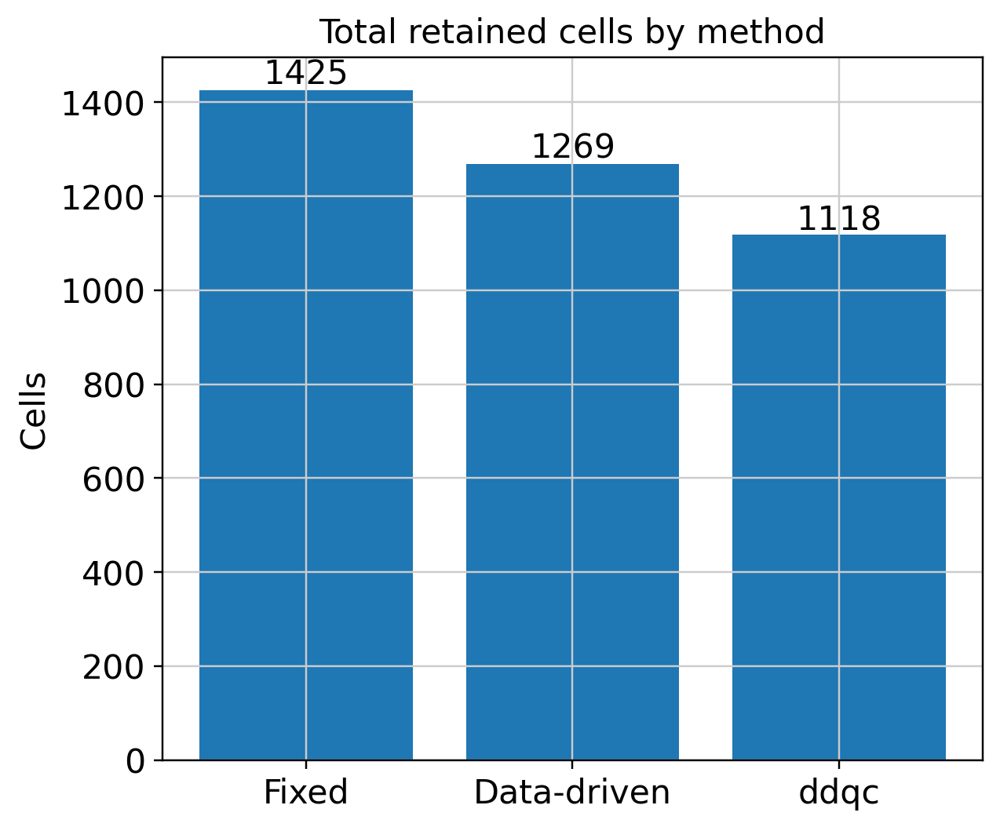

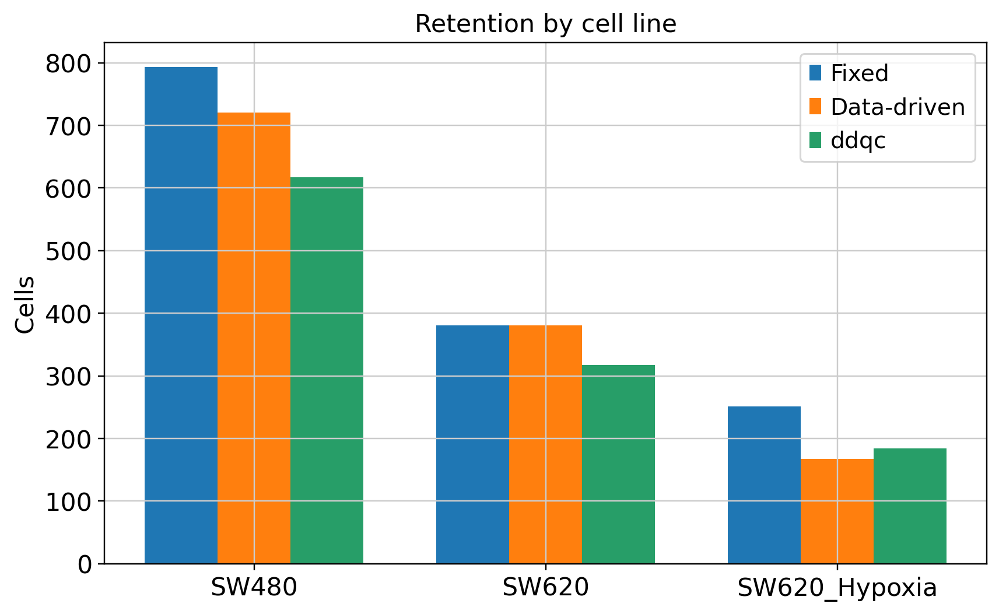

In [ ]:
# ============================================================
# Visualization pack for SW480 / SW620 / SW620_Hypoxia QC + ddqc
# - UMAP (clusters, cell_line, QC metrics)
# - optional t-SNE
# - cluster composition stacked bars
# - pre/post QC violins
# - retention summaries
# ============================================================

import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from scipy import sparse

# ----------------------- CONFIG -----------------------
RUN_TSNE = False  # set True if you also want t-SNE
QC_METRICS = ["n_genes_by_counts", "total_counts", "pct_counts_mt"]
# AnnData objects from your pipeline:
A_COMBINED   = adata              # combined counts-based input (before ddqc)
A_CONV_FIXED = adata_conv_fixed   # conventional fixed thresholds
A_CONV_DD    = adata_conv_dd      # conventional data-driven thresholds
A_DDQC       = adata_ddqc         # ddqc filtered object
# ------------------------------------------------------

def ensure_neighbors_umap(ad, use_rep=None, min_pcs=2):
    """Compute neighbors and UMAP if missing (works on current X or chosen rep)."""
    if "X_pca" not in ad.obsm:
        # PCA on X if needed
        n_comps = int(min(50, max(min_pcs, min(ad.n_vars, ad.n_obs-1))))
        sc.tl.pca(ad, n_comps=n_comps, svd_solver="arpack")
    if "neighbors" not in ad.uns:
        sc.pp.neighbors(ad, use_rep=use_rep, n_pcs=min(ad.obsm["X_pca"].shape[1], 50))
    if "X_umap" not in ad.obsm:
        sc.tl.umap(ad)

def safe_copy_counts_to_X(ad):
    """Make sure .X carries something numeric for plotting; prefer counts layer if present."""
    ad2 = ad.copy()
    if "counts" in ad2.layers:
        # use counts for plotting embeddings if X is not set
        if sparse.issparse(ad2.layers["counts"]):
            ad2.X = ad2.layers["counts"].tocsr(copy=True).astype(np.float32)
        else:
            ad2.X = np.asarray(ad2.layers["counts"], dtype=np.float32)
    return ad2

# ---------------- UMAPs on ddqc result ----------------
print("Preparing UMAPs on ddqc-filtered object …")
ad_umap = safe_copy_counts_to_X(A_DDQC)
# Use PCA/UMAP only if not present:
ensure_neighbors_umap(ad_umap)

# 1) UMAP colored by clusters
sc.pl.umap(ad_umap, color="ddqc_clusters", legend_loc="on data", frameon=False, title="UMAP — ddqc clusters")

# 2) UMAP colored by cell line
if "cell_line" in ad_umap.obs:
    sc.pl.umap(ad_umap, color="cell_line", frameon=False, title="UMAP — cell line")

# 3) UMAP colored by QC metrics
for c in ["pct_counts_mt", "total_counts"]:
    if c in ad_umap.obs:
        sc.pl.umap(ad_umap, color=c, frameon=False, title=f"UMAP — {c}")

# ---------------- Optional t-SNE ----------------
if RUN_TSNE:
    print("Computing t-SNE on ddqc-filtered object …")
    # re-use the PCA neighbors if available
    sc.tl.tsne(ad_umap, n_pcs=min(50, ad_umap.obsm["X_pca"].shape[1]))
    sc.pl.tsne(ad_umap, color=["ddqc_clusters","cell_line"], frameon=False, ncols=2, title=["t-SNE — clusters","t-SNE — cell line"])

# ---------------- Cluster composition (stacked bars) ----------------
print("Building cluster composition plot …")
if "ddqc_clusters" in ad_umap.obs and "cell_line" in ad_umap.obs:
    comp = (ad_umap.obs.groupby(["ddqc_clusters","cell_line"]).size()
            .unstack(fill_value=0).sort_index())
    comp_prop = comp.div(comp.sum(axis=1), axis=0)

    fig, ax = plt.subplots(figsize=(10,6))
    bottom = np.zeros(comp_prop.shape[0])
    for col in comp_prop.columns:
        ax.bar(comp_prop.index.astype(str), comp_prop[col].values, bottom=bottom, label=col)
        bottom += comp_prop[col].values
    ax.set_ylabel("Proportion within cluster")
    ax.set_xlabel("ddqc cluster")
    ax.set_title("Cluster composition by cell line (proportions)")
    ax.legend(title="cell line", bbox_to_anchor=(1.02, 1), loc="upper left")
    plt.tight_layout()
    plt.show()

# ---------------- Pre vs Post QC violins ----------------
print("Plotting pre/post QC distributions …")
def collect_for_violin():
    frames = []
    if all(k in A_COMBINED.obs for k in QC_METRICS):
        df0 = A_COMBINED.obs[QC_METRICS].copy()
        df0["qc_method"] = "Before"
        frames.append(df0)
    if all(k in A_CONV_DD.obs for k in QC_METRICS):
        df1 = A_CONV_DD.obs[QC_METRICS].copy()
        df1["qc_method"] = "Conventional (DD)"
        frames.append(df1)
    if all(k in A_DDQC.obs for k in QC_METRICS):
        df2 = A_DDQC.obs[QC_METRICS].copy()
        df2["qc_method"] = "ddqc"
        frames.append(df2)
    return pd.concat(frames, axis=0, ignore_index=True) if frames else None

violin_df = collect_for_violin()
if violin_df is not None and not violin_df.empty:
    # Matplotlib-only violins (no seaborn requirement)
    metrics = QC_METRICS
    groups = list(violin_df["qc_method"].unique())
    fig, axes = plt.subplots(1, len(metrics), figsize=(5*len(metrics),5), squeeze=False)
    axes = axes[0]
    for i, metric in enumerate(metrics):
        data = [violin_df.loc[violin_df["qc_method"]==g, metric].dropna().values for g in groups]
        parts = axes[i].violinplot(data, showmeans=False, showmedians=True, showextrema=False)
        axes[i].set_title(metric + " (pre vs post)")
        axes[i].set_xticks(range(1, len(groups)+1))
        axes[i].set_xticklabels(groups, rotation=20)
        axes[i].set_ylabel(metric)
    plt.tight_layout()
    plt.show()
else:
    print("Skipping violins: missing QC metrics in one or more objects.")

# ---------------- Retention summaries ----------------
print("Building retention summary charts …")

def retained_counts(obj, label):
    return pd.Series({"method":label, "retained": obj.n_obs})

summ = pd.concat([
    retained_counts(A_CONV_FIXED, "Fixed"),
    retained_counts(A_CONV_DD,    "Data-driven"),
    retained_counts(A_DDQC,       "ddqc")
], axis=1).T

fig, ax = plt.subplots(figsize=(6,5))
ax.bar(summ["method"], summ["retained"])
for i, v in enumerate(summ["retained"].values):
    ax.text(i, v + max(10, v*0.01), f"{v}", ha="center")
ax.set_title("Total retained cells by method")
ax.set_ylabel("Cells")
plt.tight_layout(); plt.show()

# Retention by cell line
def per_line(obj, name):
    if "cell_line" not in obj.obs:
        return None
    s = obj.obs["cell_line"].value_counts().sort_index()
    return pd.DataFrame({"method":name, "cell_line":s.index, "retained":s.values})

pl = [per_line(A_CONV_FIXED, "Fixed"), per_line(A_CONV_DD, "Data-driven"), per_line(A_DDQC, "ddqc")]
pl = [x for x in pl if x is not None]
if pl:
    perline = pd.concat(pl, ignore_index=True)
    lines = perline["cell_line"].unique().tolist()
    fig, ax = plt.subplots(figsize=(8,5))
    width = 0.25
    xlocs = np.arange(len(lines))
    for j, m in enumerate(["Fixed","Data-driven","ddqc"]):
        y = perline.loc[perline["method"]==m].set_index("cell_line").reindex(lines)["retained"].fillna(0).values
        ax.bar(xlocs + j*width - width, y, width, label=m)
    ax.set_xticks(xlocs)
    ax.set_xticklabels(lines, rotation=0)
    ax.set_title("Retention by cell line")
    ax.set_ylabel("Cells")
    ax.legend()
    plt.tight_layout(); plt.show()
else:
    print("Skipping per-line retention: missing cell_line in objects.")


# NEW

In [ ]:
!pip install -q igraph leidenalg louvain

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 26.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.4/4.4 MB 65.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 52.1 MB/s eta 0:00:00


--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

Loading data for SW620 and SW480...
✅ Data loaded and combined. Total cells: 1174

--- Performing initial light filtering (Pre-QC) ---
Filtered out 7 cells with < 100 genes or > 80% mito.


/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)


Filtered out 0 genes expressed in < 3 cells.
Shape after pre-filtering: (1167, 579)

--- Visualizing Pre-QC Metrics ---


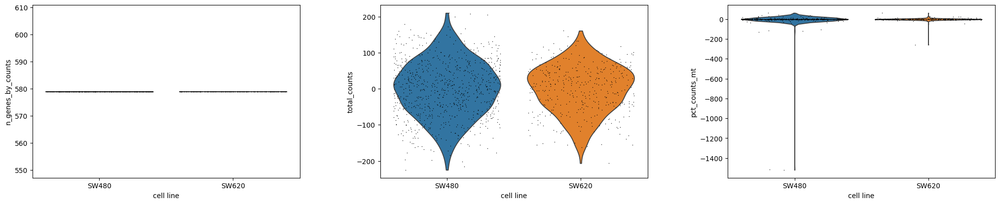


      Part 2: Applying Conventional (Fixed-Threshold) QC
Applying fixed thresholds: min_genes=250, max_mito=20.0%
✅ Conventional QC complete. Cells retained: 1148

      Part 3: Applying Data-Driven QC (ddqc)
Finding highly variable genes...
Running PCA and clustering to find cell groups...


/usr/local/lib/python3.12/dist-packages/scanpy/preprocessing/_scale.py:309: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Cluster sizes:
 ddqc_clusters
0     199
1     160
2     154
3     151
4     123
5     107
6     100
7      61
8      52
9      31
10     19
11     10
Name: count, dtype: int64
Calculating adaptive thresholds for each cluster...
✅ ddqc complete. Cells retained: 870

      Part 4: Evaluating QC Performance
--- 1. Total Cells Retained ---
Conventional QC: 1148 cells (98.37%)
Data-Driven QC (ddqc): 870 cells (74.55%)

--- 2. Retention Rate by Cell Line ---
SW480:
  - Conventional QC kept 777/790 (98.35%)
  - ddqc kept 592/790 (74.94%)
SW620:
  - Conventional QC kept 371/377 (98.41%)
  - ddqc kept 278/377 (73.74%)

--- 3. Visualizing Post-QC Distributions ---


/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/tmp/ipython-input-2213078545.py:181: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_conv.obs['qc_method'] = 'Conventional'


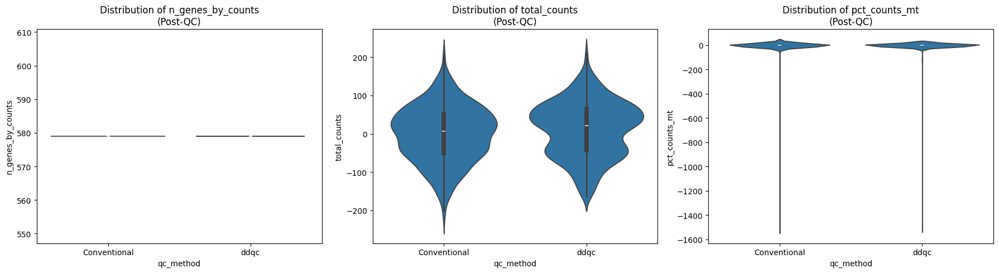


--- 4. Clusters Lost by Conventional QC ---
Number of cells passing conventional QC in each ddqc cluster:
pass_conv      False  True 
ddqc_clusters              
0                  3    196
1                  1    159
2                  5    149
3                  6    145
4                  1    122
5                  1    106
6                  1     99
7                  0     61
8                  0     52
9                  1     30
10                 0     19
11                 0     10


In [ ]:
# ==============================================================================
# Part 1: Setup and Data Preparation
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths to the data files
sw620_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad"
sw480_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW480.h5ad"

try:
    print("\nLoading data for SW620 and SW480...")
    adata_sw620 = sc.read_h5ad(sw620_path)
    adata_sw480 = sc.read_h5ad(sw480_path)

    # Add a 'cell_line' column to each object before combining
    adata_sw620.obs['cell_line'] = 'SW620'
    adata_sw480.obs['cell_line'] = 'SW480'

    # Combine into a single AnnData object
    adata = sc.concat([adata_sw620, adata_sw480])
    print(f"✅ Data loaded and combined. Total cells: {adata.n_obs}")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to load data files. Please check paths. Error: {e}")

# --- Initial Filtering (Pre-QC) ---
print("\n--- Performing initial light filtering (Pre-QC) ---")
# 1. Calculate initial QC metrics
adata.var['mt'] = adata.var_names.str.startswith('MT-')
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, inplace=True)

# 2. Filter out obvious junk cells
cells_before = adata.n_obs
adata = adata[(adata.obs['n_genes_by_counts'] >= 100) & (adata.obs['pct_counts_mt'] <= 80)].copy()
print(f"Filtered out {cells_before - adata.n_obs} cells with < 100 genes or > 80% mito.")

# 3. Filter out uninformative genes
genes_before = adata.n_vars
sc.pp.filter_genes(adata, min_cells=3)
print(f"Filtered out {genes_before - adata.n_vars} genes expressed in < 3 cells.")
print(f"Shape after pre-filtering: {adata.shape}")

# --- Visualize Initial QC Metrics ---
print("\n--- Visualizing Pre-QC Metrics ---")
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             groupby='cell_line', jitter=0.4, multi_panel=True)


# ==============================================================================
# Part 2: Conventional QC Filtering Implementation
# ==============================================================================
print("\n" + "="*60)
print("      Part 2: Applying Conventional (Fixed-Threshold) QC")
print("="*60)

# Create a copy of the data to apply conventional filters to
adata_conv = adata.copy()

# Apply fixed thresholds as described in the guide
min_genes = 250
max_mito = 20.0
max_genes_doublet = 5000

# NOTE: The min_counts (UMI) filter is omitted because the input data is already
# log-normalized. The 'total_counts' metric here does not represent raw UMI counts,
# and applying a fixed threshold like 700 would incorrectly remove all cells.
print(f"Applying fixed thresholds: min_genes={min_genes}, max_mito={max_mito}%")

# Filter cells based on the thresholds
adata_conv = adata_conv[adata_conv.obs['n_genes_by_counts'] >= min_genes, :]
adata_conv = adata_conv[adata_conv.obs['pct_counts_mt'] <= max_mito, :]
adata_conv = adata_conv[adata_conv.obs['n_genes_by_counts'] <= max_genes_doublet, :]

print(f"✅ Conventional QC complete. Cells retained: {adata_conv.n_obs}")


# ==============================================================================
# Part 3: Data-Driven QC (ddqc) Implementation
# ==============================================================================
print("\n" + "="*60)
print("      Part 3: Applying Data-Driven QC (ddqc)")
print("="*60)

# Create a fresh copy for the ddqc process
adata_ddqc_base = adata.copy()

# --- 1. HVG selection and Scaling (Normalization is skipped as data is pre-processed) ---
print("Finding highly variable genes...")
# The input data is already log-normalized, so we can proceed directly.
sc.pp.highly_variable_genes(adata_ddqc_base, n_top_genes=2000)
adata_ddqc_base = adata_ddqc_base[:, adata_ddqc_base.var.highly_variable]
sc.pp.scale(adata_ddqc_base, max_value=10)

# --- 2. PCA and Clustering ---
print("Running PCA and clustering to find cell groups...")
sc.tl.pca(adata_ddqc_base, n_comps=50)
sc.pp.neighbors(adata_ddqc_base, n_neighbors=20, n_pcs=50)
sc.tl.leiden(adata_ddqc_base, resolution=1.4, key_added='ddqc_clusters')
print("Cluster sizes:\n", adata_ddqc_base.obs['ddqc_clusters'].value_counts())

# Add the cluster labels back to the original object (with all genes)
adata.obs['ddqc_clusters'] = adata_ddqc_base.obs['ddqc_clusters']

# --- 3. Compute Cluster-Specific QC Cutoffs ---
print("Calculating adaptive thresholds for each cluster...")
# Calculate ribosomal percentage, as it's the 4th metric in ddqc
adata.var['ribo'] = adata.var_names.str.startswith(('RPS','RPL'))
sc.pp.calculate_qc_metrics(adata, qc_vars=['ribo'], inplace=True)

clusters = adata.obs['ddqc_clusters'].cat.categories
mad_multiplier = 2.0
pass_mask = pd.Series(True, index=adata.obs_names)

for c in clusters:
    cluster_mask = (adata.obs['ddqc_clusters'] == c)

    # Gene counts (lower bound)
    med_genes = adata.obs.loc[cluster_mask, 'n_genes_by_counts'].median()
    mad_genes = (adata.obs.loc[cluster_mask, 'n_genes_by_counts'] - med_genes).abs().median()
    gene_lower = med_genes - mad_multiplier * mad_genes
    if gene_lower > 200: gene_lower = 200 # Safeguard
    pass_mask[cluster_mask & (adata.obs['n_genes_by_counts'] < gene_lower)] = False

    # UMI counts (lower bound) - Note: on log-normalized data, this is less meaningful but kept for consistency
    med_umis = adata.obs.loc[cluster_mask, 'total_counts'].median()
    mad_umis = (adata.obs.loc[cluster_mask, 'total_counts'] - med_umis).abs().median()
    umi_lower = med_umis - mad_multiplier * mad_umis
    pass_mask[cluster_mask & (adata.obs['total_counts'] < umi_lower)] = False

    # Mito percent (upper bound)
    med_mito = adata.obs.loc[cluster_mask, 'pct_counts_mt'].median()
    mad_mito = (adata.obs.loc[cluster_mask, 'pct_counts_mt'] - med_mito).abs().median()
    mito_upper = med_mito + mad_multiplier * mad_mito
    if mito_upper < 10.0: mito_upper = 10.0 # Safeguard
    pass_mask[cluster_mask & (adata.obs['pct_counts_mt'] > mito_upper)] = False

    # Ribo percent (upper bound)
    med_ribo = adata.obs.loc[cluster_mask, 'pct_counts_ribo'].median()
    mad_ribo = (adata.obs.loc[cluster_mask, 'pct_counts_ribo'] - med_ribo).abs().median()
    ribo_upper = med_ribo + mad_multiplier * mad_ribo
    pass_mask[cluster_mask & (adata.obs['pct_counts_ribo'] > ribo_upper)] = False

# Create the final filtered AnnData object
adata_ddqc = adata[pass_mask].copy()
print(f"✅ ddqc complete. Cells retained: {adata_ddqc.n_obs}")


# ==============================================================================
# Part 4: Evaluating ddqc vs. Conventional QC Performance
# ==============================================================================
print("\n" + "="*60)
print("      Part 4: Evaluating QC Performance")
print("="*60)

# --- 1. Compare total cells retained ---
print("--- 1. Total Cells Retained ---")
print(f"Conventional QC: {adata_conv.n_obs} cells ({adata_conv.n_obs / adata.n_obs:.2%})")
print(f"Data-Driven QC (ddqc): {adata_ddqc.n_obs} cells ({adata_ddqc.n_obs / adata.n_obs:.2%})")

# --- 2. Compare retention bias by cell line ---
print("\n--- 2. Retention Rate by Cell Line ---")
for line in ['SW480', 'SW620']:
    total = (adata.obs['cell_line'] == line).sum()
    kept_conv = (adata_conv.obs['cell_line'] == line).sum()
    kept_ddqc = (adata_ddqc.obs['cell_line'] == line).sum()
    print(f"{line}:")
    print(f"  - Conventional QC kept {kept_conv}/{total} ({kept_conv/total:.2%})")
    print(f"  - ddqc kept {kept_ddqc}/{total} ({kept_ddqc/total:.2%})")

# --- 3. Visualize post-filtering distributions ---
print("\n--- 3. Visualizing Post-QC Distributions ---")
adata_conv.obs['qc_method'] = 'Conventional'
adata_ddqc.obs['qc_method'] = 'ddqc'
combined_final_obs = pd.concat([adata_conv.obs, adata_ddqc.obs])

fig, axes = plt.subplots(1, 3, figsize=(18, 5))
metrics_to_plot = ['n_genes_by_counts', 'total_counts', 'pct_counts_mt']
for i, metric in enumerate(metrics_to_plot):
    sns.violinplot(data=combined_final_obs, x='qc_method', y=metric, ax=axes[i])
    axes[i].set_title(f'Distribution of {metric}\n(Post-QC)')
plt.tight_layout()
plt.show()

# --- 4. Identify clusters lost by conventional QC ---
print("\n--- 4. Clusters Lost by Conventional QC ---")
adata.obs['pass_conv'] = adata.obs_names.isin(adata_conv.obs_names)
lost_clusters = pd.crosstab(adata.obs['ddqc_clusters'], adata.obs['pass_conv'])
print("Number of cells passing conventional QC in each ddqc cluster:")
print(lost_clusters)

In [ ]:
# ==============================================================================
# Part 1: Setup and Data Loading
# ==============================================================================
import os
import pandas as pd
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
from google.colab import drive

print("--- Step 1: Mounting Google Drive and Defining Paths ---")
drive.mount('/content/drive', force_remount=True)

# Define paths to the data files
sw620_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad"
sw480_path = "/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW480.h5ad"

# ==============================================================================
# Part 2: Download and Prepare the PanglaoDB Marker Database
# ==============================================================================
print("\n--- Step 2: Downloading and Preparing PanglaoDB Marker Database ---")

# URL for the PanglaoDB marker gene file
panglao_url = "https://panglaodb.se/markers/PanglaoDB_markers_27_Mar_2020.tsv.gz"

try:
    # Read the gzipped TSV file directly into a pandas DataFrame
    panglao_df = pd.read_csv(panglao_url, sep='\t', compression='gzip')

    # We are interested in human markers
    human_markers_df = panglao_df[panglao_df['species'] == 'Hs']

    # Create a more convenient structure: a dictionary where keys are cell types
    # and values are the list of official gene symbols for that cell type.
    cell_type_markers = human_markers_df.groupby('cell type')['official gene symbol'].apply(list).to_dict()

    print(f"✅ Successfully downloaded and processed PanglaoDB. Found markers for {len(cell_type_markers)} human cell types.")

except Exception as e:
    raise RuntimeError(f"❌ ERROR: Failed to download or process PanglaoDB. Error: {e}")


# # ==============================================================================
# # Part 3: Define the Annotation Function
# # ==============================================================================

# def annotate_clusters(adata: sc.AnnData, cell_line_name: str):
#     """
#     Performs automated cell-type annotation on a clustered AnnData object.
#     """
#     print("\n" + "="*60)
#     print(f"      Running Annotation for: {cell_line_name}")
#     print("="*60)

#     # --- 1. Find Marker Genes ---
#     print("Finding marker genes for each cluster...")
#     sc.tl.rank_genes_groups(adata, 'louvain', method='wilcoxon')

#     # --- 2. Check available keys in adata.uns for rank_genes_groups results ---
#     print(adata.uns.keys())  # This will print the available keys in adata.uns to check if 'rank_genes_groups' exists

#     # Accessing results for a specific cluster (if it exists)
#     de_results = sc.get.rank_genes_groups_df(adata, group='0')  # Replace '0' with the actual cluster of interest
#     print(de_results.columns)  # Check the columns available in the rank genes results

#     # --- 3. Loop through clusters and assign scores ---
#     print("Scoring cell types for each cluster...")
#     cluster_annotations = {}

#     for cluster in adata.obs['louvain'].cat.categories:
#         # Get the marker gene table for the current cluster
#         de_results = sc.get.rank_genes_groups_df(adata, group=cluster)

#         # --- FIX: Use the correct column name for percent expressed ---
#         # Use 'pct_nz_group' instead of 'pct_dropout_by_group'
#         filtered_degs = de_results[
#             (de_results['pvals_adj'] < 0.05) &  # Only consider significant genes
#             (de_results['logfoldchanges'] > 0.25)  # Minimum log fold change
#         ]

#         # --- Check available columns for filtering ---
#         if 'pct_nz_group' in de_results.columns:
#             filtered_degs = filtered_degs[filtered_degs['pct_nz_group'] > 0.25]  # Corrected column name
#         elif 'mean_group' in de_results.columns:
#             filtered_degs = filtered_degs[filtered_degs['mean_group'] > 0.25]  # Fallback

#         # Create a dictionary of marker genes and their log-fold-change scores
#         cluster_marker_scores = dict(zip(filtered_degs['names'], filtered_degs['logfoldchanges']))

#         best_cell_type = "Unknown"
#         best_score = 0

#         # --- 4. Compare to PanglaoDB and score ---
#         for cell_type, markers in cell_type_markers.items():
#             # Find the intersection between our markers and the database markers
#             matching_markers = set(cluster_marker_scores.keys()).intersection(markers)

#             # Only consider cell types with at least 3 matching genes
#             if len(matching_markers) >= 3:
#                 # The score is the sum of the log-fold-changes of the matching genes
#                 current_score = sum(cluster_marker_scores[gene] for gene in matching_markers)

#                 if current_score > best_score:
#                     best_score = current_score
#                     best_cell_type = cell_type

#         cluster_annotations[cluster] = best_cell_type

#     # --- 5. Add the new annotations to the AnnData object ---
#     adata.obs['cell_type_annotation'] = adata.obs['louvain'].map(cluster_annotations)

#     print("\n--- Annotation Summary ---")
#     print(adata.obs[['louvain', 'cell_type_annotation']].drop_duplicates().sort_values('louvain'))

#     return adata


# # ==============================================================================
# # Part 4: Run the Annotation and Visualize
# # ==============================================================================
# print("\n--- Step 4: Running the Full Pipeline ---")

# # Load the data
# adata_sw620 = sc.read_h5ad(sw620_path)
# adata_sw480 = sc.read_h5ad(sw480_path)

# # Run the annotation pipeline on each dataset
# adata_sw620_annotated = annotate_clusters(adata_sw620, "SW620")
# adata_sw480_annotated = annotate_clusters(adata_sw480, "SW480")

# # --- Generate Final UMAP Plots with New Labels ---
# print("\n\n--- Step 5: Generating Final Visualizations ---")
# sc.pl.umap(adata_sw620_annotated, color='cell_type_annotation', title='SW620 Annotated Cell Types')
# sc.pl.umap(adata_sw480_annotated, color='cell_type_annotation', title='SW480 Annotated Cell Types')


--- Step 1: Mounting Google Drive and Defining Paths ---
Mounted at /content/drive

--- Step 2: Downloading and Preparing PanglaoDB Marker Database ---
✅ Successfully downloaded and processed PanglaoDB. Found markers for 78 human cell types.


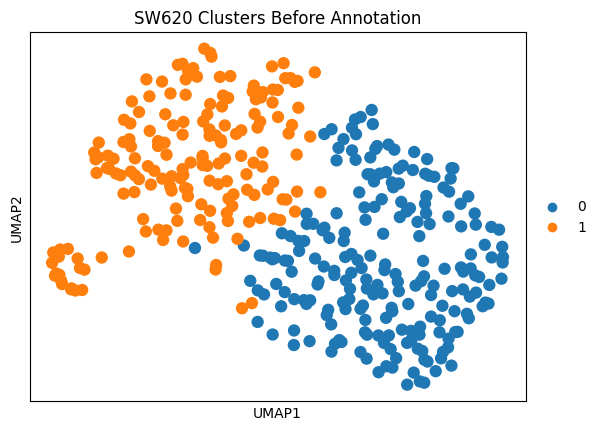

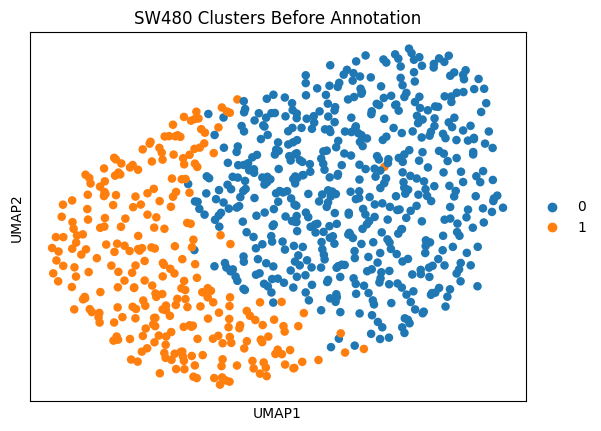

In [ ]:
# Visualize the clusters before annotation (UMAP plot)
sc.pl.umap(adata_sw620, color='louvain', title='SW620 Clusters Before Annotation')
sc.pl.umap(adata_sw480, color='louvain', title='SW480 Clusters Before Annotation')



--- Applying Biology-Inspired Data-Driven QC (ddqc) ---
Calculated mitochondrial percentage (`pct_counts_mt`).
✅ ddqc complete. Cells retained: 332

--- Applying Biology-Inspired Data-Driven QC (ddqc) ---
Calculated mitochondrial percentage (`pct_counts_mt`).
✅ ddqc complete. Cells retained: 658

--- Applying Additional QC Filters ---
Filtered out cells with > 20.0% mitochondrial RNA. Cells retained: 332
Filtered out cells with < 200 genes. Cells retained: 332

--- Applying Additional QC Filters ---
Filtered out cells with > 20.0% mitochondrial RNA. Cells retained: 658
Filtered out cells with < 200 genes. Cells retained: 658

--- Visualizing Post-QC Data ---


/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result = getattr(ufunc, method)(*inputs, **kwargs)
/usr/local/lib/python3.12/dist-packages/pandas/core/arraylike.py:399: RuntimeWarning: invalid value encountered in log1p
  result 

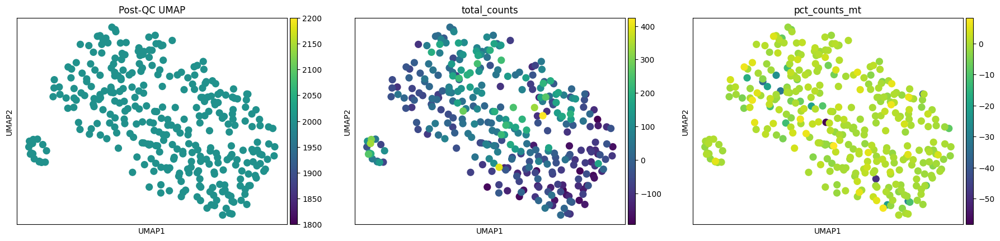


--- Visualizing Post-QC Data ---


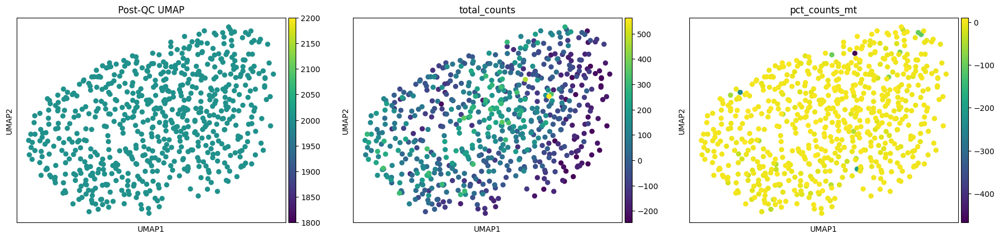

In [ ]:
# ==============================================================================
# Part 1: Biology-Inspired Data-Driven QC (ddqc) with Mitochondrial Calculation
# ==============================================================================
import scanpy as sc
import pandas as pd
import numpy as np

def biology_inspired_ddqc(adata: sc.AnnData, mad_multiplier=2.0):
    """
    Apply data-driven quality control based on biological variability.
    """
    print("\n--- Applying Biology-Inspired Data-Driven QC (ddqc) ---")

    # 1. Calculate mitochondrial percentage
    adata.var['mt'] = adata.var_names.str.startswith('MT-')  # Identify mitochondrial genes
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, inplace=True)  # Calculate % mito
    print("Calculated mitochondrial percentage (`pct_counts_mt`).")

    # 2. Cluster-specific QC
    clusters = adata.obs['louvain'].cat.categories
    pass_mask = pd.Series(True, index=adata.obs_names)

    for c in clusters:
        cluster_mask = (adata.obs['louvain'] == c)

        # Mitochondrial content: Adjust upper bound threshold based on MAD
        med_mito = adata.obs.loc[cluster_mask, 'pct_counts_mt'].median()
        mad_mito = (adata.obs.loc[cluster_mask, 'pct_counts_mt'] - med_mito).abs().median()
        mito_upper = med_mito + mad_multiplier * mad_mito
        if mito_upper < 10.0: mito_upper = 10.0  # Safeguard
        pass_mask[cluster_mask & (adata.obs['pct_counts_mt'] > mito_upper)] = False

        # Gene complexity (number of genes): Adjust lower bound threshold based on MAD
        med_genes = adata.obs.loc[cluster_mask, 'n_genes_by_counts'].median()
        mad_genes = (adata.obs.loc[cluster_mask, 'n_genes_by_counts'] - med_genes).abs().median()
        gene_lower = med_genes - mad_multiplier * mad_genes
        if gene_lower > 200: gene_lower = 200  # Safeguard
        pass_mask[cluster_mask & (adata.obs['n_genes_by_counts'] < gene_lower)] = False

        # UMI counts (total counts): Adjust lower bound threshold based on MAD
        med_umis = adata.obs.loc[cluster_mask, 'total_counts'].median()
        mad_umis = (adata.obs.loc[cluster_mask, 'total_counts'] - med_umis).abs().median()
        umi_lower = med_umis - mad_multiplier * mad_umis
        pass_mask[cluster_mask & (adata.obs['total_counts'] < umi_lower)] = False

    # Apply the final filtering mask
    adata_ddqc = adata[pass_mask].copy()
    print(f"✅ ddqc complete. Cells retained: {adata_ddqc.n_obs}")
    return adata_ddqc

# ==============================================================================
# Part 2: Apply Additional QC Filters (Mitochondrial, Ribosomal Content, etc.)
# ==============================================================================
def apply_additional_qc_filters(adata: sc.AnnData):
    """
    Apply standard QC filters such as mitochondrial percentage, ribosomal content,
    and total counts threshold.
    """
    print("\n--- Applying Additional QC Filters ---")

    # Filter cells with mitochondrial percentage > 20%
    mito_thresh = 20.0
    adata = adata[adata.obs['pct_counts_mt'] <= mito_thresh].copy()
    print(f"Filtered out cells with > {mito_thresh}% mitochondrial RNA. Cells retained: {adata.n_obs}")

    # Filter out cells with low total counts or genes (e.g., < 200 genes)
    adata = adata[adata.obs['n_genes_by_counts'] >= 200].copy()
    print(f"Filtered out cells with < 200 genes. Cells retained: {adata.n_obs}")

    return adata

# ==============================================================================
# Part 3: Visualize Post-QC Data
# ==============================================================================
def visualize_qc(adata: sc.AnnData):
    """
    Visualize the distribution of QC metrics post filtering using UMAP.
    """
    print("\n--- Visualizing Post-QC Data ---")

    # UMAP visualization
    sc.pl.umap(adata, color=['n_genes_by_counts', 'total_counts', 'pct_counts_mt'], title='Post-QC UMAP')

# ==============================================================================
# Part 4: Running the Full QC Pipeline on Data
# ==============================================================================

# Load data for SW620 and SW480
adata_sw620 = sc.read_h5ad(sw620_path)
adata_sw480 = sc.read_h5ad(sw480_path)

# Apply biology-inspired ddqc filtering
adata_sw620_ddqc = biology_inspired_ddqc(adata_sw620)
adata_sw480_ddqc = biology_inspired_ddqc(adata_sw480)

# Apply additional QC filters
adata_sw620_filtered = apply_additional_qc_filters(adata_sw620_ddqc)
adata_sw480_filtered = apply_additional_qc_filters(adata_sw480_ddqc)

# Visualize the post-QC data
visualize_qc(adata_sw620_filtered)
visualize_qc(adata_sw480_filtered)


# After ddqc and additional filtering, the number of cells retained for SW620 is 332 and for SW480 is 658.

/usr/lib/python3.12/functools.py:912: ImplicitModificationWarning: Transforming to str index.
  return dispatch(args[0].__class__)(*args, **kw)
/usr/lib/python3.12/functools.py:912: ImplicitModificationWarning: Transforming to str index.
  return dispatch(args[0].__class__)(*args, **kw)


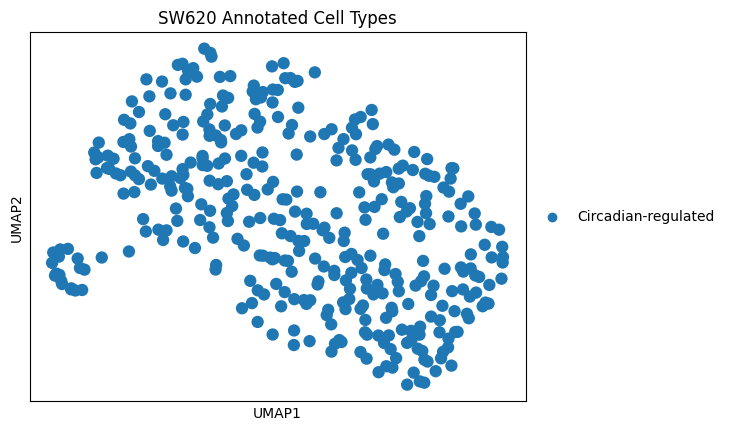

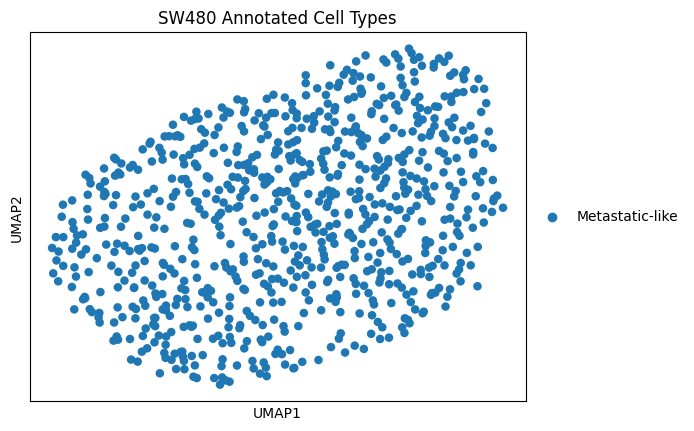

In [ ]:
# Ensure the data is loaded
adata_sw620 = sc.read_h5ad('/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad')  # Path to your SW620 dataset
adata_sw480 = sc.read_h5ad('/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW480.h5ad')  # Path to your SW480 dataset

# Define marker genes for each cell type
marker_genes = {
    'Metastatic-like': ['KRT5', 'CST3', 'SAA1'],
    'Circadian-regulated': ['BMAL1', 'REV-ERBA', 'PER3', 'DBP'],
    'Stem-like': ['CD133']
}

# Function to annotate clusters based on marker gene expression
def annotate_clusters_by_markers(adata, marker_genes):
    # Initialize an empty list to store annotations
    annotations = []

    # Iterate over each cluster
    for cluster in adata.obs['louvain'].cat.categories:
        # Get the indices of cells in the current cluster
        cluster_cells_mask = adata.obs['louvain'] == cluster

        best_cell_type = 'Unknown' # Default to unknown
        best_score = -np.inf # Use negative infinity for initial best score

        # Check expression of marker genes for each defined cell type
        for cell_type, genes in marker_genes.items():
            # Ensure all marker genes for the current cell type are present in the data
            # Handle cases where a marker gene might be missing
            present_genes = [gene for gene in genes if gene in adata.var_names]
            if not present_genes:
                continue # Skip this cell type if none of its markers are found

            try:
                # Get expression data for the present marker genes in the current cluster
                # Check if the matrix is sparse and convert if necessary for mean calculation
                expression_data = adata[cluster_cells_mask, present_genes].X
                if isinstance(expression_data, np.ndarray):
                    mean_expression = np.mean(expression_data, axis=0)
                else: # Assume sparse
                    mean_expression = np.mean(expression_data.toarray(), axis=0)


                # A simple scoring: sum of mean expression of marker genes
                current_score = np.sum(mean_expression)

                # If this cell type has a higher score than the best so far, update
                if current_score > best_score:
                    best_score = current_score
                    best_cell_type = cell_type

            except Exception as e:
                print(f"Warning: Could not process cluster {cluster} and cell type {cell_type}. Error: {e}")
                continue


        annotations.append({'louvain': cluster, 'Cell_Type': best_cell_type})

    # Create a DataFrame with the annotations
    annotation_df = pd.DataFrame(annotations)

    # Merge the annotations back into the AnnData object
    # Use .obs_names as index to ensure correct alignment
    adata.obs = adata.obs.merge(annotation_df, on='louvain', how='left')


    return adata

# Apply the annotation function to SW620 and SW480 datasets
adata_sw620_annotated = annotate_clusters_by_markers(adata_sw620.copy(), marker_genes)
adata_sw480_annotated = annotate_clusters_by_markers(adata_sw480.copy(), marker_genes)

# Visualize the annotated clusters for SW620 and SW480
sc.pl.umap(adata_sw620_annotated, color='Cell_Type', title='SW620 Annotated Cell Types')
sc.pl.umap(adata_sw480_annotated, color='Cell_Type', title='SW480 Annotated Cell Types')

In [ ]:
!pip install celltypist

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.1/45.1 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.3/7.3 MB 39.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 53.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.4/4.4 MB 45.2 MB/s eta 0:00:00


In [ ]:
adata_sw620 = sc.read_h5ad('/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad')  # Path to your SW620 dataset
adata_sw480 = sc.read_h5ad('/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW480.h5ad')  # Path to your SW480 dataset


In [ ]:
!pip install --upgrade cuml
!pip install --upgrade celltypist

  Preparing metadata (setup.py) ... done
  error: subprocess-exited-with-error
  
  × python setup.py bdist_wheel did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  ERROR: Failed building wheel for cuml
  Running setup.py clean for cuml
Failed to build cuml
ERROR: ERROR: Failed to build installable wheels for some pyproject.toml based projects (cuml)


In [ ]:
import os
os.environ["SCIPY_ARRAY_API"] = "1"

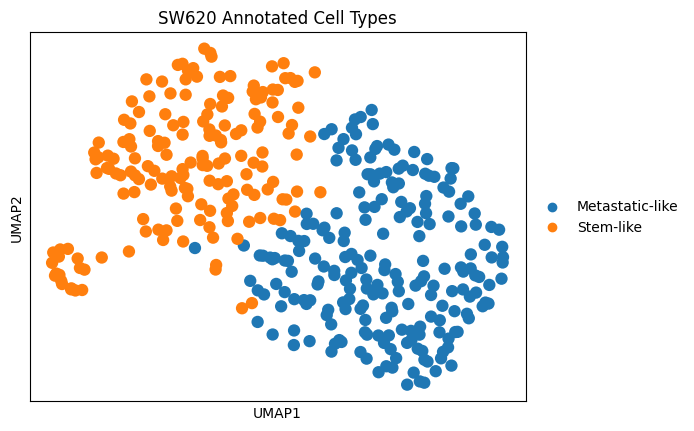

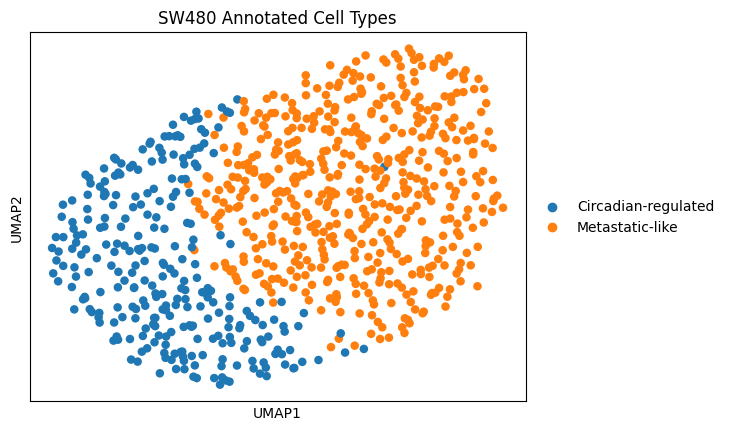

In [ ]:
# Ensure the data is loaded
adata_sw620 = sc.read_h5ad('/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW620.h5ad')  # Path to your SW620 dataset
adata_sw480 = sc.read_h5ad('/content/drive/MyDrive/single-cell-multi-omics/clustered_data/SW480.h5ad')  # Path to your SW480 dataset

# Define additional marker genes for each cell type (based on literature)
marker_genes = {
    'Metastatic-like': ['KRT5', 'CST3', 'SAA1', 'CDH1', 'VIM', 'ZEB1', 'SNAI1', 'MMP9'],
    'Circadian-regulated': ['BMAL1', 'REV-ERBA', 'PER3', 'DBP', 'CLOCK', 'PER2', 'ARNTL', 'CRY1'],
    'Stem-like': ['CD133', 'CD44', 'ALDH1', 'OCT4', 'SOX2']
}

# Function to annotate clusters based on marker gene expression
def annotate_clusters_by_markers(adata, marker_genes):
    # Initialize an empty list to store annotations
    annotations = []

    # Iterate over each cluster
    for cluster in adata.obs['louvain'].cat.categories:
        # Get the indices of cells in the current cluster
        cluster_cells_mask = adata.obs['louvain'] == cluster

        best_cell_type = 'Unknown'  # Default to unknown
        best_score = -np.inf  # Use negative infinity for initial best score

        # Check expression of marker genes for each defined cell type
        for cell_type, genes in marker_genes.items():
            # Ensure all marker genes for the current cell type are present in the data
            # Handle cases where a marker gene might be missing
            present_genes = [gene for gene in genes if gene in adata.var_names]
            if not present_genes:
                continue  # Skip this cell type if none of its markers are found

            try:
                # Get expression data for the present marker genes in the current cluster
                # Check if the matrix is sparse and convert if necessary for mean calculation
                expression_data = adata[cluster_cells_mask, present_genes].X
                if isinstance(expression_data, np.ndarray):
                    mean_expression = np.mean(expression_data, axis=0)
                else:  # Assume sparse
                    mean_expression = np.mean(expression_data.toarray(), axis=0)

                # A simple scoring: sum of mean expression of marker genes
                current_score = np.sum(mean_expression)

                # If this cell type has a higher score than the best so far, update
                if current_score > best_score:
                    best_score = current_score
                    best_cell_type = cell_type

            except Exception as e:
                print(f"Warning: Could not process cluster {cluster} and cell type {cell_type}. Error: {e}")
                continue

        annotations.append({'louvain': cluster, 'Cell_Type': best_cell_type})

    # Create a DataFrame with the annotations
    annotation_df = pd.DataFrame(annotations)

    # Merge the annotations back into the AnnData object
    adata.obs = adata.obs.merge(annotation_df, on='louvain', how='left')

    return adata

# Apply the annotation function to SW620 and SW480 datasets
adata_sw620_annotated = annotate_clusters_by_markers(adata_sw620.copy(), marker_genes)
adata_sw480_annotated = annotate_clusters_by_markers(adata_sw480.copy(), marker_genes)

# Visualize the annotated clusters for SW620 and SW480
sc.pl.umap(adata_sw620_annotated, color='Cell_Type', title='SW620 Annotated Cell Types')
sc.pl.umap(adata_sw480_annotated, color='Cell_Type', title='SW480 Annotated Cell Types')


# Some cell types have more pronounced circadian regulation due to their roles in processes like sleep-wake cycles, metabolism, immune responses, and cell division.

Examples of Circadian-Regulated Cell Types:

Epithelial Cells:

Example: Cells in the skin or gut have circadian-regulated activity in terms of barrier function, repair mechanisms, and immune responses. These cells are highly regulated by the internal clock to adapt to external environmental conditions like light exposure.

Immune Cells:

Example: Certain immune cells, including T cells, B cells, and macrophages, exhibit circadian rhythms in their activation, proliferation, and cytokine production. These rhythms play a role in immune responses and help the body adapt to varying conditions during the day-night cycle.

Neuronal Cells:

Example: Neurons in the suprachiasmatic nucleus (SCN), the brain's master clock, regulate the circadian rhythm. Other neuronal cells, such as those in the hypothalamus and cortex, exhibit circadian variation in neurotransmitter release and synaptic plasticity.